In [1]:
import os
import sys
import datetime as dt
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt

%matplotlib inline

import scipy.signal as signal
import scipy.optimize as opt

from latrt_testing import utils
import fts_data_routines as routines
import bandpass_helpers as bp
import latrt_testing.demodulation as demod
import importlib
importlib.reload(demod)
from random import randrange
import latrt_testing.fft_ops as fft_ops
from so3g.hk import load_range

from sotodlib.io.load_smurf import * 
from sotodlib.tod_ops.fft_ops import rfft
from sotodlib.tod_ops.detrend import detrend_tod
from sotodlib.flags import get_trending_flags, get_glitch_flags
from sotodlib.tod_ops import pca

import logging
import os
logger.setLevel(logging.DEBUG)

SMURF = utils.get_db()
session = SMURF.Session()

%load_ext autoreload

%autoreload 2

In [2]:
def process_run_ufm(aman, folder_name, band_channel_map,
                    middle_relative_time=496.4, threshold=.1, index_limit=160, 
                    plot=False, resolution=.15, nperseg=(2 ** 9), demod_lp_fc=0.5, 
                    chop_freq=8):
    assert os.path.exists(folder_name)
    #aman = SMURF.load_data(obs_list[n].start, obs_list[n].stop)
    get_trending_flags(aman)
    detrend_tod(aman)
    
    
    # get the glitches.
    _ = get_glitch_flags(aman, hp_fc=1.0, buffer=20, overwrite=True, n_sig=50)
    mask = aman.flags.glitches.mask()
    
    fts_x, fts_y = routines.get_fts_position(aman)
    print('XY stage position = (%s, %s)' %(fts_x, fts_y))
    
    # get the 'good' dets with lots of power at 8Hz
    Pxx, freqs = fft_ops.psd(aman, nperseg=nperseg)
    for power_threshold in [100, 10]:
        print('using power threshold of %s:' %power_threshold)
        good_dets = routines.get_good_dets(aman, Pxx, freqs, plot=plot, power_threshold=power_threshold)
        if len(good_dets) > 20:
            break
    print('number of detectors with higher power in 8hz = %s' %len(good_dets))
        
    if len(good_dets) > 3:
        # now fit the phase with the 'good' detectors
        phase_fit_aman = aman.restrict('dets', aman.dets.vals[good_dets], in_place=False)
        phase_to_use, phases = demod.fit_phase(phase_fit_aman, middle_relative_time, plot=plot, 
                                               threshold=threshold, index_limit=index_limit)
        if np.std(phases) > .3:
            print('Phase fitting standard deviation is slightly high, check hist')
            plt.hist(phases)
            plt.xlabel('phase')
            plt.ylabel('counts')
            plt.grid()
            plt.show()
            
        # demodulate with the fitted phase
        demod.demod_single_sine(aman, phase_to_use, lp_fc=demod_lp_fc, freq=chop_freq)
    else:
        print('not enough good detectors found to fit phase. demodulating with a sine + cosine')
        demod.demod_sine(aman, freq=chop_freq, lp_fc=demod_lp_fc)
    
    # get the integrated signal
    fts_mirror_positions, fts_time_ranges  = routines.load_fts_range_bounds(aman, resolution=resolution)
    interferograms = []
    fts_ind_ranges = routines.get_fts_ind_ranges(fts_time_ranges)
    for i in range(len(mask)):
        # integrate around any glitches in the data.
        total_non_glitch_inds = routines.get_integration_indices_optimized(fts_ind_ranges, np.where(mask[i])[0])
        integrated_signal = routines.integrate_signal(aman.demod_signal[i], total_non_glitch_inds)
        interferograms.append(integrated_signal)
    interferograms = np.array(interferograms)
    
    if (plot and len(good_dets) > 0):
        routines.plot_good_interferograms(aman, good_dets, interferograms, 
                                          fts_mirror_positions)
    if len(good_dets) == 0:
        routines.plot_good_interferograms(aman, list(range(aman.dets.count)), interferograms, 
                                          fts_mirror_positions)
        
    # save this data along with bias group number, dets, and XY position to another notebook
    routines.save_data(aman, n, fts_mirror_positions, interferograms, 
                       folder_name, band_channel_map, obs_list[n].obs_id)
    del aman
    return

In [3]:
# Using tags lets you narrow down the data to the type of measurement you want.
# You can also filter via measurement date.
SMURF = utils.get_db()
session = SMURF.Session()
obs_list = session.query(Observations).filter(Observations.start > dt.datetime(2024,7, 30, 19),
                                              Observations.start < dt.datetime(2024,7, 31,17),
                                              Observations.duration > 30*60).all()
obs_list, len(obs_list)

([obs_ufm_lf_ln1_lp5_lp6_1722369528: 2024-07-30 19:58:47.621572 -> 2024-07-30 20:46:54.378880 [0:48:06.757308] (obs,stream,fts,lf),
  obs_ufm_lf_ln1_lp5_lp6_1722372439: 2024-07-30 20:47:18.502063 -> 2024-07-30 21:19:09.591000 [0:31:51.088937] (obs,stream,fts,lf),
  obs_ufm_lf_ln1_lp5_lp6_1722374375: 2024-07-30 21:19:35.092735 -> 2024-07-30 21:51:26.130050 [0:31:51.037315] (obs,stream,fts,lf),
  obs_ufm_lf_ln1_lp5_lp6_1722376312: 2024-07-30 21:51:51.666201 -> 2024-07-30 22:23:42.217492 [0:31:50.551291] (obs,stream,fts,lf),
  obs_ufm_lf_ln1_lp5_lp6_1722378247: 2024-07-30 22:24:06.245434 -> 2024-07-30 22:55:58.271233 [0:31:52.025799] (obs,stream,fts,lf),
  obs_ufm_lf_ln1_lp5_lp6_1722380183: 2024-07-30 22:56:22.820404 -> 2024-07-30 23:28:13.675788 [0:31:50.855384] (obs,stream,fts,lf),
  obs_ufm_lf_ln1_lp5_lp6_1722382120: 2024-07-30 23:28:39.404250 -> 2024-07-31 00:00:31.061985 [0:31:51.657735] (obs,stream,fts,lf),
  obs_ufm_lf_ln1_lp5_lp6_1722384060: 2024-07-31 00:00:59.991043 -> 2024-07-3

In [4]:
# Define a unique id for each detector by creating a map (band, channeL) -> id
n = 1
obs = obs_list[n]

hk_data = load_range(
    obs_list[n].start, obs_list[n].stop,
    config='/data/users/kmharrin/smurf_context/hk_config_202104.yaml')
bg_map_fp = utils.find_last_bg_map(SMURF, obs.stream_id, obs.timestamp)
bg_map = np.load(bg_map_fp,allow_pickle=True).item()
bias_groups = []
for i in range(len(bg_map['bands'])):
    band = bg_map['bands'][i]
    channel = bg_map['channels'][i]
    bg = bg_map['bgmap'][i]
    bias_groups.append( [band, channel, bg])
bias_groups = np.array(bias_groups)

msk_30s = np.any([bias_groups[:,2] == 0,
                  bias_groups[:,2] == 0,
                  bias_groups[:,2] == 3,
                  bias_groups[:,2] == 9], axis=0)

msk_40s = np.any([bias_groups[:,2] == 1,
                   bias_groups[:,2] == 2, 
                   bias_groups[:,2] == 7, 
                   bias_groups[:,2] == 8,], axis=0)

bg7 = np.any([bias_groups[:,2] == 7], axis=0)
bg9 = np.any([bias_groups[:,2] == 9], axis=0)
bg0 = np.any([bias_groups[:,2] == 0], axis=0)
ln1 = np.any([bias_groups[:,2] >= 8], axis=0)

extra = np.all([~msk_30s, ~msk_40s], axis=0)

aman = SMURF.load_data(np.min(hk_data['xy_stage_x'][0]), np.min(hk_data['xy_stage_x'][0]) + 500)
band_channel_map = {}
for i, (channel, band) in enumerate(np.array([aman.det_info.smurf.channel, aman.det_info.smurf.band]).T):
    band_channel_map[(band, channel)] = i
#del aman

DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 1/1 [00:02<00:00,  2.76s/it]


------------------------------------------------------------------------------------------
processing data for run 1:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.37s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


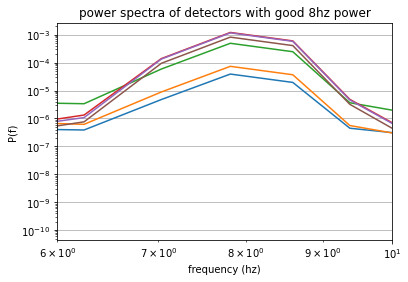

using power threshold of 10:


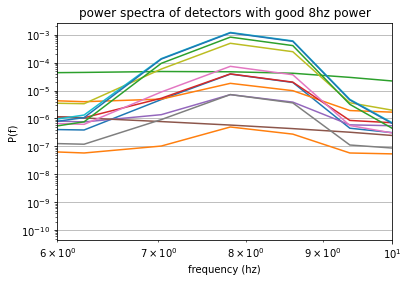

number of detectors with higher power in 8hz = 13


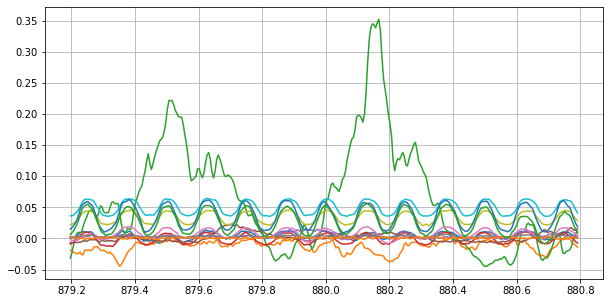

mean, median, std of fitted phases: 2.18, 1.46, 1.55


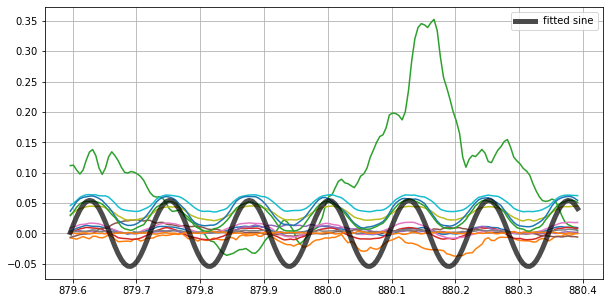

Phase fitting standard deviation is slightly high, check hist


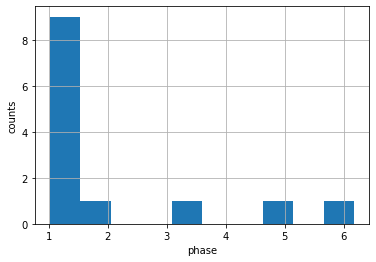

number of interferograms in bias group -1: 0


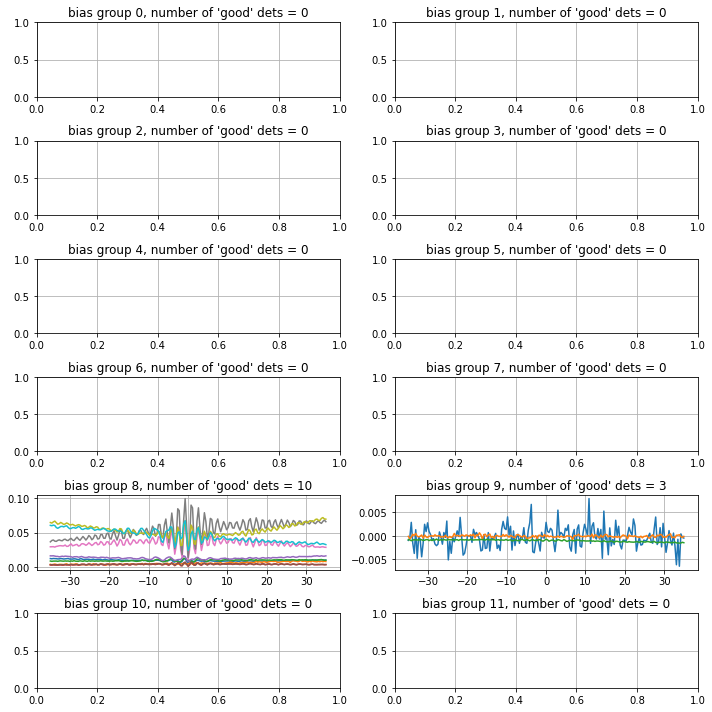

data saved to location FTS_data_integrated/run_1_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 2:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.19s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


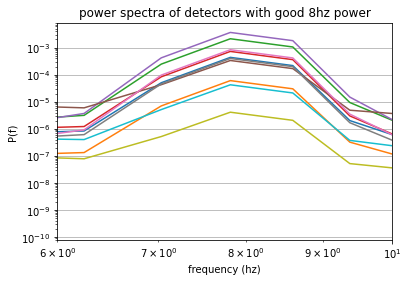

using power threshold of 10:


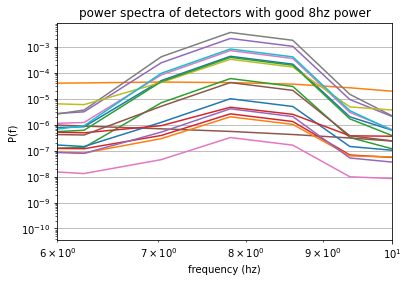

number of detectors with higher power in 8hz = 17


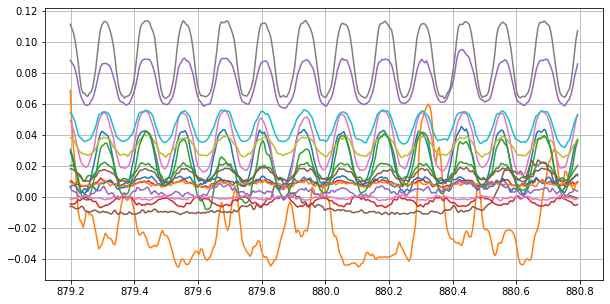

mean, median, std of fitted phases: 4.48, 4.86, 1.02


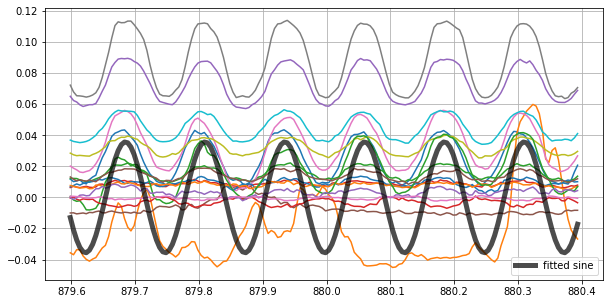

Phase fitting standard deviation is slightly high, check hist


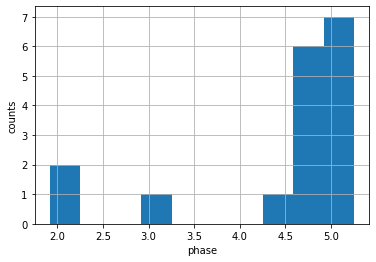

number of interferograms in bias group -1: 0


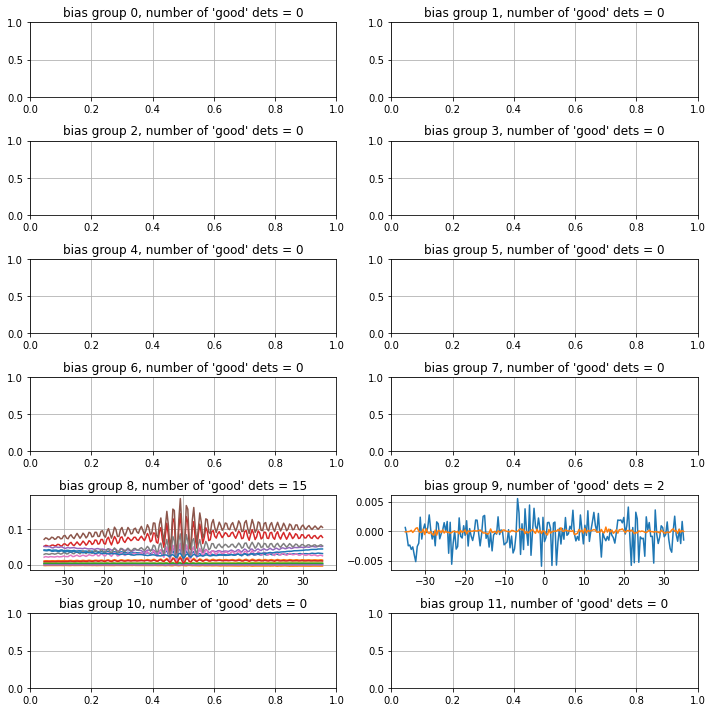

data saved to location FTS_data_integrated/run_2_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 3:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.22s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


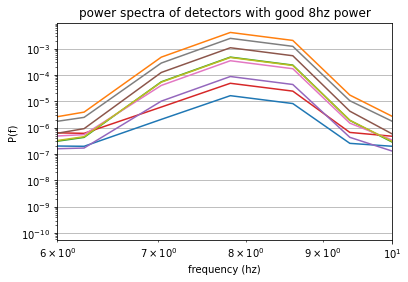

using power threshold of 10:


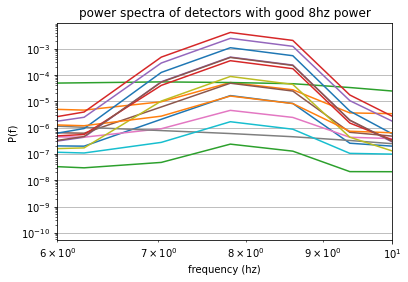

number of detectors with higher power in 8hz = 16


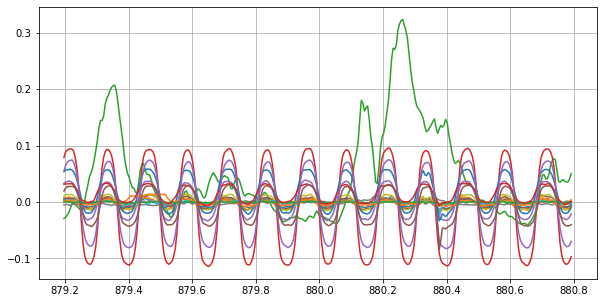

mean, median, std of fitted phases: 3.56, 3.57, 0.55


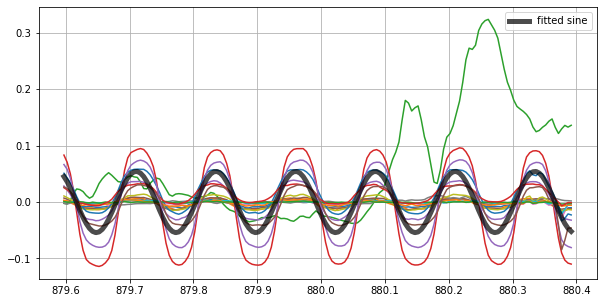

Phase fitting standard deviation is slightly high, check hist


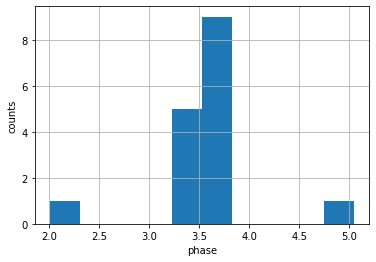

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


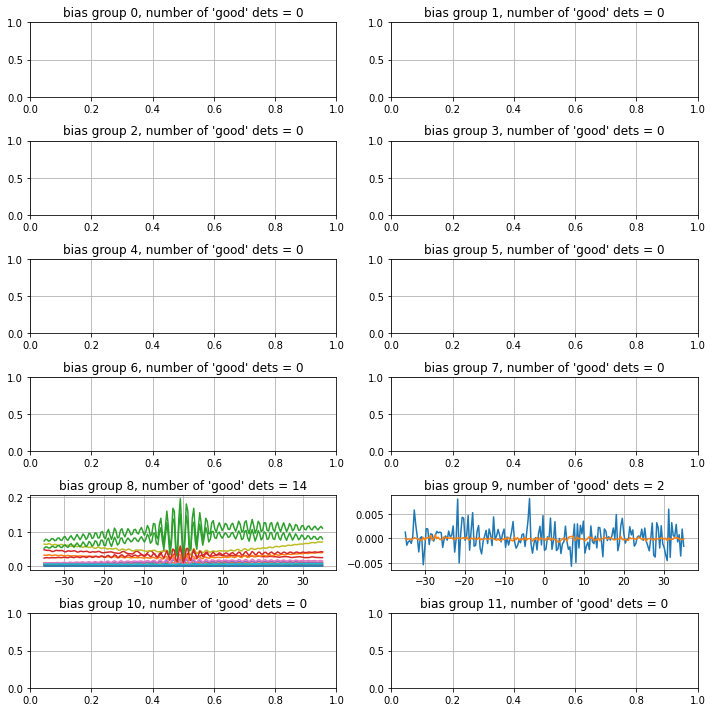

data saved to location FTS_data_integrated/run_3_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 4:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.24s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


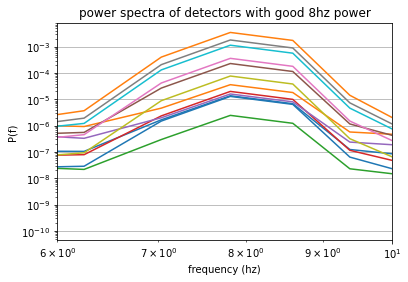

using power threshold of 10:


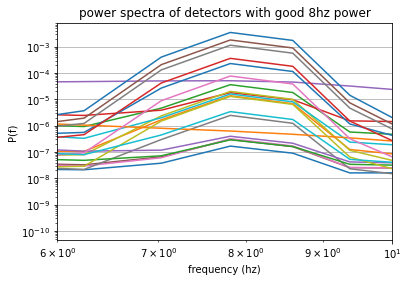

number of detectors with higher power in 8hz = 21


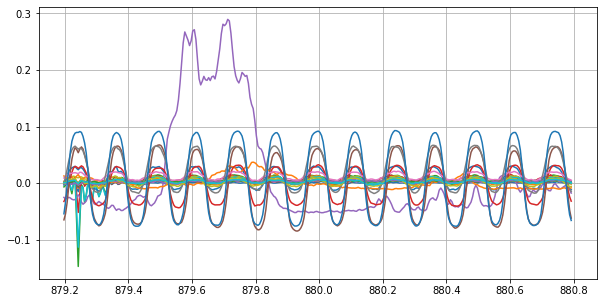

mean, median, std of fitted phases: 2.58, 2.29, 0.91


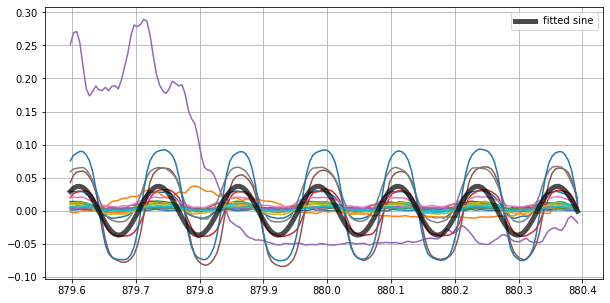

Phase fitting standard deviation is slightly high, check hist


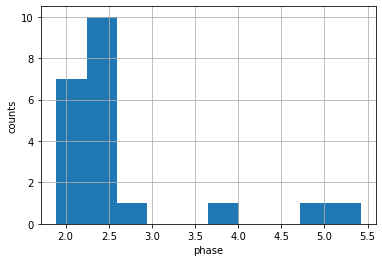

number of interferograms in bias group -1: 0


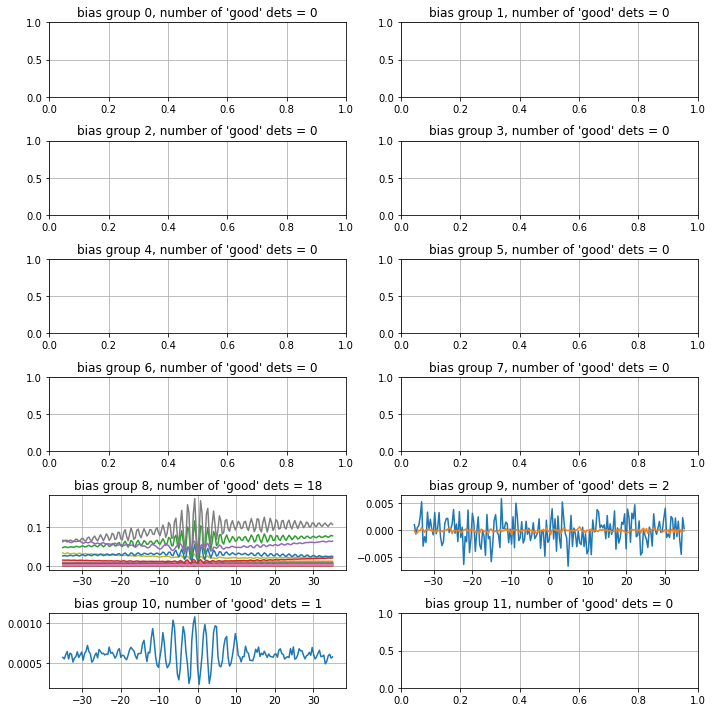

data saved to location FTS_data_integrated/run_4_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 5:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.38s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


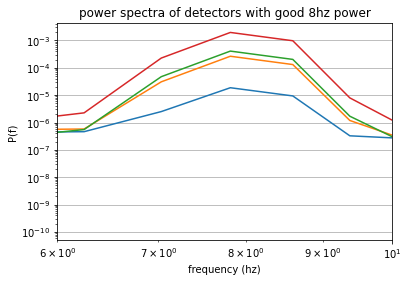

using power threshold of 10:


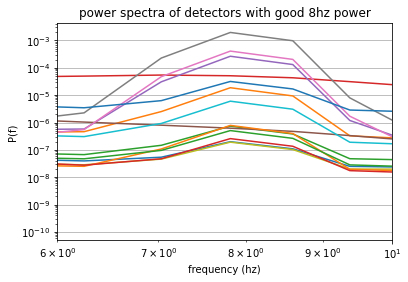

number of detectors with higher power in 8hz = 14


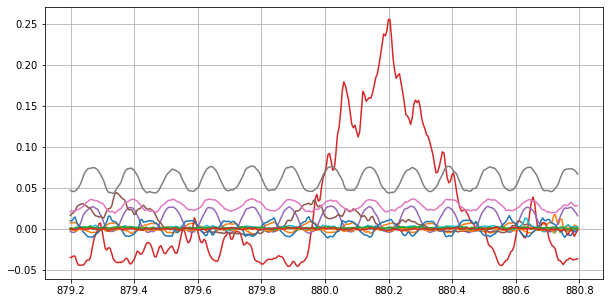

mean, median, std of fitted phases: 1.63, 0.88, 1.47


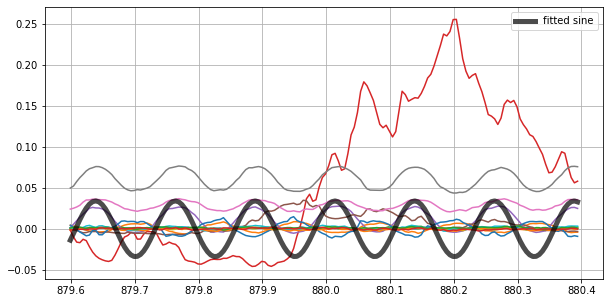

Phase fitting standard deviation is slightly high, check hist


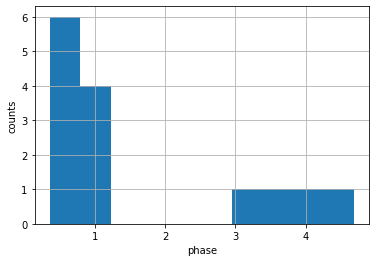

number of interferograms in bias group -1: 0


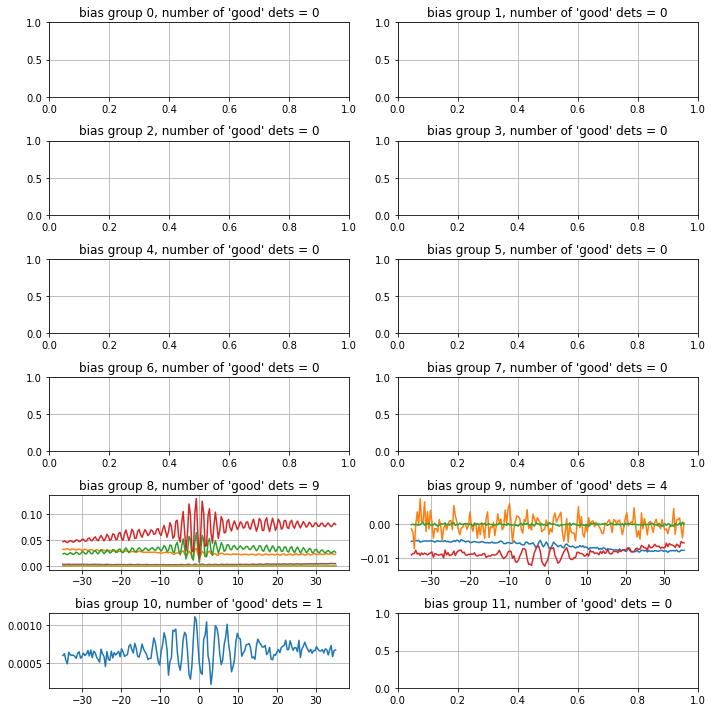

data saved to location FTS_data_integrated/run_5_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 6:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.23s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


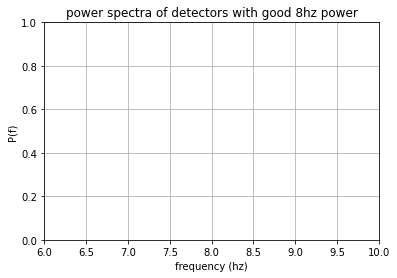

using power threshold of 10:


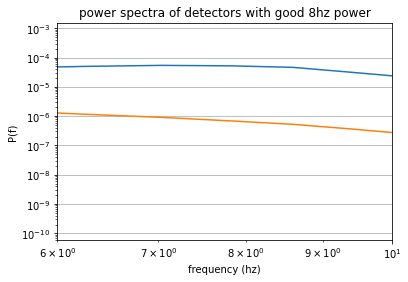

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


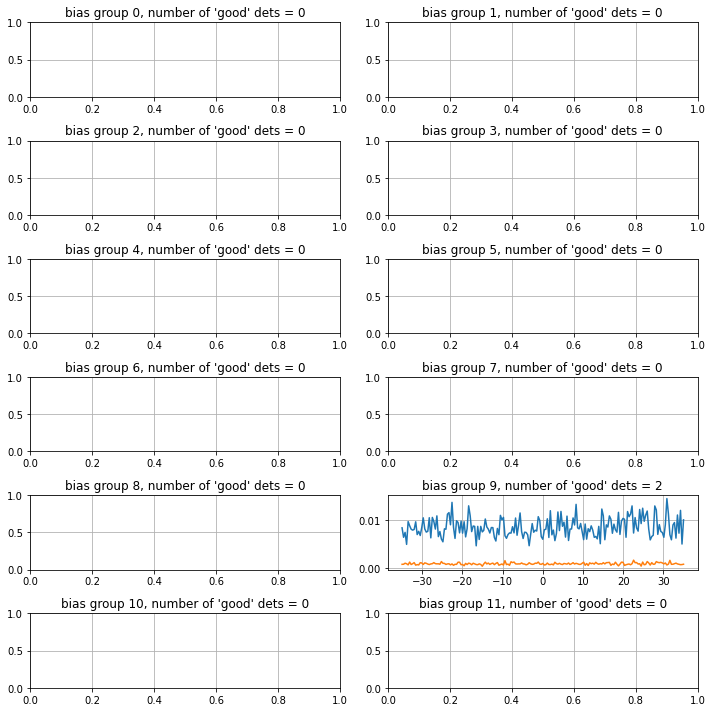

data saved to location FTS_data_integrated/run_6_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 7:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:06<00:00,  1.68s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


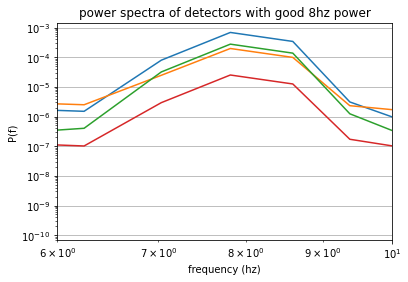

using power threshold of 10:


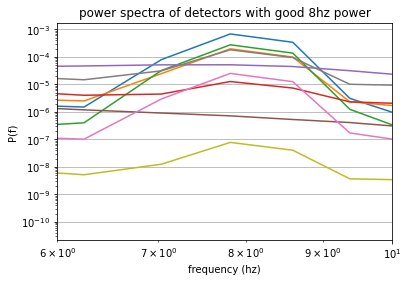

number of detectors with higher power in 8hz = 9


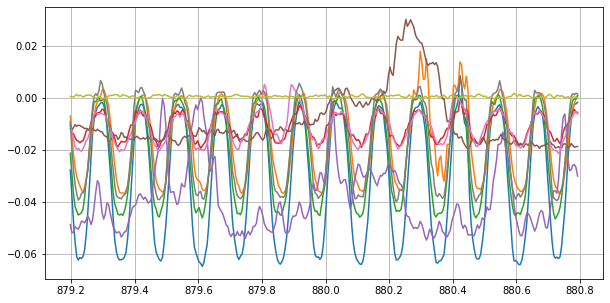

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


mean, median, std of fitted phases: 2.78, 2.70, 1.06


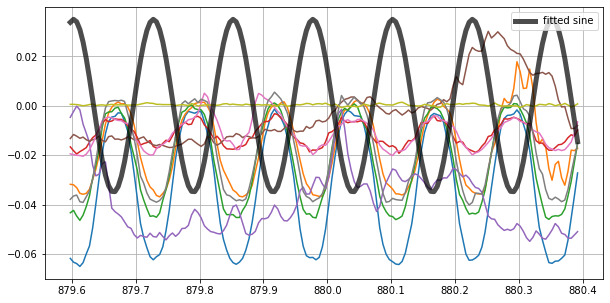

Phase fitting standard deviation is slightly high, check hist


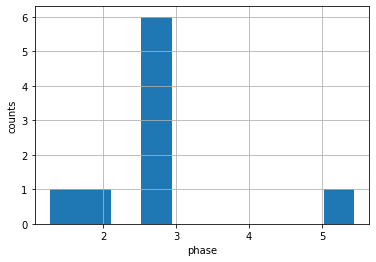

number of interferograms in bias group -1: 0


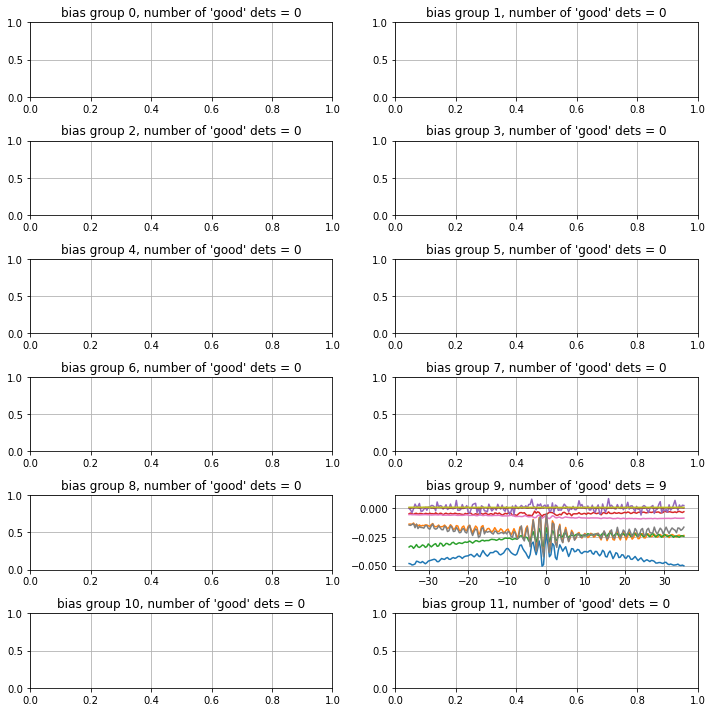

data saved to location FTS_data_integrated/run_7_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 8:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:06<00:00,  1.53s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


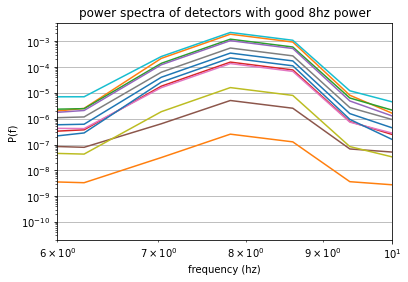

using power threshold of 10:


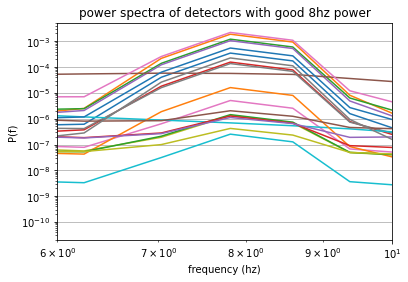

number of detectors with higher power in 8hz = 20


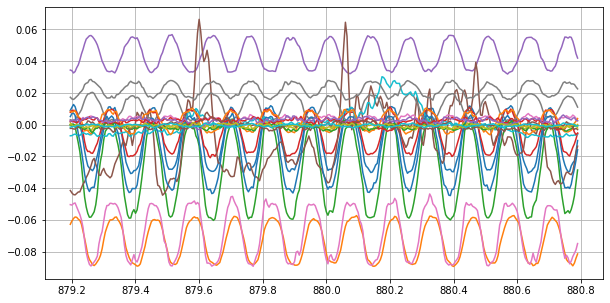

mean, median, std of fitted phases: 2.90, 3.93, 1.61


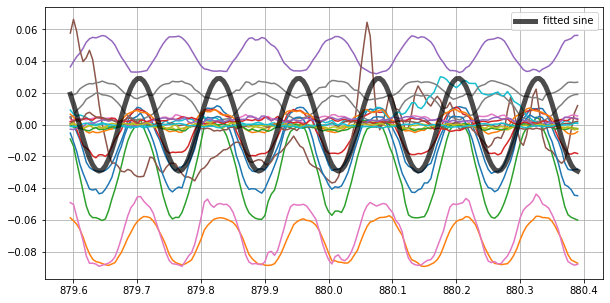

Phase fitting standard deviation is slightly high, check hist


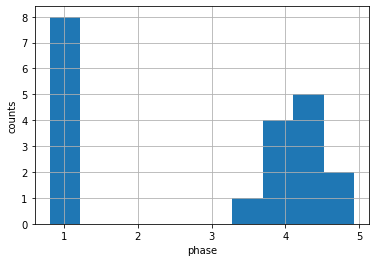

number of interferograms in bias group -1: 0


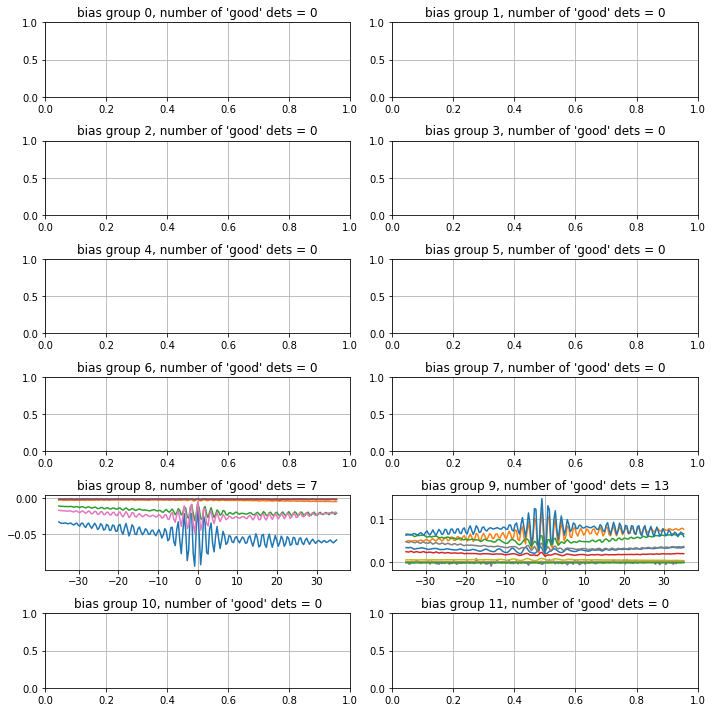

data saved to location FTS_data_integrated/run_8_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 9:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.38s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


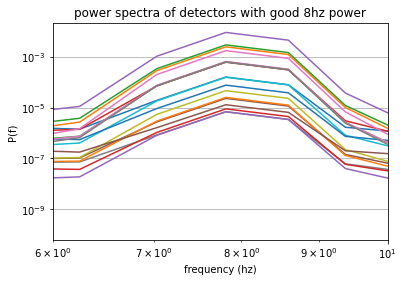

using power threshold of 10:


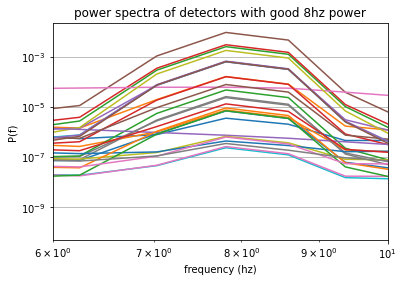

number of detectors with higher power in 8hz = 28


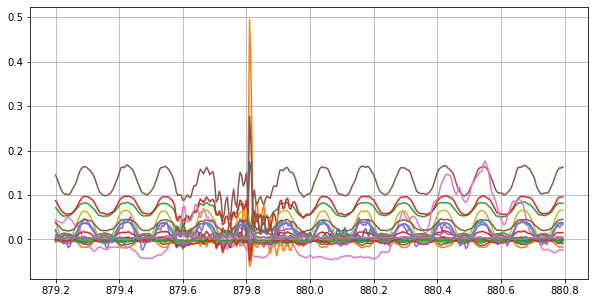

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


mean, median, std of fitted phases: 3.68, 2.75, 1.51


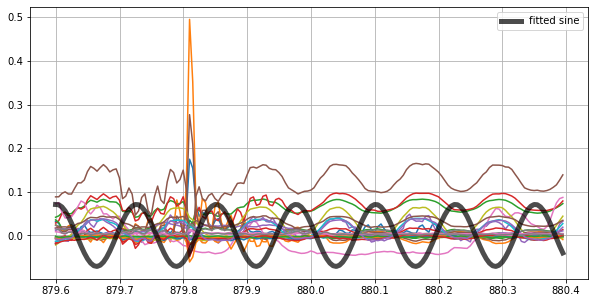

Phase fitting standard deviation is slightly high, check hist


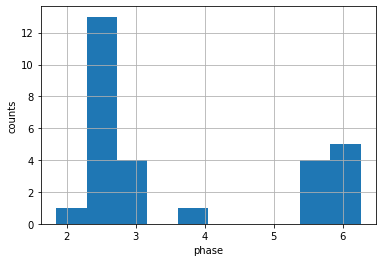

number of interferograms in bias group -1: 0


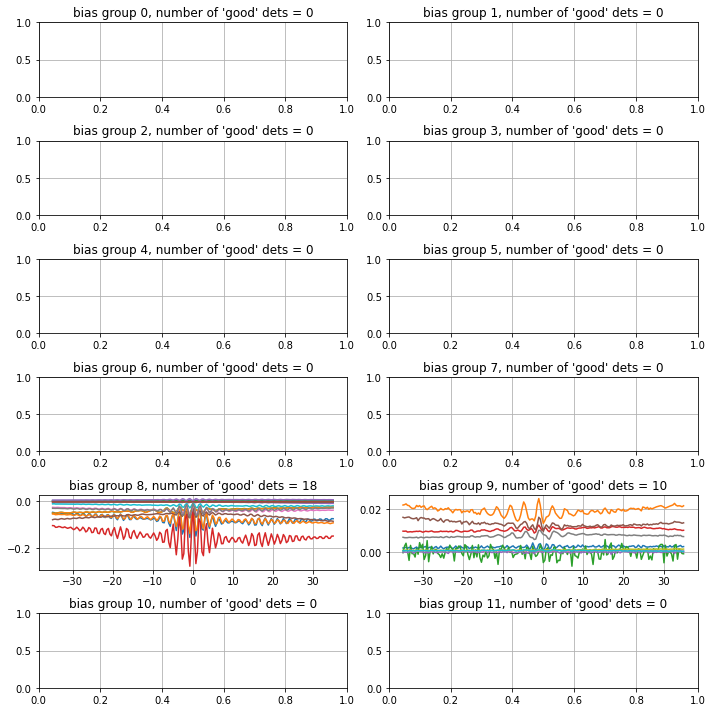

data saved to location FTS_data_integrated/run_9_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 10:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:06<00:00,  1.73s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


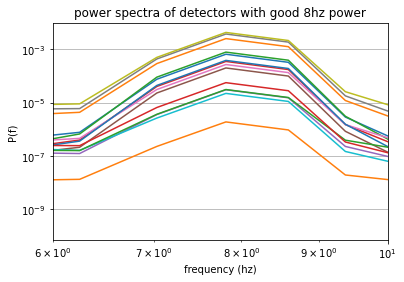

using power threshold of 10:


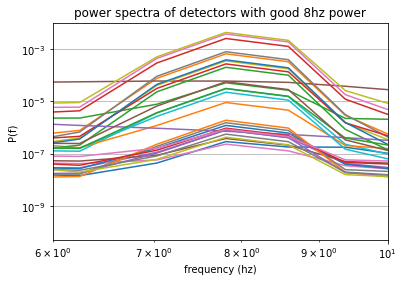

number of detectors with higher power in 8hz = 29


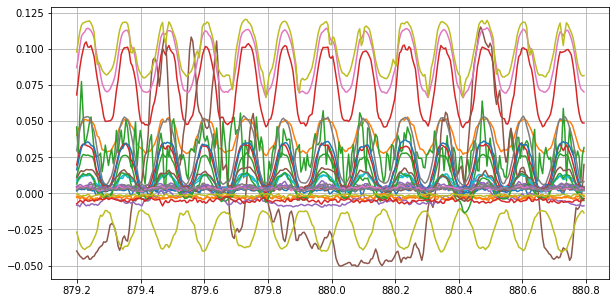

mean, median, std of fitted phases: 3.24, 2.71, 1.21


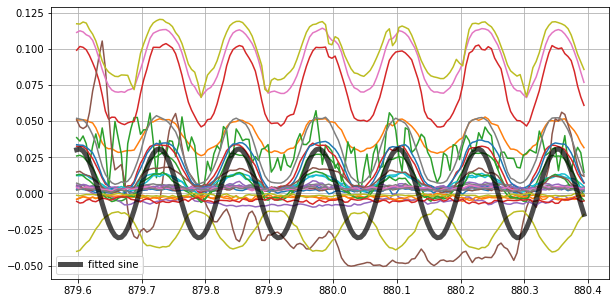

Phase fitting standard deviation is slightly high, check hist


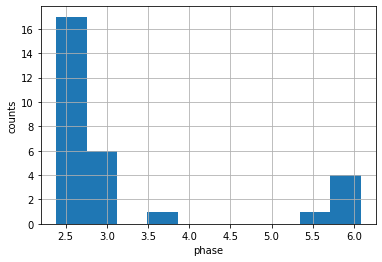

number of interferograms in bias group -1: 0


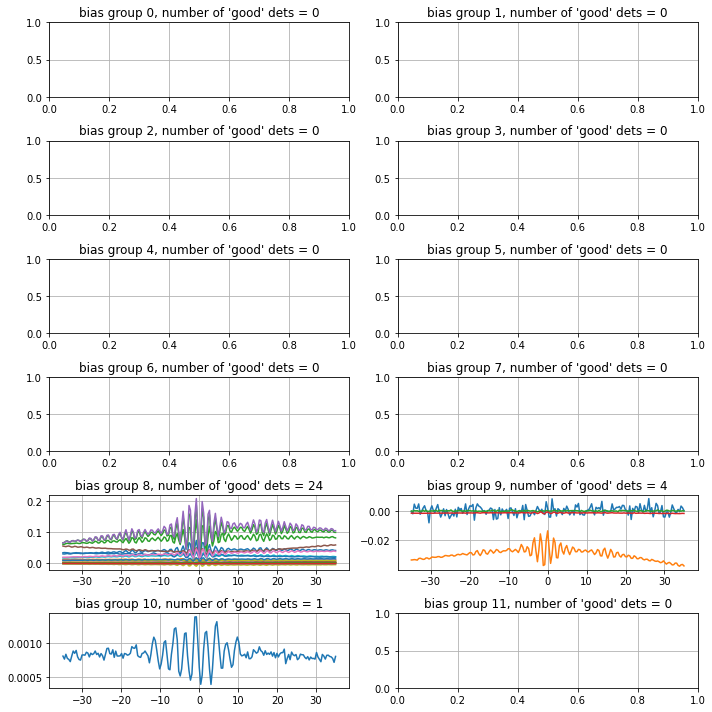

data saved to location FTS_data_integrated/run_10_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 11:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.27s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


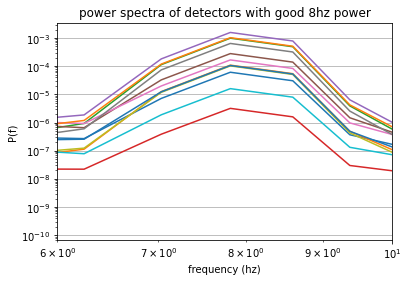

using power threshold of 10:


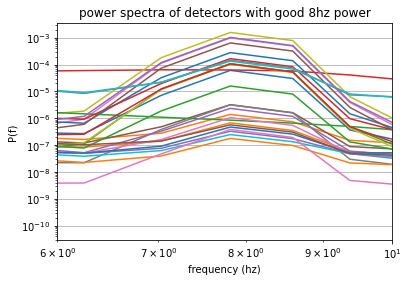

number of detectors with higher power in 8hz = 27


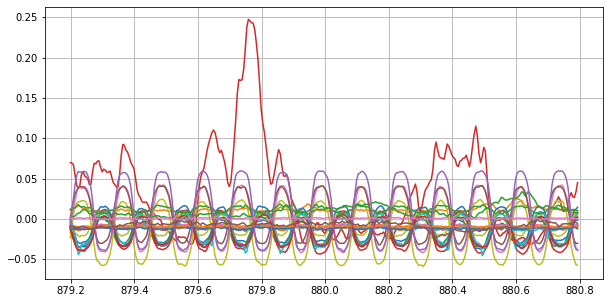

mean, median, std of fitted phases: 4.23, 5.16, 1.60


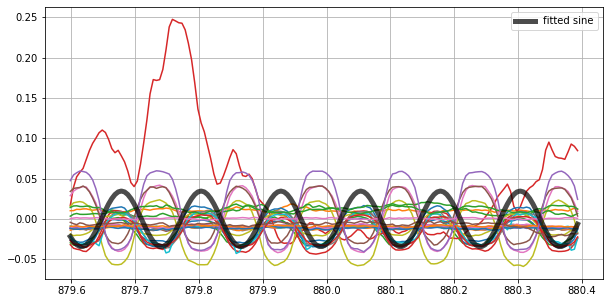

Phase fitting standard deviation is slightly high, check hist


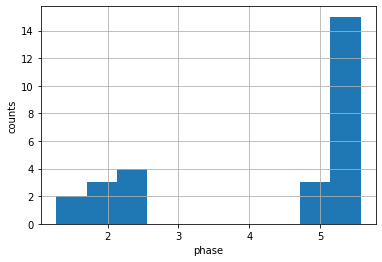

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


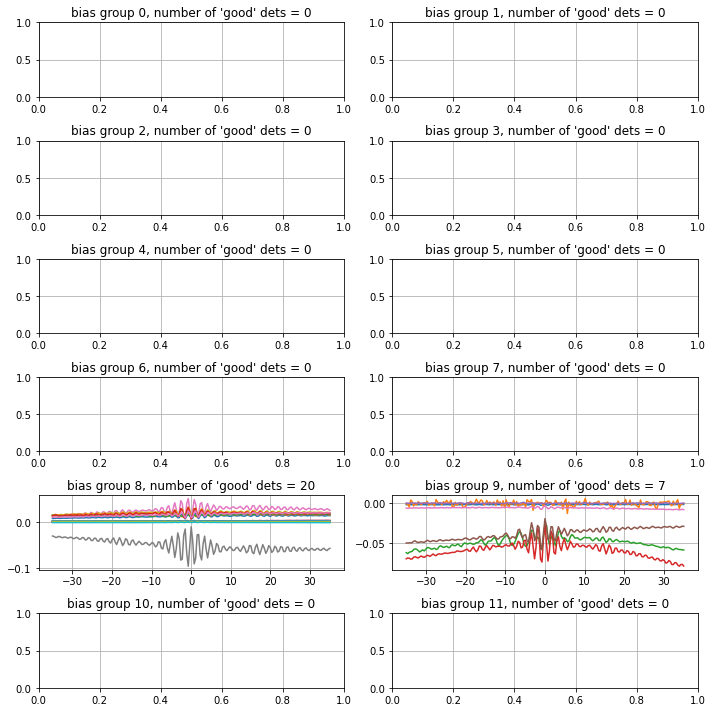

data saved to location FTS_data_integrated/run_11_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 12:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.48s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


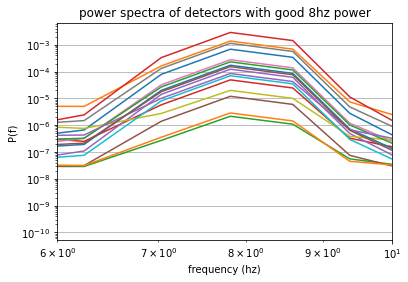

using power threshold of 10:


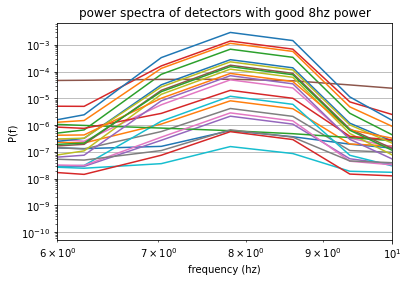

number of detectors with higher power in 8hz = 24


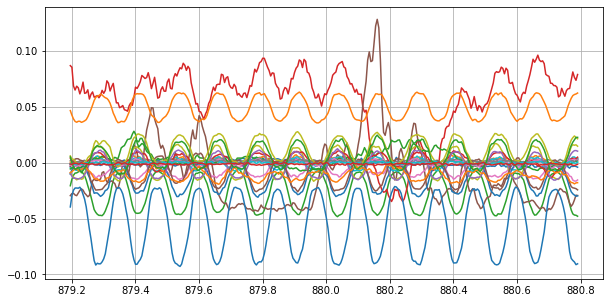

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


mean, median, std of fitted phases: 3.87, 3.04, 1.79


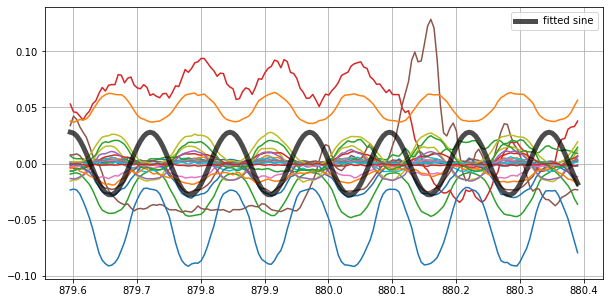

Phase fitting standard deviation is slightly high, check hist


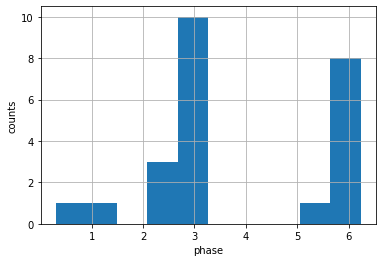

number of interferograms in bias group -1: 0


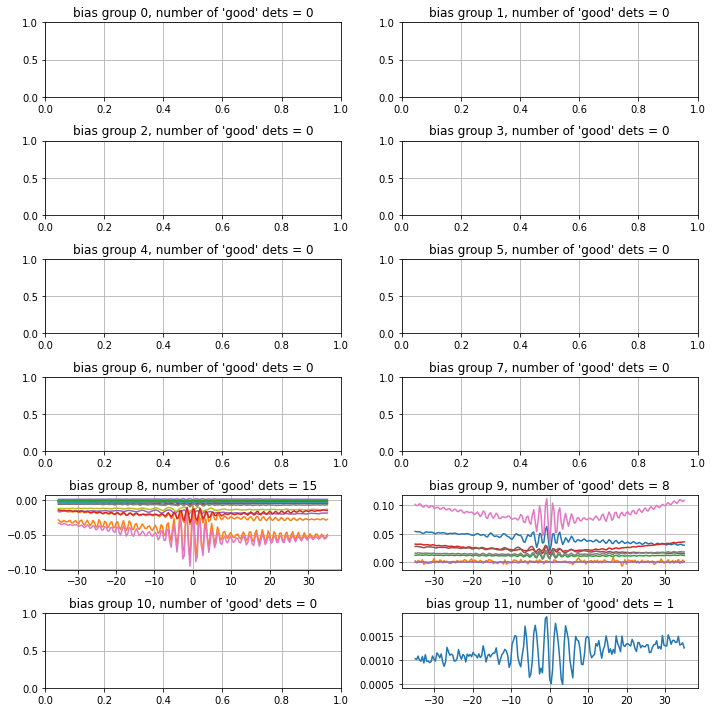

data saved to location FTS_data_integrated/run_12_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 13:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:06<00:00,  1.56s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


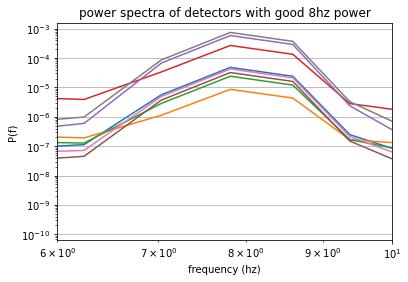

using power threshold of 10:


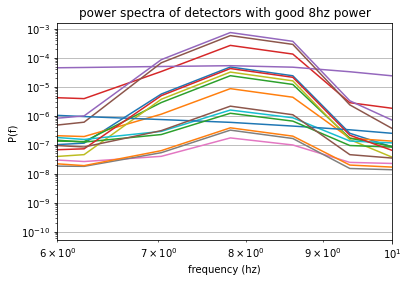

number of detectors with higher power in 8hz = 16


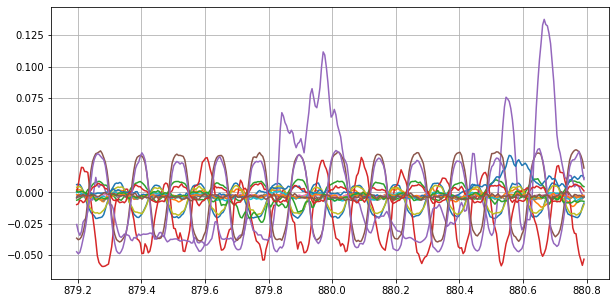

mean, median, std of fitted phases: 3.05, 3.79, 1.53


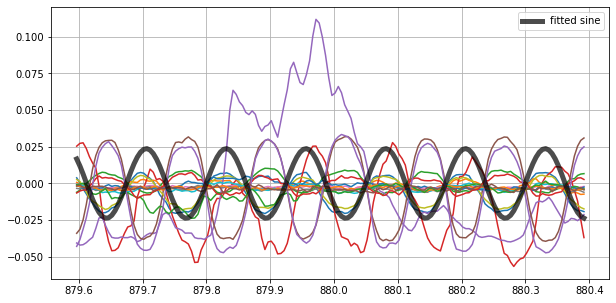

Phase fitting standard deviation is slightly high, check hist


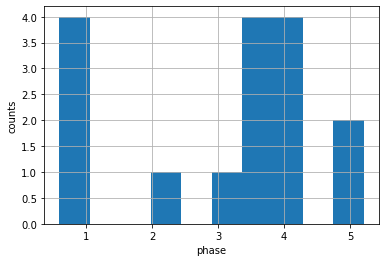

number of interferograms in bias group -1: 0


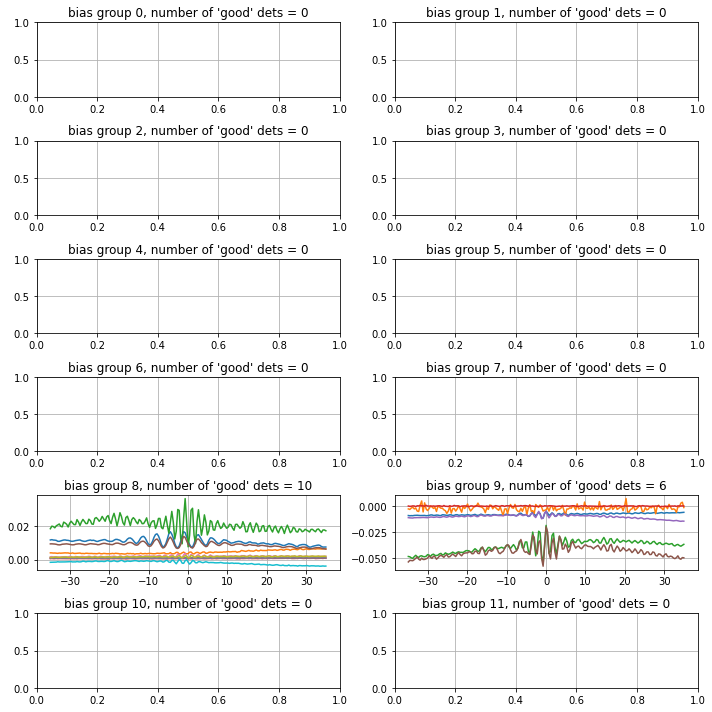

data saved to location FTS_data_integrated/run_13_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 14:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17223/ufm_lf_ln1_lp5_lp6/1722397615_000.g3
100%|██████████| 4/4 [00:05<00:00,  1.28s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


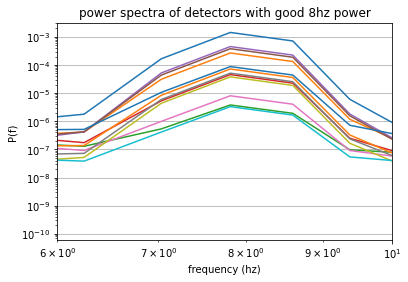

using power threshold of 10:


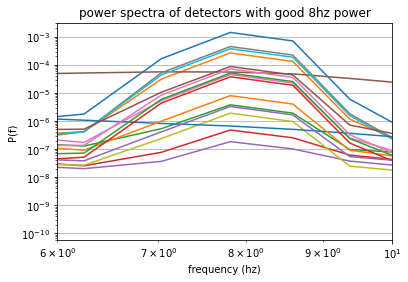

number of detectors with higher power in 8hz = 17


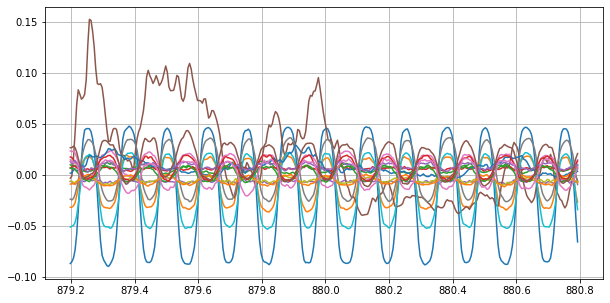

mean, median, std of fitted phases: 3.08, 3.98, 1.52


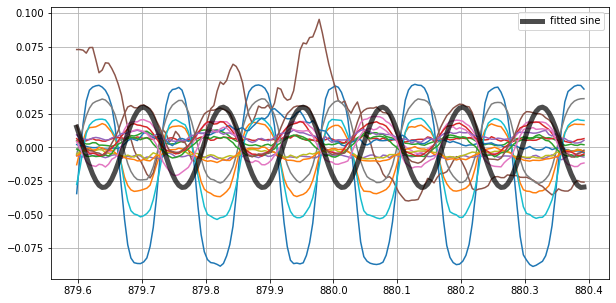

Phase fitting standard deviation is slightly high, check hist


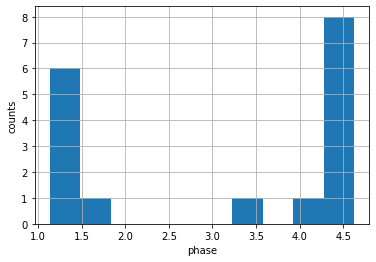

number of interferograms in bias group -1: 0


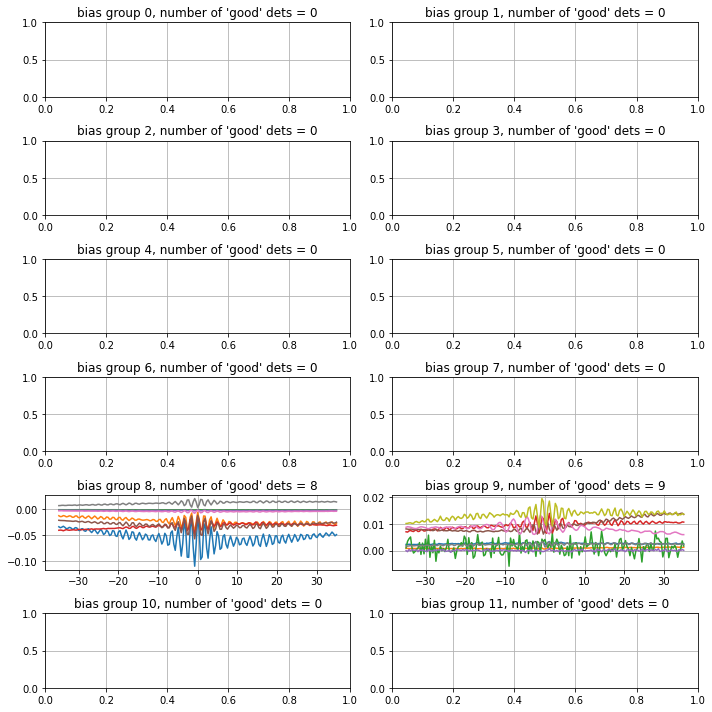

data saved to location FTS_data_integrated/run_14_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 15:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.25s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


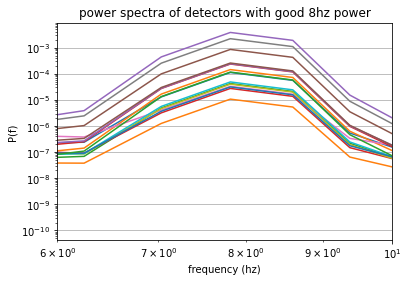

using power threshold of 10:


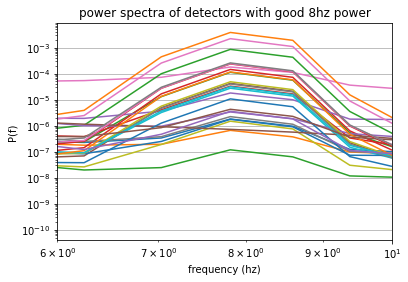

number of detectors with higher power in 8hz = 28


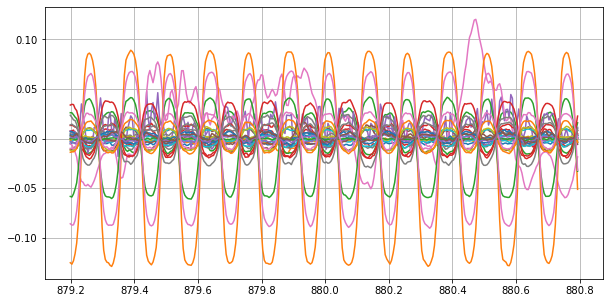

mean, median, std of fitted phases: 3.00, 4.15, 1.61


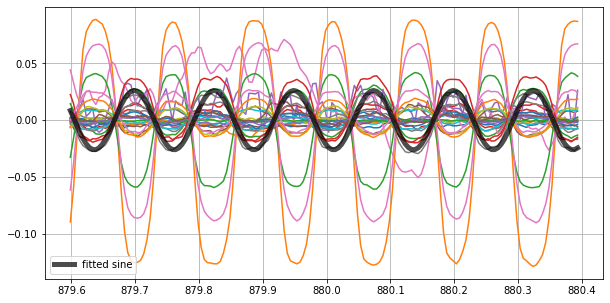

Phase fitting standard deviation is slightly high, check hist


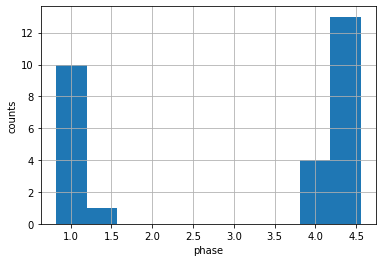

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


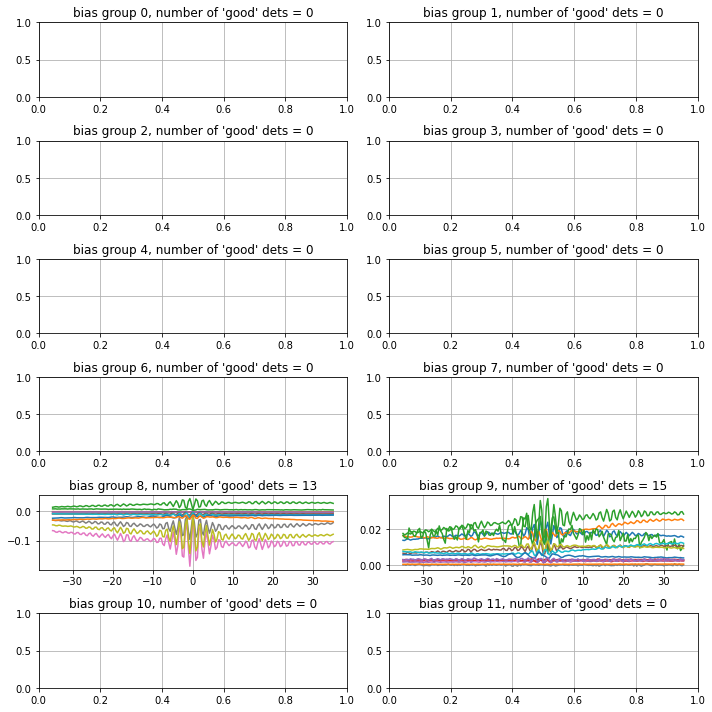

data saved to location FTS_data_integrated/run_15_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 16:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.19s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


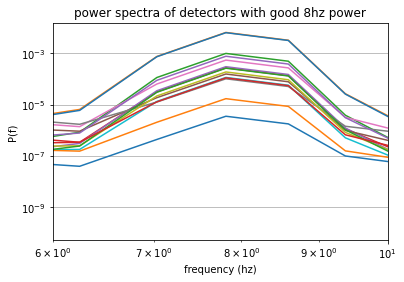

using power threshold of 10:


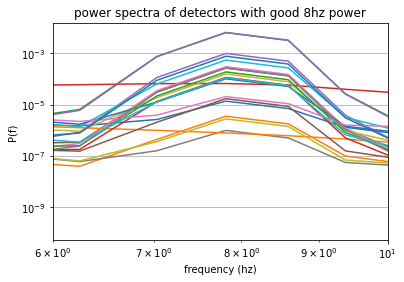

number of detectors with higher power in 8hz = 21


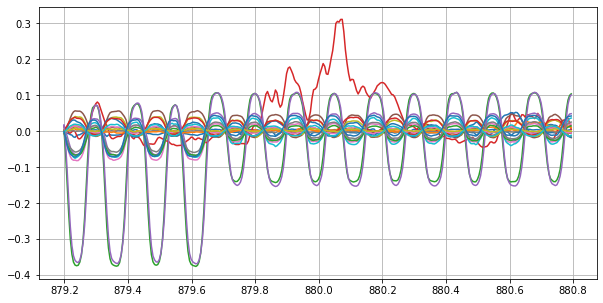

mean, median, std of fitted phases: 3.78, 2.79, 1.52


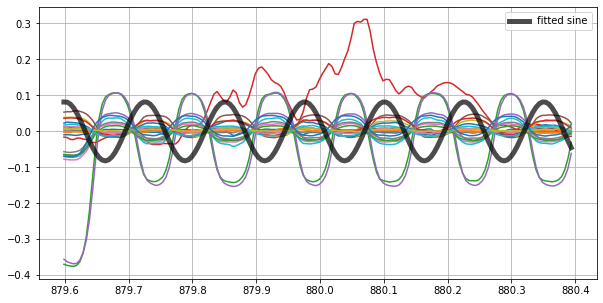

Phase fitting standard deviation is slightly high, check hist


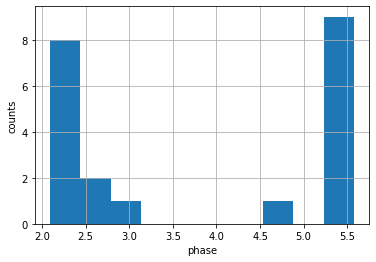

number of interferograms in bias group -1: 0


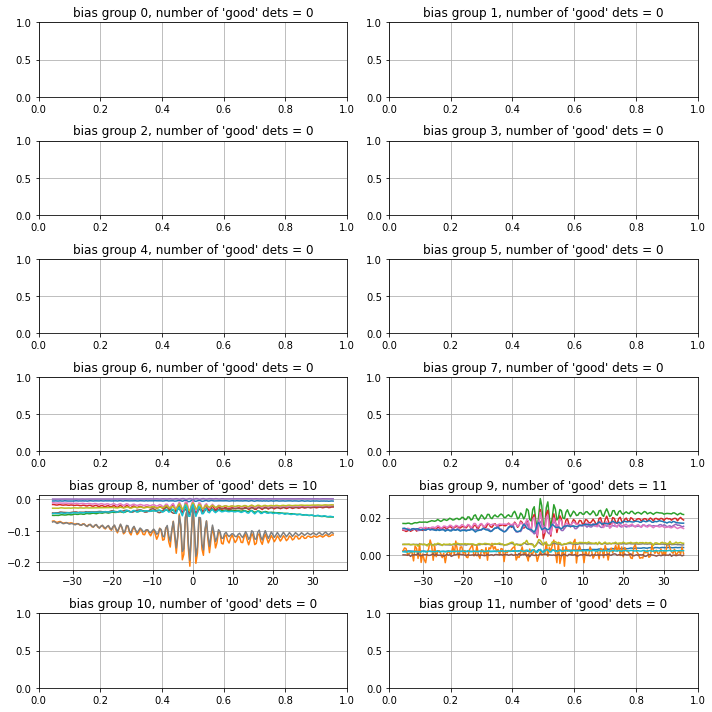

data saved to location FTS_data_integrated/run_16_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 17:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.19s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


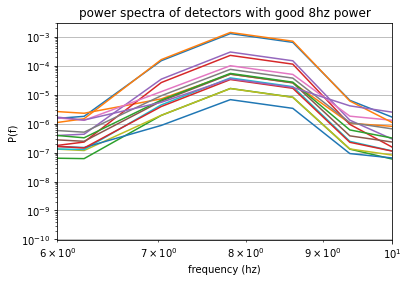

using power threshold of 10:


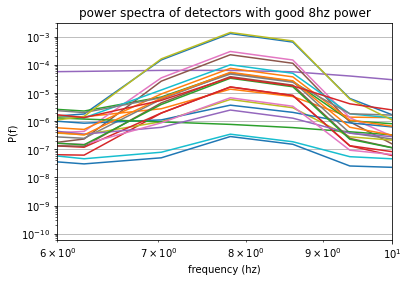

number of detectors with higher power in 8hz = 24


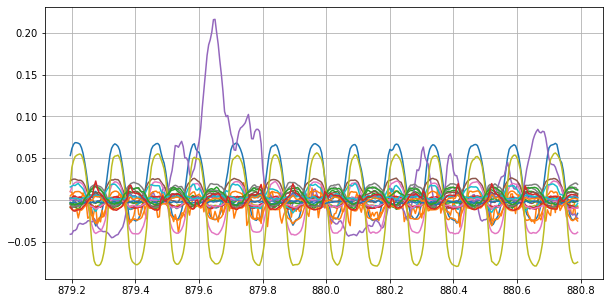

mean, median, std of fitted phases: 1.98, 2.02, 1.73


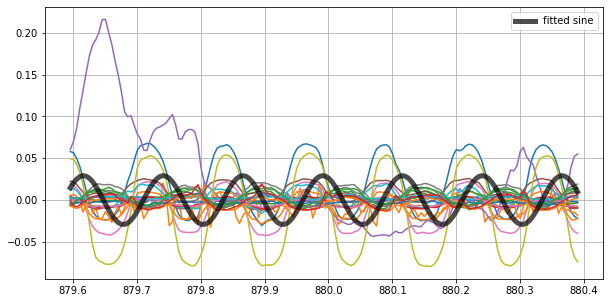

Phase fitting standard deviation is slightly high, check hist


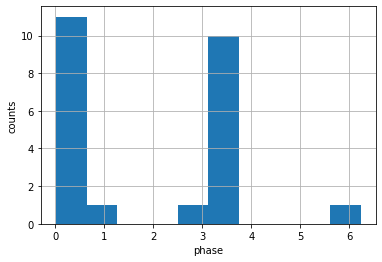

number of interferograms in bias group -1: 0


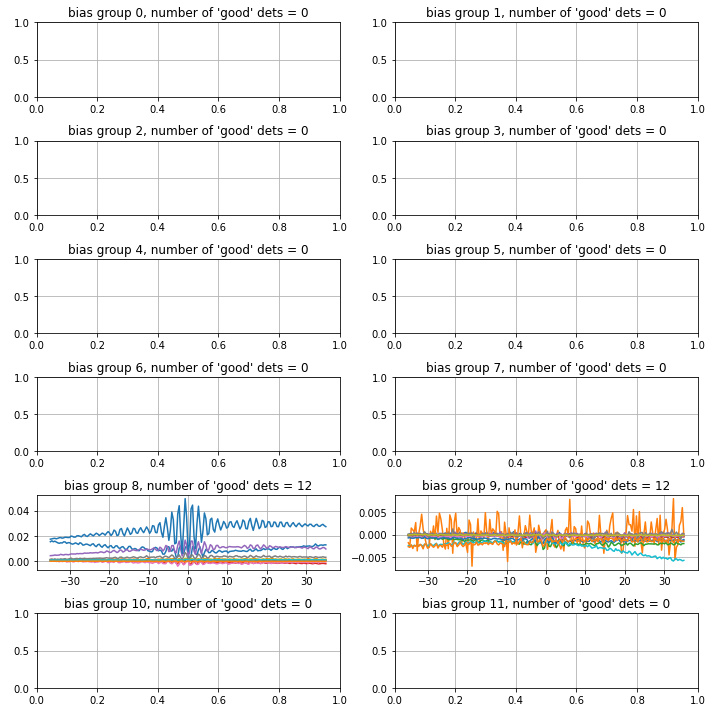

data saved to location FTS_data_integrated/run_17_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 18:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.13s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


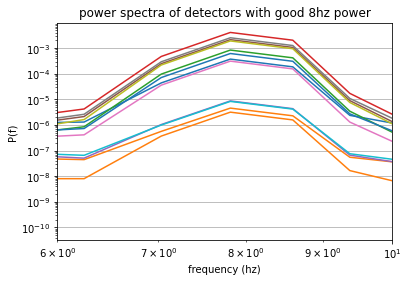

using power threshold of 10:


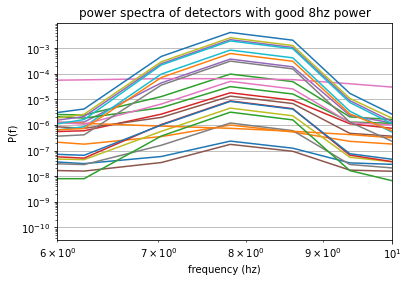

number of detectors with higher power in 8hz = 23


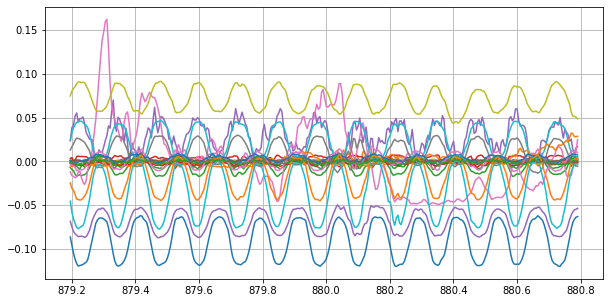

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


mean, median, std of fitted phases: 3.87, 2.91, 1.73


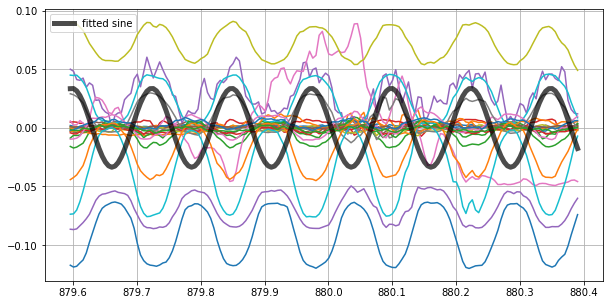

Phase fitting standard deviation is slightly high, check hist


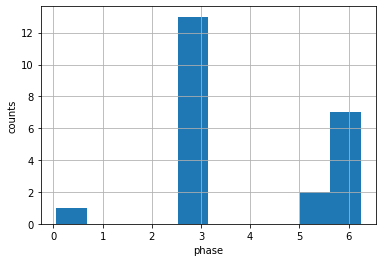

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


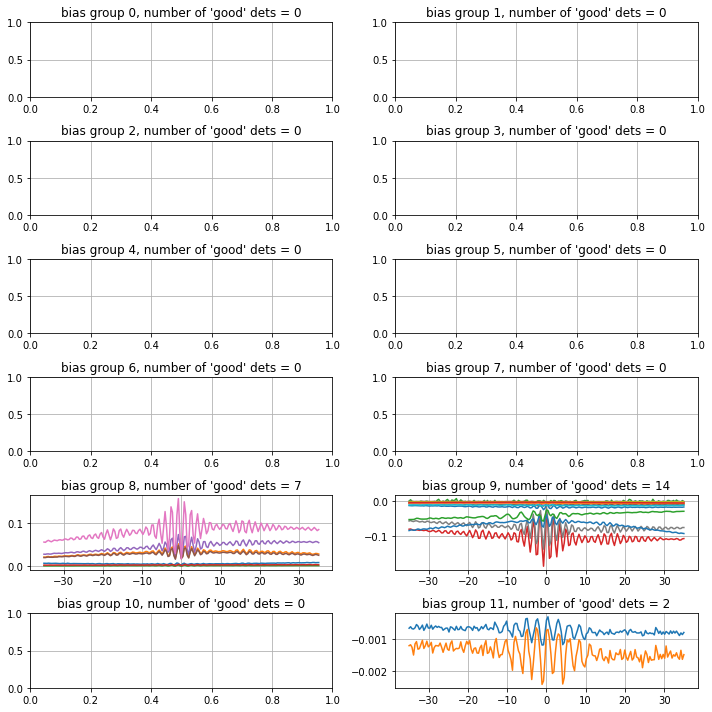

data saved to location FTS_data_integrated/run_18_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 19:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.22s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


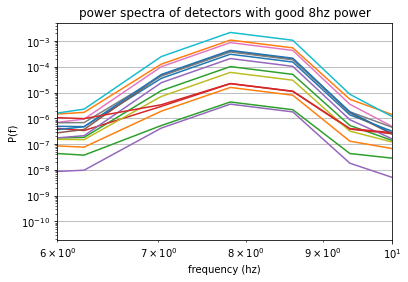

using power threshold of 10:


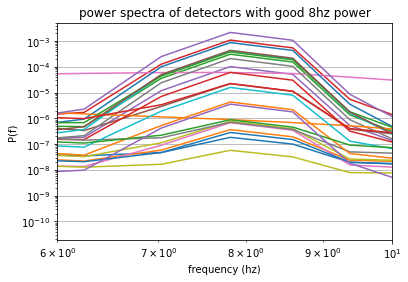

number of detectors with higher power in 8hz = 25


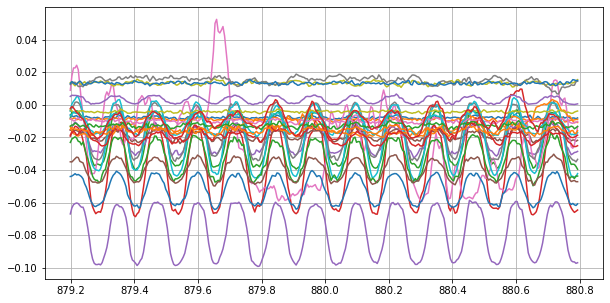

mean, median, std of fitted phases: 3.29, 3.10, 1.07


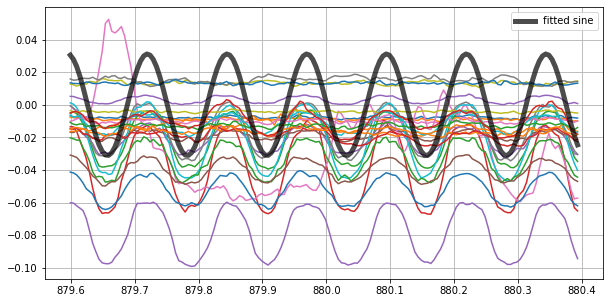

Phase fitting standard deviation is slightly high, check hist


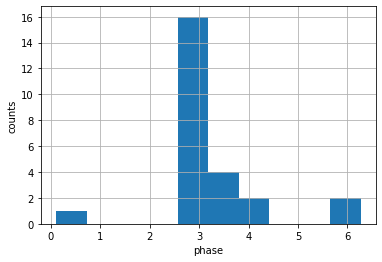

number of interferograms in bias group -1: 0


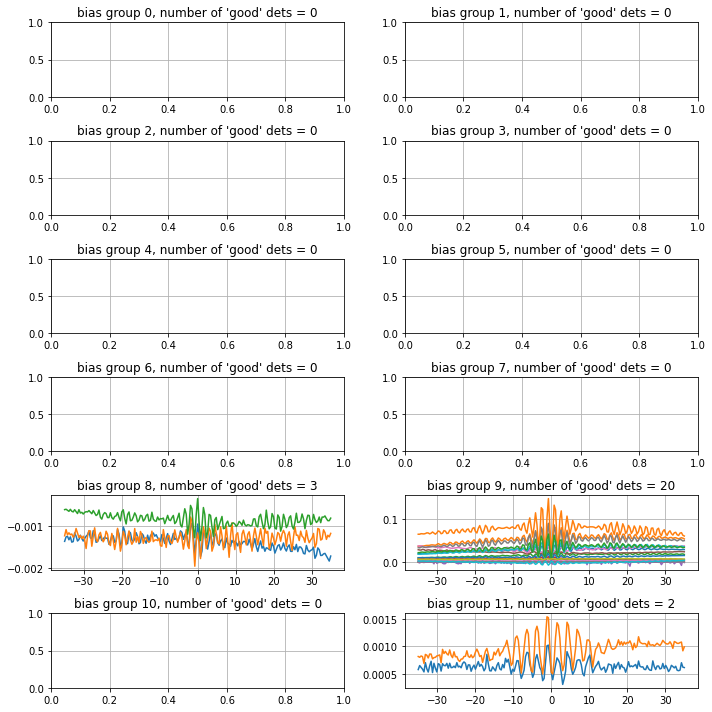

data saved to location FTS_data_integrated/run_19_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 20:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17224/ufm_lf_ln1_lp5_lp6/1722409235_000.g3
100%|██████████| 4/4 [00:04<00:00,  1.22s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


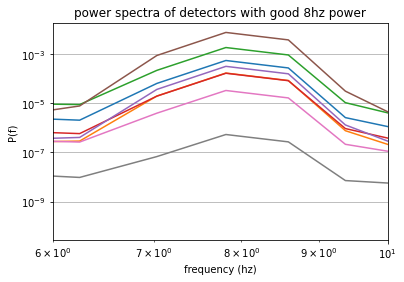

using power threshold of 10:


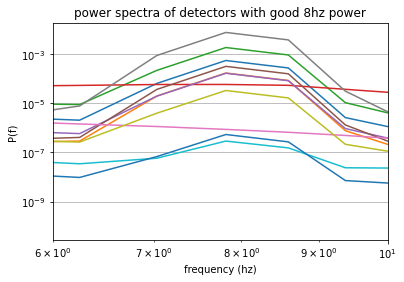

number of detectors with higher power in 8hz = 11


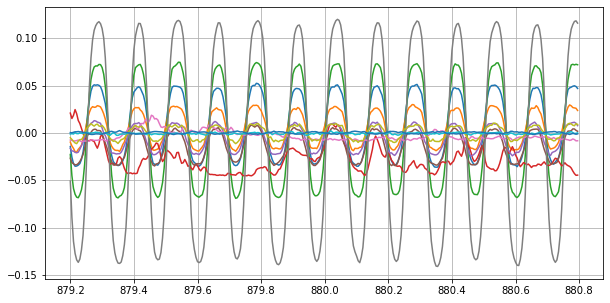

mean, median, std of fitted phases: 4.39, 5.89, 2.29


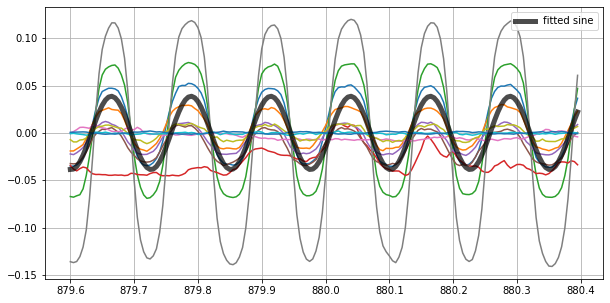

Phase fitting standard deviation is slightly high, check hist


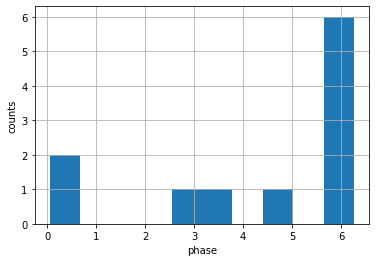

number of interferograms in bias group -1: 0


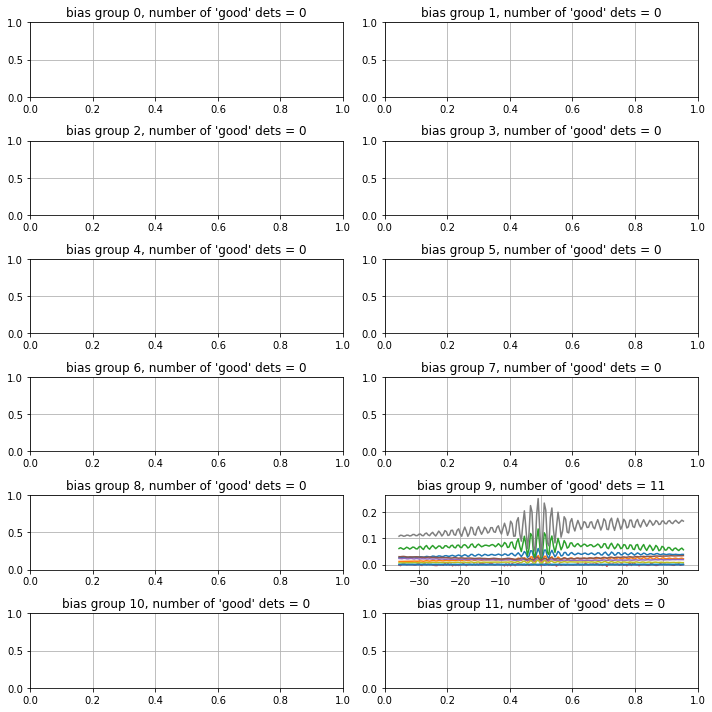

data saved to location FTS_data_integrated/run_20_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 21:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.18s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


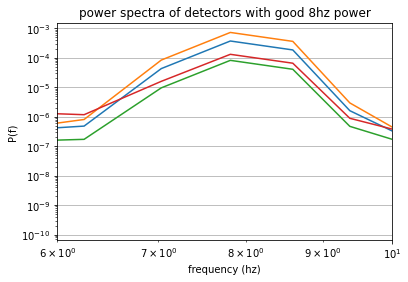

using power threshold of 10:


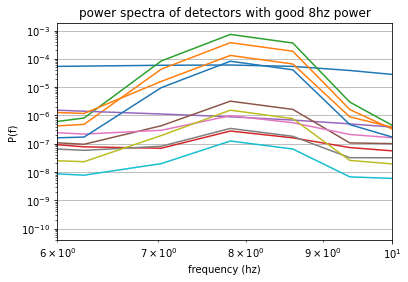

number of detectors with higher power in 8hz = 12


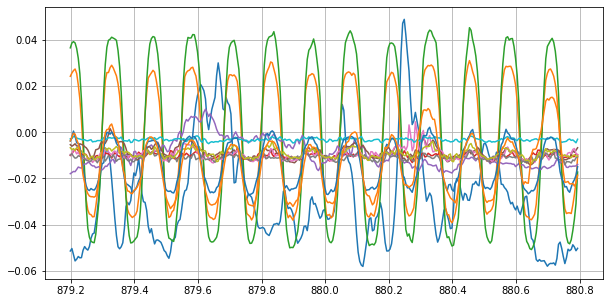

mean, median, std of fitted phases: 3.94, 3.79, 0.63


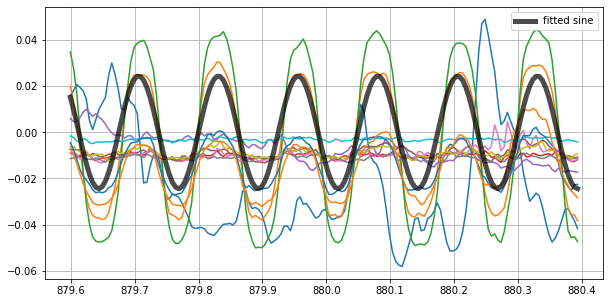

Phase fitting standard deviation is slightly high, check hist


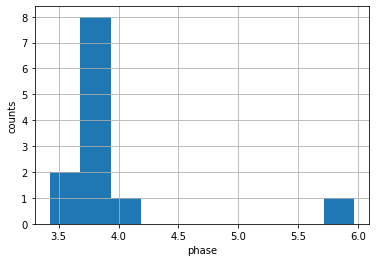

number of interferograms in bias group -1: 0


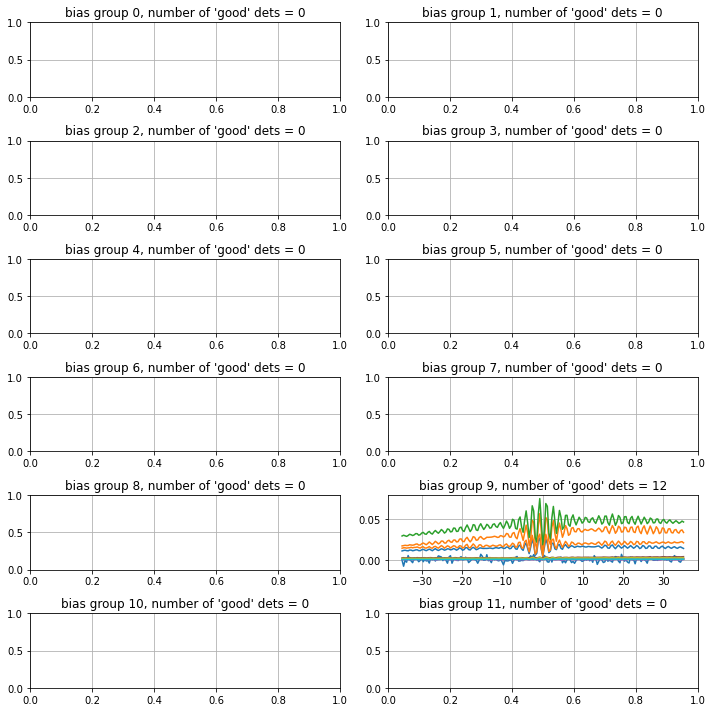

data saved to location FTS_data_integrated/run_21_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 22:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.10s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


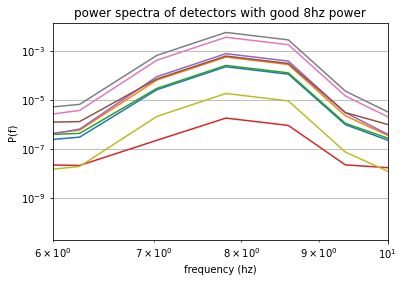

using power threshold of 10:


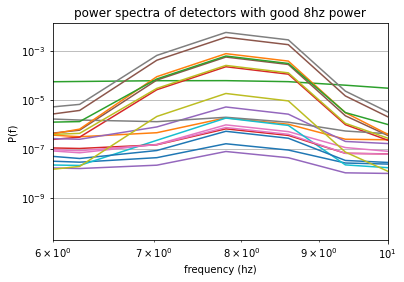

number of detectors with higher power in 8hz = 19


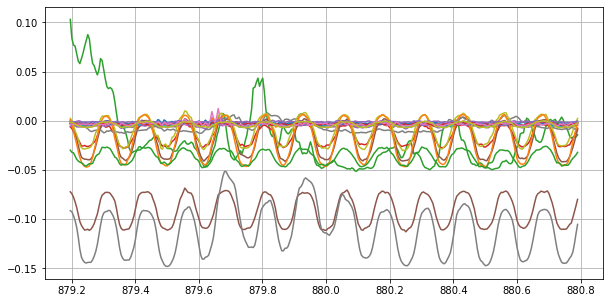

mean, median, std of fitted phases: 5.07, 5.00, 0.32


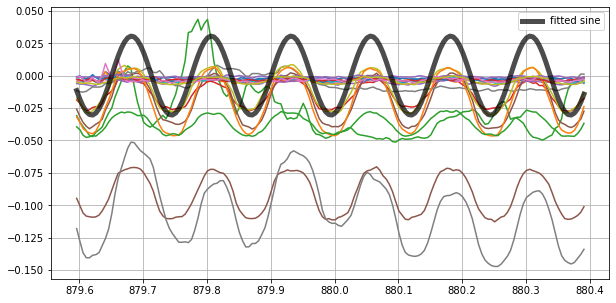

Phase fitting standard deviation is slightly high, check hist


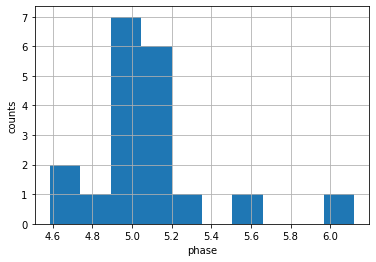

number of interferograms in bias group -1: 0


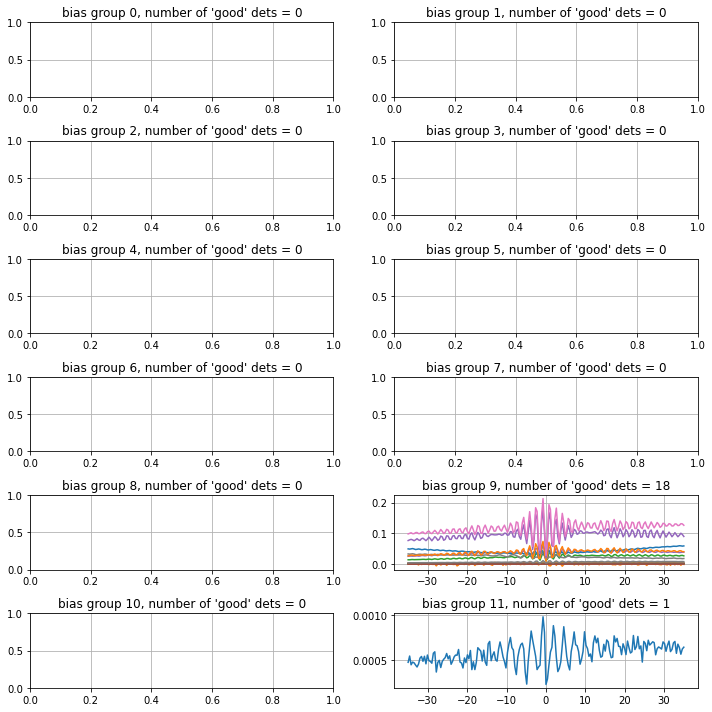

data saved to location FTS_data_integrated/run_22_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 23:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.16s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


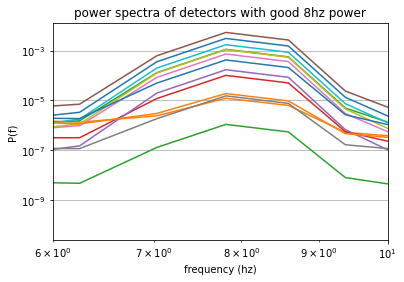

using power threshold of 10:


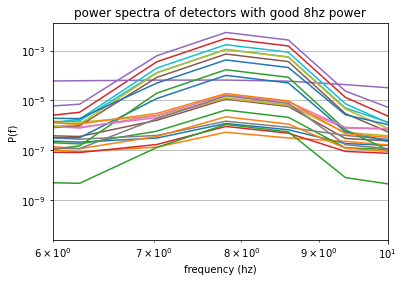

number of detectors with higher power in 8hz = 23


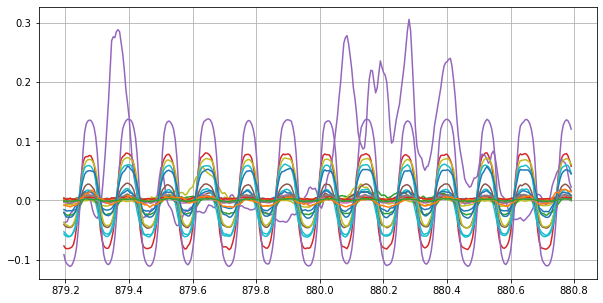

mean, median, std of fitted phases: 0.50, 0.52, 0.13


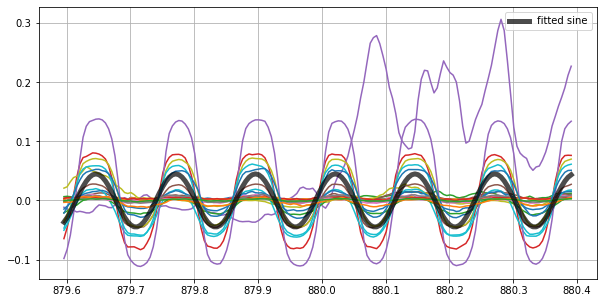

number of interferograms in bias group -1: 0


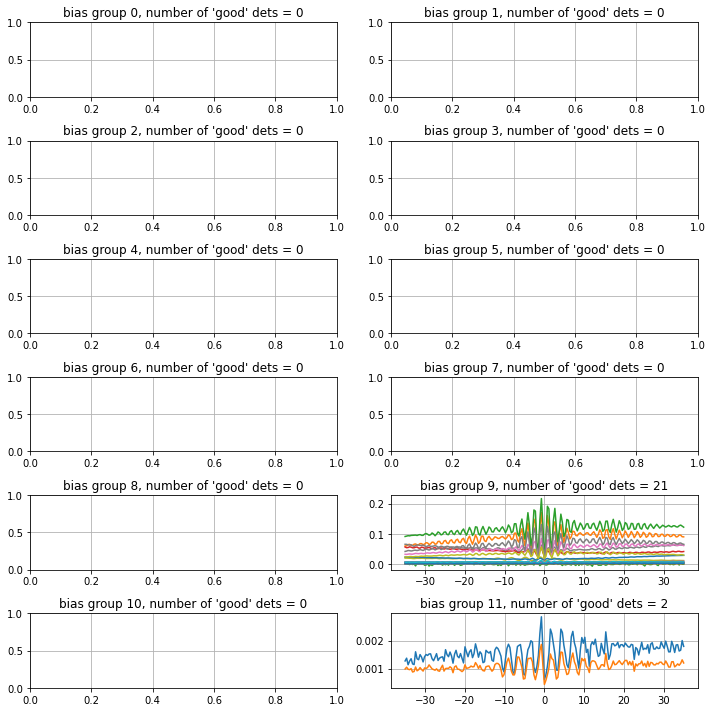

data saved to location FTS_data_integrated/run_23_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 24:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.15s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


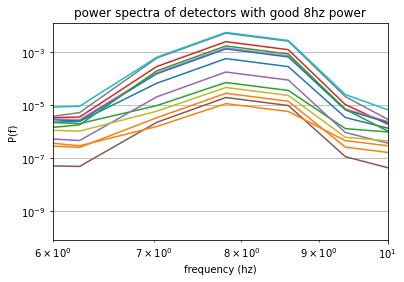

using power threshold of 10:


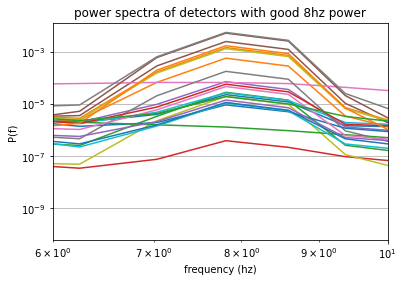

number of detectors with higher power in 8hz = 23


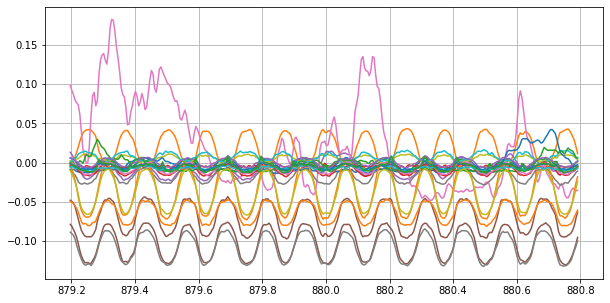

mean, median, std of fitted phases: 4.26, 4.73, 1.18


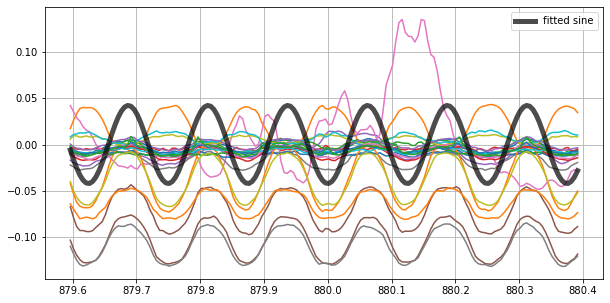

Phase fitting standard deviation is slightly high, check hist


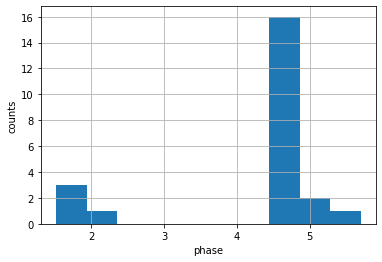

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


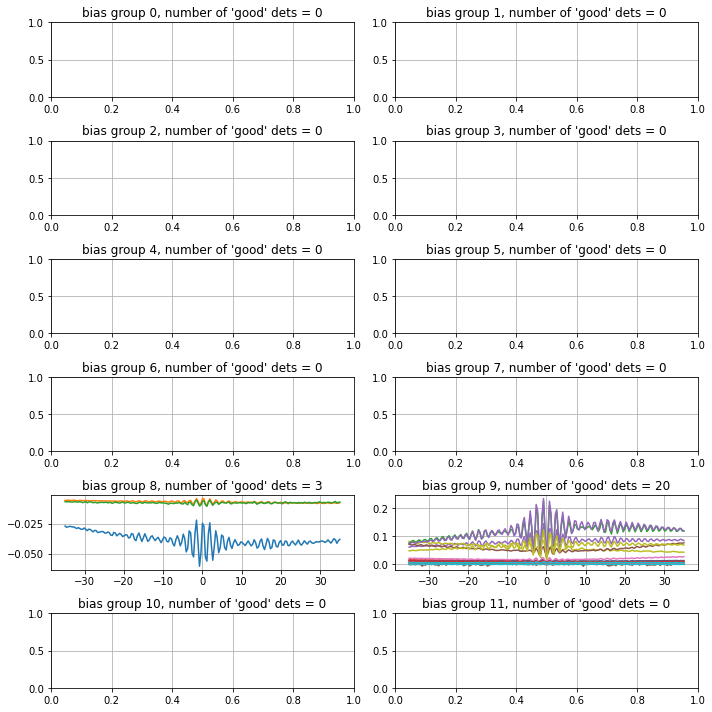

data saved to location FTS_data_integrated/run_24_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 25:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.14s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


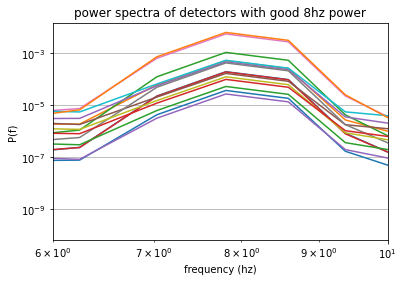

using power threshold of 10:


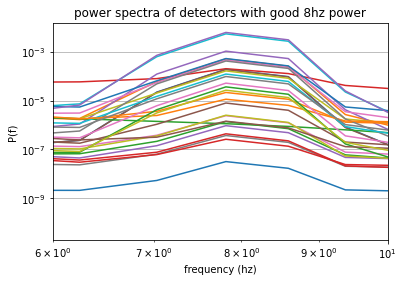

number of detectors with higher power in 8hz = 29


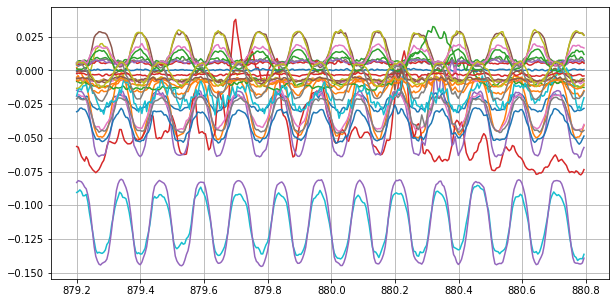

mean, median, std of fitted phases: 2.52, 3.41, 1.46


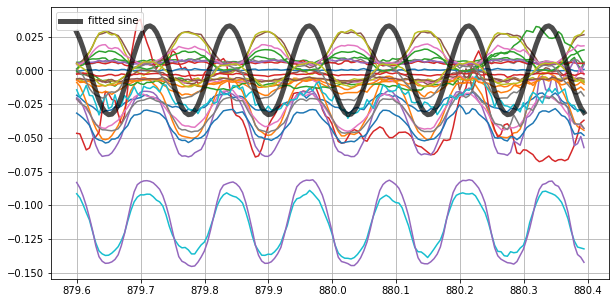

Phase fitting standard deviation is slightly high, check hist


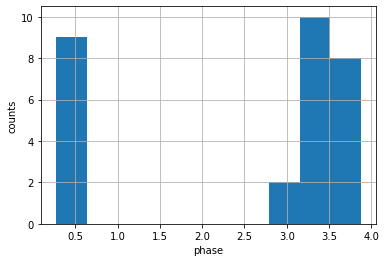

number of interferograms in bias group -1: 0


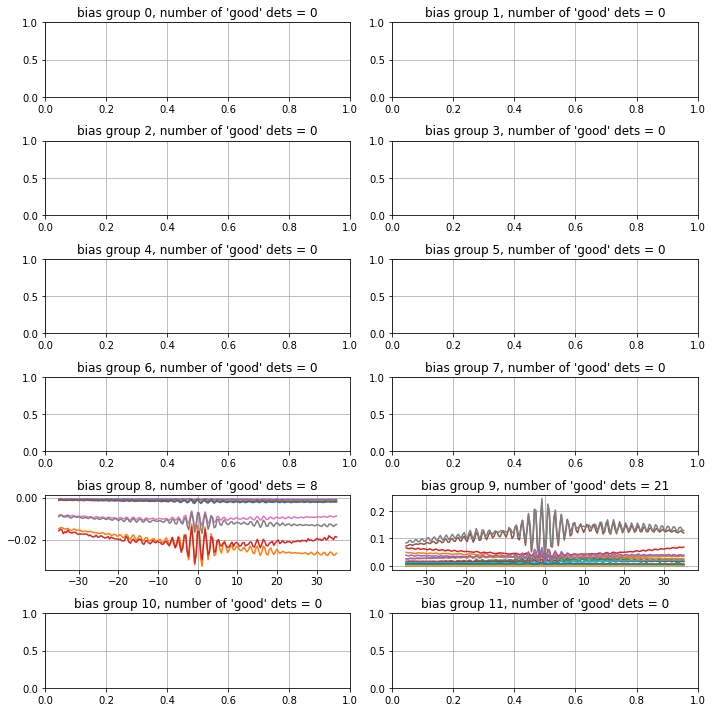

data saved to location FTS_data_integrated/run_25_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 26:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.32s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


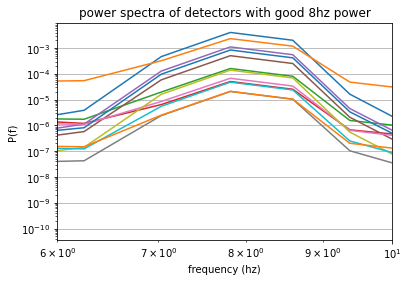

using power threshold of 10:


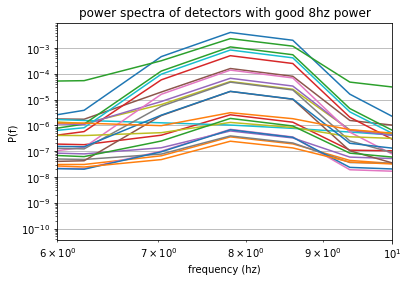

number of detectors with higher power in 8hz = 23


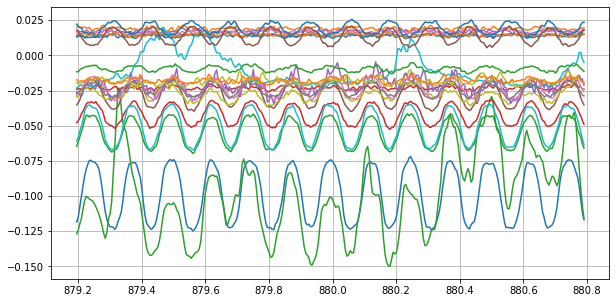

mean, median, std of fitted phases: 2.97, 1.95, 1.60


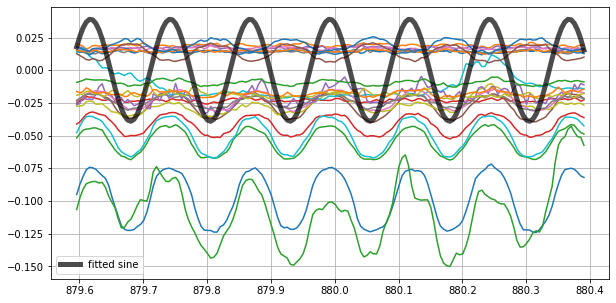

Phase fitting standard deviation is slightly high, check hist


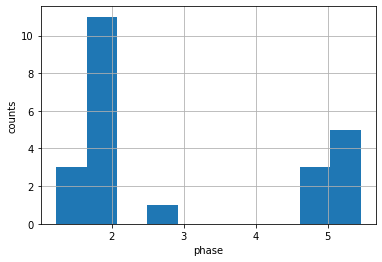

number of interferograms in bias group -1: 0


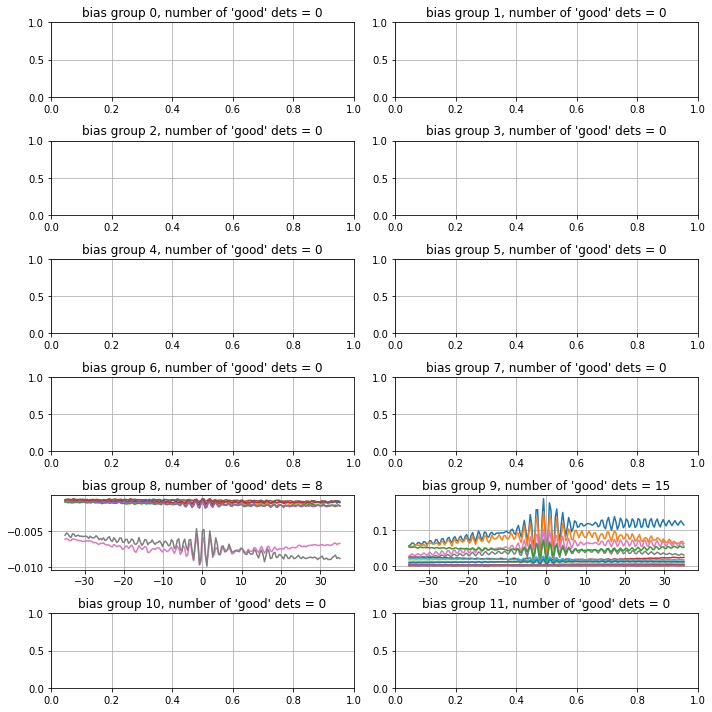

data saved to location FTS_data_integrated/run_26_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 27:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.13s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


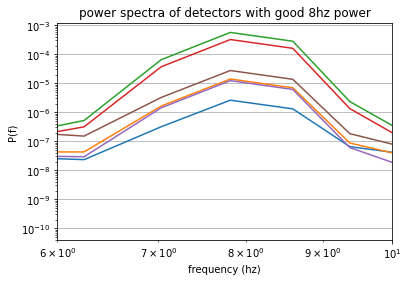

using power threshold of 10:


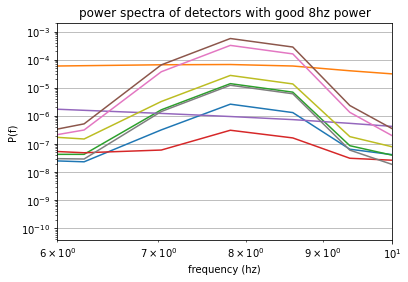

number of detectors with higher power in 8hz = 9


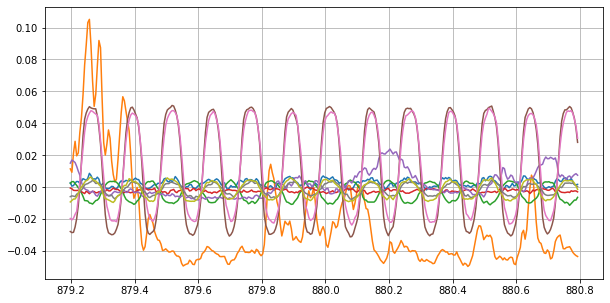

mean, median, std of fitted phases: 1.95, 1.01, 1.49


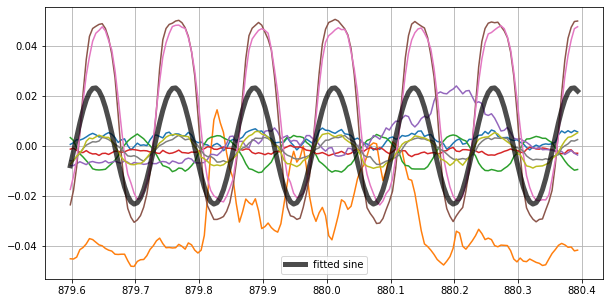

Phase fitting standard deviation is slightly high, check hist


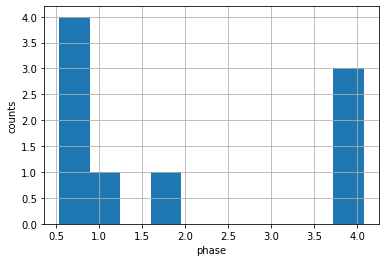

number of interferograms in bias group -1: 0


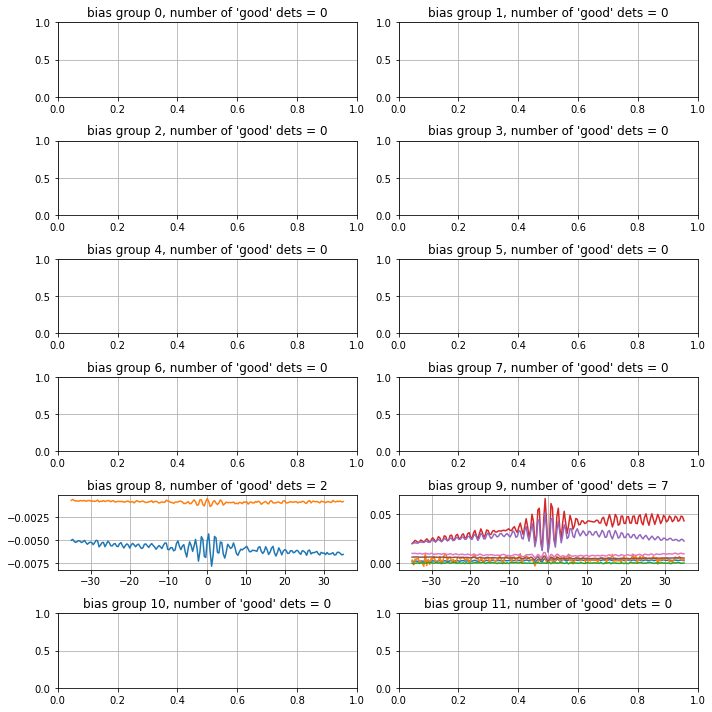

data saved to location FTS_data_integrated/run_27_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 28:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.13s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


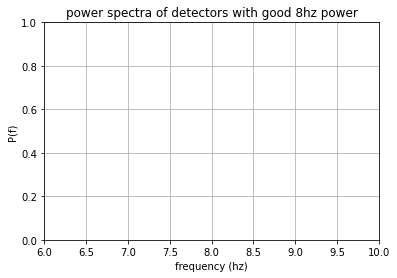

using power threshold of 10:


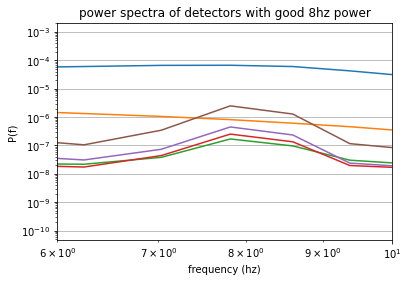

number of detectors with higher power in 8hz = 6


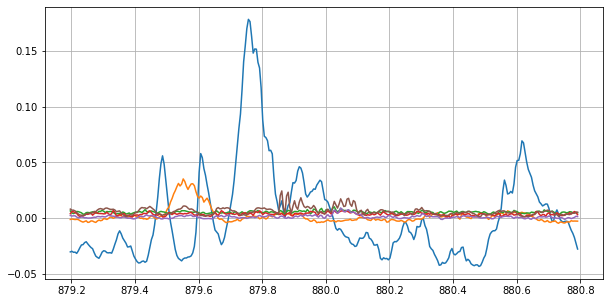

mean, median, std of fitted phases: 4.47, 5.01, 1.31


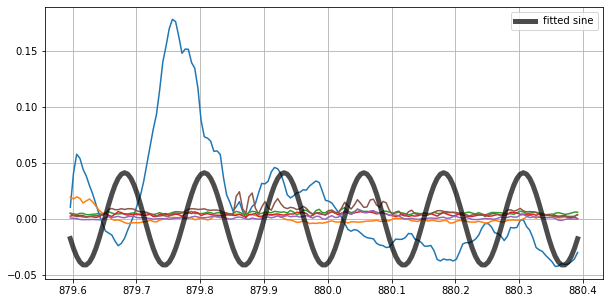

Phase fitting standard deviation is slightly high, check hist


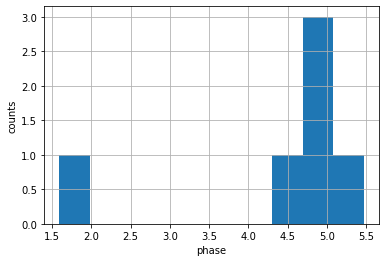

number of interferograms in bias group -1: 0


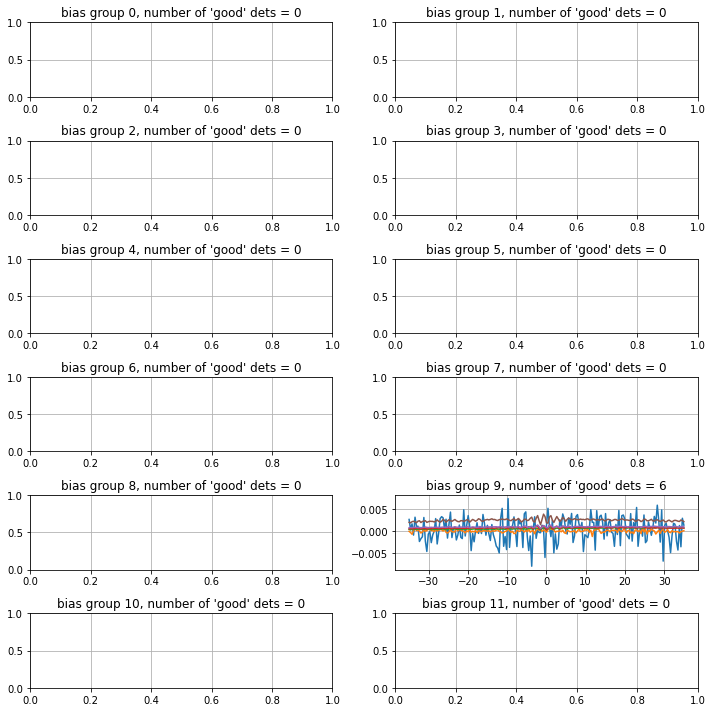

data saved to location FTS_data_integrated/run_28_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 29:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.14s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


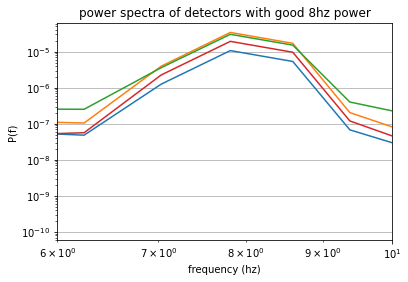

using power threshold of 10:


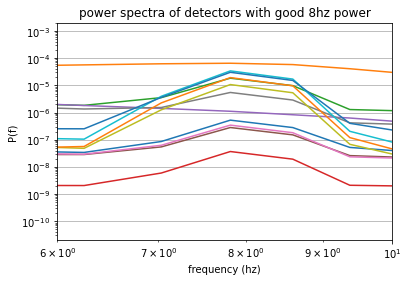

number of detectors with higher power in 8hz = 12


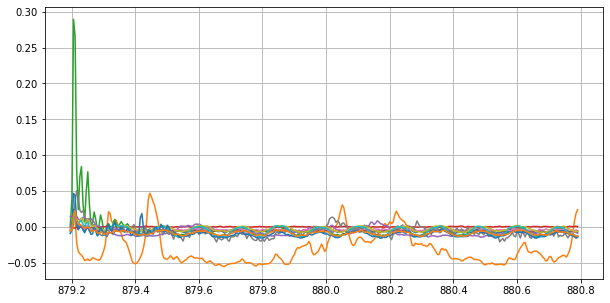

mean, median, std of fitted phases: 2.96, 2.83, 0.93


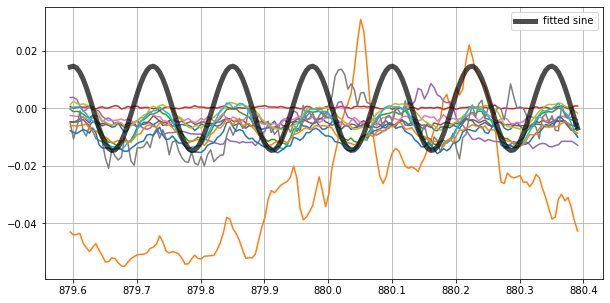

Phase fitting standard deviation is slightly high, check hist


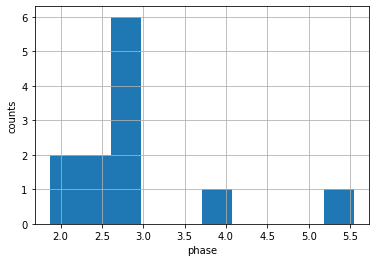

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


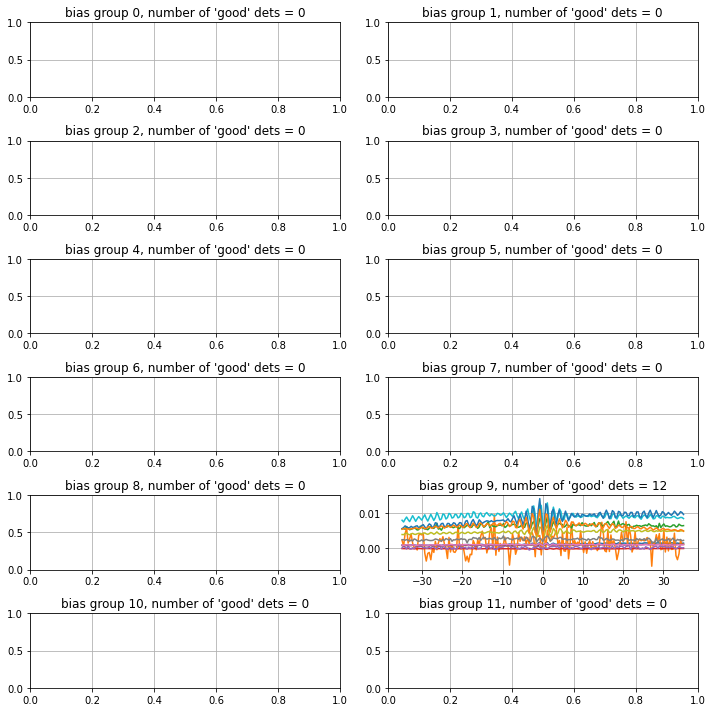

data saved to location FTS_data_integrated/run_29_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 30:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.15s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


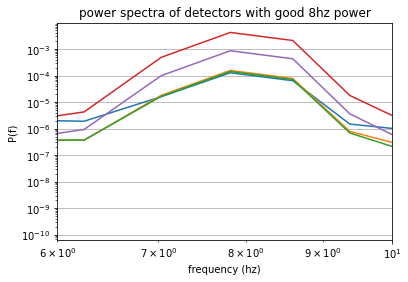

using power threshold of 10:


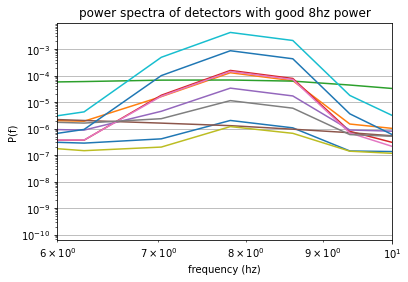

number of detectors with higher power in 8hz = 11


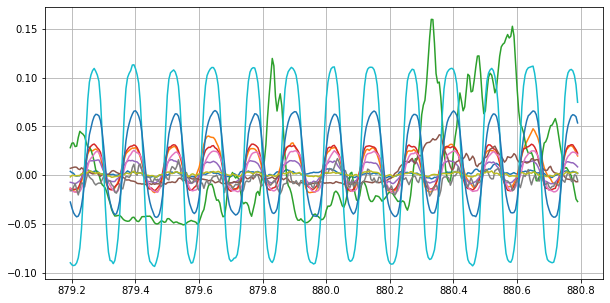

mean, median, std of fitted phases: 1.10, 0.68, 1.11


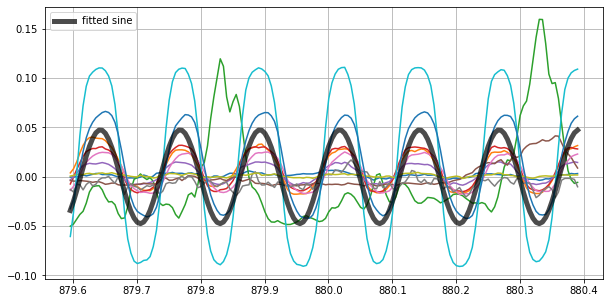

Phase fitting standard deviation is slightly high, check hist


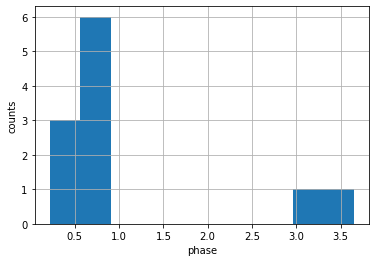

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


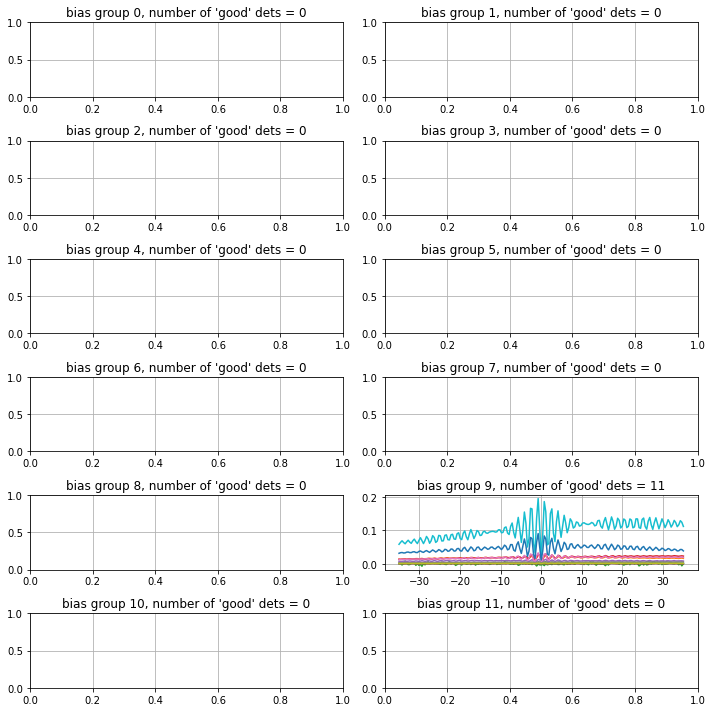

data saved to location FTS_data_integrated/run_30_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 31:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.13s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


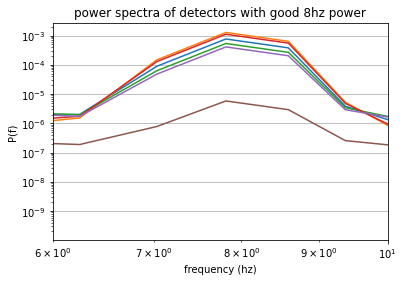

using power threshold of 10:


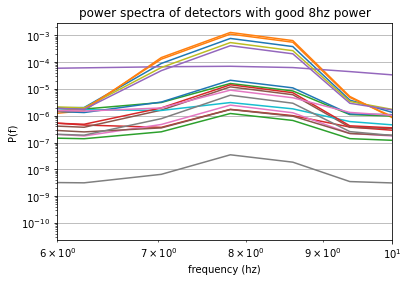

number of detectors with higher power in 8hz = 18


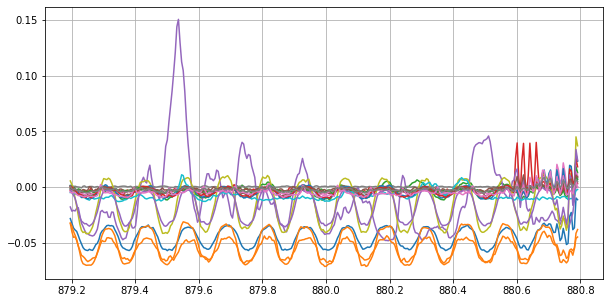

mean, median, std of fitted phases: 4.85, 4.91, 0.81


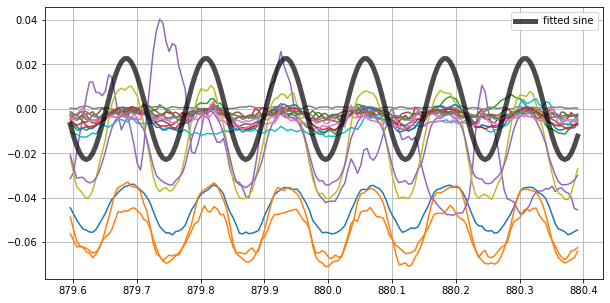

Phase fitting standard deviation is slightly high, check hist


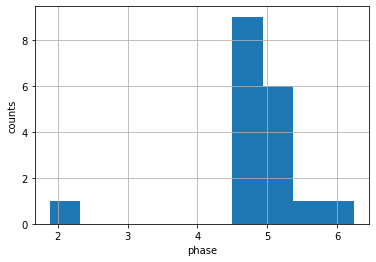

number of interferograms in bias group -1: 0


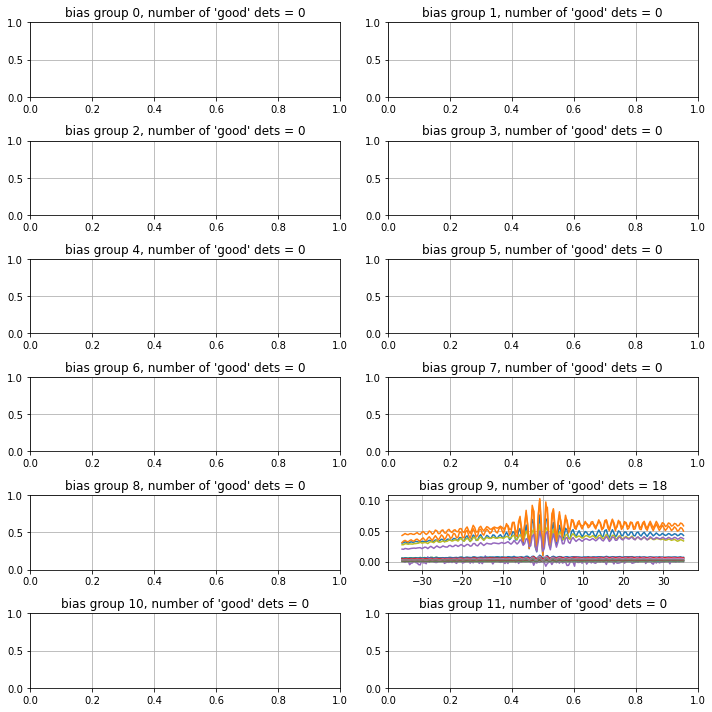

data saved to location FTS_data_integrated/run_31_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 32:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.06s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


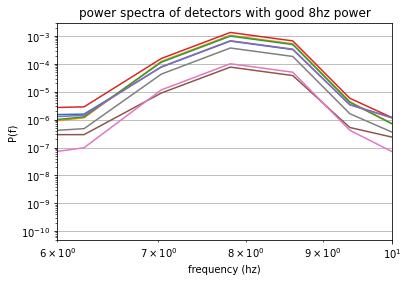

using power threshold of 10:


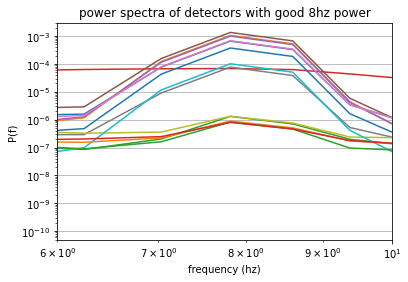

number of detectors with higher power in 8hz = 14


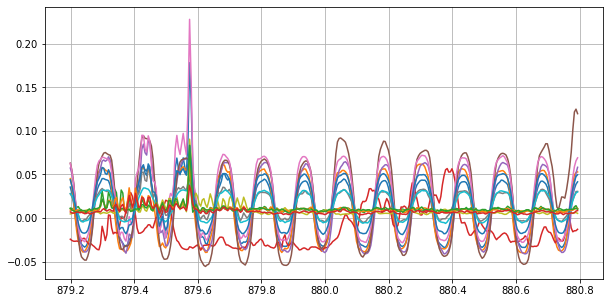

mean, median, std of fitted phases: 4.42, 4.87, 1.21


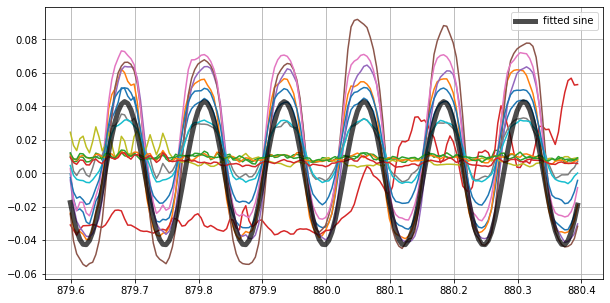

Phase fitting standard deviation is slightly high, check hist


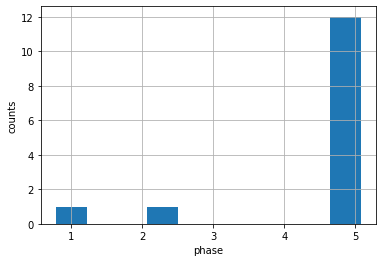

number of interferograms in bias group -1: 0


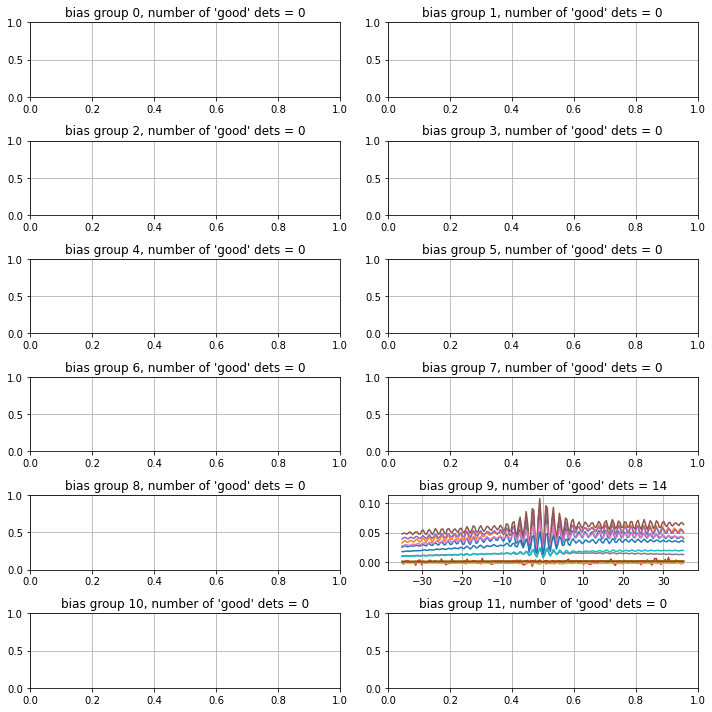

data saved to location FTS_data_integrated/run_32_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 33:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.13s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


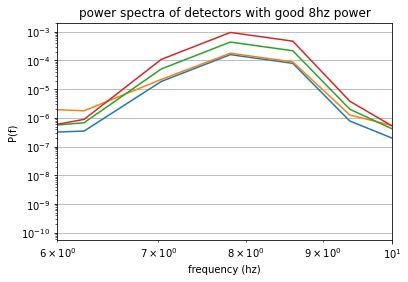

using power threshold of 10:


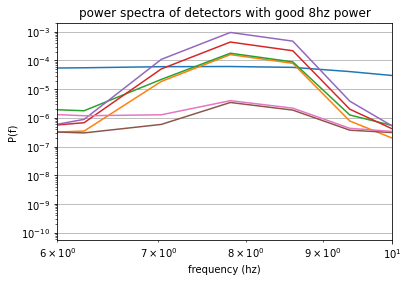

number of detectors with higher power in 8hz = 7


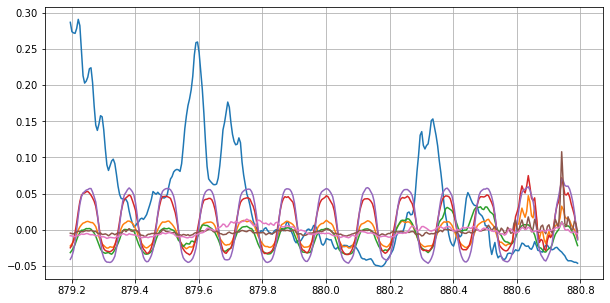

mean, median, std of fitted phases: 1.81, 1.53, 0.66


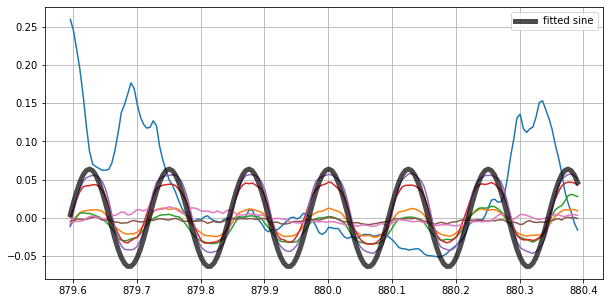

Phase fitting standard deviation is slightly high, check hist


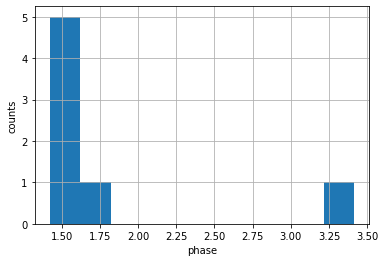

number of interferograms in bias group -1: 0


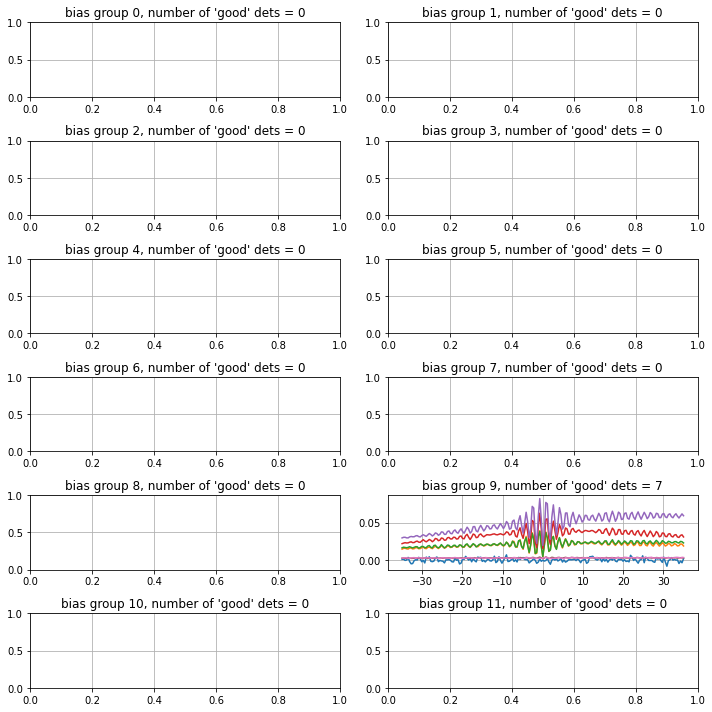

data saved to location FTS_data_integrated/run_33_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 34:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.17s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


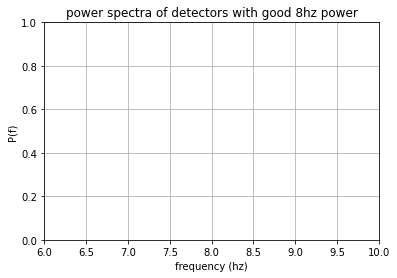

using power threshold of 10:


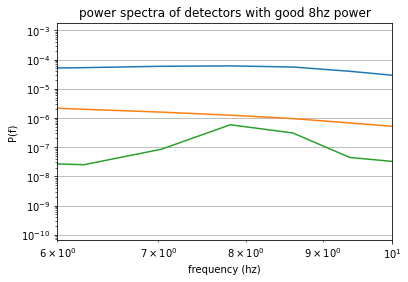

number of detectors with higher power in 8hz = 3
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


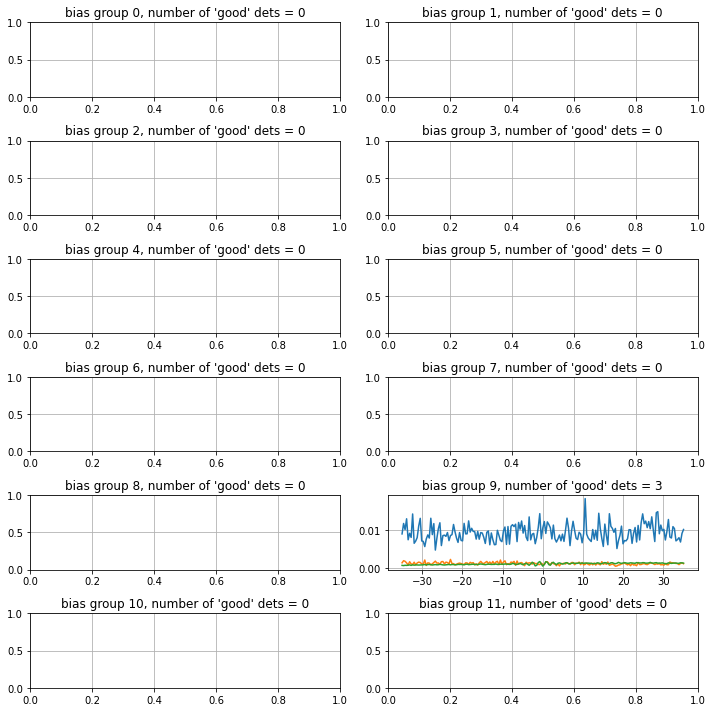

data saved to location FTS_data_integrated/run_34_interferograms.npz


In [5]:
# Process each of the fts scans.
for n in range(1, len(obs_list)):
    hk_data = load_range(
        obs_list[n].start, obs_list[n].stop,
        config='/data/users/kmharrin/smurf_context/hk_config_202104.yaml')
    print(90 * '-')
    print('processing data for run %s:' %n)
    aman = SMURF.load_data(np.min(hk_data['xy_stage_x'][0]), np.max(hk_data['xy_stage_x'][0]),
                           channels=bias_groups[ln1][:,:2])
    utils.load_bias_group(aman, utils.find_last_bg_map(SMURF, obs.stream_id, obs.timestamp))
    process_run_ufm(aman, plot=True, threshold=.5, folder_name='FTS_data_integrated', 
                    band_channel_map=band_channel_map, resolution=.375, 
                    middle_relative_time=880, nperseg=(2 ** 8))

In [6]:
bg8 = np.any([bias_groups[:,2] == 8], axis=0)
bg9 = np.any([bias_groups[:,2] == 9], axis=0)
bg10 = np.any([bias_groups[:,2] == 10], axis=0)
bg11 = np.any([bias_groups[:,2] == 11], axis=0)

------------------------------------------------------------------------------------------
processing data for run 1:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


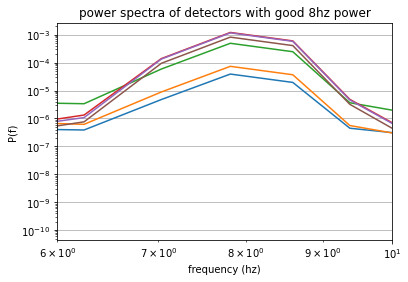

using power threshold of 10:


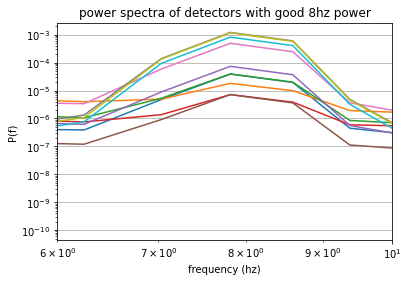

number of detectors with higher power in 8hz = 10


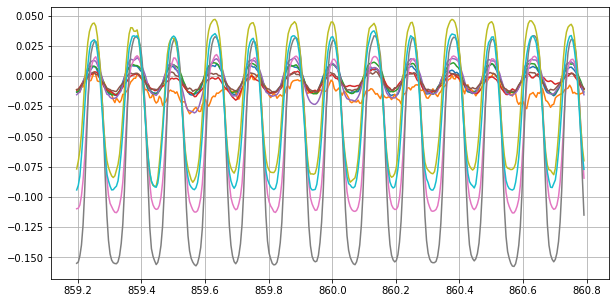

mean, median, std of fitted phases: 1.43, 1.51, 0.15


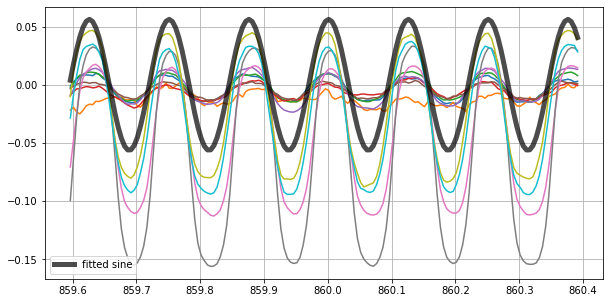

number of interferograms in bias group -1: 0


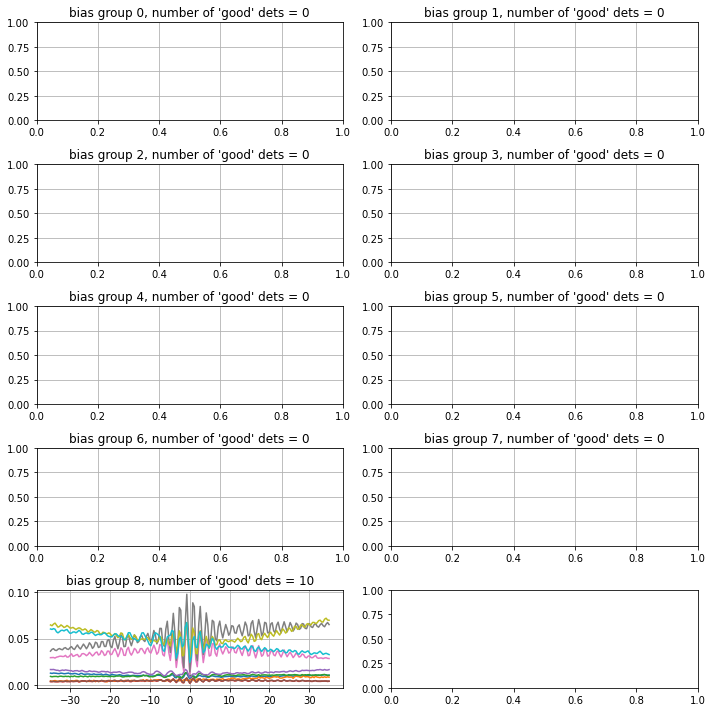

data saved to location FTS_data_integrated_bg8/run_1_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 2:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


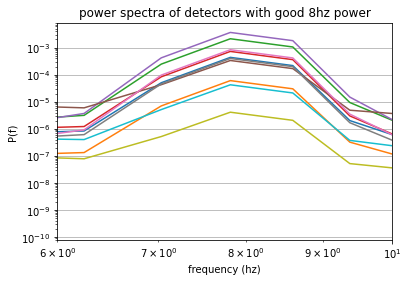

using power threshold of 10:


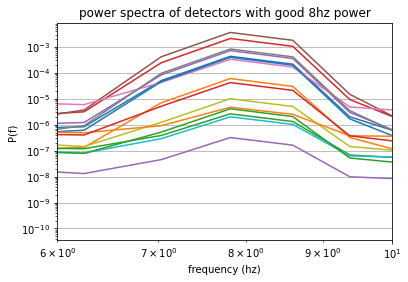

number of detectors with higher power in 8hz = 15


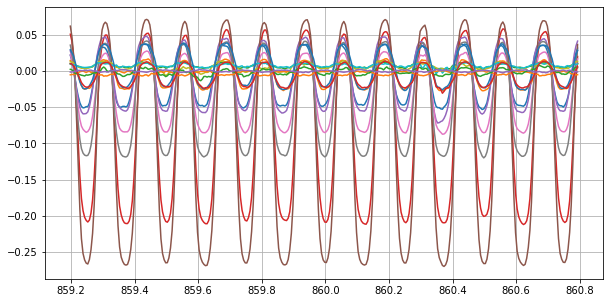

mean, median, std of fitted phases: 4.55, 4.94, 1.04


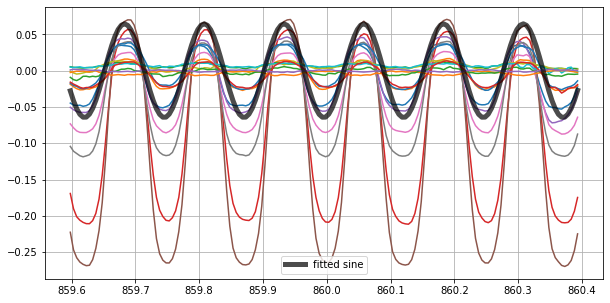

Phase fitting standard deviation is slightly high, check hist


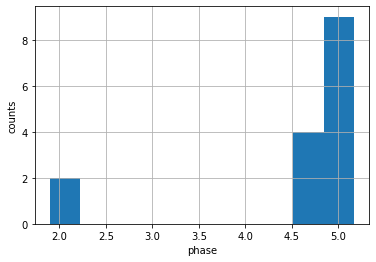

number of interferograms in bias group -1: 0


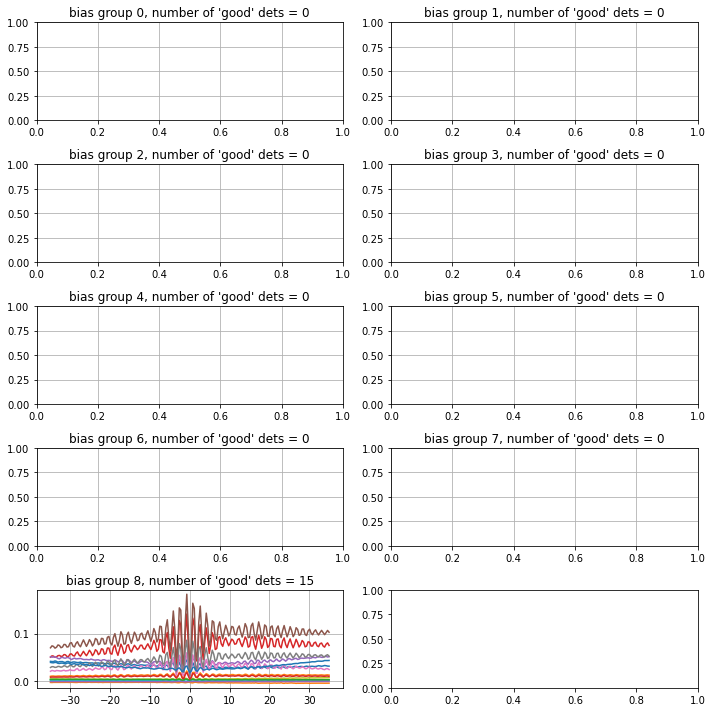

data saved to location FTS_data_integrated_bg8/run_2_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 3:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


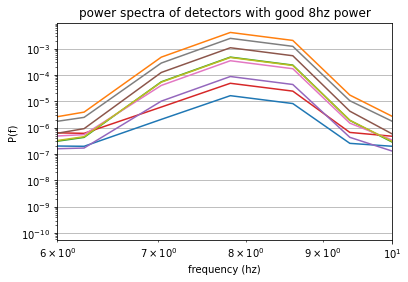

using power threshold of 10:


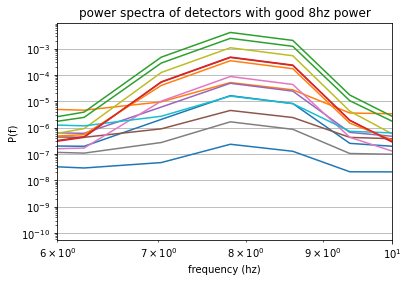

number of detectors with higher power in 8hz = 14


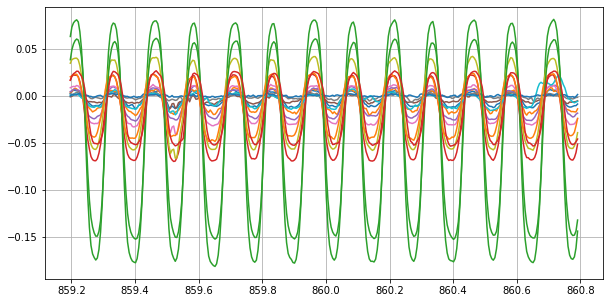

mean, median, std of fitted phases: 3.63, 3.66, 0.12


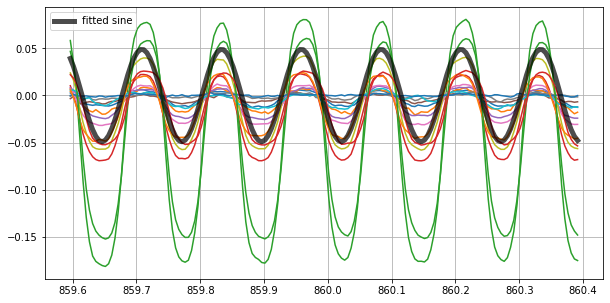

number of interferograms in bias group -1: 0


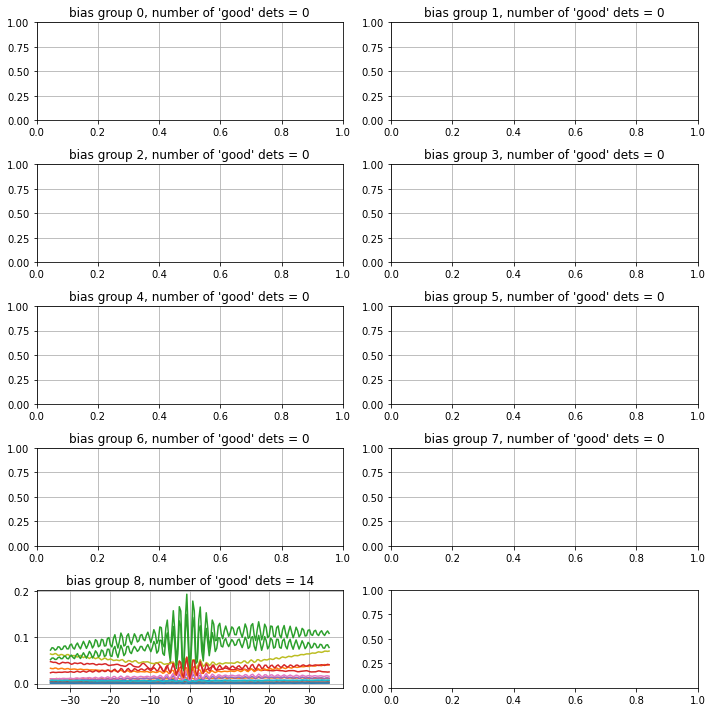

data saved to location FTS_data_integrated_bg8/run_3_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 4:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


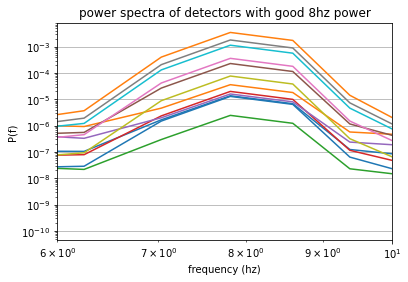

using power threshold of 10:


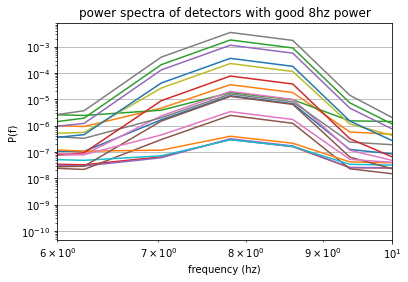

number of detectors with higher power in 8hz = 18


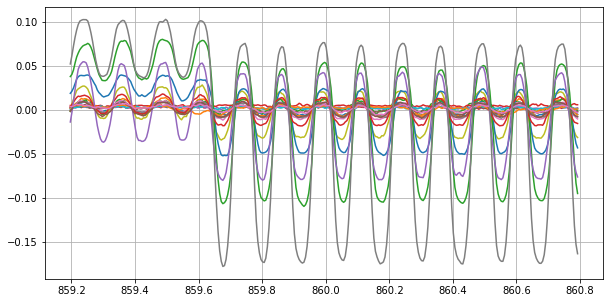

mean, median, std of fitted phases: 2.10, 2.27, 0.68


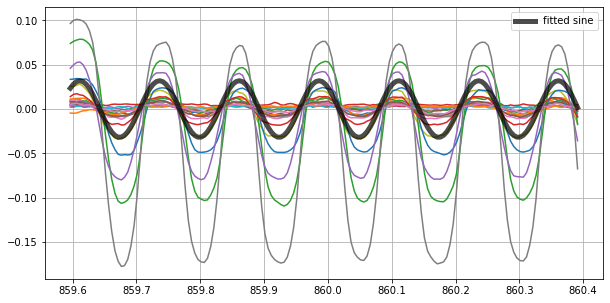

Phase fitting standard deviation is slightly high, check hist


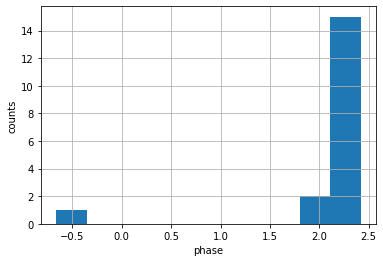

number of interferograms in bias group -1: 0


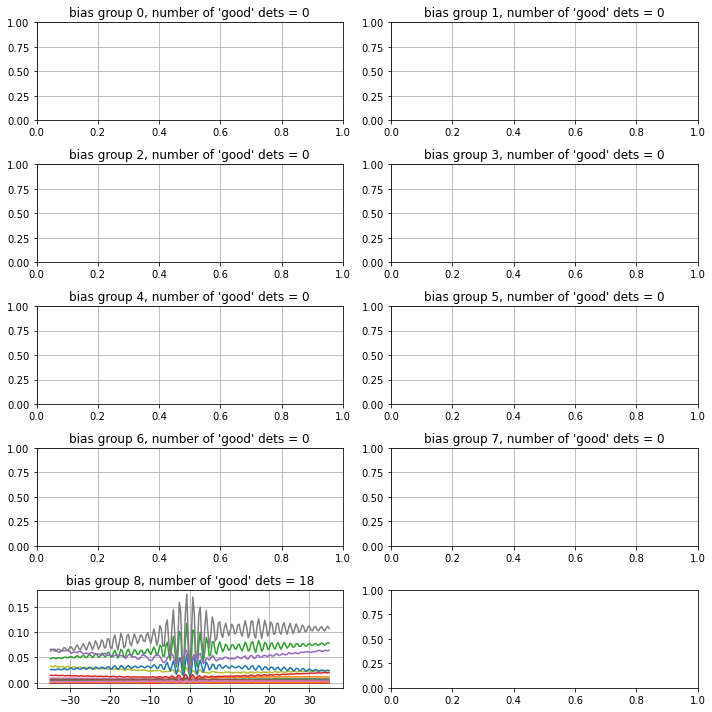

data saved to location FTS_data_integrated_bg8/run_4_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 5:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.15it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


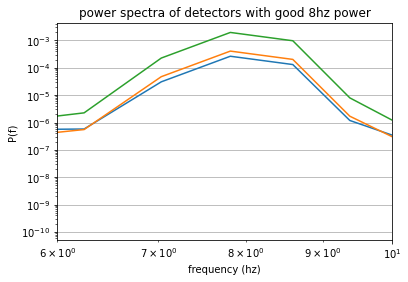

using power threshold of 10:


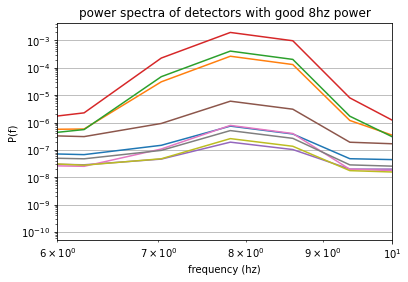

number of detectors with higher power in 8hz = 9


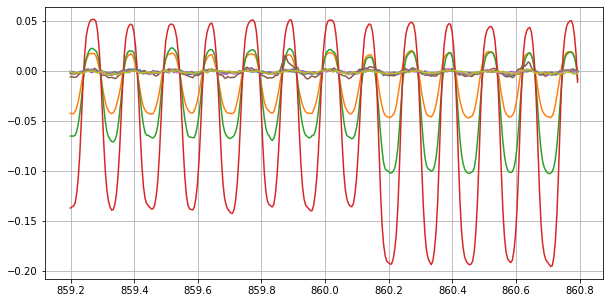

mean, median, std of fitted phases: 0.78, 0.79, 0.08


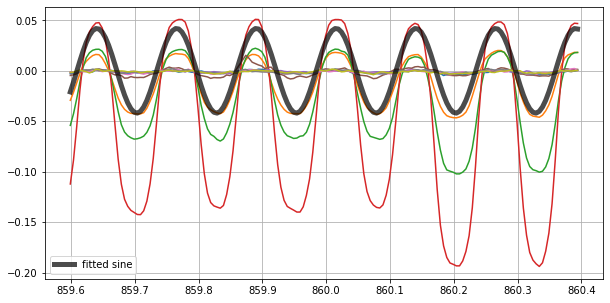

number of interferograms in bias group -1: 0


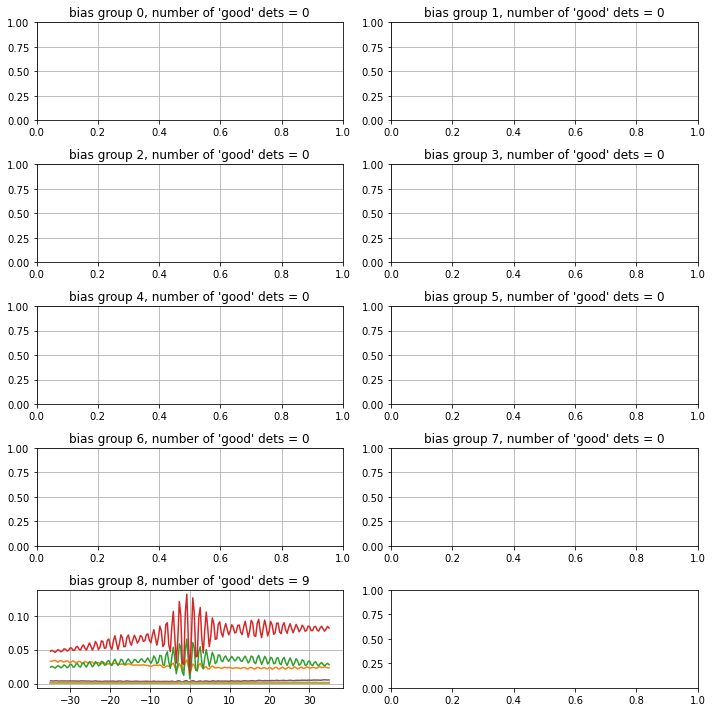

data saved to location FTS_data_integrated_bg8/run_5_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 6:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


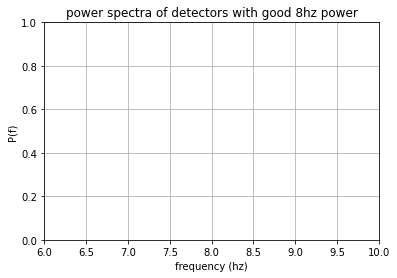

using power threshold of 10:


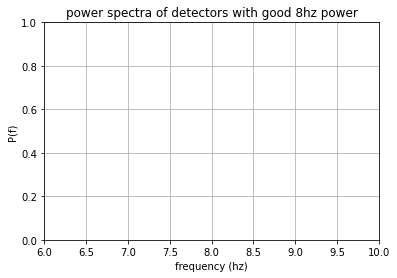

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


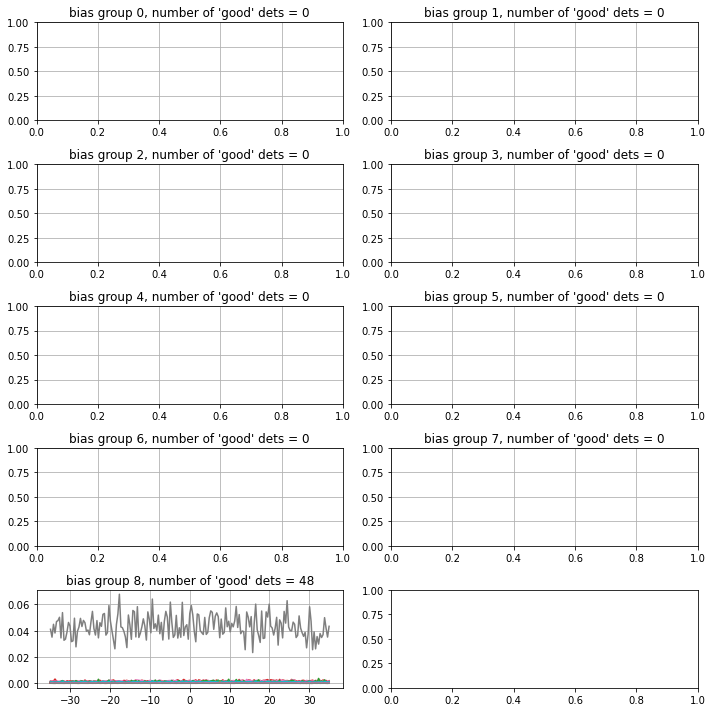

data saved to location FTS_data_integrated_bg8/run_6_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 7:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.16it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


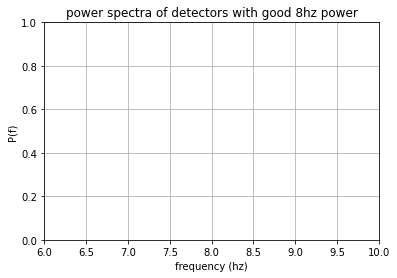

using power threshold of 10:


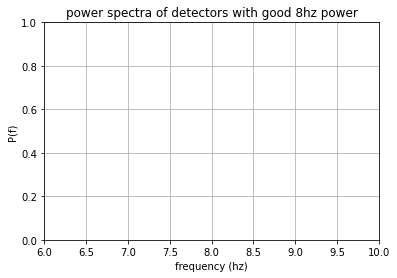

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


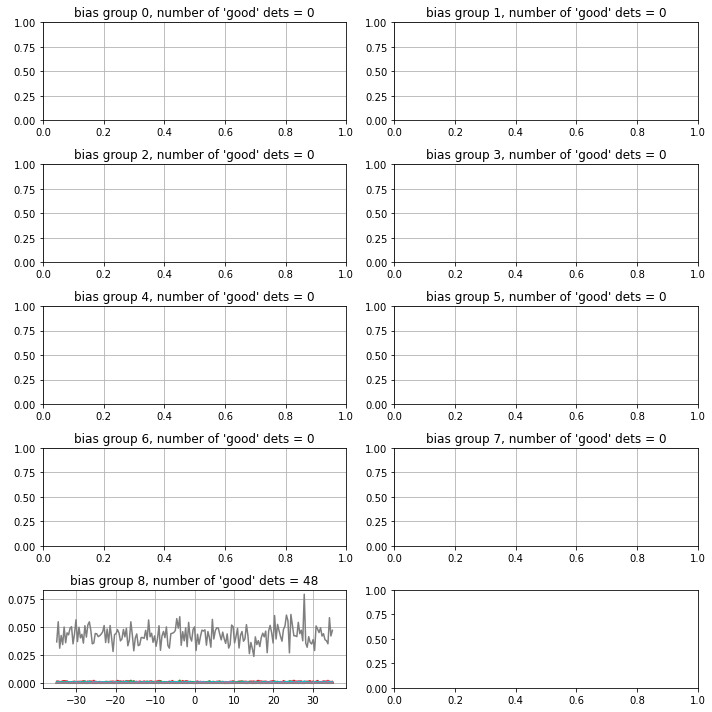

data saved to location FTS_data_integrated_bg8/run_7_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 8:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.11it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


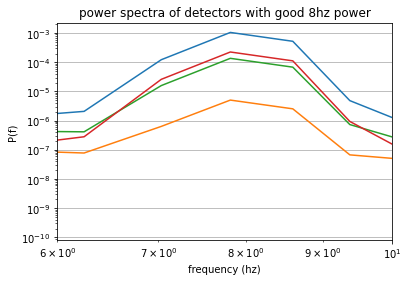

using power threshold of 10:


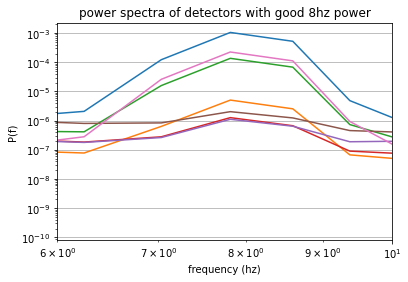

number of detectors with higher power in 8hz = 7


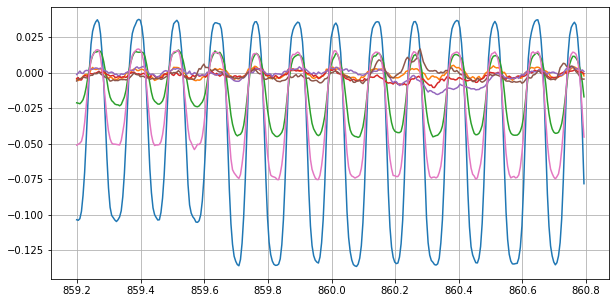

mean, median, std of fitted phases: 0.90, 0.94, 0.10


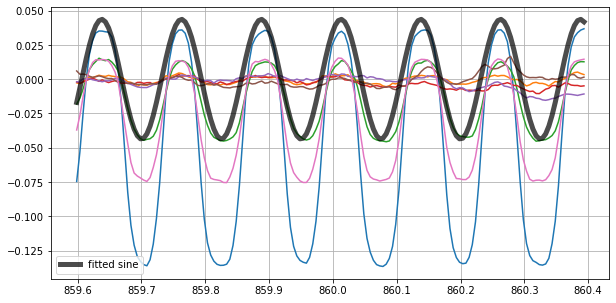

number of interferograms in bias group -1: 0


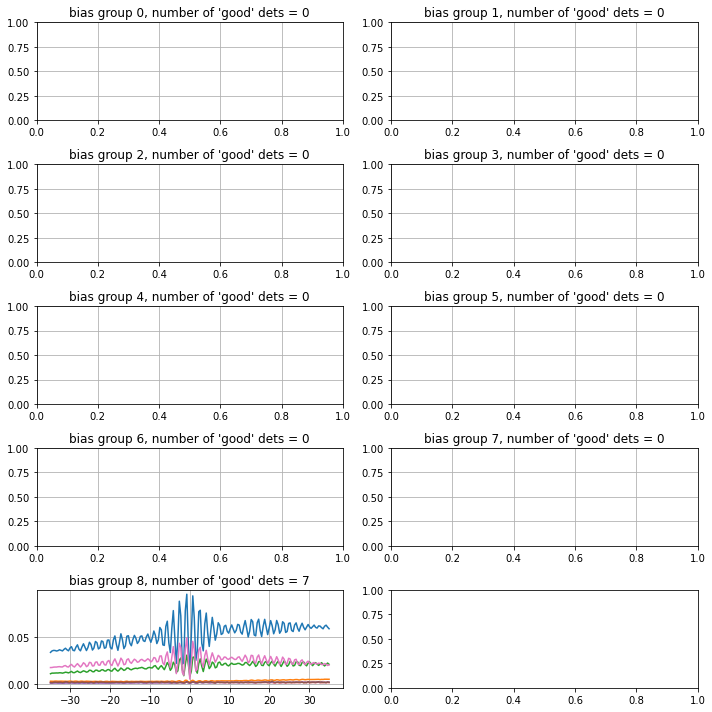

data saved to location FTS_data_integrated_bg8/run_8_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 9:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.10it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


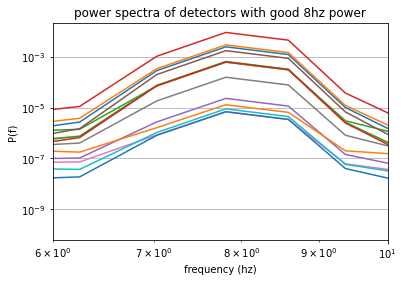

using power threshold of 10:


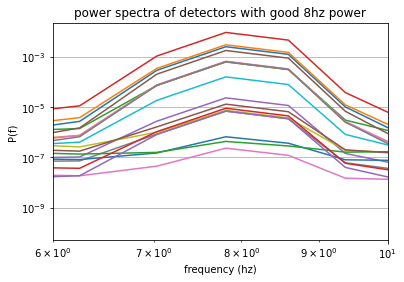

number of detectors with higher power in 8hz = 18


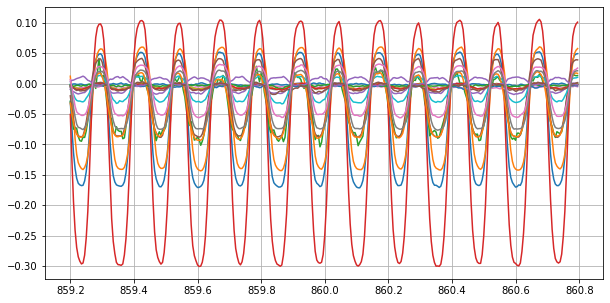

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


mean, median, std of fitted phases: 4.11, 4.07, 1.62


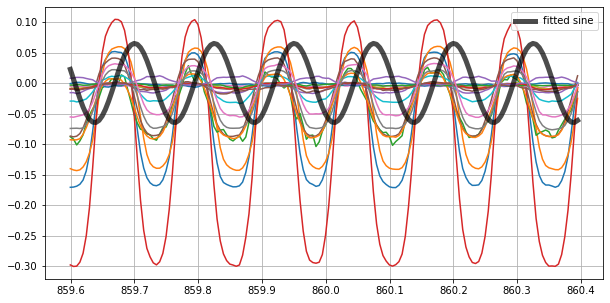

Phase fitting standard deviation is slightly high, check hist


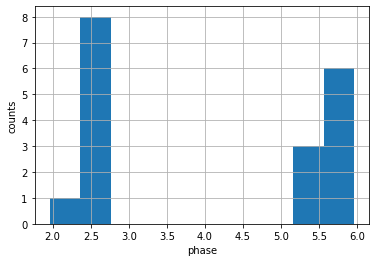

number of interferograms in bias group -1: 0


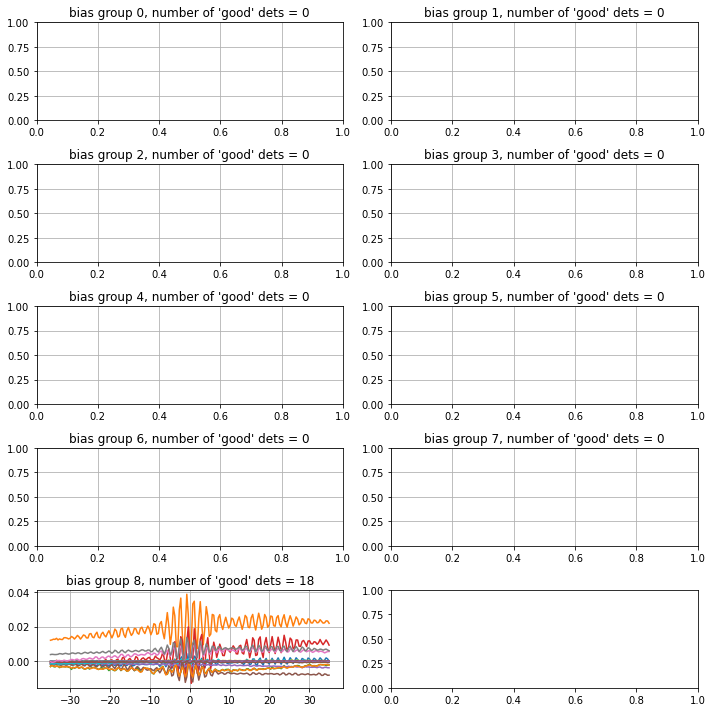

data saved to location FTS_data_integrated_bg8/run_9_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 10:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


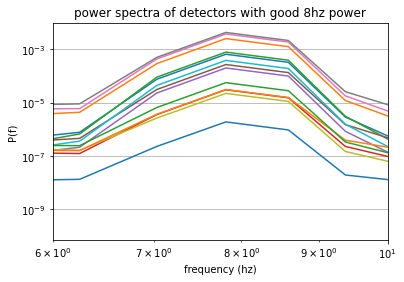

using power threshold of 10:


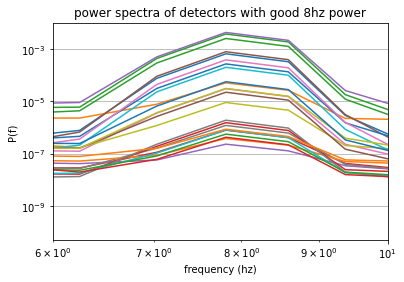

number of detectors with higher power in 8hz = 24


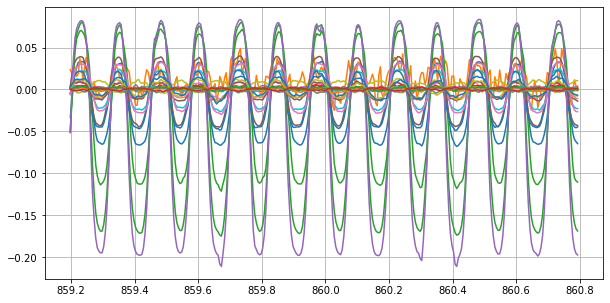

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


mean, median, std of fitted phases: 2.92, 2.67, 0.87


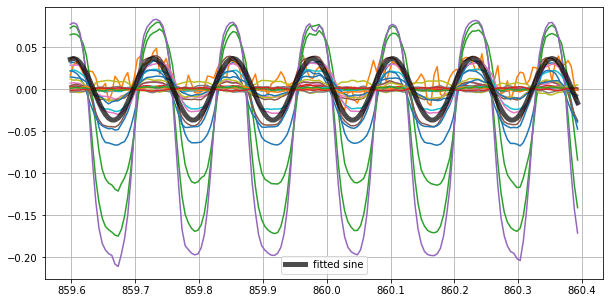

Phase fitting standard deviation is slightly high, check hist


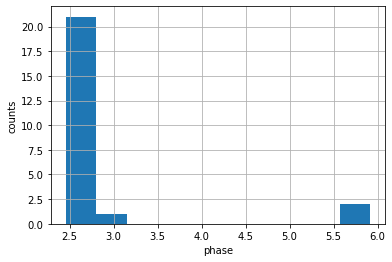

number of interferograms in bias group -1: 0


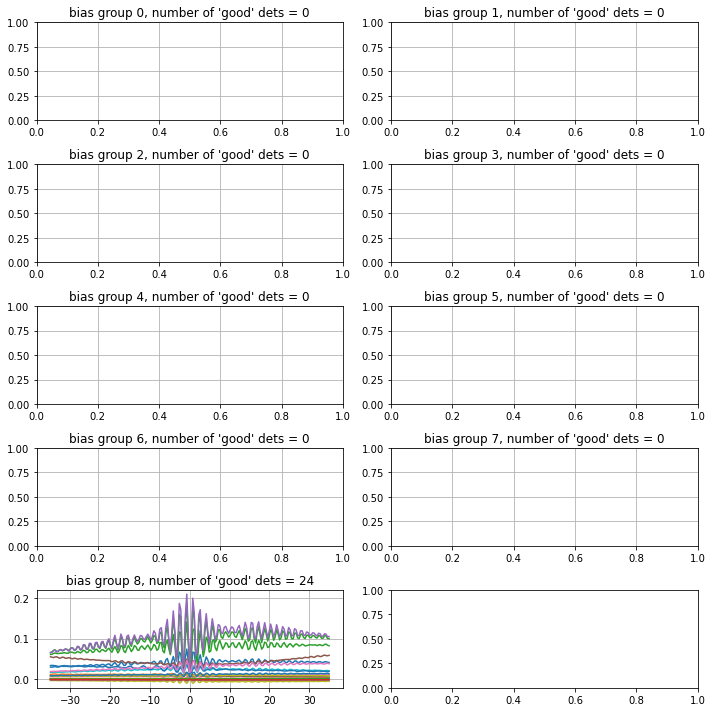

data saved to location FTS_data_integrated_bg8/run_10_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 11:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.10it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


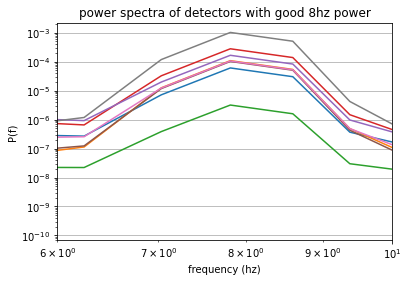

using power threshold of 10:


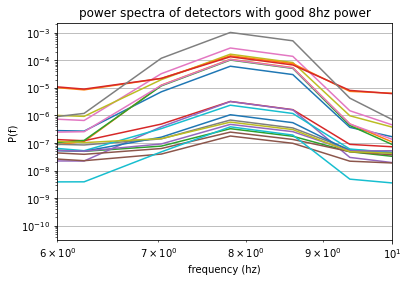

number of detectors with higher power in 8hz = 20


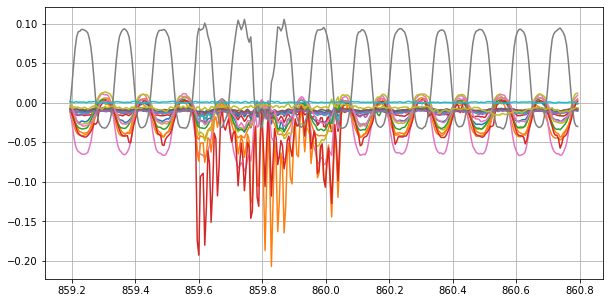

mean, median, std of fitted phases: 4.96, 5.29, 0.95


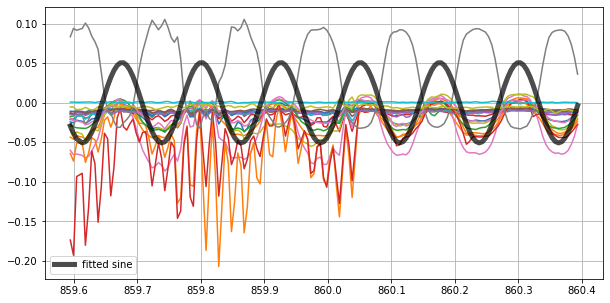

Phase fitting standard deviation is slightly high, check hist


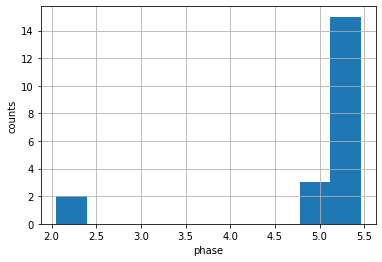

number of interferograms in bias group -1: 0


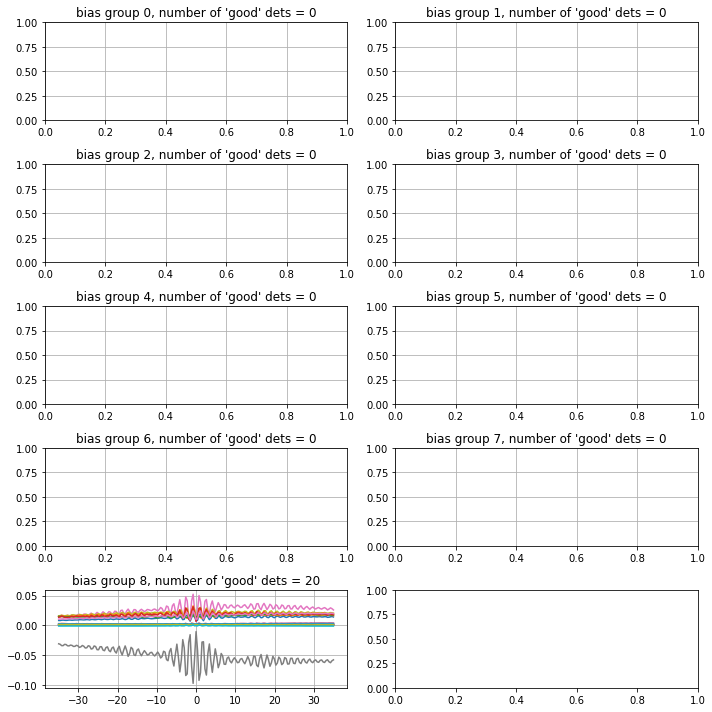

data saved to location FTS_data_integrated_bg8/run_11_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 12:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


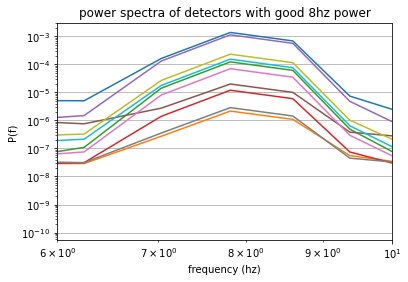

using power threshold of 10:


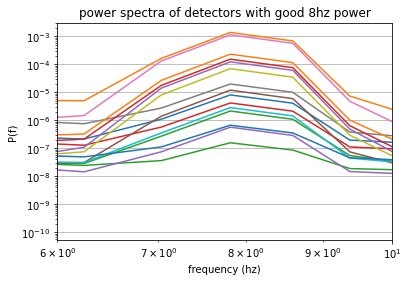

number of detectors with higher power in 8hz = 15


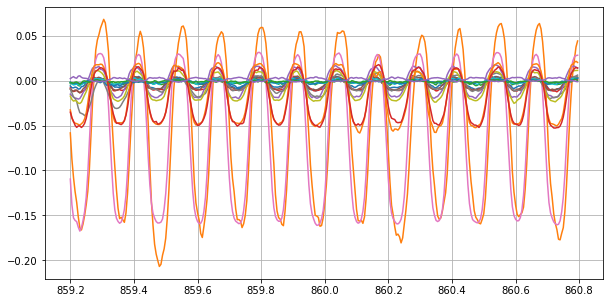

mean, median, std of fitted phases: 5.75, 5.95, 0.80


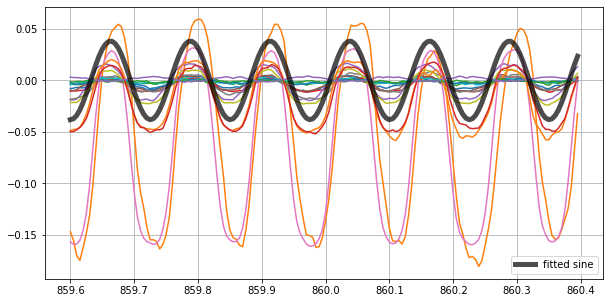

Phase fitting standard deviation is slightly high, check hist


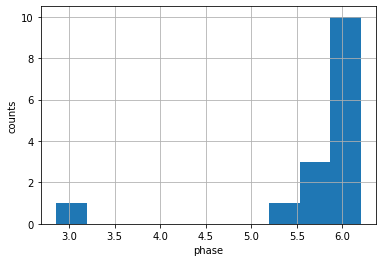

number of interferograms in bias group -1: 0


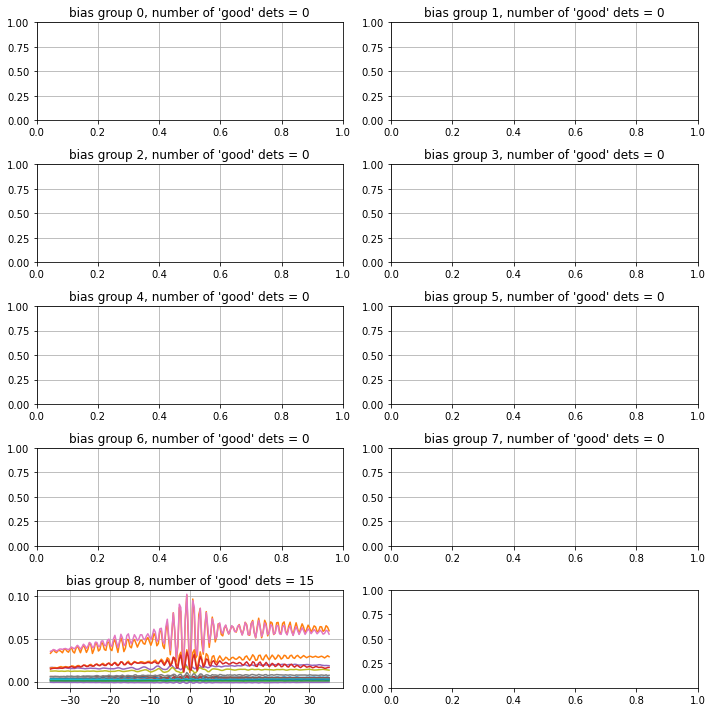

data saved to location FTS_data_integrated_bg8/run_12_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 13:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.10it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


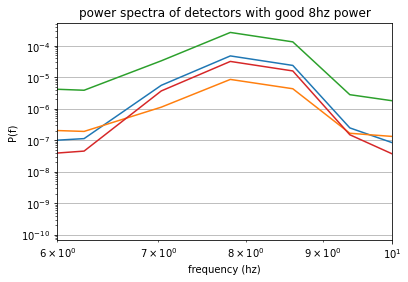

using power threshold of 10:


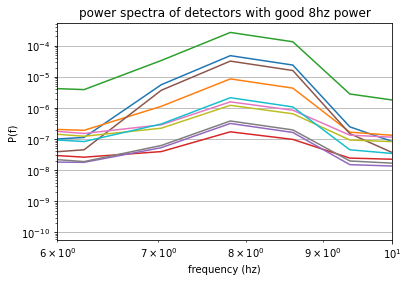

number of detectors with higher power in 8hz = 10


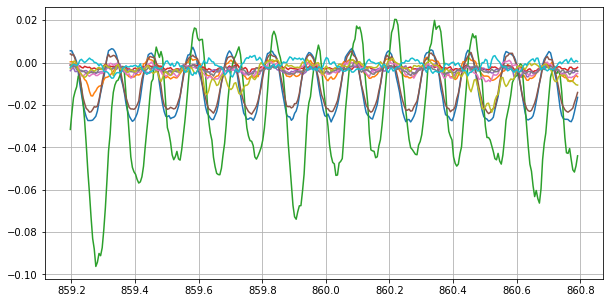

mean, median, std of fitted phases: 3.57, 3.97, 1.02


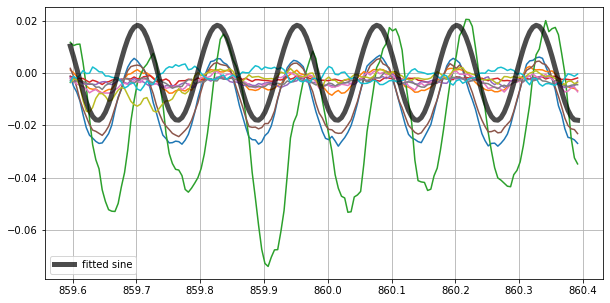

Phase fitting standard deviation is slightly high, check hist


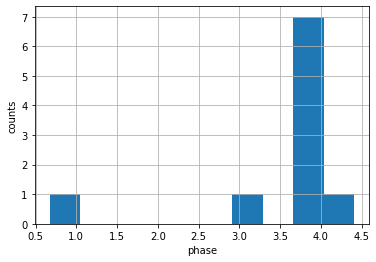

number of interferograms in bias group -1: 0


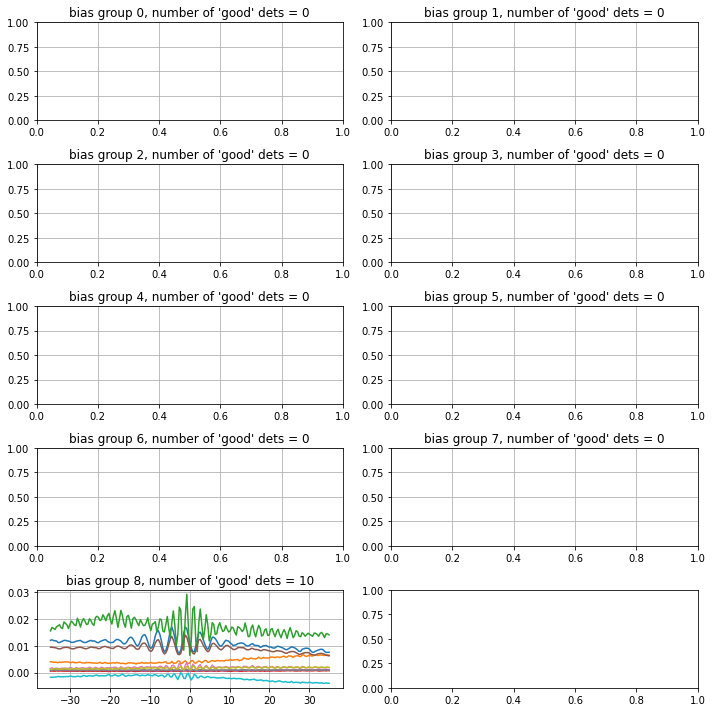

data saved to location FTS_data_integrated_bg8/run_13_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 14:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17223/ufm_lf_ln1_lp5_lp6/1722397615_000.g3
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


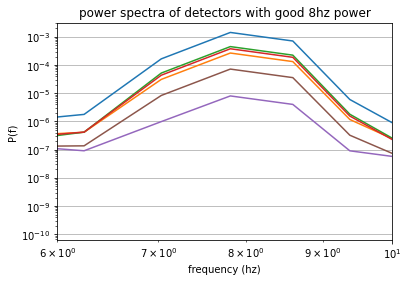

using power threshold of 10:


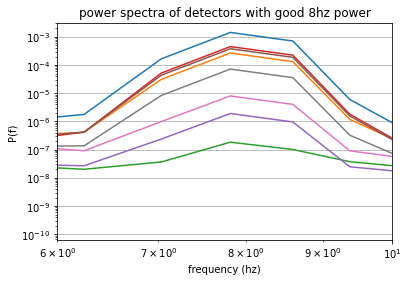

number of detectors with higher power in 8hz = 8


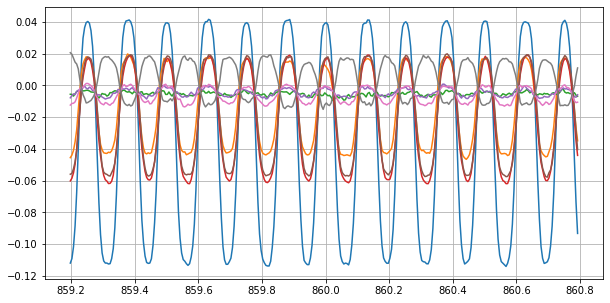

mean, median, std of fitted phases: 1.82, 1.44, 1.00


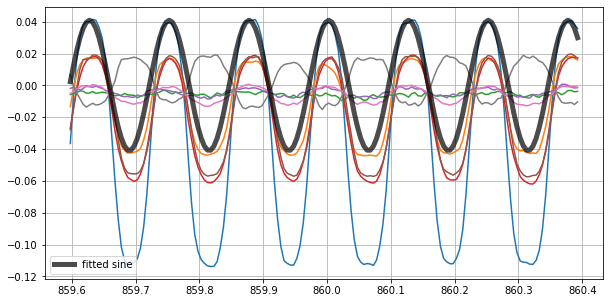

Phase fitting standard deviation is slightly high, check hist


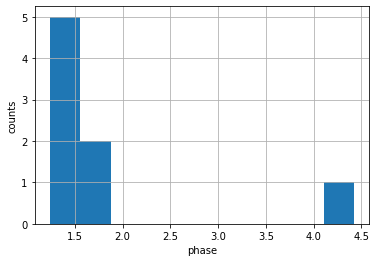

number of interferograms in bias group -1: 0


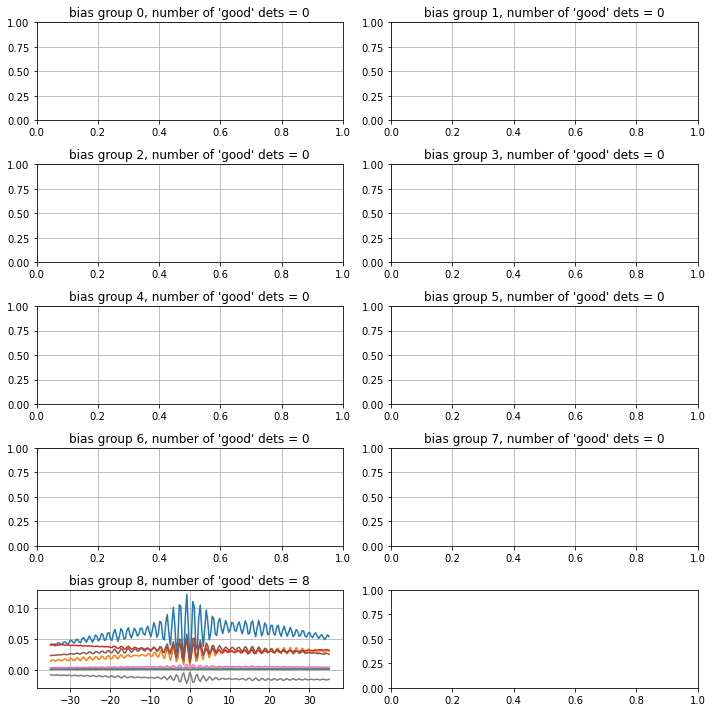

data saved to location FTS_data_integrated_bg8/run_14_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 15:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


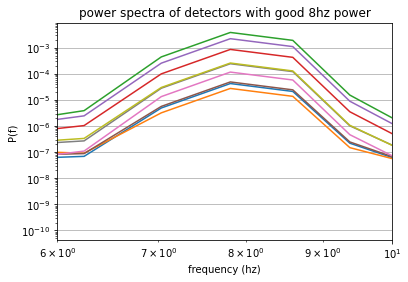

using power threshold of 10:


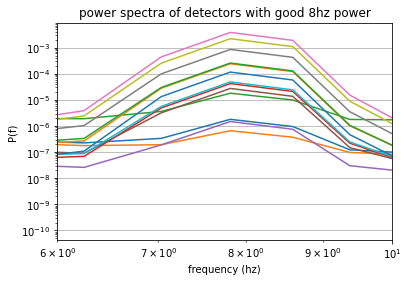

number of detectors with higher power in 8hz = 13


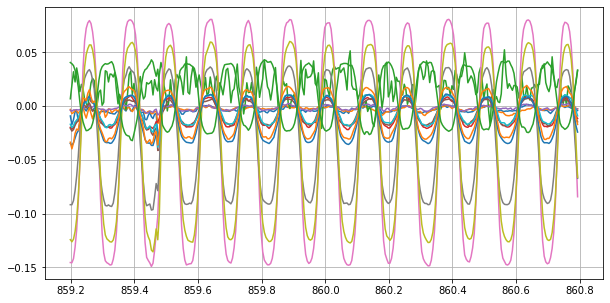

mean, median, std of fitted phases: 1.61, 1.14, 1.18


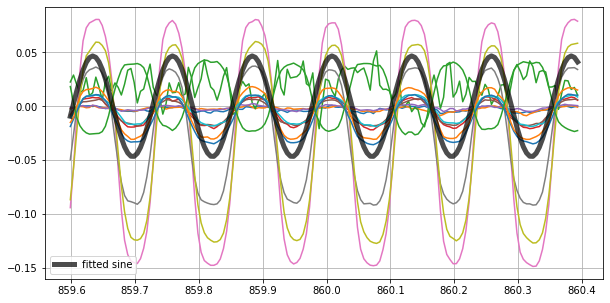

Phase fitting standard deviation is slightly high, check hist


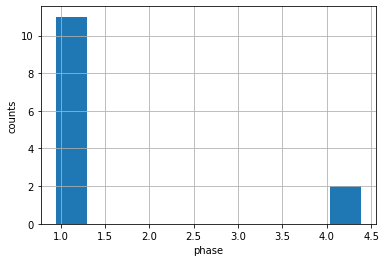

number of interferograms in bias group -1: 0


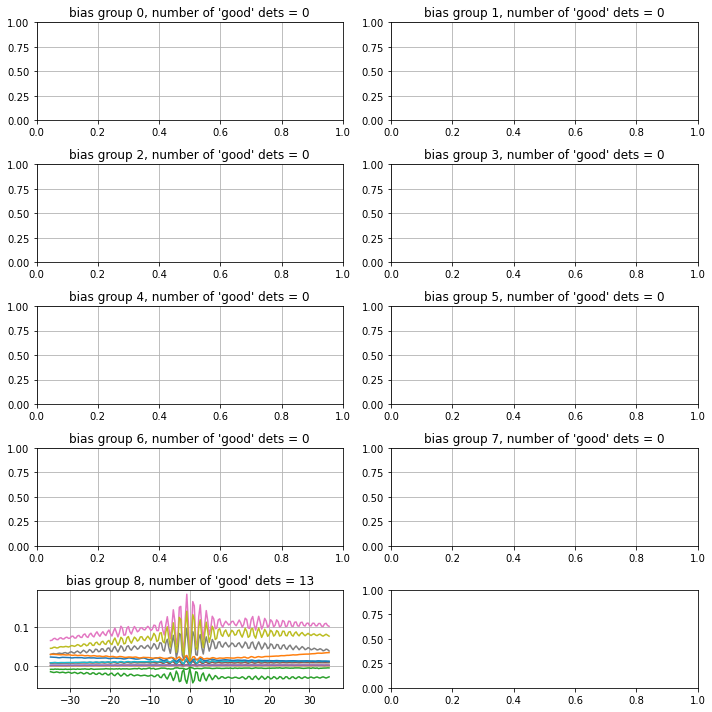

data saved to location FTS_data_integrated_bg8/run_15_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 16:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


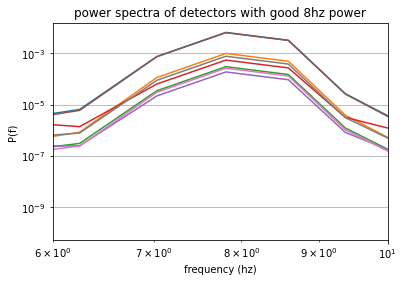

using power threshold of 10:


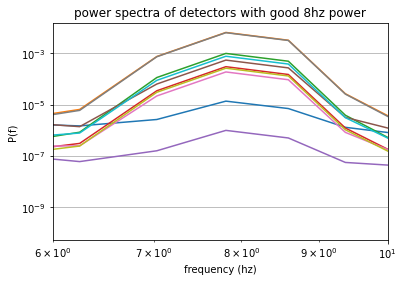

number of detectors with higher power in 8hz = 10


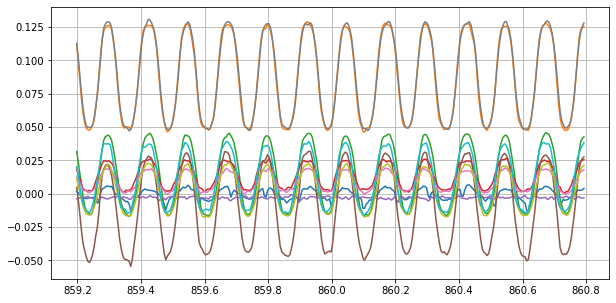

mean, median, std of fitted phases: 4.92, 5.49, 1.18


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


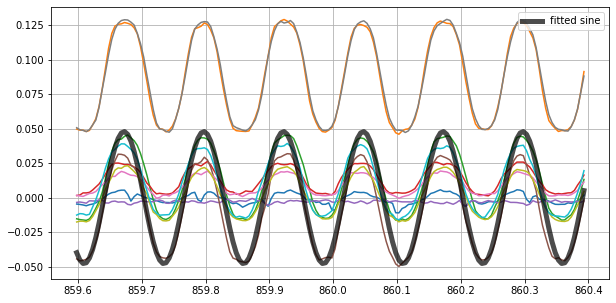

Phase fitting standard deviation is slightly high, check hist


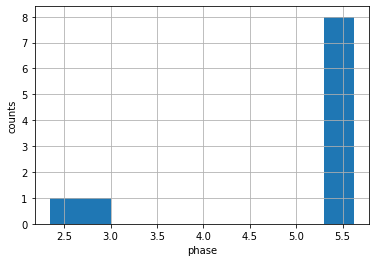

number of interferograms in bias group -1: 0


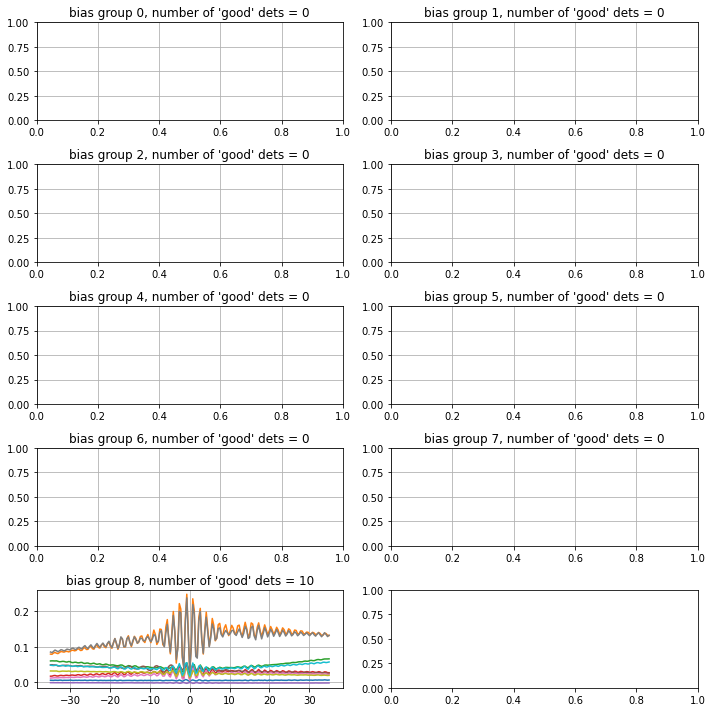

data saved to location FTS_data_integrated_bg8/run_16_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 17:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


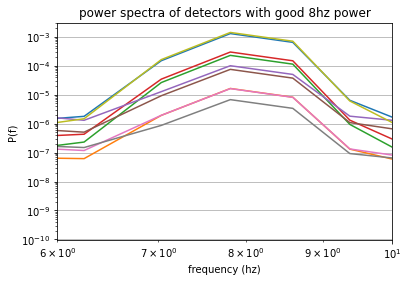

using power threshold of 10:


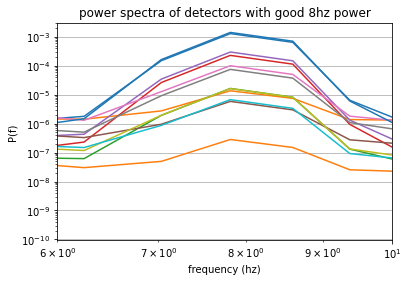

number of detectors with higher power in 8hz = 12


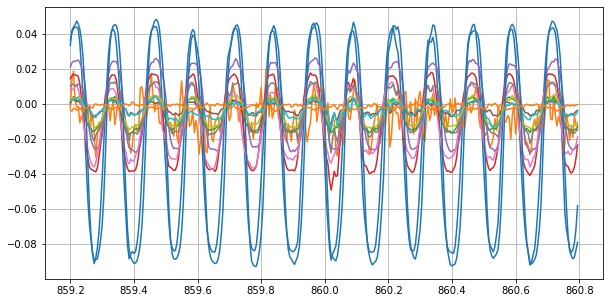

mean, median, std of fitted phases: 3.69, 3.48, 0.78


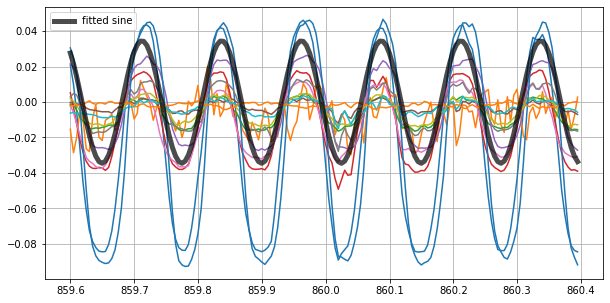

Phase fitting standard deviation is slightly high, check hist


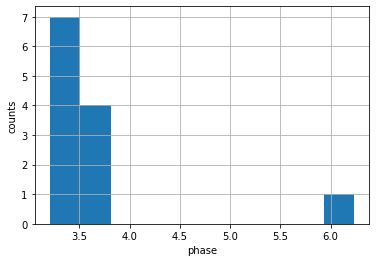

number of interferograms in bias group -1: 0


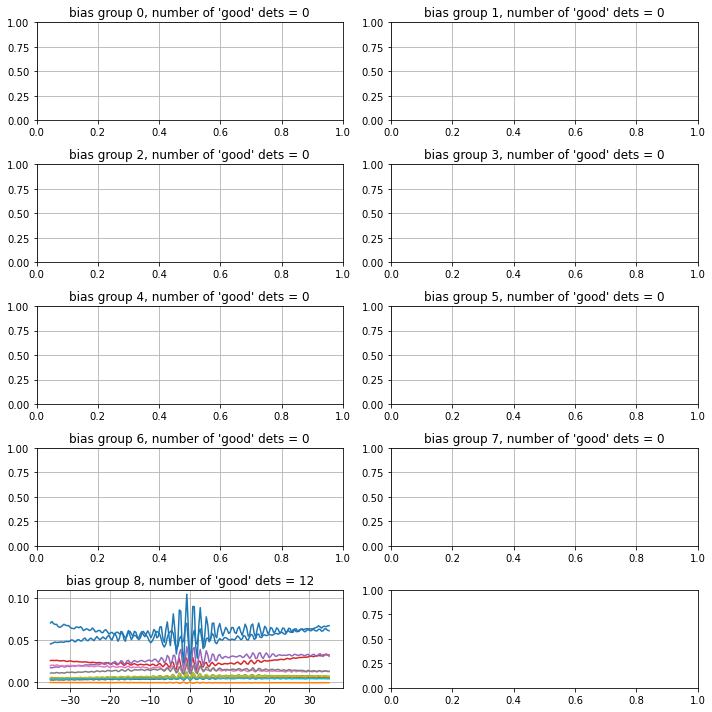

data saved to location FTS_data_integrated_bg8/run_17_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 18:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.05it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


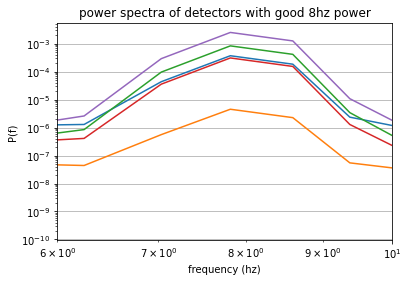

using power threshold of 10:


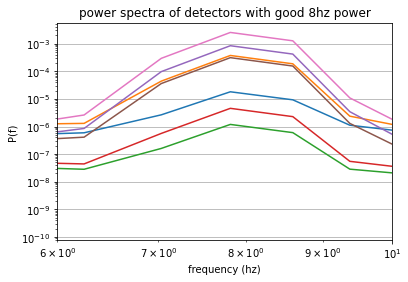

number of detectors with higher power in 8hz = 7


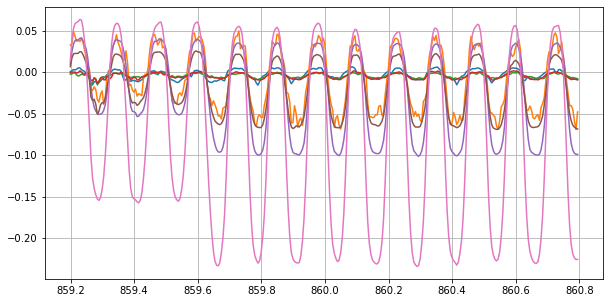

mean, median, std of fitted phases: 2.89, 2.87, 0.11


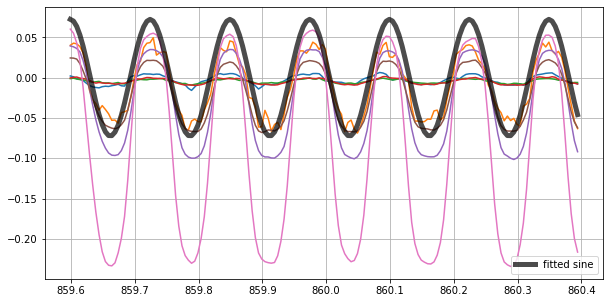

number of interferograms in bias group -1: 0


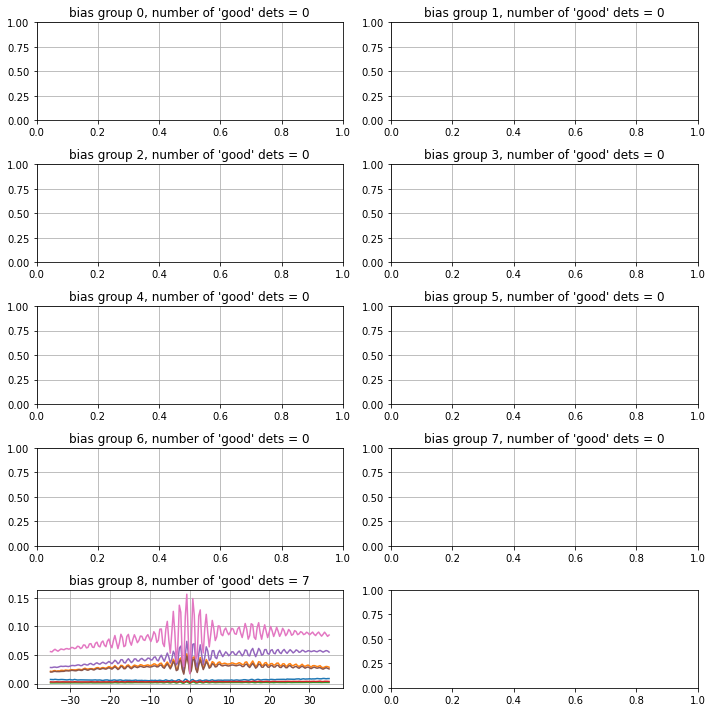

data saved to location FTS_data_integrated_bg8/run_18_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 19:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.11it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


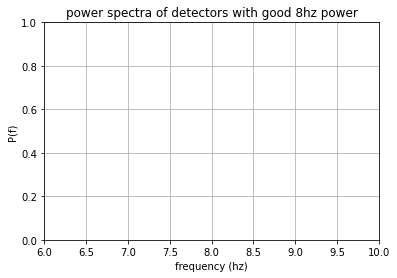

using power threshold of 10:


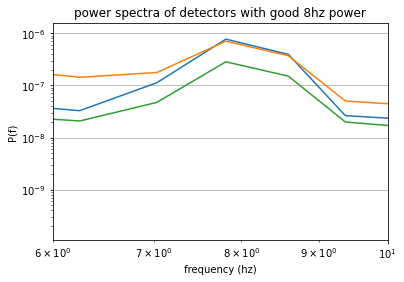

number of detectors with higher power in 8hz = 3
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


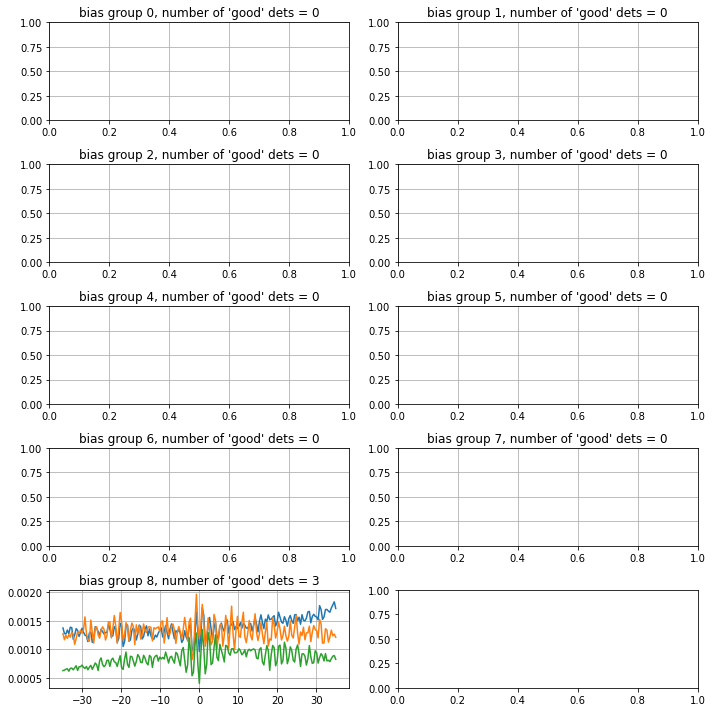

data saved to location FTS_data_integrated_bg8/run_19_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 20:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17224/ufm_lf_ln1_lp5_lp6/1722409235_000.g3
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


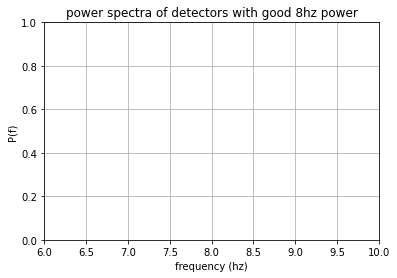

using power threshold of 10:


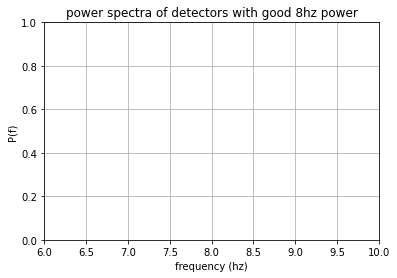

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


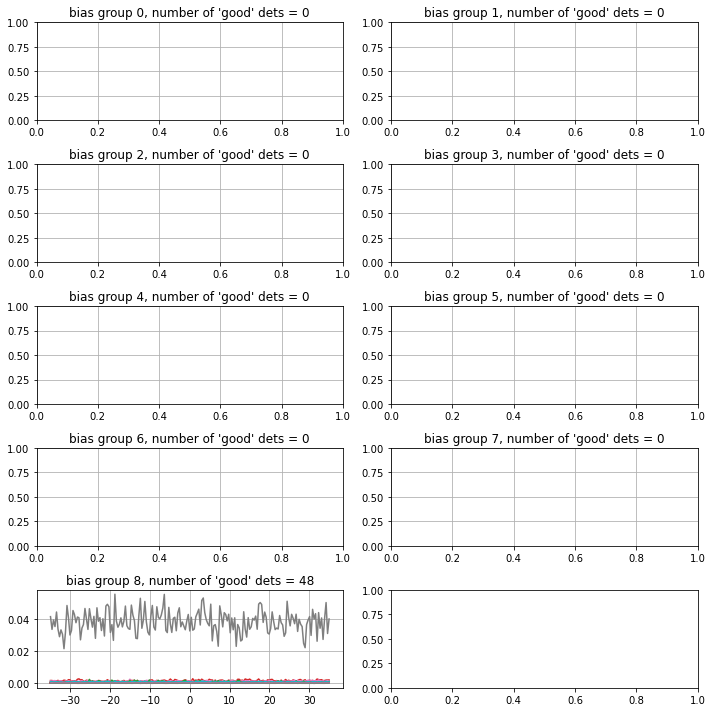

data saved to location FTS_data_integrated_bg8/run_20_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 21:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.11it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


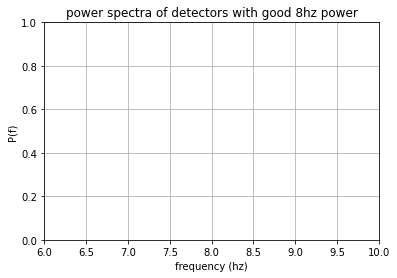

using power threshold of 10:


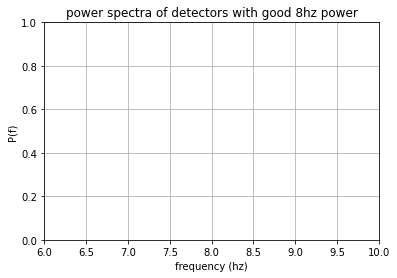

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


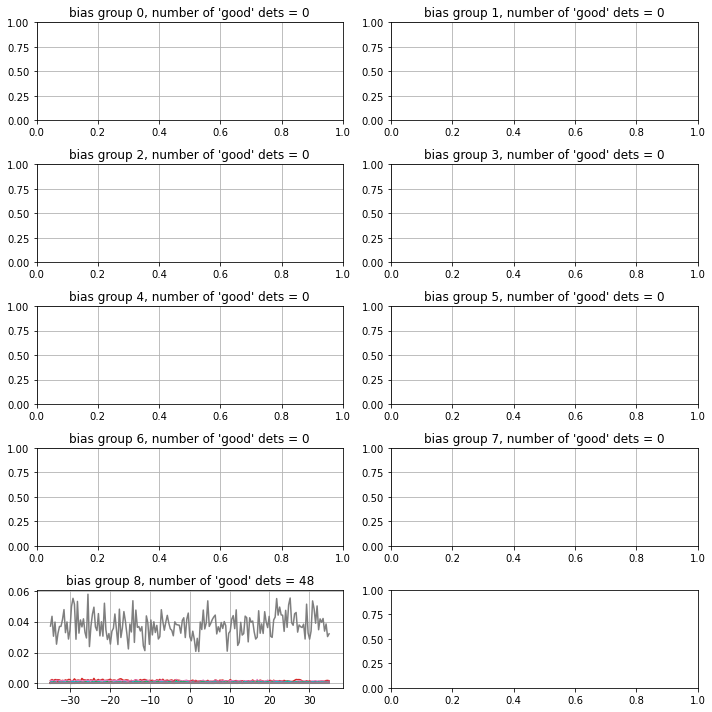

data saved to location FTS_data_integrated_bg8/run_21_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 22:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


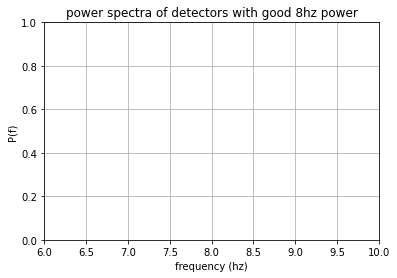

using power threshold of 10:


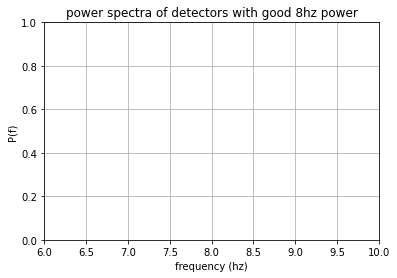

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


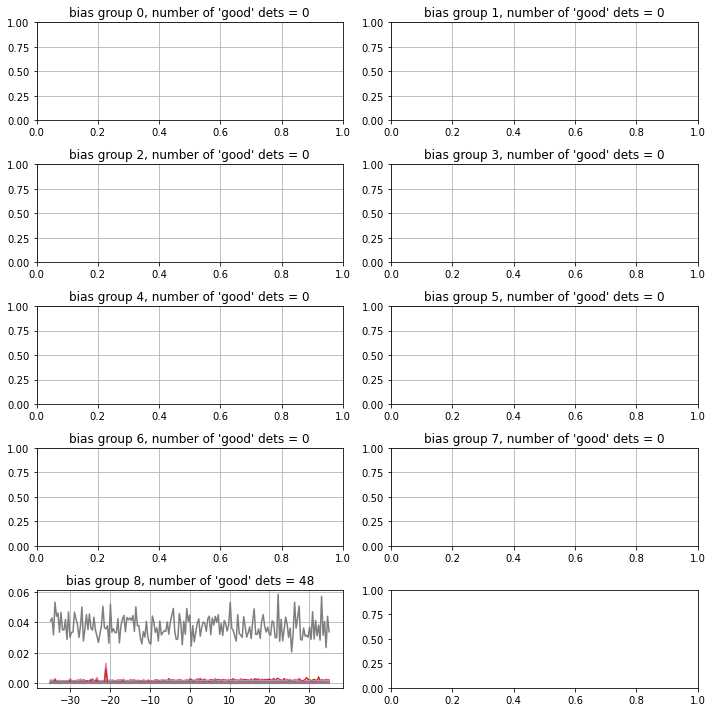

data saved to location FTS_data_integrated_bg8/run_22_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 23:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


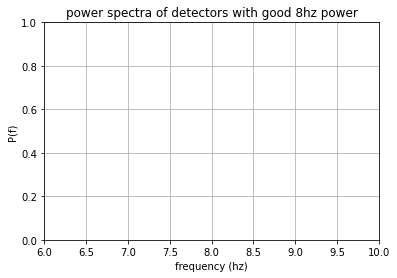

using power threshold of 10:


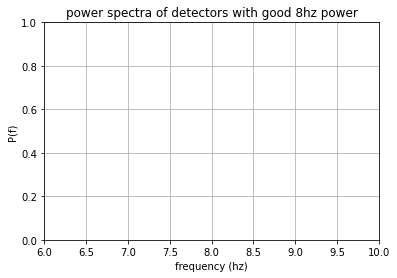

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


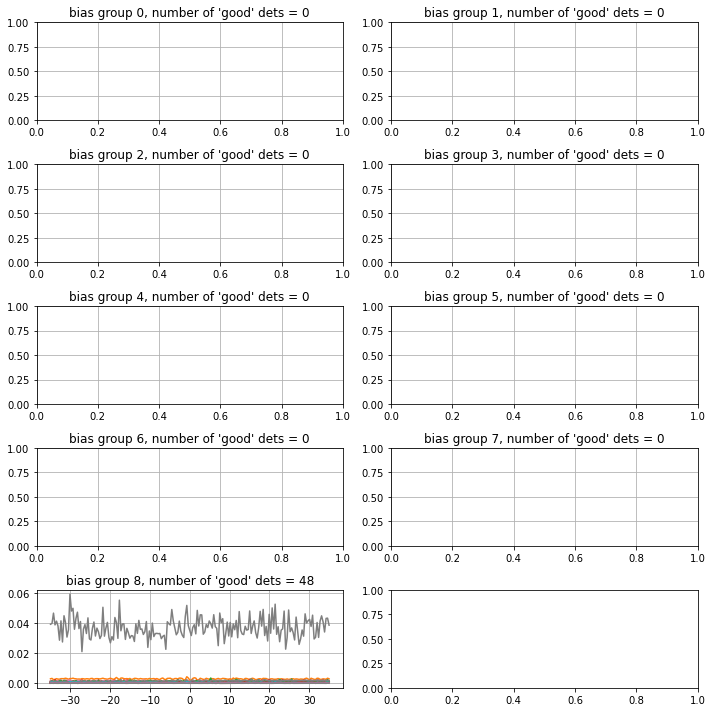

data saved to location FTS_data_integrated_bg8/run_23_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 24:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.05it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


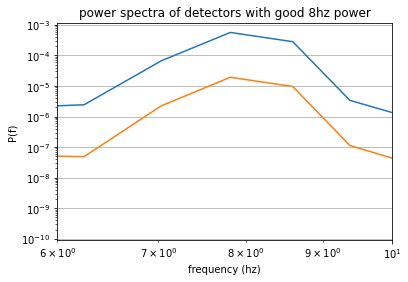

using power threshold of 10:


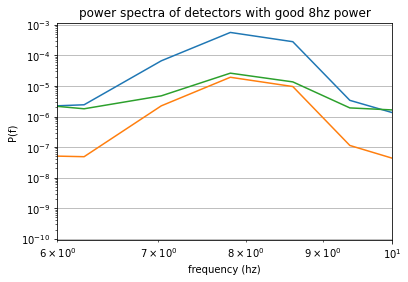

number of detectors with higher power in 8hz = 3
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


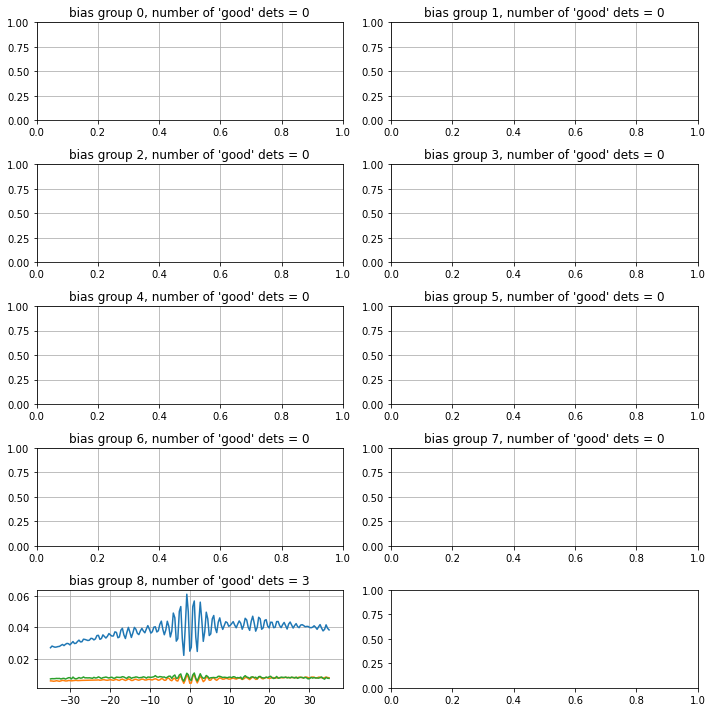

data saved to location FTS_data_integrated_bg8/run_24_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 25:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


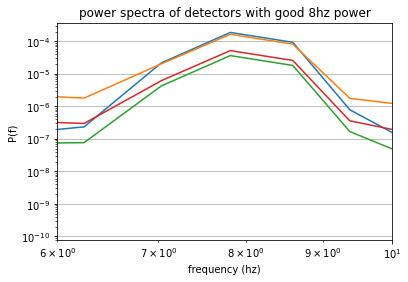

using power threshold of 10:


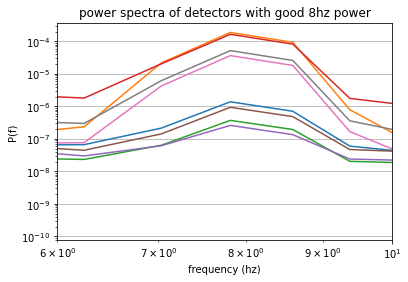

number of detectors with higher power in 8hz = 8


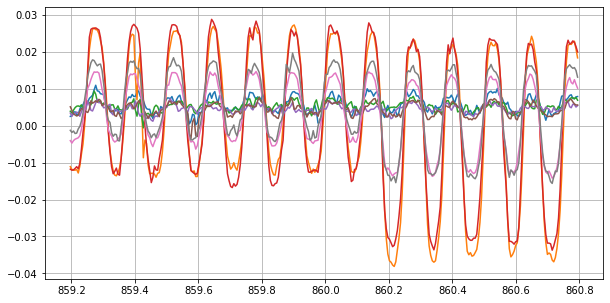

mean, median, std of fitted phases: 0.35, 0.35, 0.08


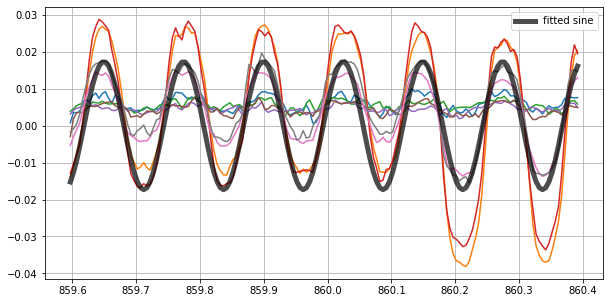

number of interferograms in bias group -1: 0


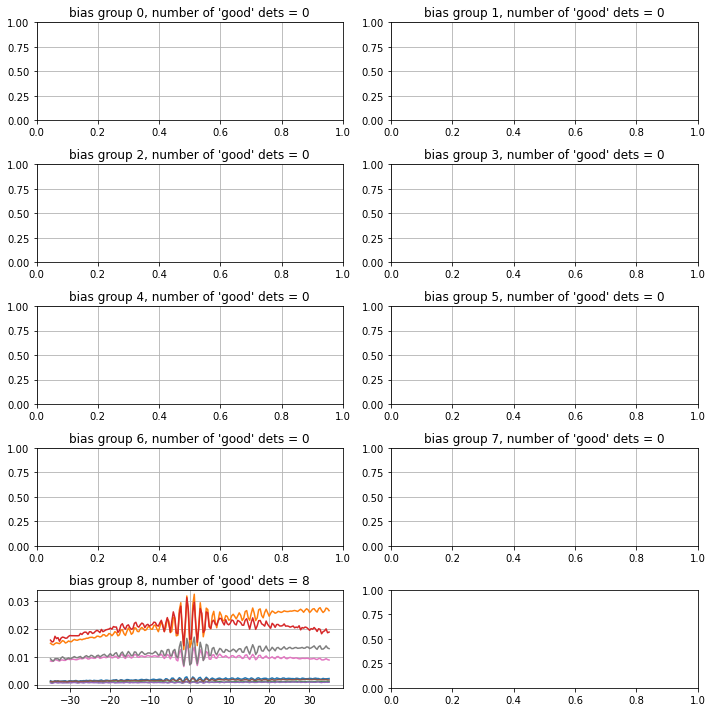

data saved to location FTS_data_integrated_bg8/run_25_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 26:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


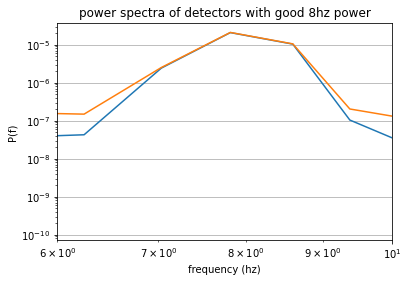

using power threshold of 10:


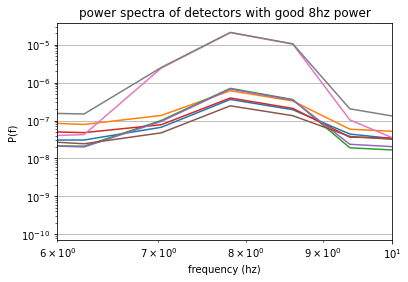

number of detectors with higher power in 8hz = 8


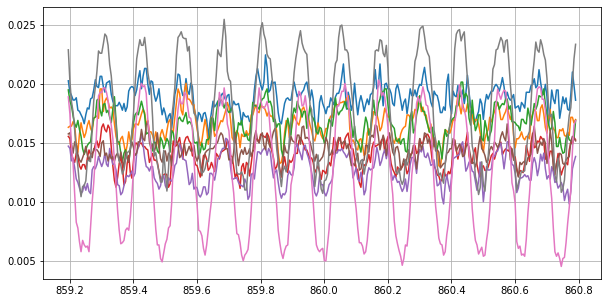

mean, median, std of fitted phases: 5.05, 5.06, 0.07


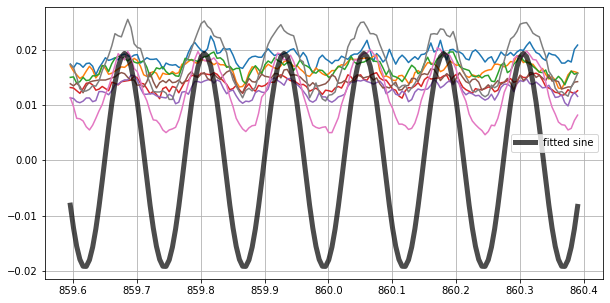

number of interferograms in bias group -1: 0


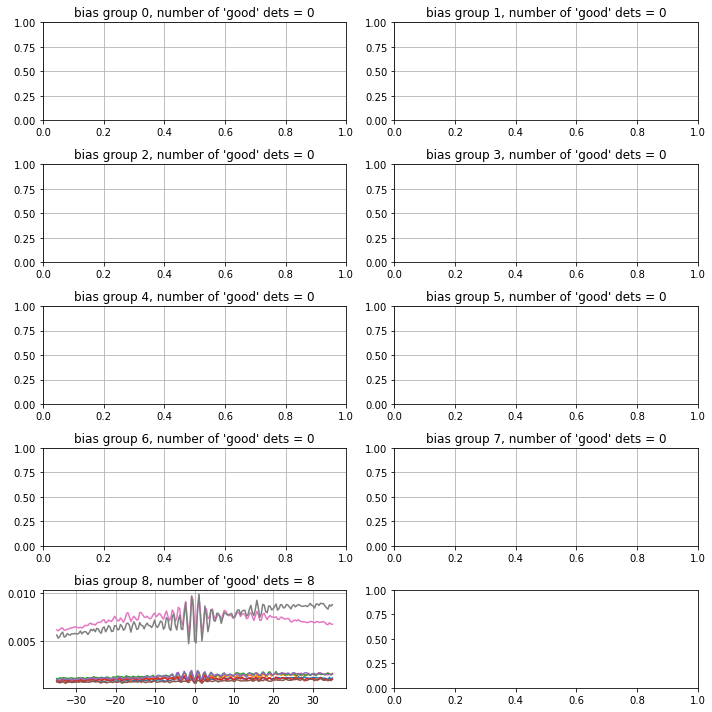

data saved to location FTS_data_integrated_bg8/run_26_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 27:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


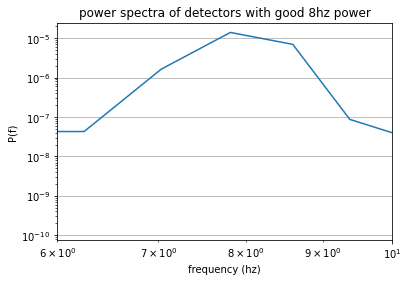

using power threshold of 10:


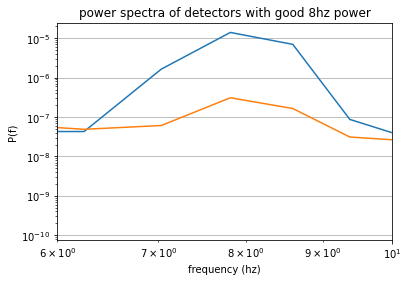

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


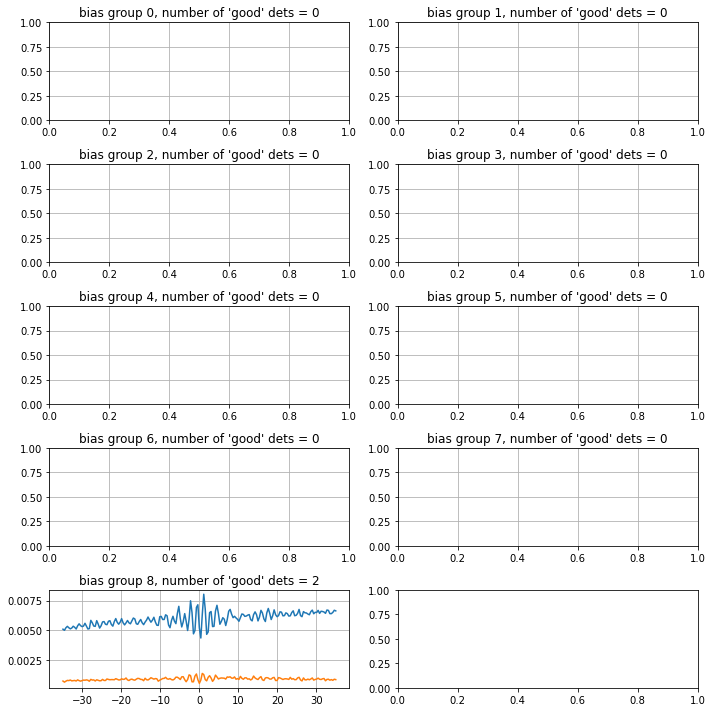

data saved to location FTS_data_integrated_bg8/run_27_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 28:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


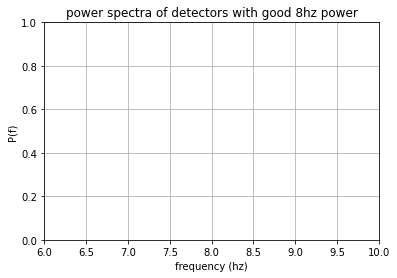

using power threshold of 10:


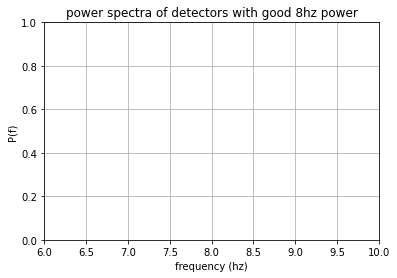

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


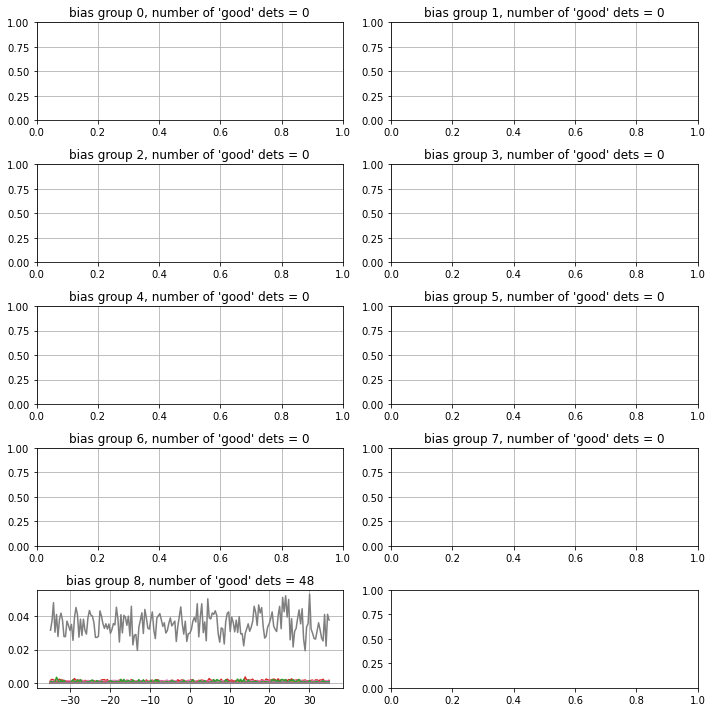

data saved to location FTS_data_integrated_bg8/run_28_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 29:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.13it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


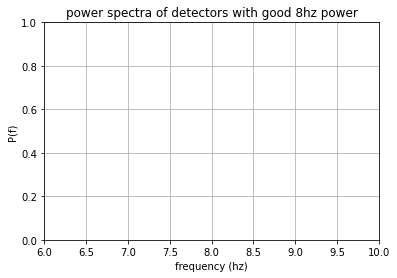

using power threshold of 10:


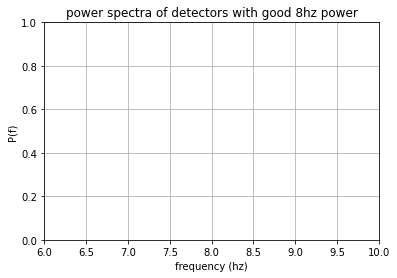

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


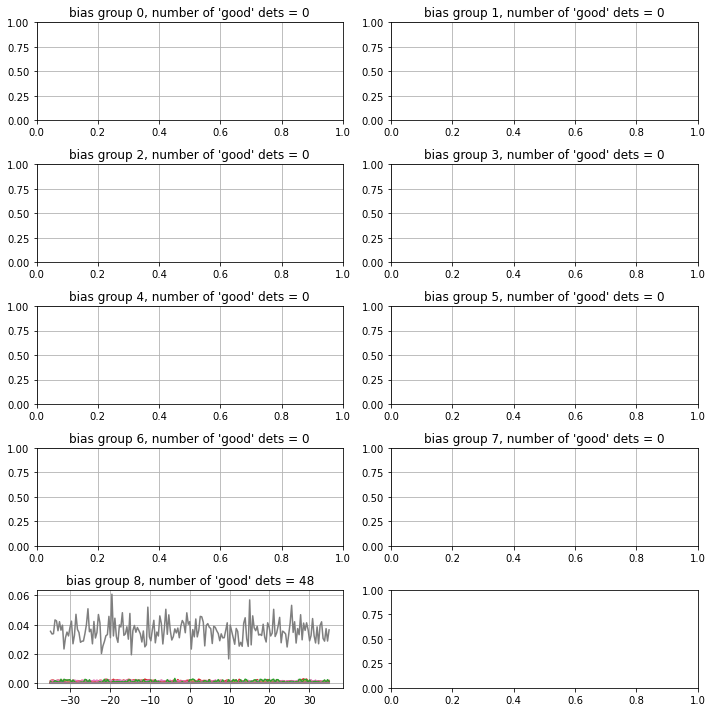

data saved to location FTS_data_integrated_bg8/run_29_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 30:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.05it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


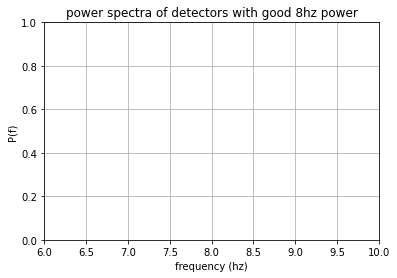

using power threshold of 10:


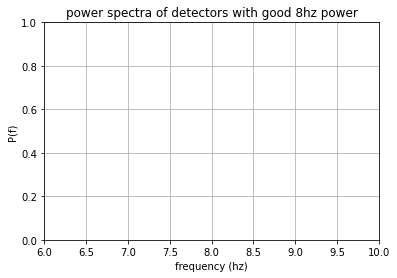

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


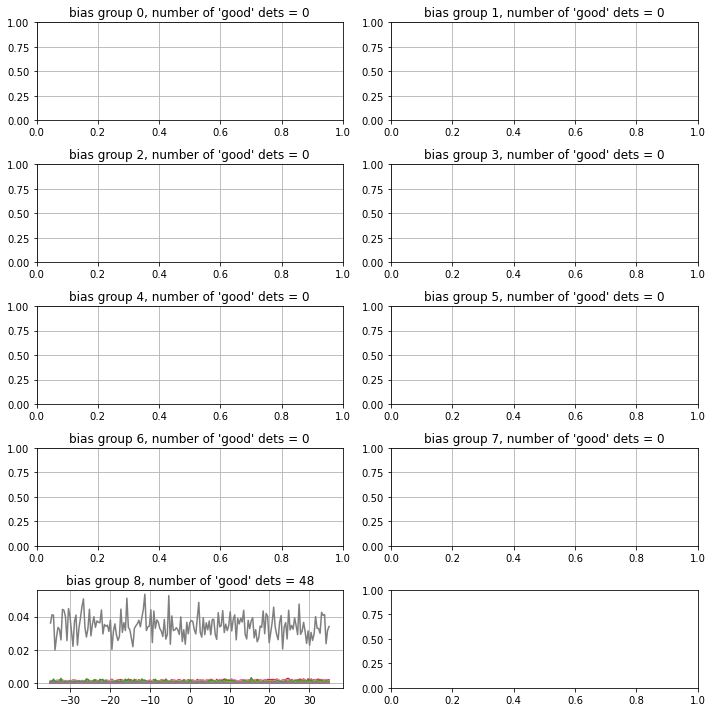

data saved to location FTS_data_integrated_bg8/run_30_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 31:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


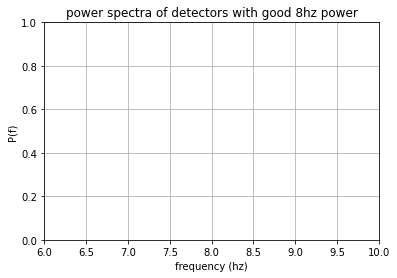

using power threshold of 10:


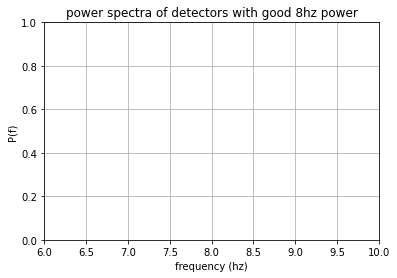

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


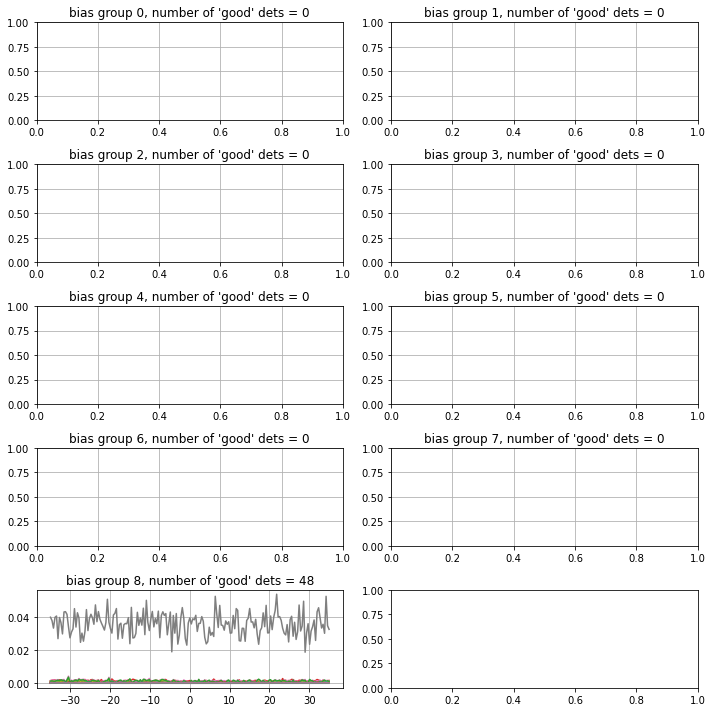

data saved to location FTS_data_integrated_bg8/run_31_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 32:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.05it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


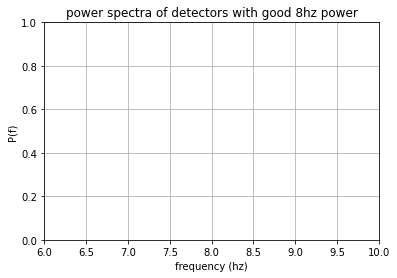

using power threshold of 10:


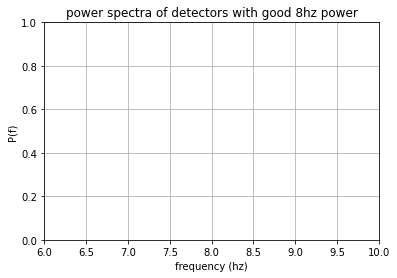

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


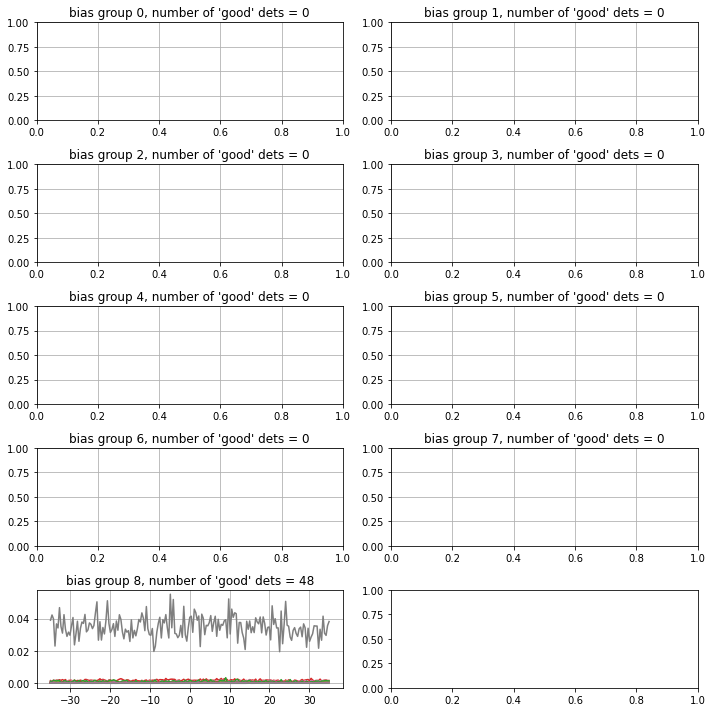

data saved to location FTS_data_integrated_bg8/run_32_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 33:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.10it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


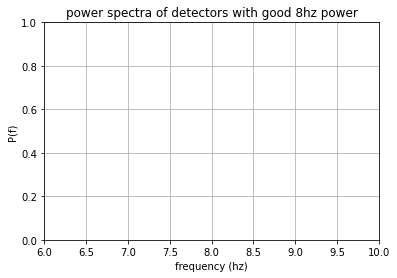

using power threshold of 10:


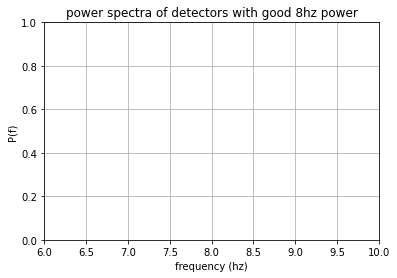

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


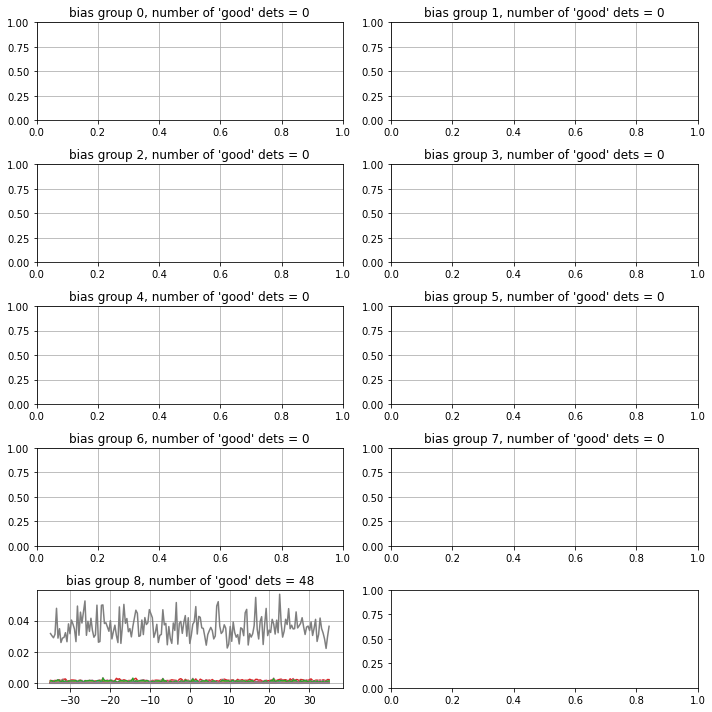

data saved to location FTS_data_integrated_bg8/run_33_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 34:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


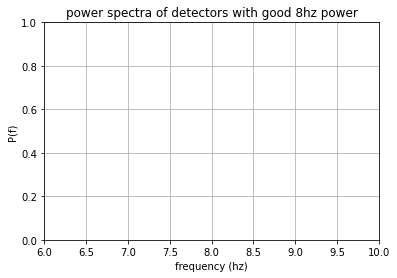

using power threshold of 10:


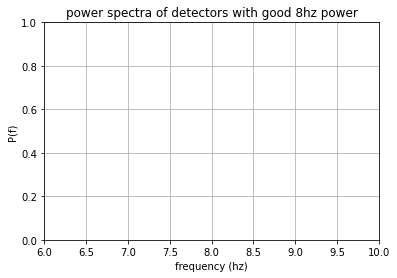

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


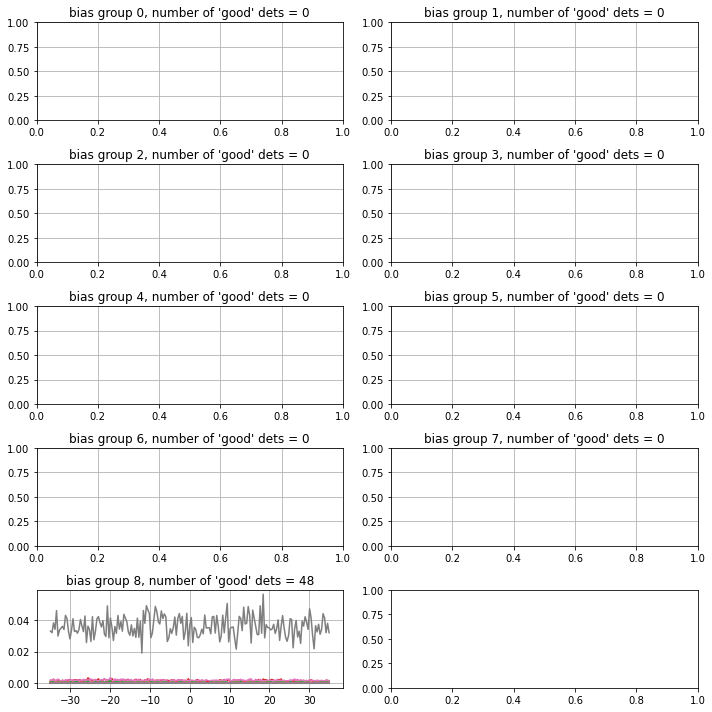

data saved to location FTS_data_integrated_bg8/run_34_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 1:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.01it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


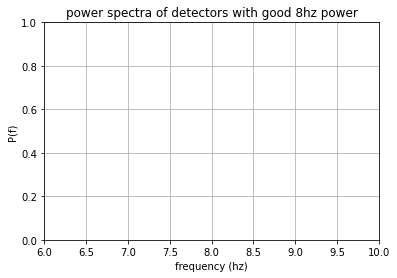

using power threshold of 10:


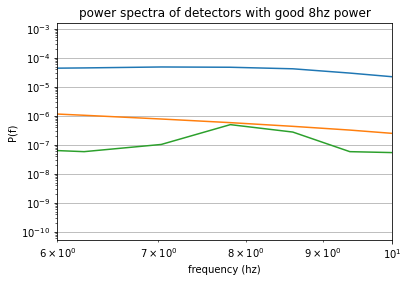

number of detectors with higher power in 8hz = 3
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


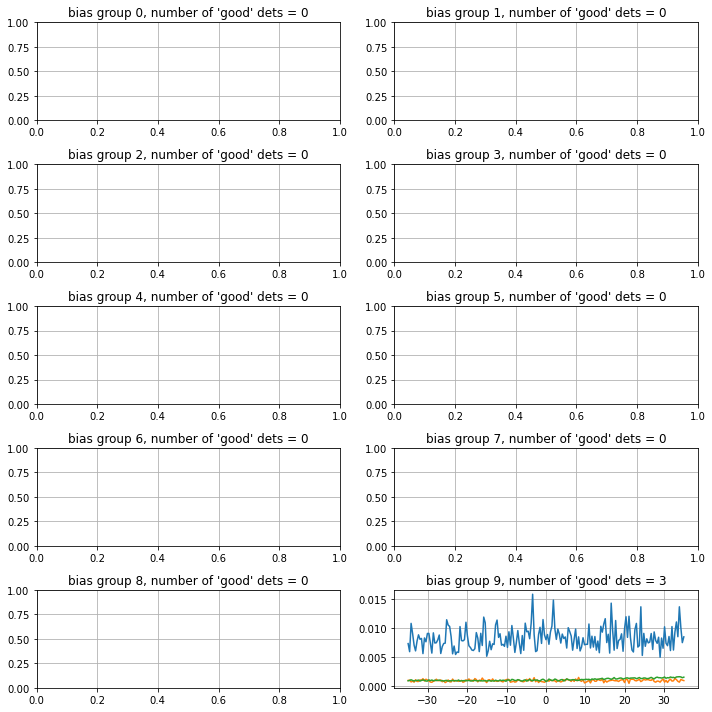

data saved to location FTS_data_integrated_bg9/run_1_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 2:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


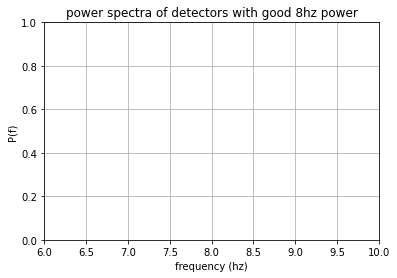

using power threshold of 10:


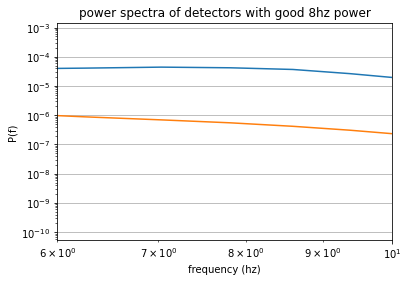

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


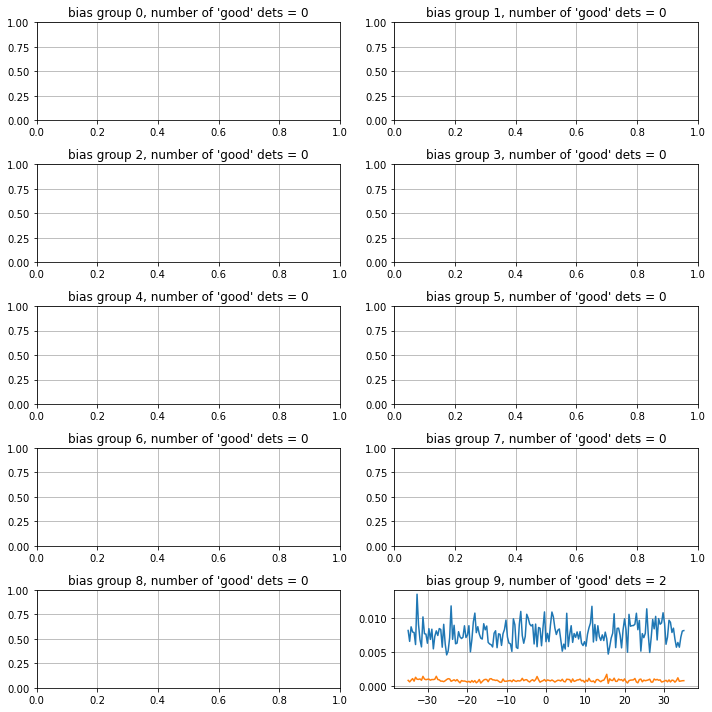

data saved to location FTS_data_integrated_bg9/run_2_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 3:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


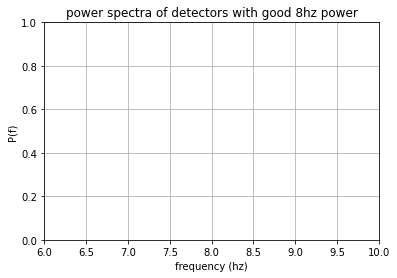

using power threshold of 10:


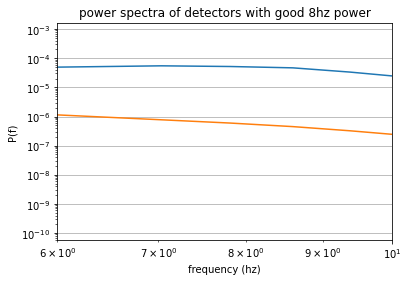

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


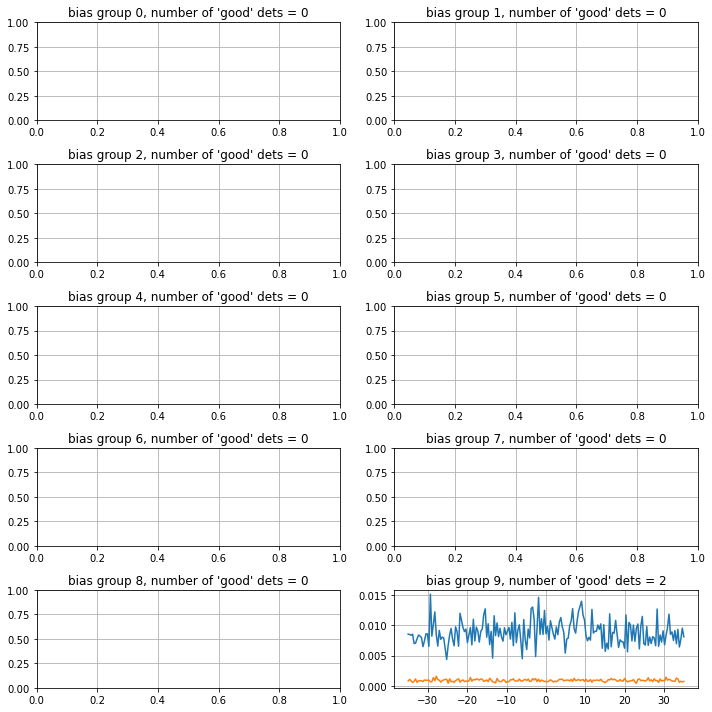

data saved to location FTS_data_integrated_bg9/run_3_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 4:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.13it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


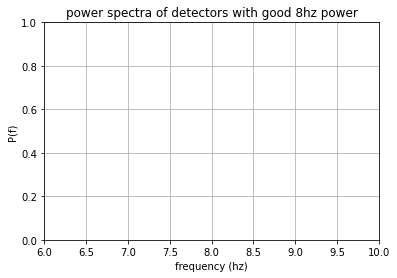

using power threshold of 10:


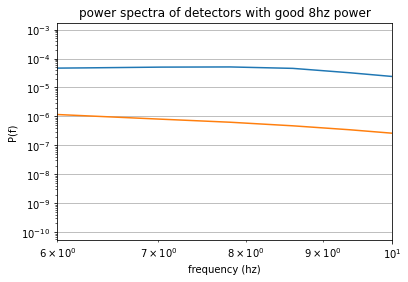

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


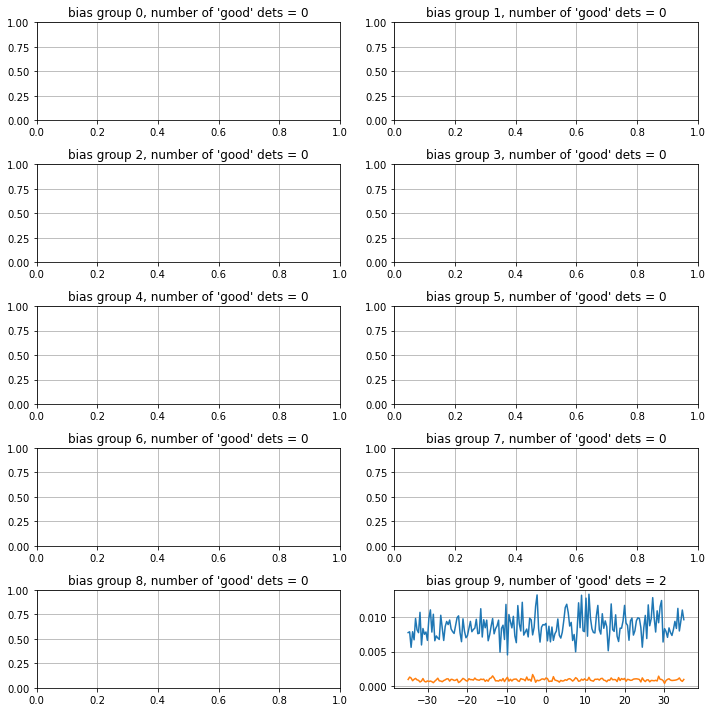

data saved to location FTS_data_integrated_bg9/run_4_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 5:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.10it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


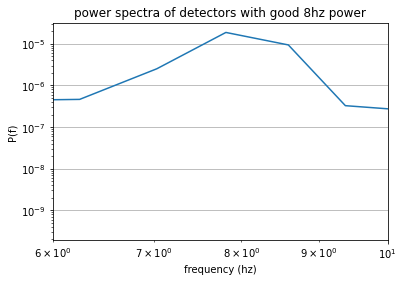

using power threshold of 10:


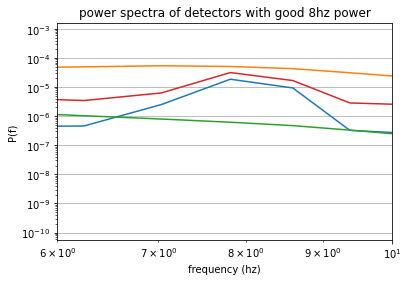

number of detectors with higher power in 8hz = 4


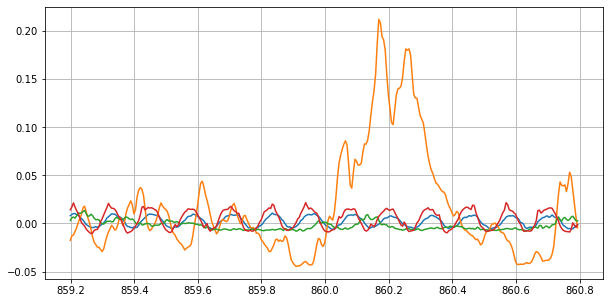

mean, median, std of fitted phases: 2.48, 2.62, 1.42


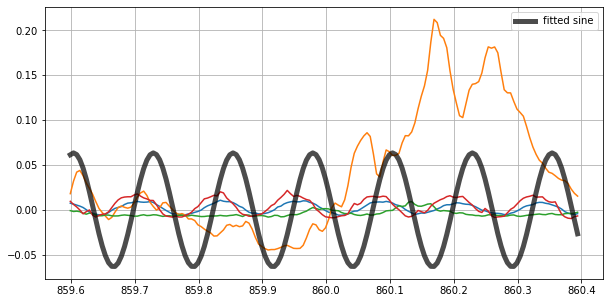

Phase fitting standard deviation is slightly high, check hist


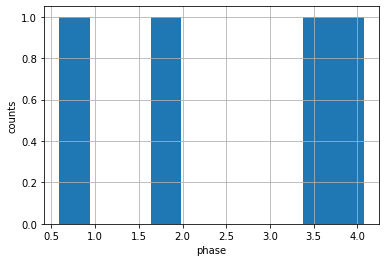

number of interferograms in bias group -1: 0


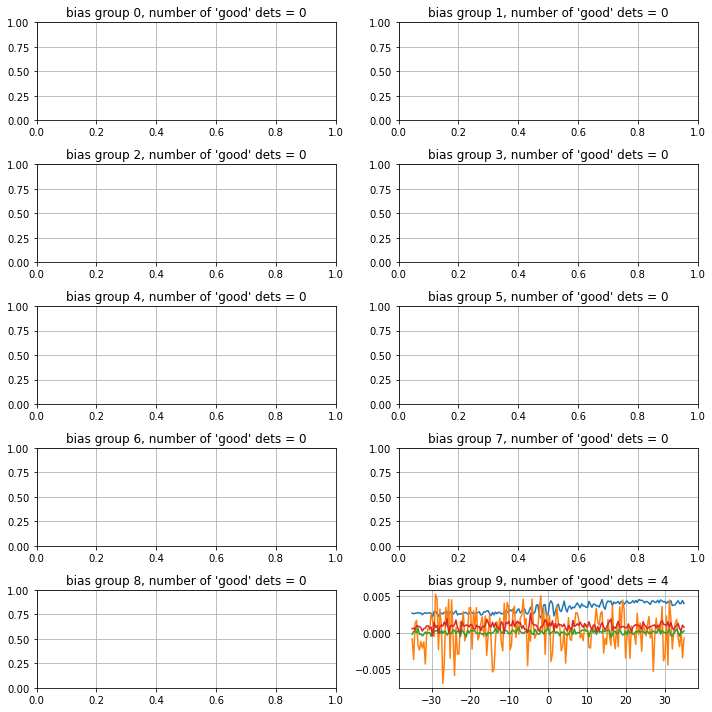

data saved to location FTS_data_integrated_bg9/run_5_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 6:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.16it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


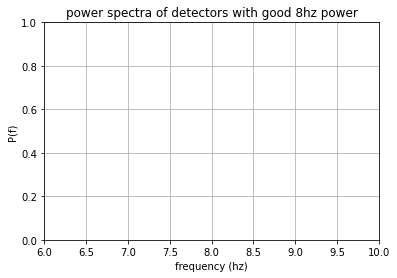

using power threshold of 10:


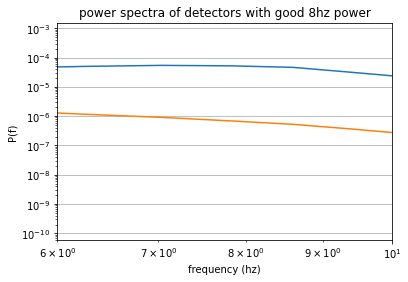

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


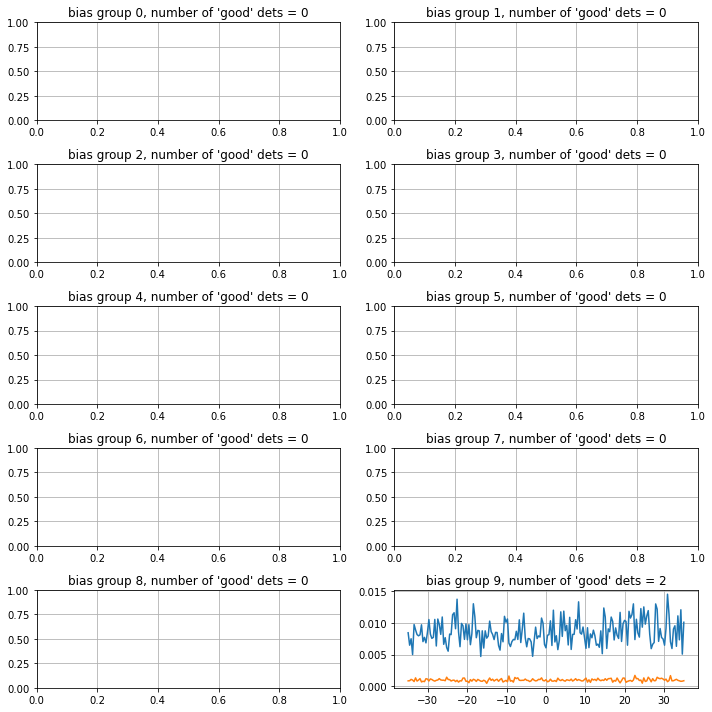

data saved to location FTS_data_integrated_bg9/run_6_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 7:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


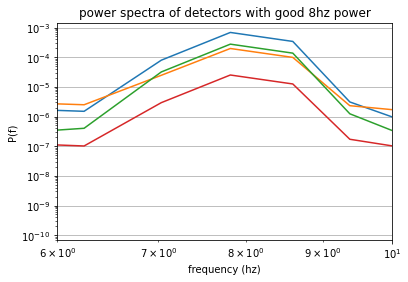

using power threshold of 10:


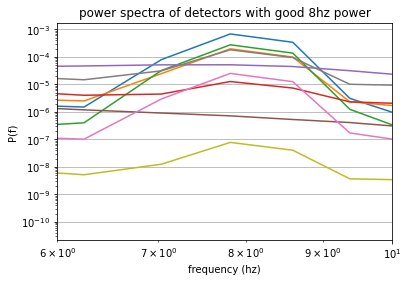

number of detectors with higher power in 8hz = 9


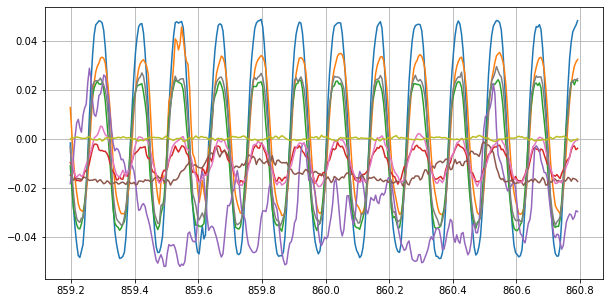

mean, median, std of fitted phases: 3.79, 2.77, 1.61


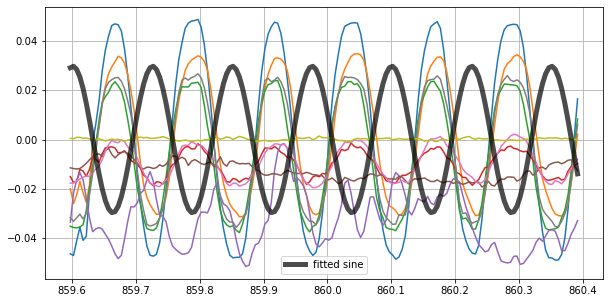

Phase fitting standard deviation is slightly high, check hist


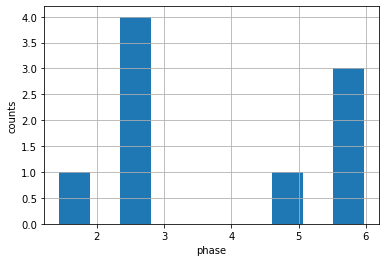

number of interferograms in bias group -1: 0


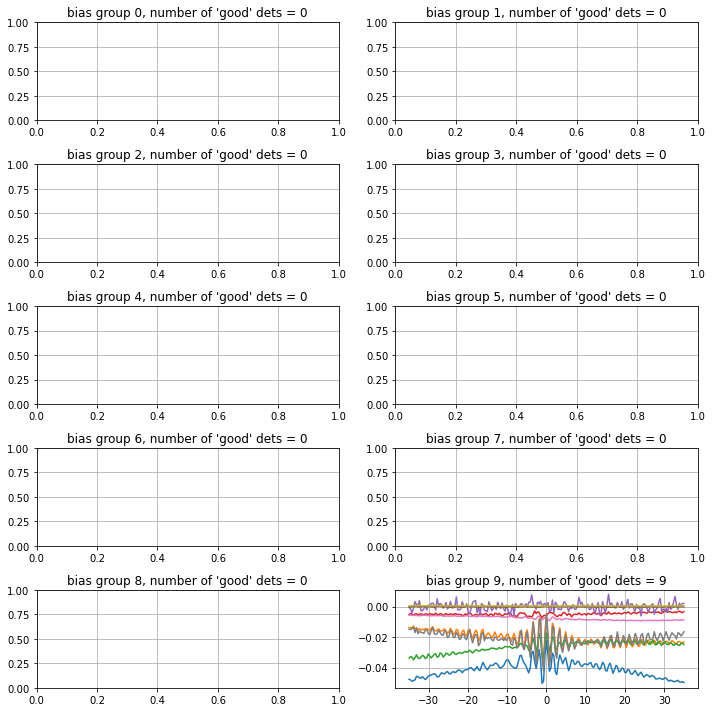

data saved to location FTS_data_integrated_bg9/run_7_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 8:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


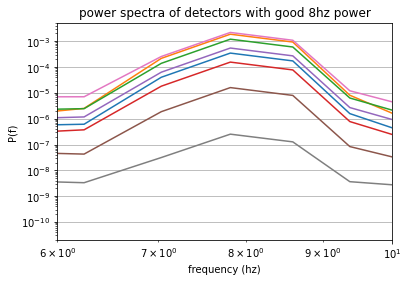

using power threshold of 10:


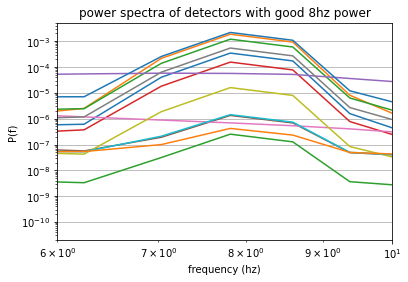

number of detectors with higher power in 8hz = 13


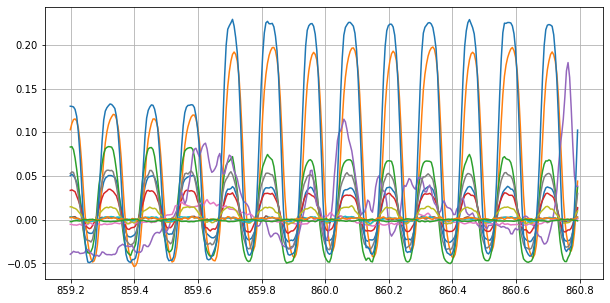

mean, median, std of fitted phases: 3.80, 4.05, 1.05


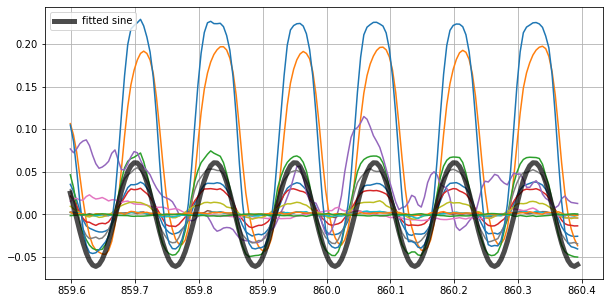

Phase fitting standard deviation is slightly high, check hist


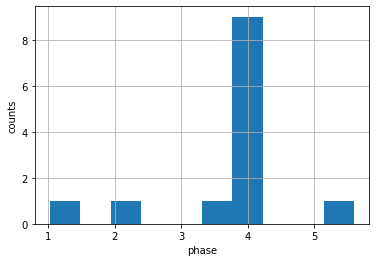

number of interferograms in bias group -1: 0


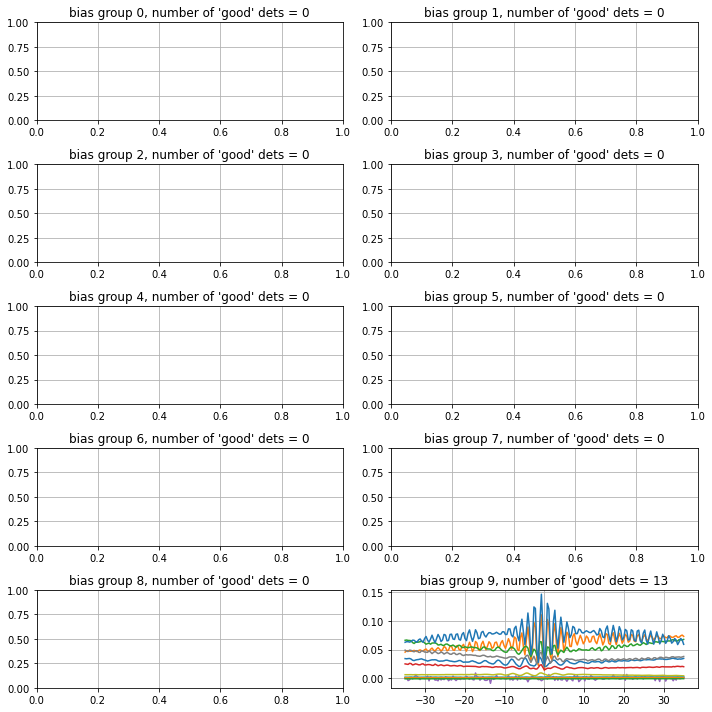

data saved to location FTS_data_integrated_bg9/run_8_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 9:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.08it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


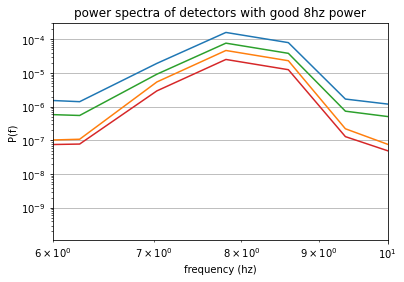

using power threshold of 10:


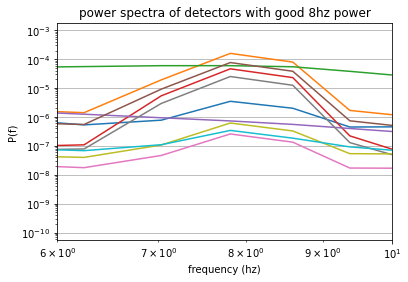

number of detectors with higher power in 8hz = 10


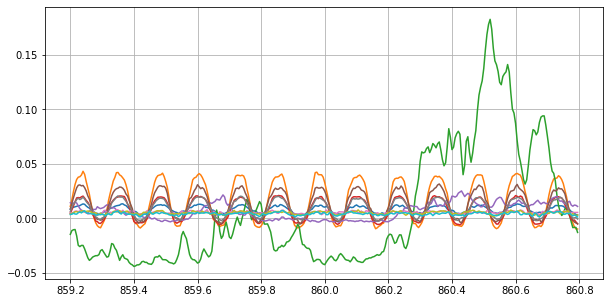

mean, median, std of fitted phases: 3.06, 2.55, 1.06


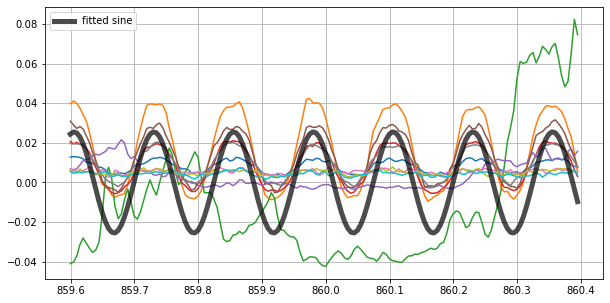

Phase fitting standard deviation is slightly high, check hist


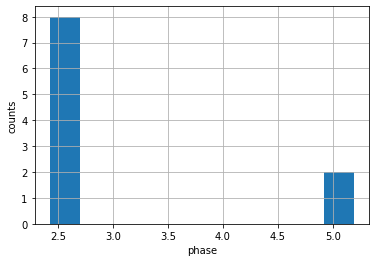

number of interferograms in bias group -1: 0


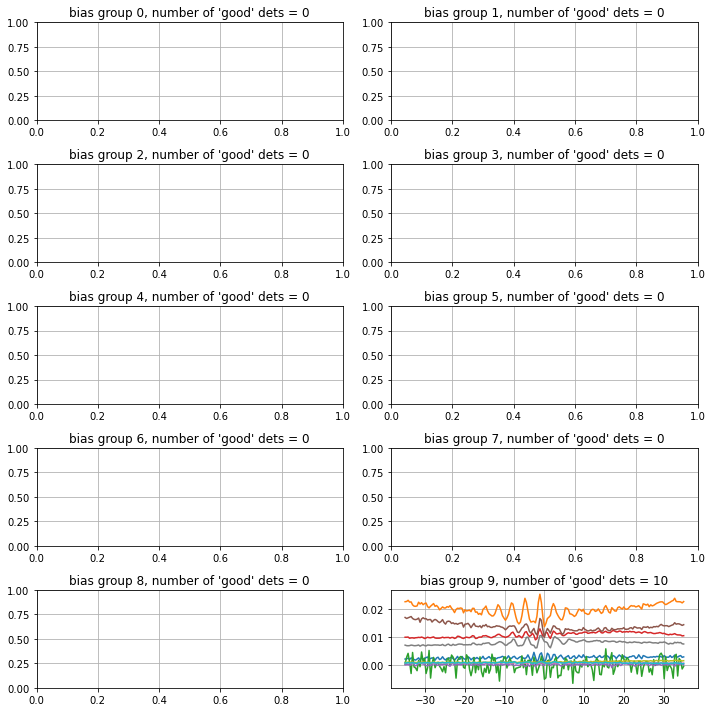

data saved to location FTS_data_integrated_bg9/run_9_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 10:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


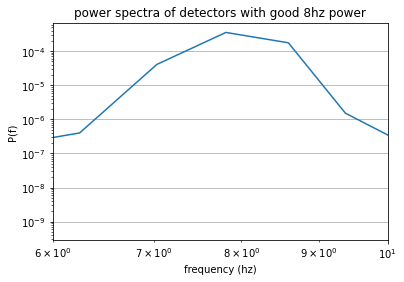

using power threshold of 10:


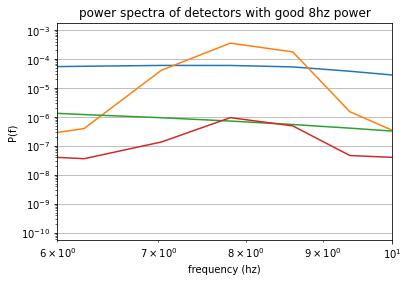

number of detectors with higher power in 8hz = 4


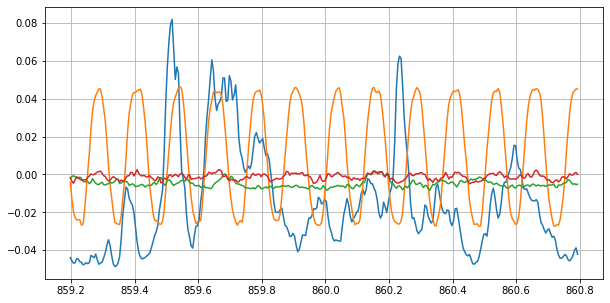

mean, median, std of fitted phases: -0.10, -0.18, 0.77


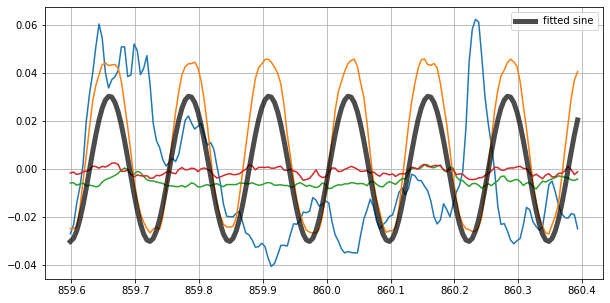

Phase fitting standard deviation is slightly high, check hist


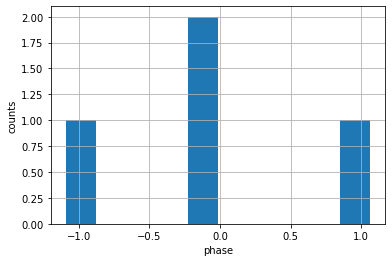

number of interferograms in bias group -1: 0


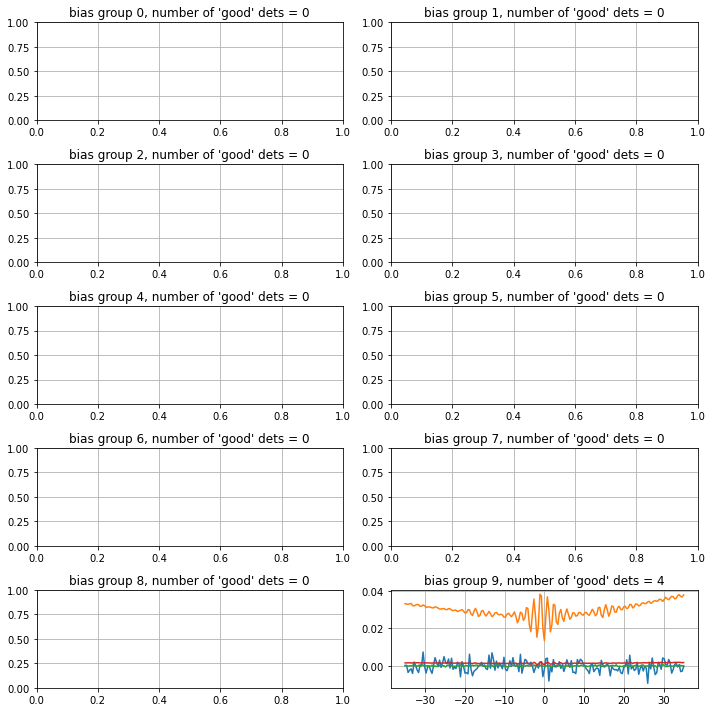

data saved to location FTS_data_integrated_bg9/run_10_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 11:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


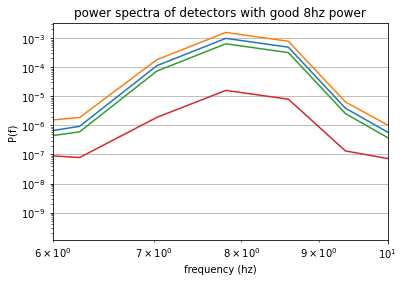

using power threshold of 10:


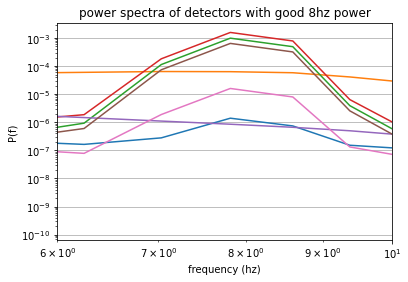

number of detectors with higher power in 8hz = 7


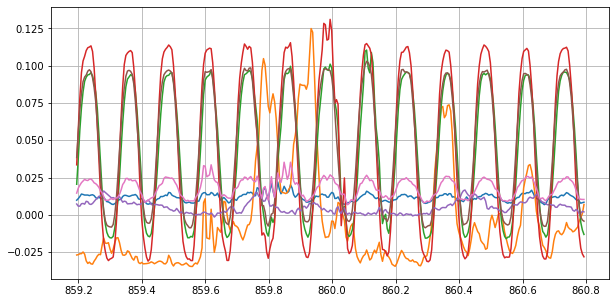

mean, median, std of fitted phases: 1.60, 2.29, 1.18


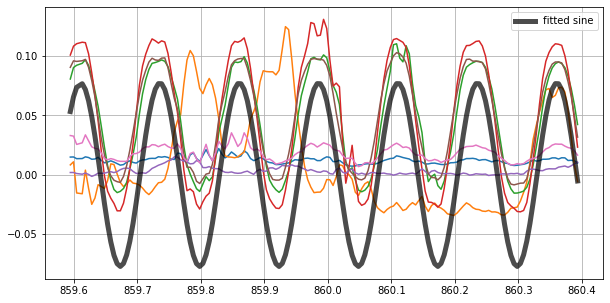

Phase fitting standard deviation is slightly high, check hist


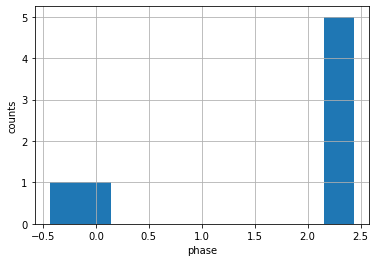

number of interferograms in bias group -1: 0


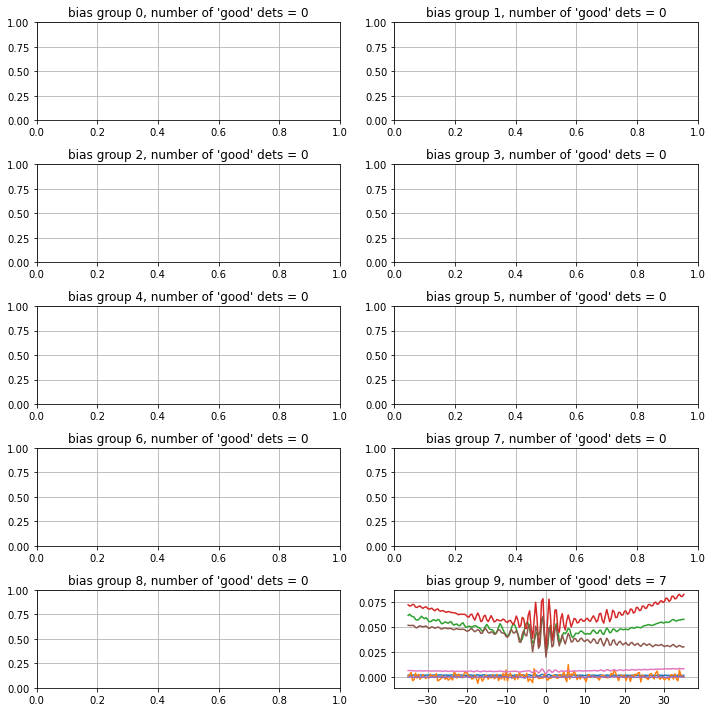

data saved to location FTS_data_integrated_bg9/run_11_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 12:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


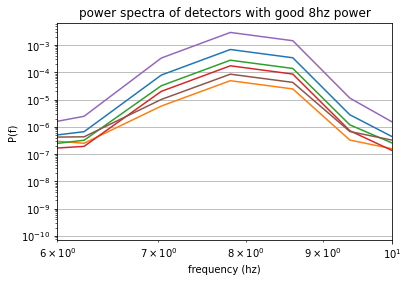

using power threshold of 10:


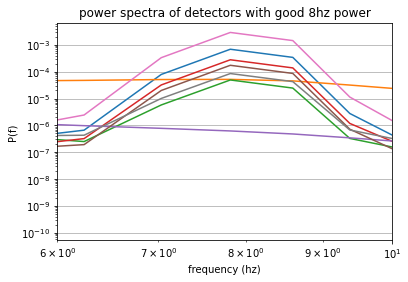

number of detectors with higher power in 8hz = 8


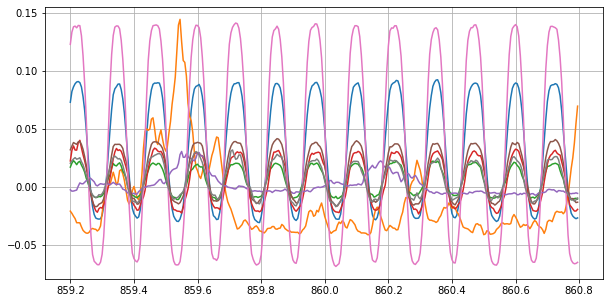

mean, median, std of fitted phases: 3.64, 3.06, 1.14


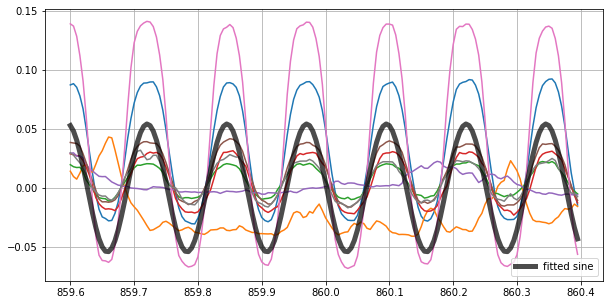

Phase fitting standard deviation is slightly high, check hist


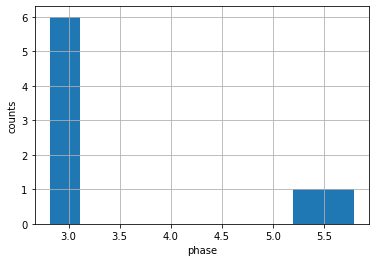

number of interferograms in bias group -1: 0


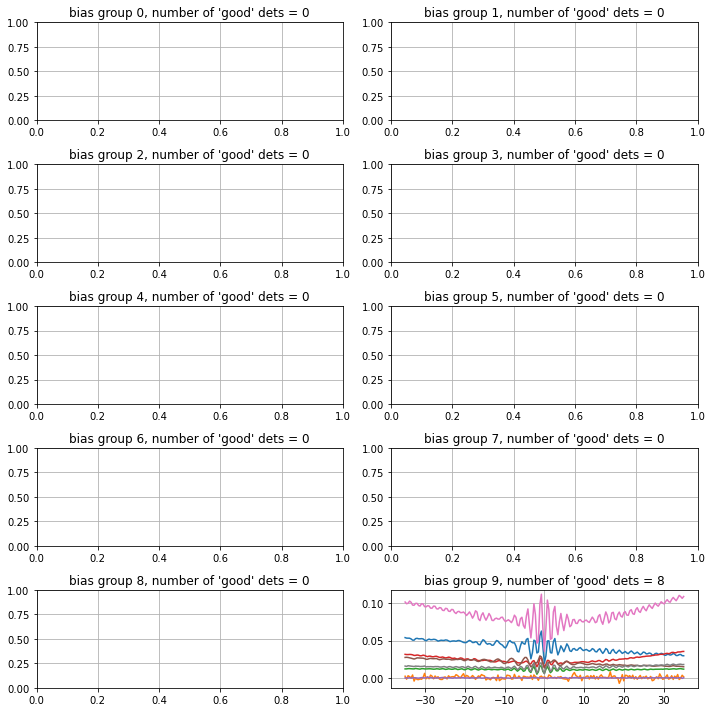

data saved to location FTS_data_integrated_bg9/run_12_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 13:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


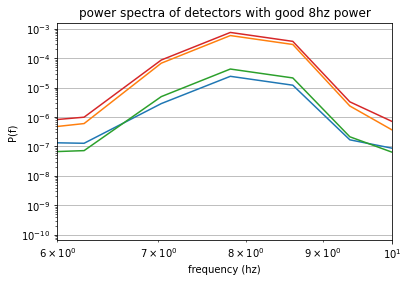

using power threshold of 10:


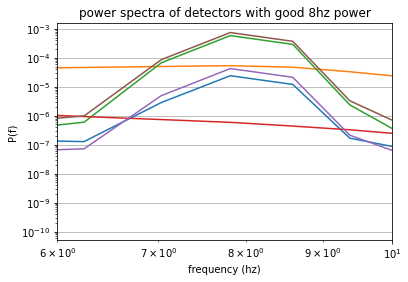

number of detectors with higher power in 8hz = 6


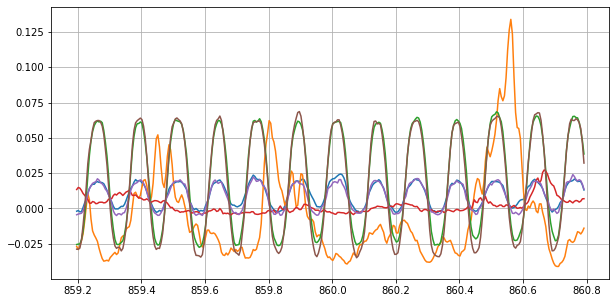

mean, median, std of fitted phases: 0.07, 0.79, 1.06


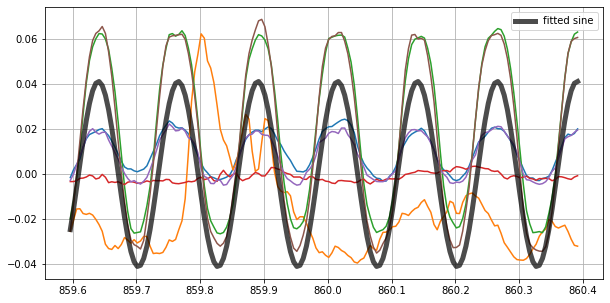

Phase fitting standard deviation is slightly high, check hist


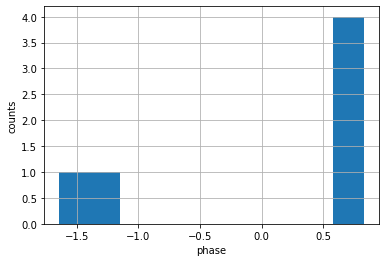

number of interferograms in bias group -1: 0


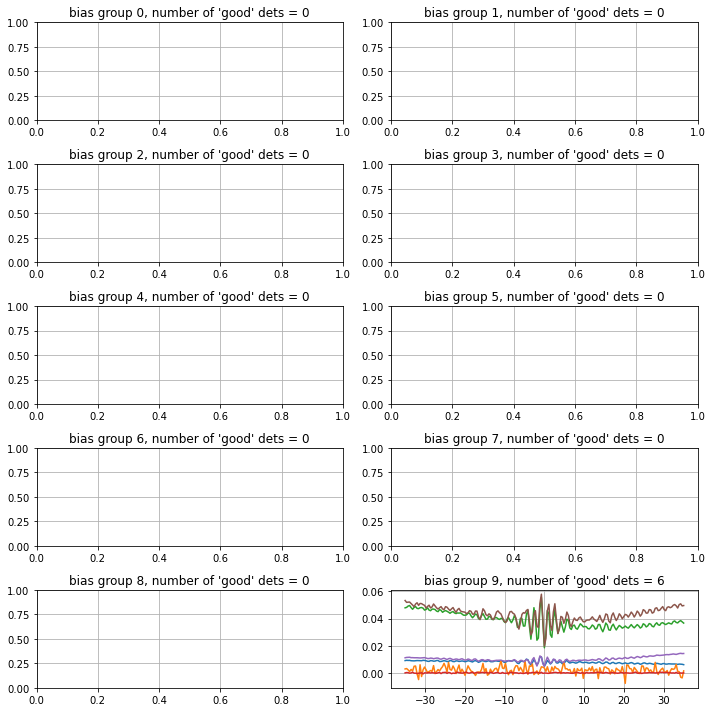

data saved to location FTS_data_integrated_bg9/run_13_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 14:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17223/ufm_lf_ln1_lp5_lp6/1722397615_000.g3
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


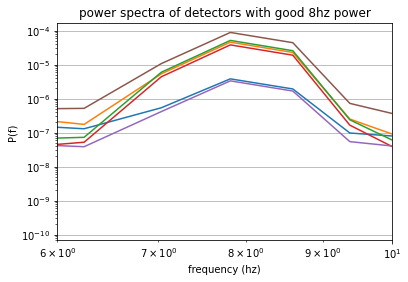

using power threshold of 10:


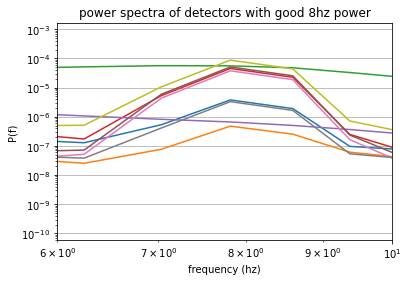

number of detectors with higher power in 8hz = 9


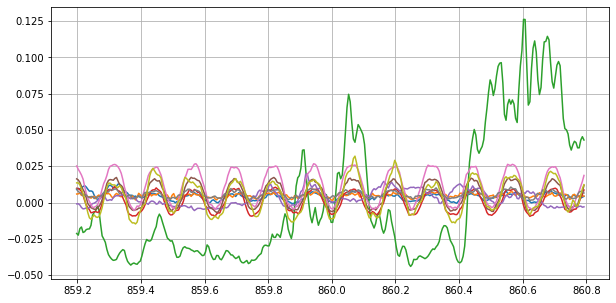

mean, median, std of fitted phases: 4.63, 4.49, 0.29


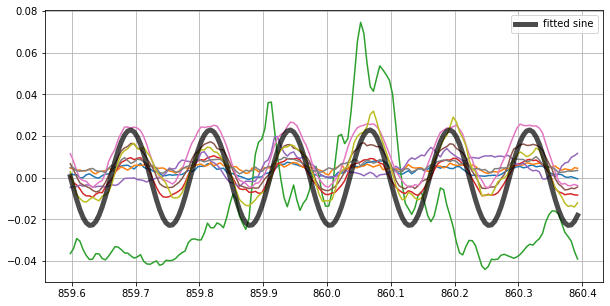

number of interferograms in bias group -1: 0


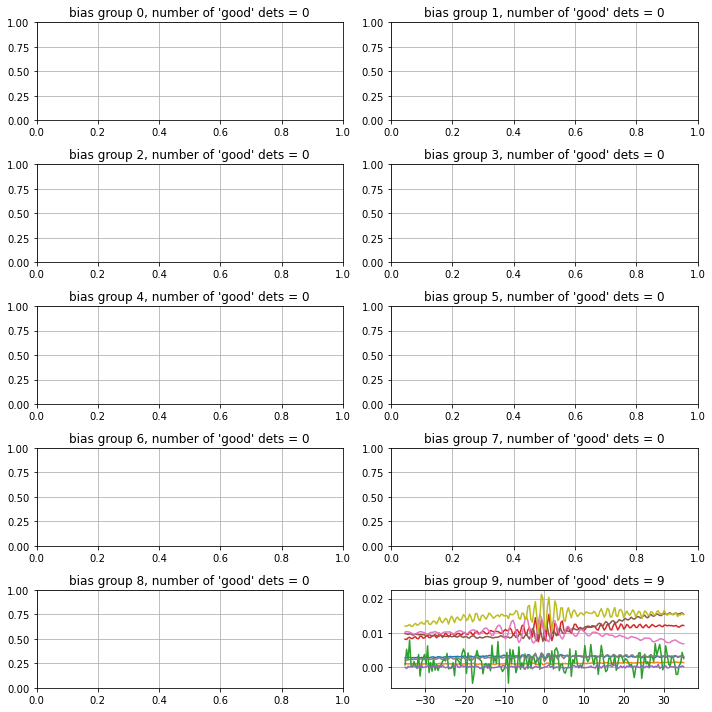

data saved to location FTS_data_integrated_bg9/run_14_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 15:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.01it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


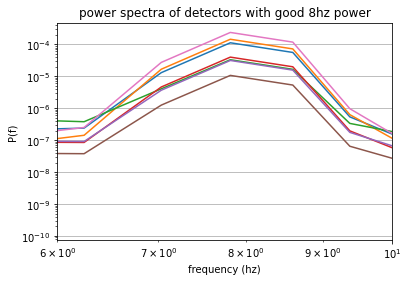

using power threshold of 10:


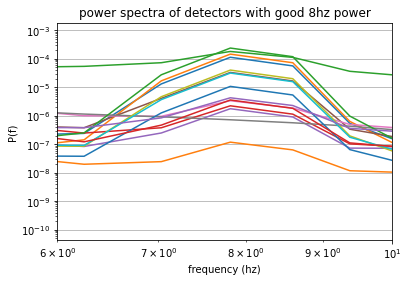

number of detectors with higher power in 8hz = 15


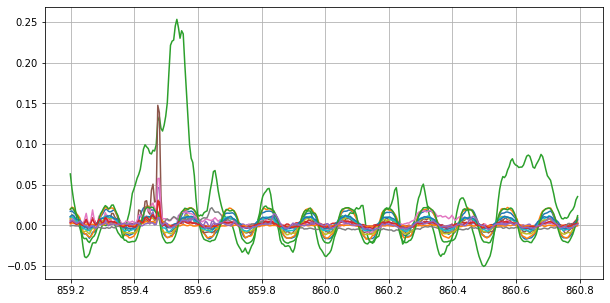

mean, median, std of fitted phases: 4.14, 4.23, 0.34


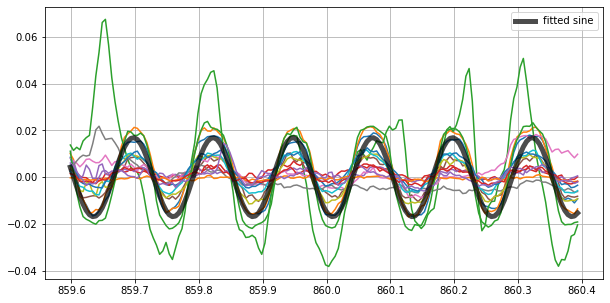

Phase fitting standard deviation is slightly high, check hist


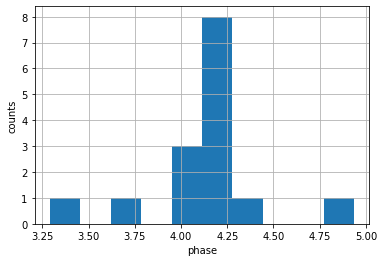

/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


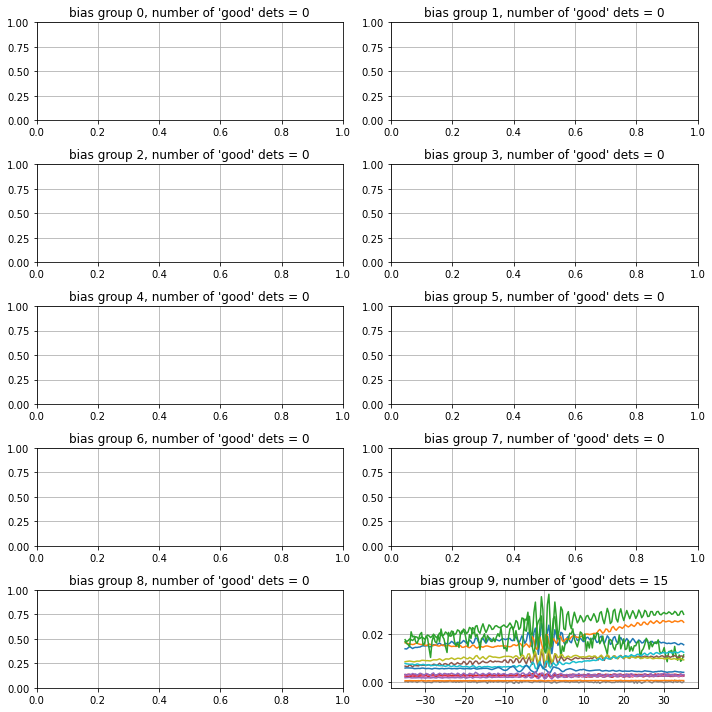

data saved to location FTS_data_integrated_bg9/run_15_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 16:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


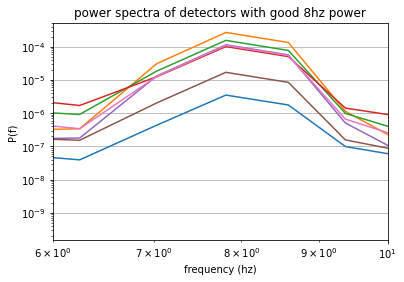

using power threshold of 10:


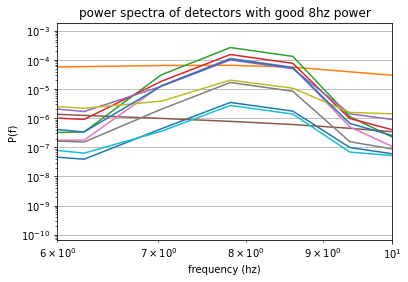

number of detectors with higher power in 8hz = 11


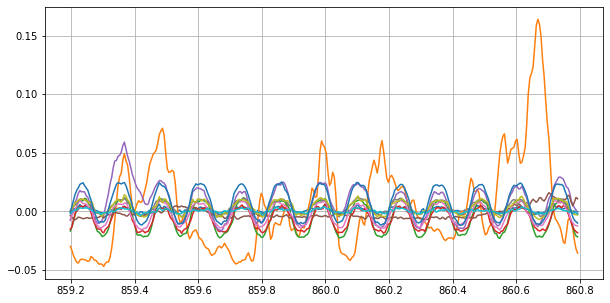

mean, median, std of fitted phases: 2.43, 2.36, 1.09


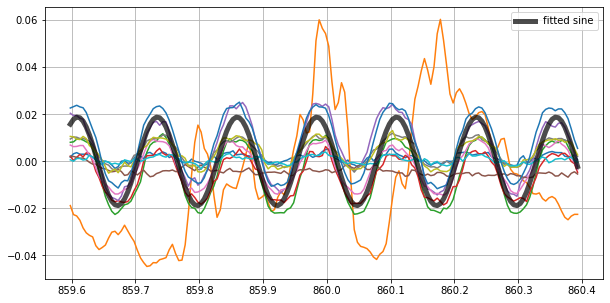

Phase fitting standard deviation is slightly high, check hist


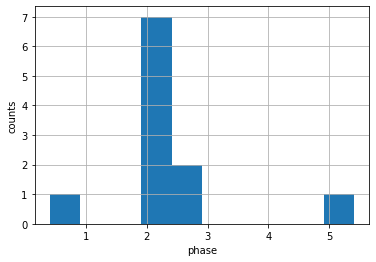

number of interferograms in bias group -1: 0


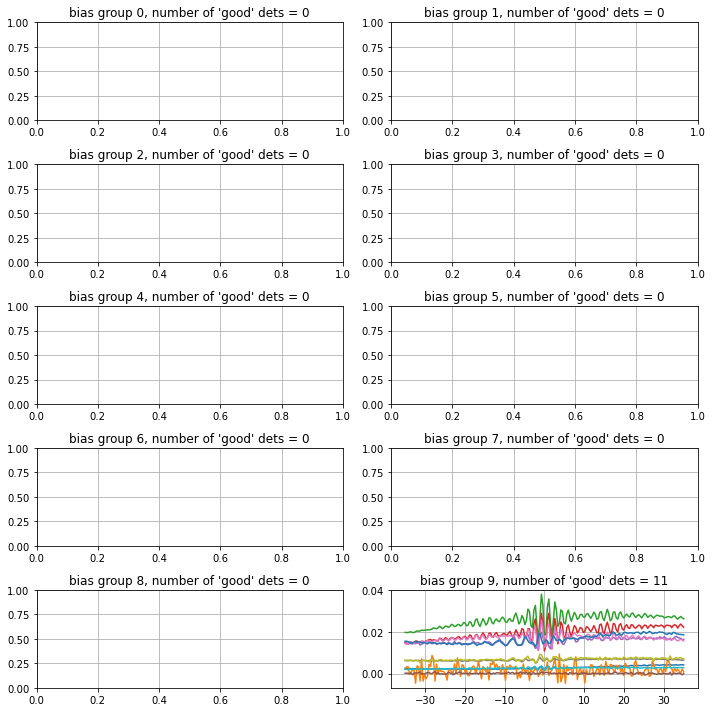

data saved to location FTS_data_integrated_bg9/run_16_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 17:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


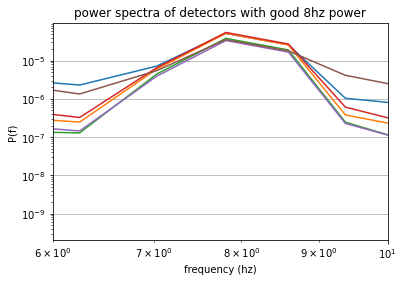

using power threshold of 10:


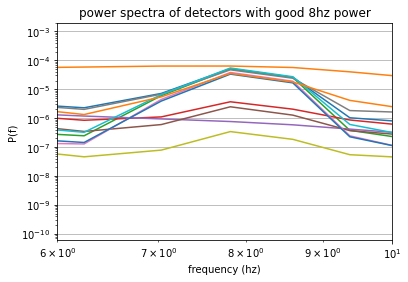

number of detectors with higher power in 8hz = 12


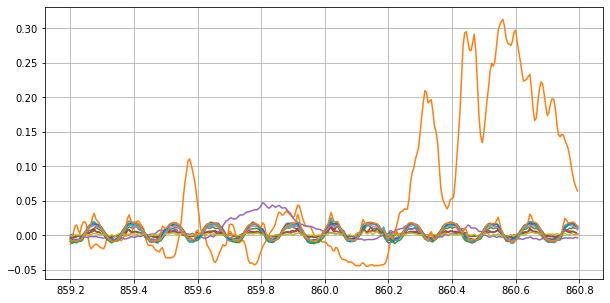

mean, median, std of fitted phases: -0.08, 0.31, 1.00


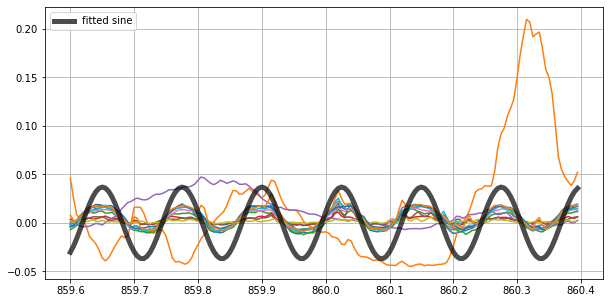

Phase fitting standard deviation is slightly high, check hist


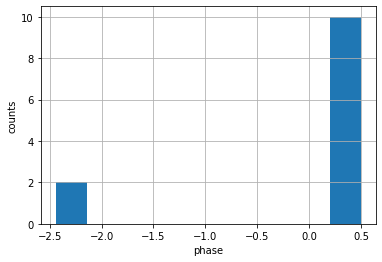

number of interferograms in bias group -1: 0


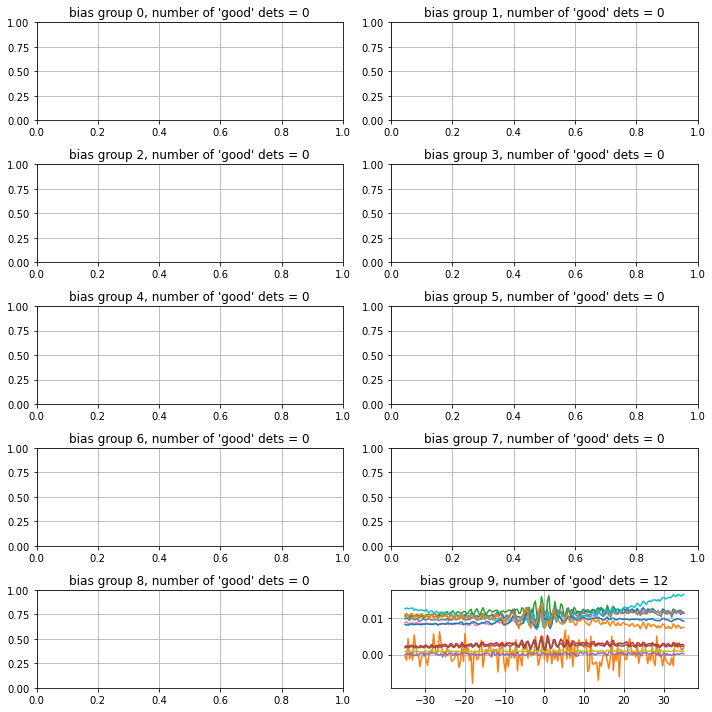

data saved to location FTS_data_integrated_bg9/run_17_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 18:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


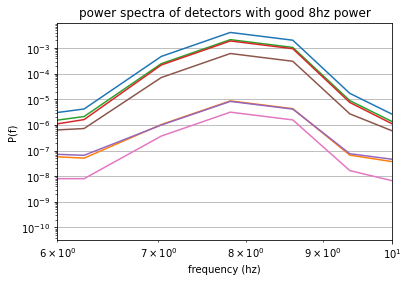

using power threshold of 10:


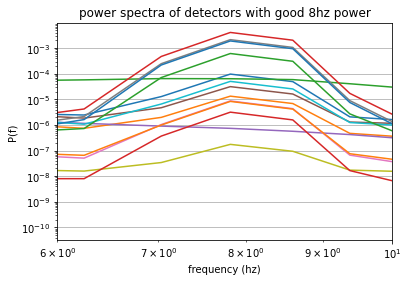

number of detectors with higher power in 8hz = 14


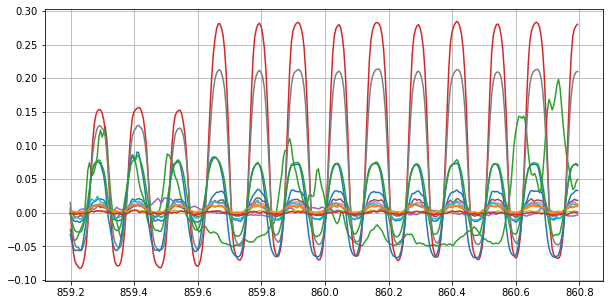

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


mean, median, std of fitted phases: 0.06, -0.17, 0.79


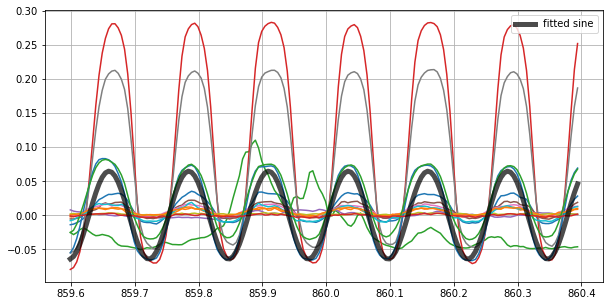

Phase fitting standard deviation is slightly high, check hist


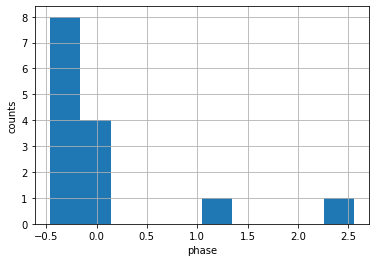

number of interferograms in bias group -1: 0


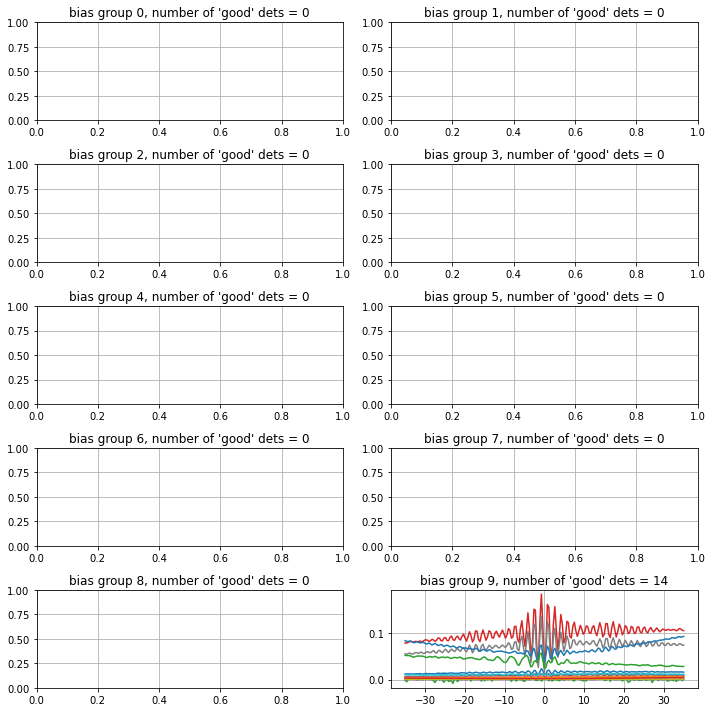

data saved to location FTS_data_integrated_bg9/run_18_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 19:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.13it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


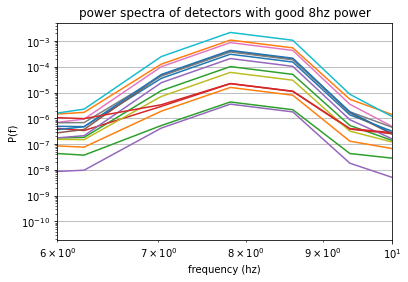

using power threshold of 10:


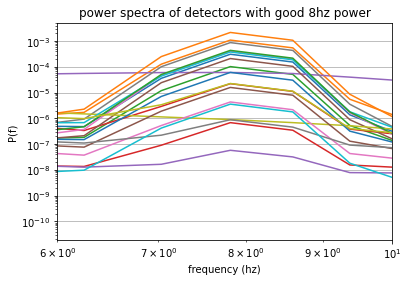

number of detectors with higher power in 8hz = 20


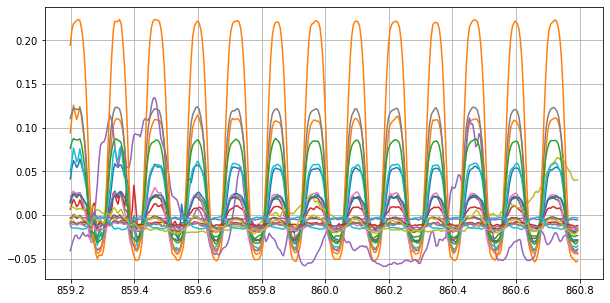

mean, median, std of fitted phases: 3.00, 3.02, 0.21


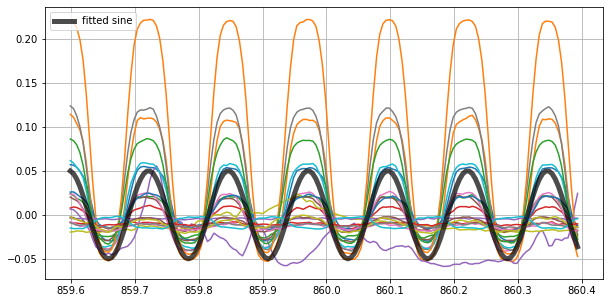

number of interferograms in bias group -1: 0


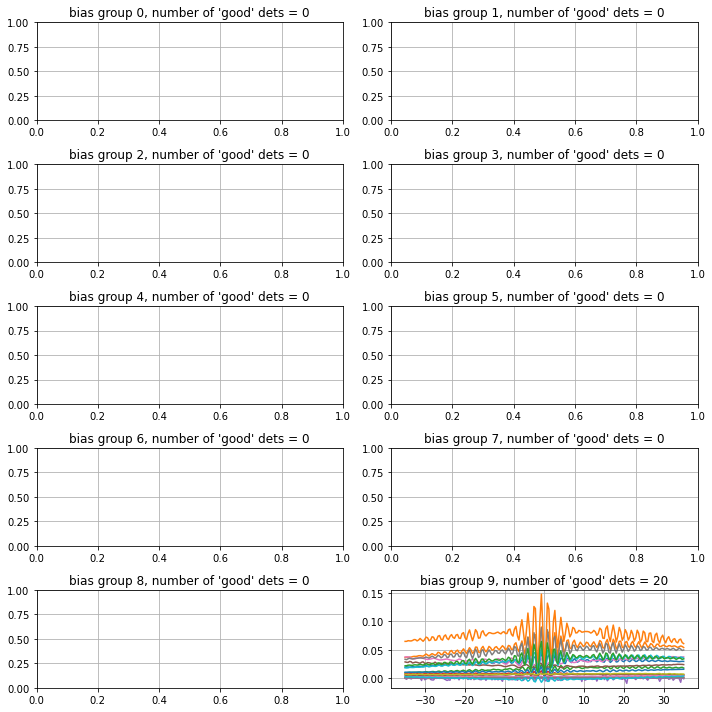

data saved to location FTS_data_integrated_bg9/run_19_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 20:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17224/ufm_lf_ln1_lp5_lp6/1722409235_000.g3
100%|██████████| 4/4 [00:05<00:00,  1.30s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


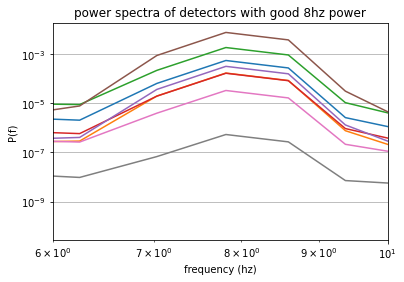

using power threshold of 10:


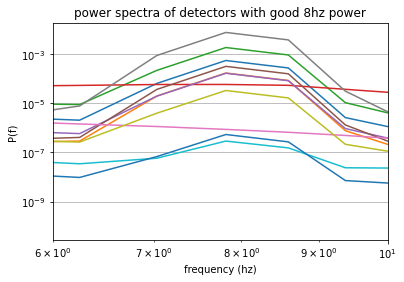

number of detectors with higher power in 8hz = 11


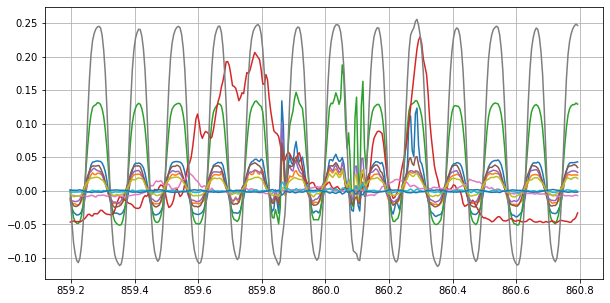

mean, median, std of fitted phases: 3.38, 3.33, 2.64


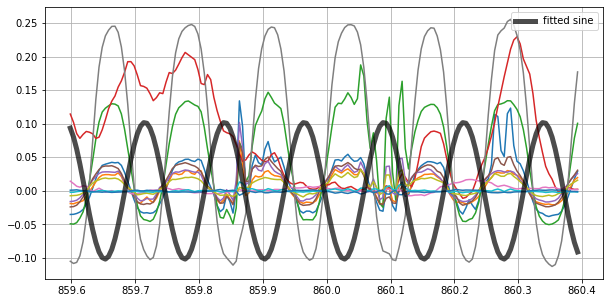

Phase fitting standard deviation is slightly high, check hist


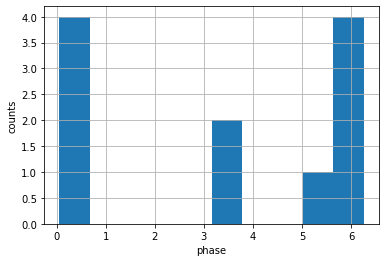

number of interferograms in bias group -1: 0


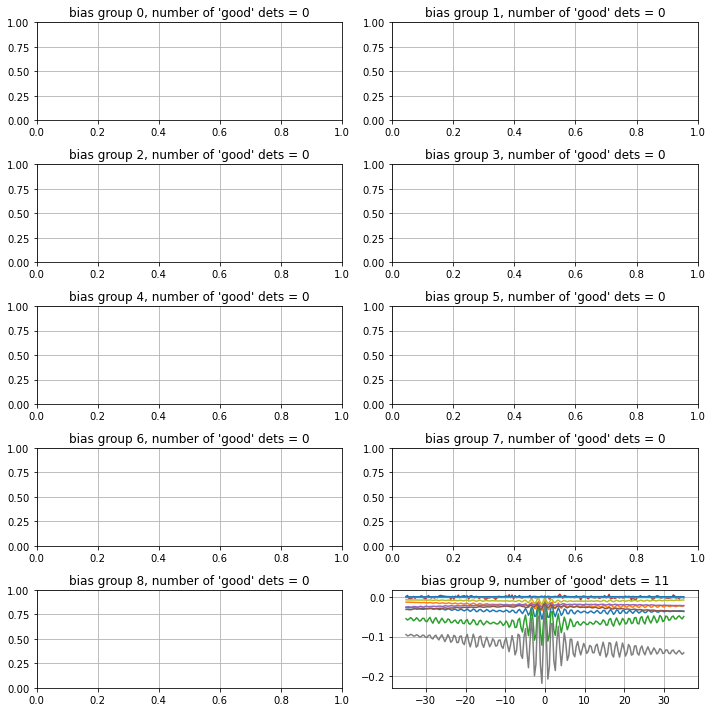

data saved to location FTS_data_integrated_bg9/run_20_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 21:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.05it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


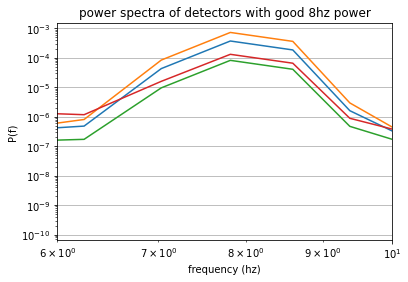

using power threshold of 10:


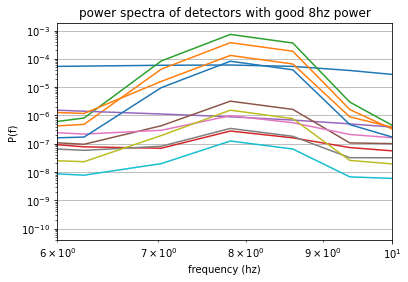

number of detectors with higher power in 8hz = 12


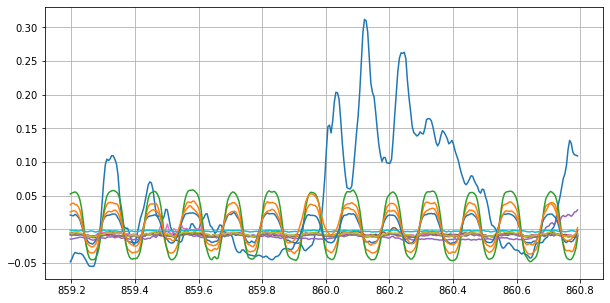

mean, median, std of fitted phases: 3.39, 3.81, 0.94


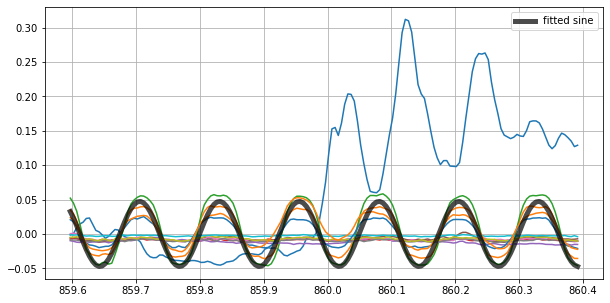

Phase fitting standard deviation is slightly high, check hist


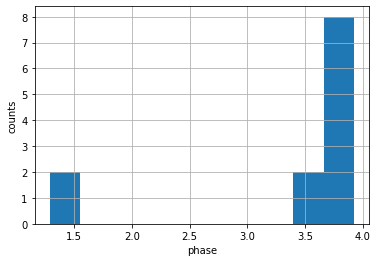

number of interferograms in bias group -1: 0


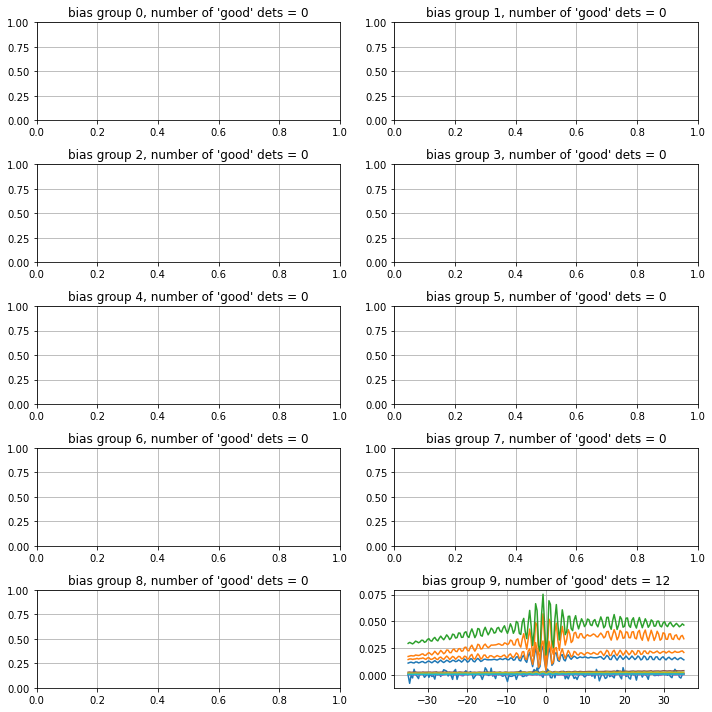

data saved to location FTS_data_integrated_bg9/run_21_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 22:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


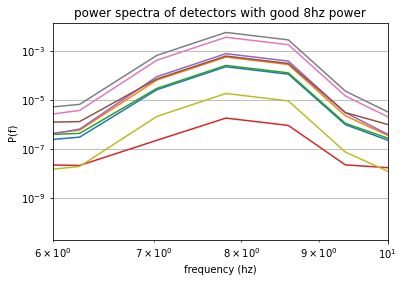

using power threshold of 10:


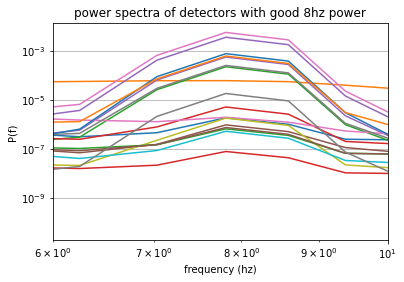

number of detectors with higher power in 8hz = 18


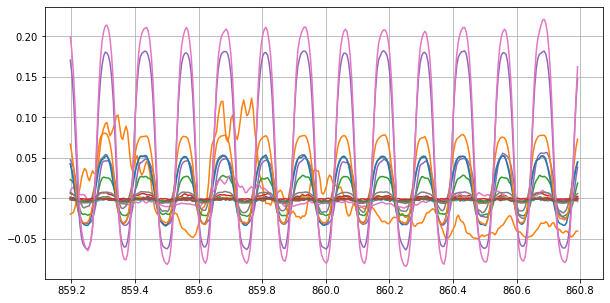

mean, median, std of fitted phases: 5.04, 5.00, 0.25


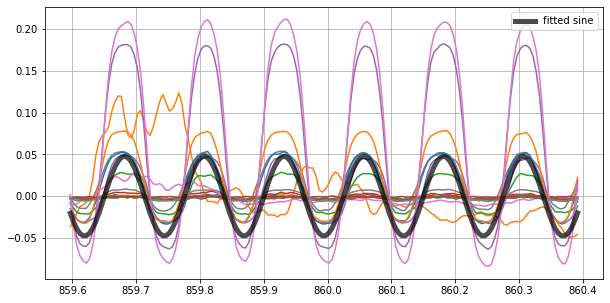

number of interferograms in bias group -1: 0


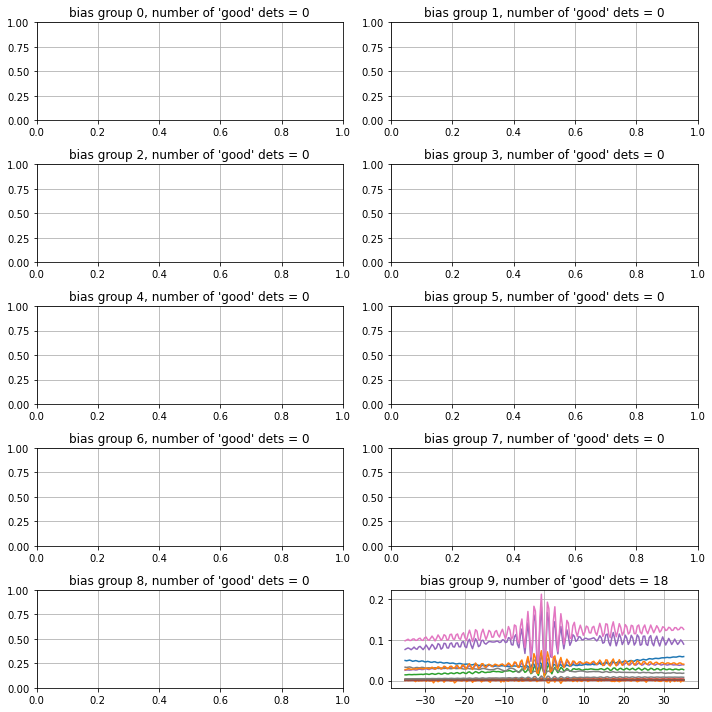

data saved to location FTS_data_integrated_bg9/run_22_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 23:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


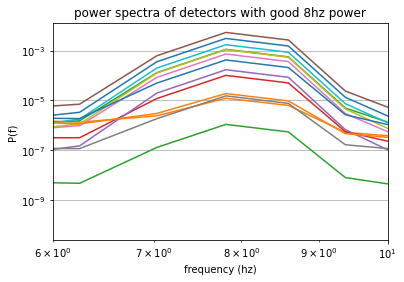

using power threshold of 10:


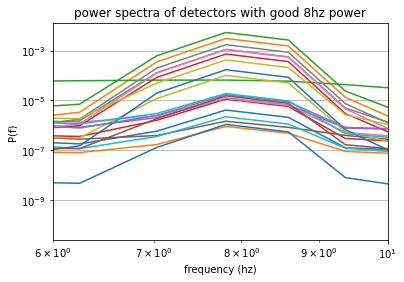

number of detectors with higher power in 8hz = 21


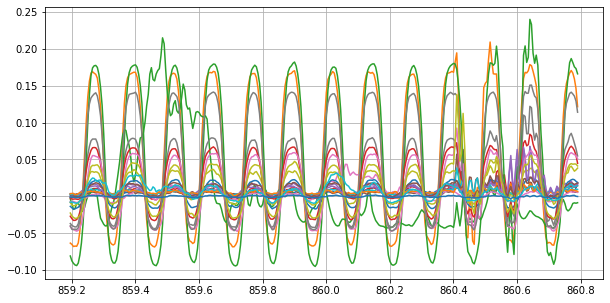

mean, median, std of fitted phases: 0.56, 0.48, 0.41


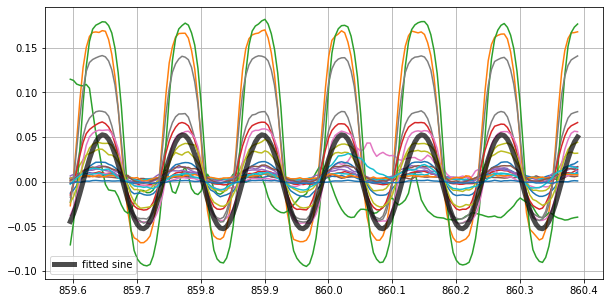

Phase fitting standard deviation is slightly high, check hist


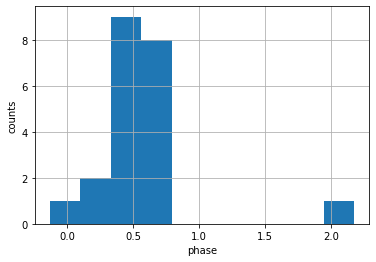

number of interferograms in bias group -1: 0


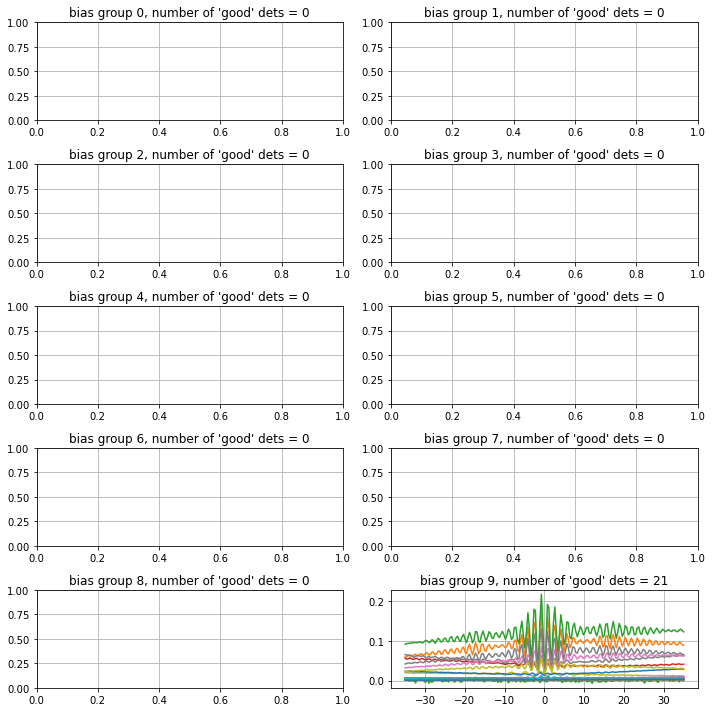

data saved to location FTS_data_integrated_bg9/run_23_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 24:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


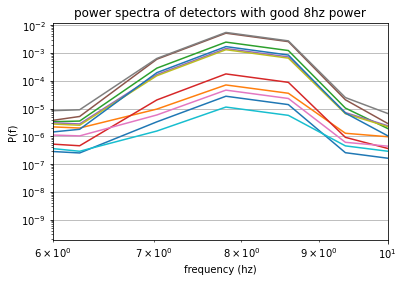

using power threshold of 10:


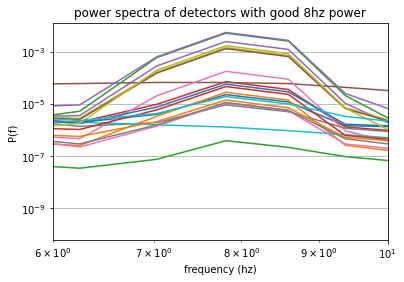

number of detectors with higher power in 8hz = 20


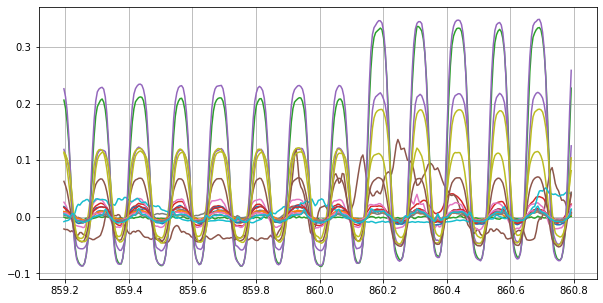

mean, median, std of fitted phases: -1.34, -1.48, 0.51


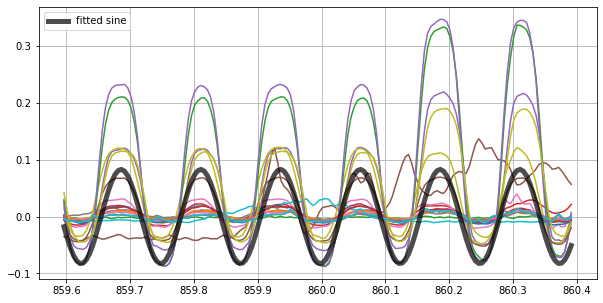

Phase fitting standard deviation is slightly high, check hist


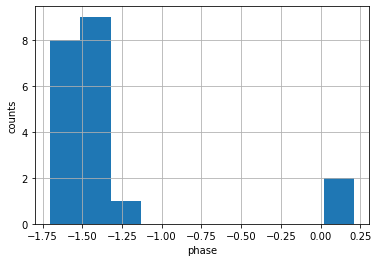

number of interferograms in bias group -1: 0


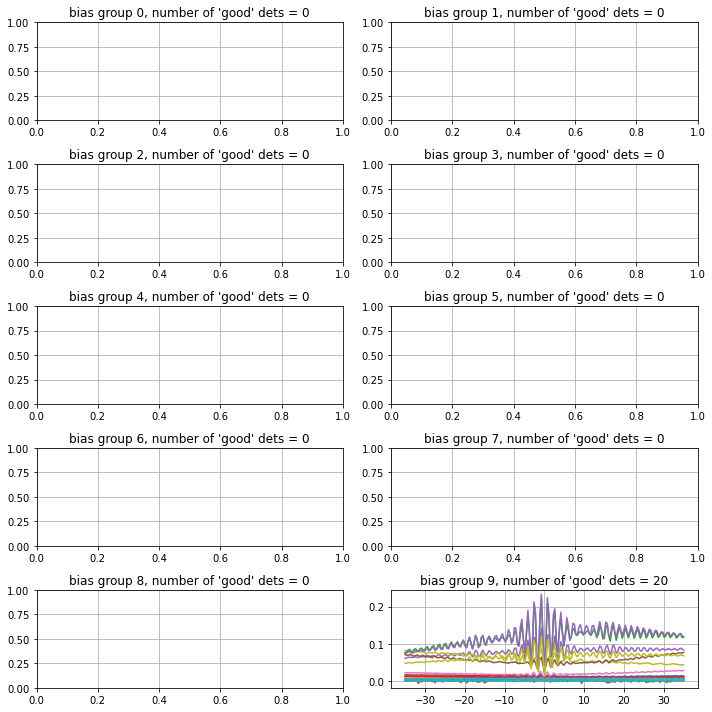

data saved to location FTS_data_integrated_bg9/run_24_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 25:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


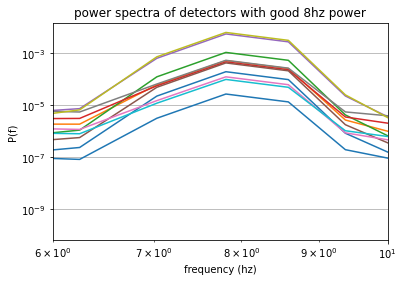

using power threshold of 10:


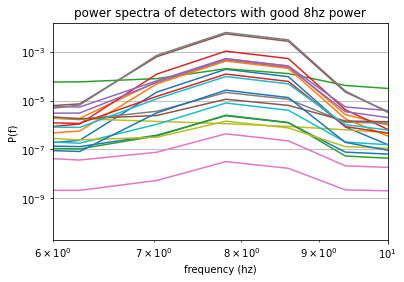

number of detectors with higher power in 8hz = 21


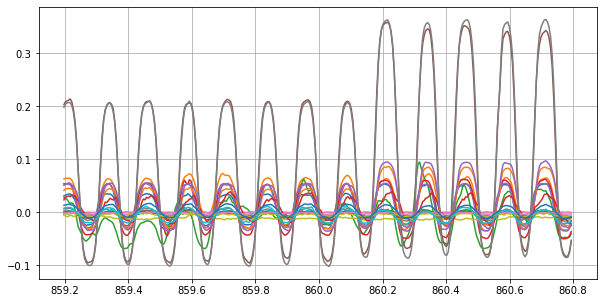

mean, median, std of fitted phases: 3.27, 3.50, 0.77


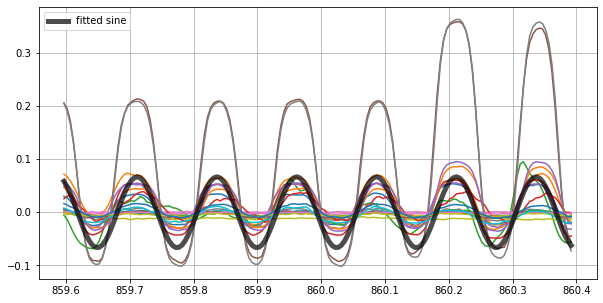

Phase fitting standard deviation is slightly high, check hist


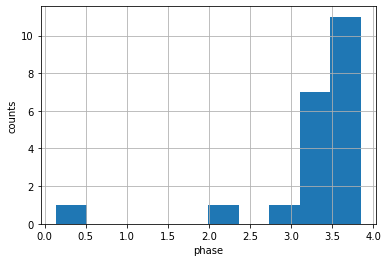

number of interferograms in bias group -1: 0


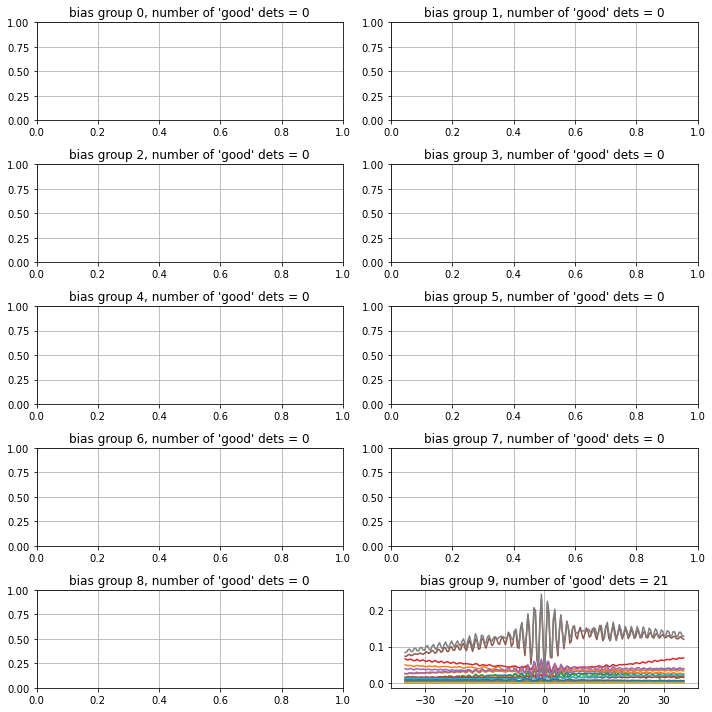

data saved to location FTS_data_integrated_bg9/run_25_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 26:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.05it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


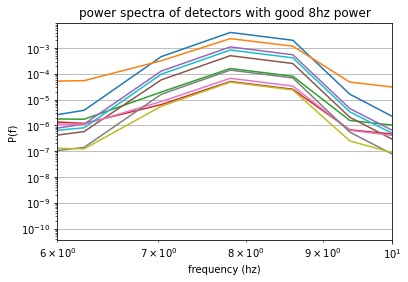

using power threshold of 10:


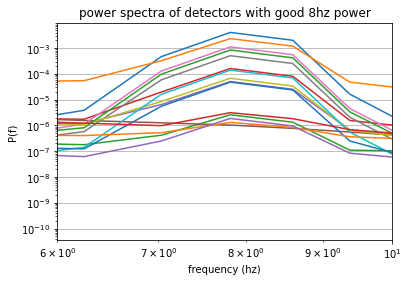

number of detectors with higher power in 8hz = 15


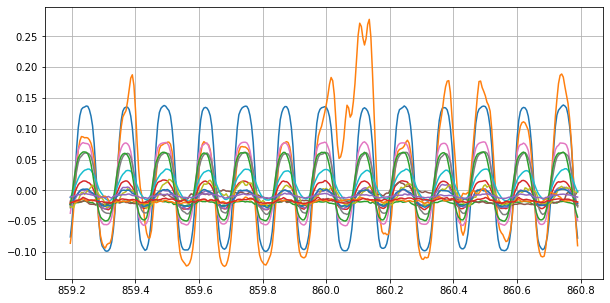

mean, median, std of fitted phases: 1.89, 1.84, 0.24


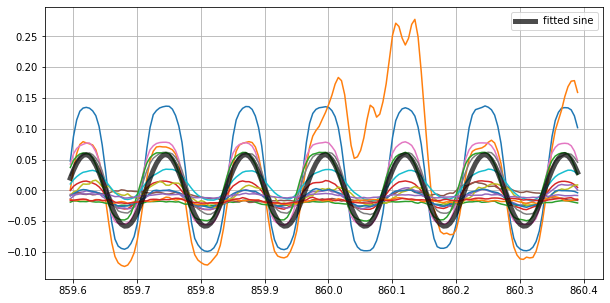

number of interferograms in bias group -1: 0


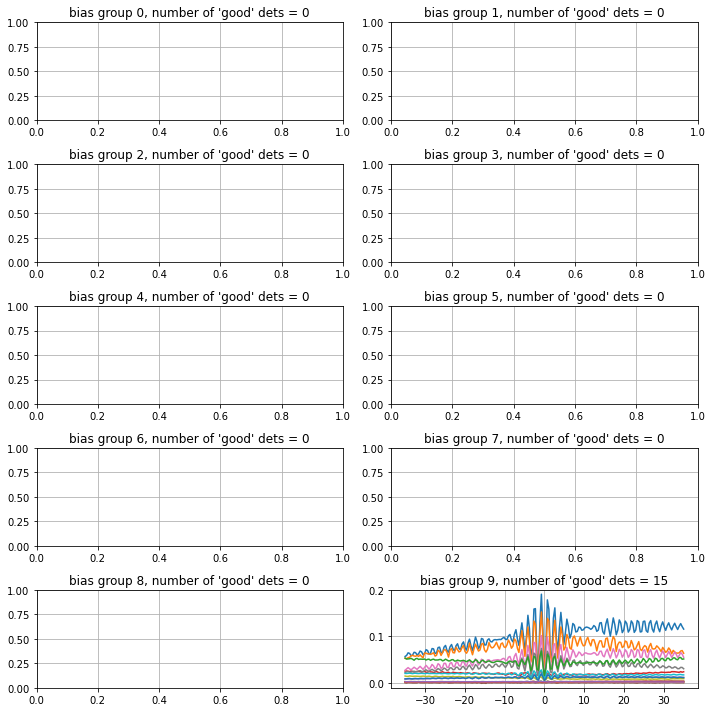

data saved to location FTS_data_integrated_bg9/run_26_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 27:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.00s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


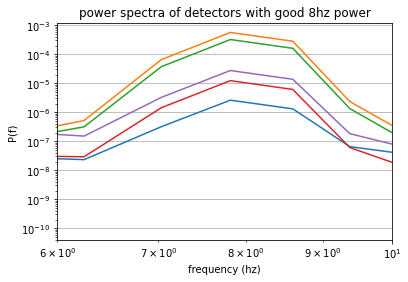

using power threshold of 10:


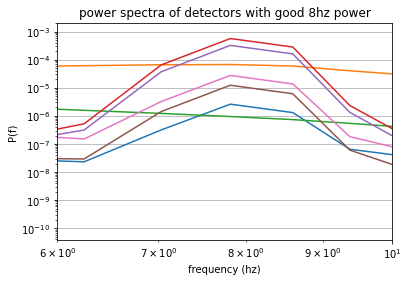

number of detectors with higher power in 8hz = 7


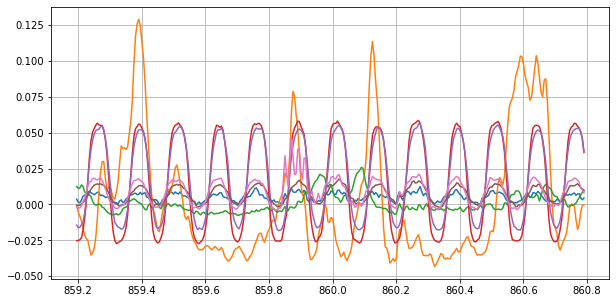

mean, median, std of fitted phases: 1.27, 1.07, 0.89


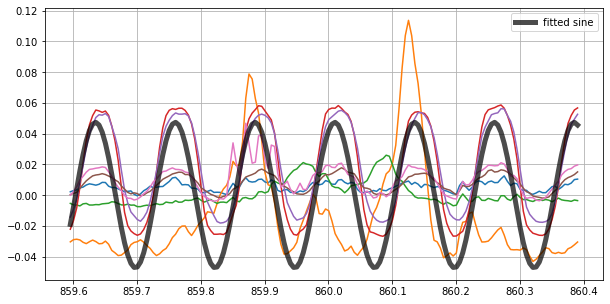

Phase fitting standard deviation is slightly high, check hist


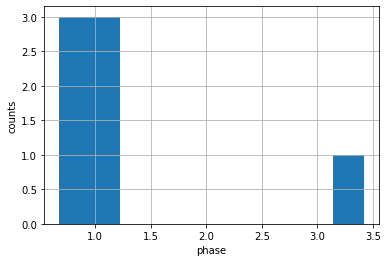

number of interferograms in bias group -1: 0


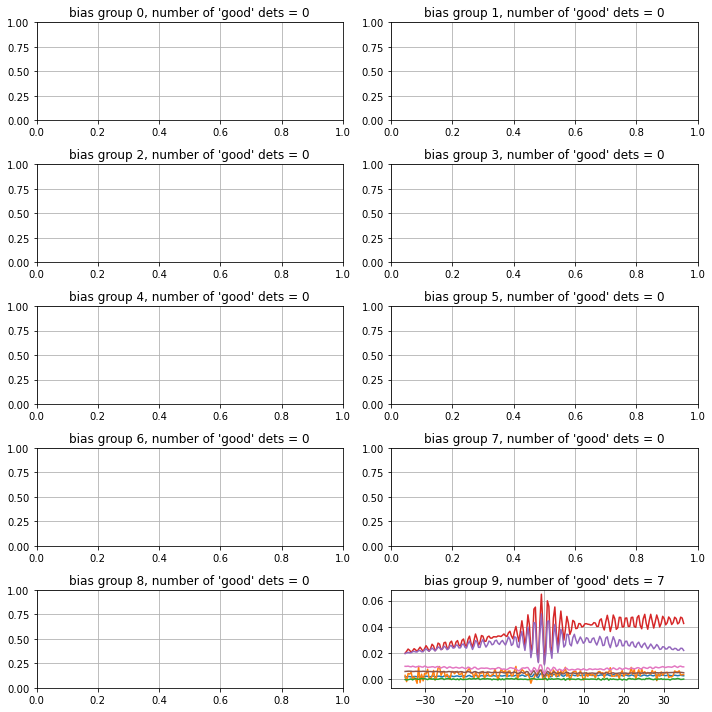

data saved to location FTS_data_integrated_bg9/run_27_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 28:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


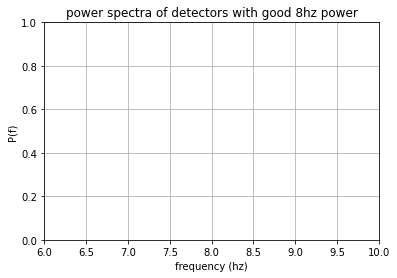

using power threshold of 10:


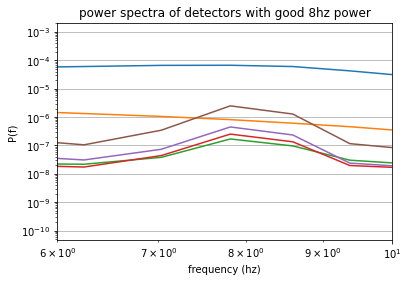

number of detectors with higher power in 8hz = 6


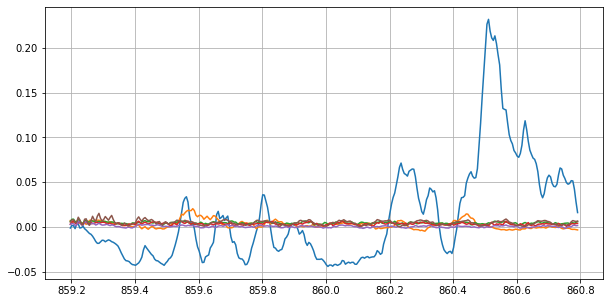

mean, median, std of fitted phases: 4.39, 4.81, 0.83


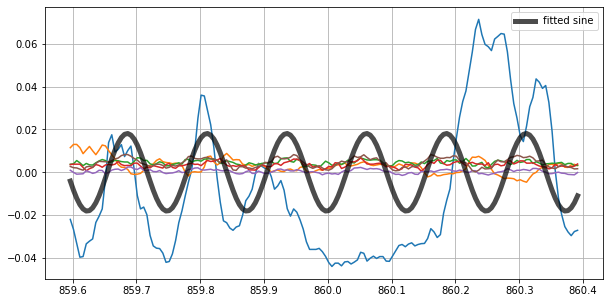

Phase fitting standard deviation is slightly high, check hist


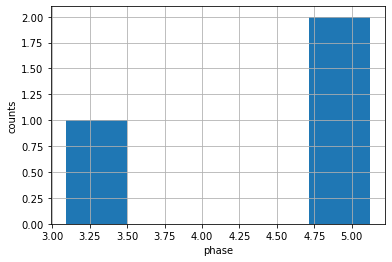

number of interferograms in bias group -1: 0


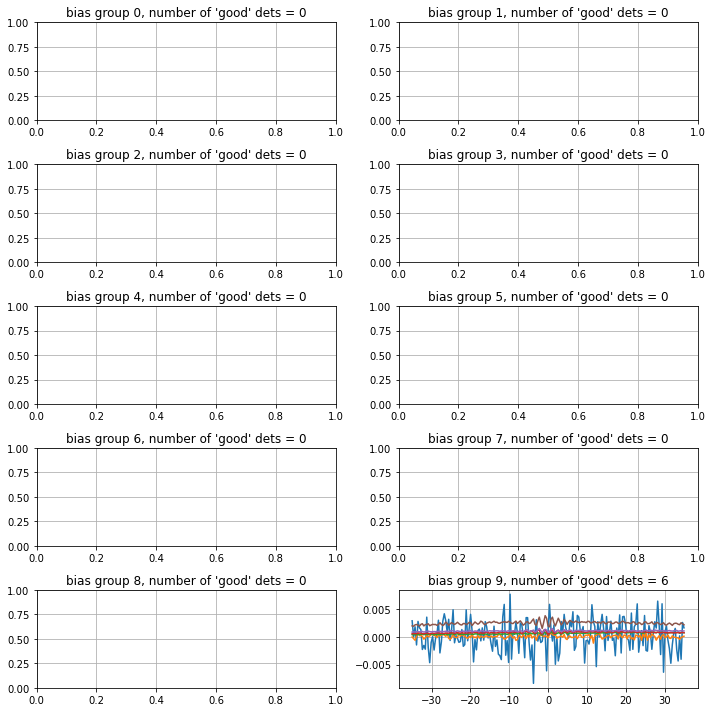

data saved to location FTS_data_integrated_bg9/run_28_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 29:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.01s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


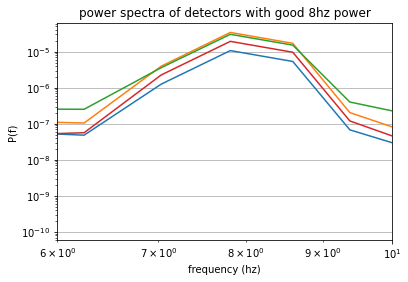

using power threshold of 10:


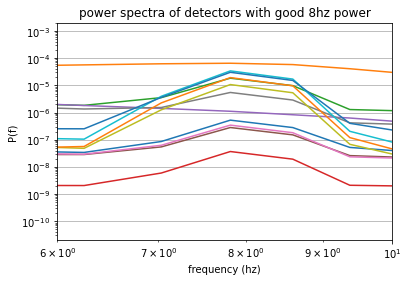

number of detectors with higher power in 8hz = 12


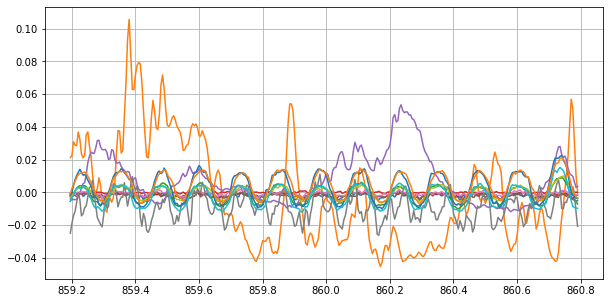

mean, median, std of fitted phases: 2.56, 2.51, 0.97


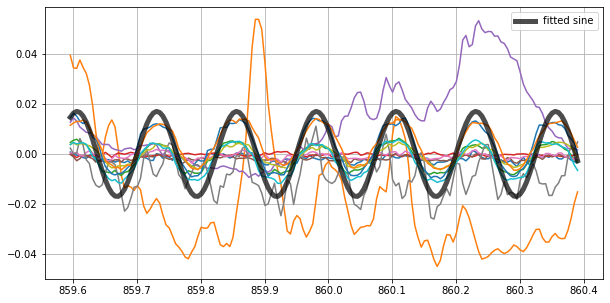

Phase fitting standard deviation is slightly high, check hist


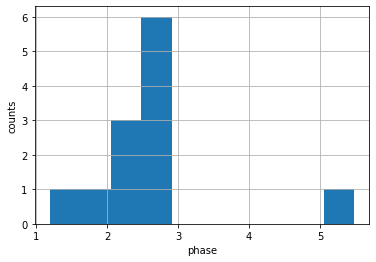

number of interferograms in bias group -1: 0


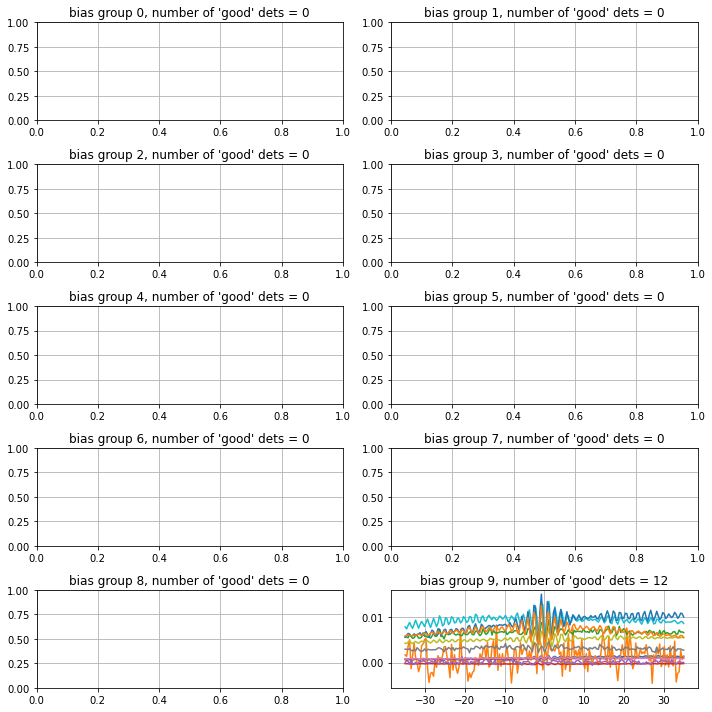

data saved to location FTS_data_integrated_bg9/run_29_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 30:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


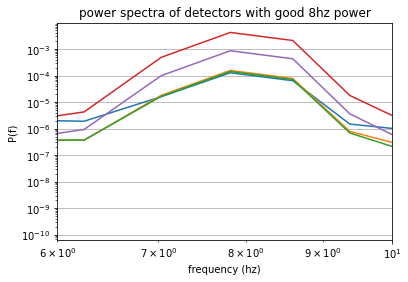

using power threshold of 10:


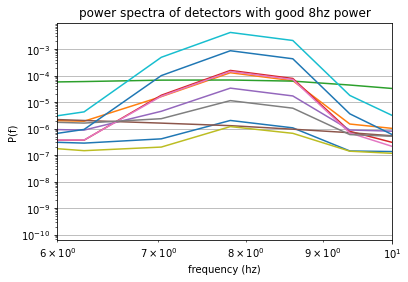

number of detectors with higher power in 8hz = 11


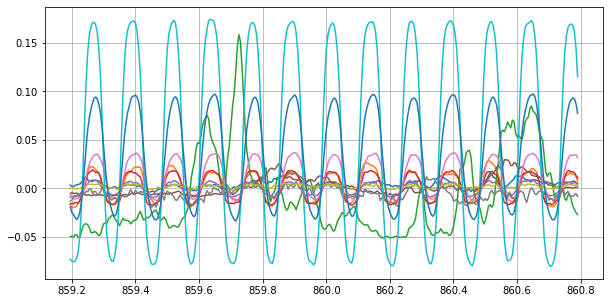

mean, median, std of fitted phases: 1.21, 0.74, 1.12


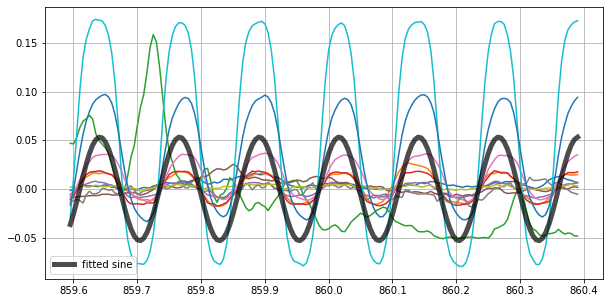

Phase fitting standard deviation is slightly high, check hist


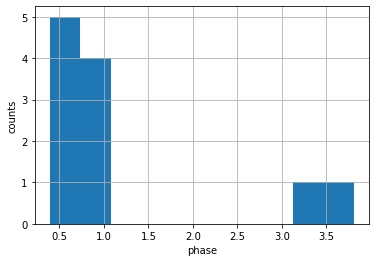

number of interferograms in bias group -1: 0


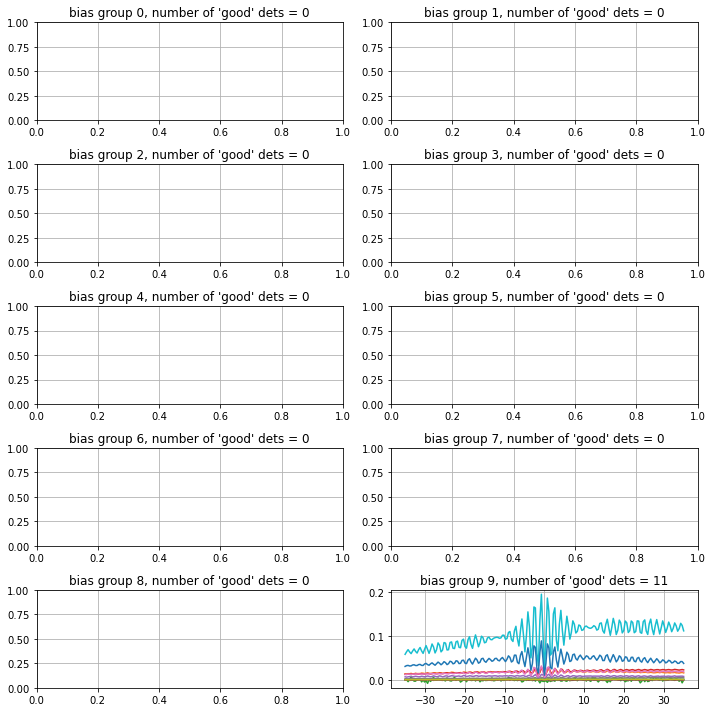

data saved to location FTS_data_integrated_bg9/run_30_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 31:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.08it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


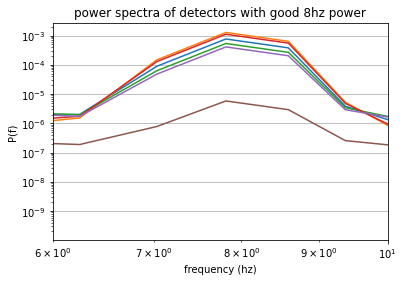

using power threshold of 10:


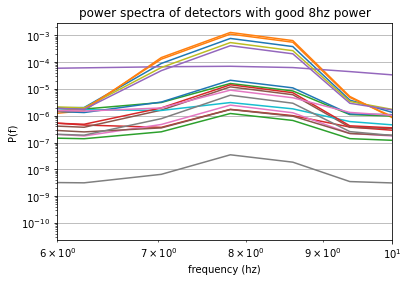

number of detectors with higher power in 8hz = 18


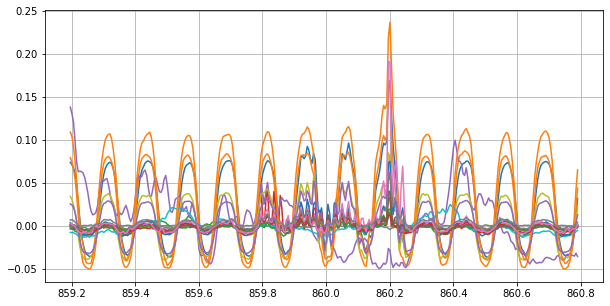

mean, median, std of fitted phases: 4.54, 4.70, 0.77


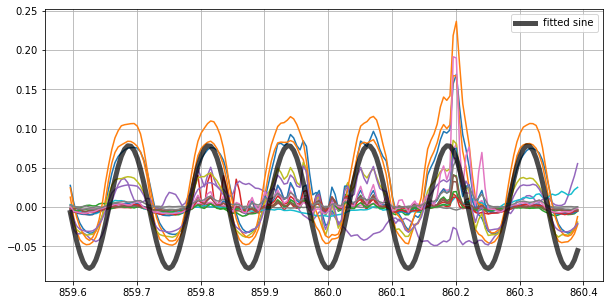

Phase fitting standard deviation is slightly high, check hist


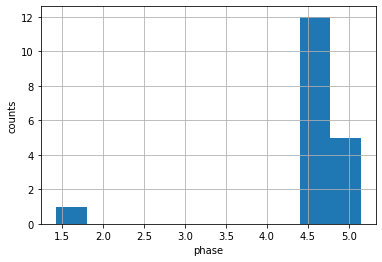

number of interferograms in bias group -1: 0


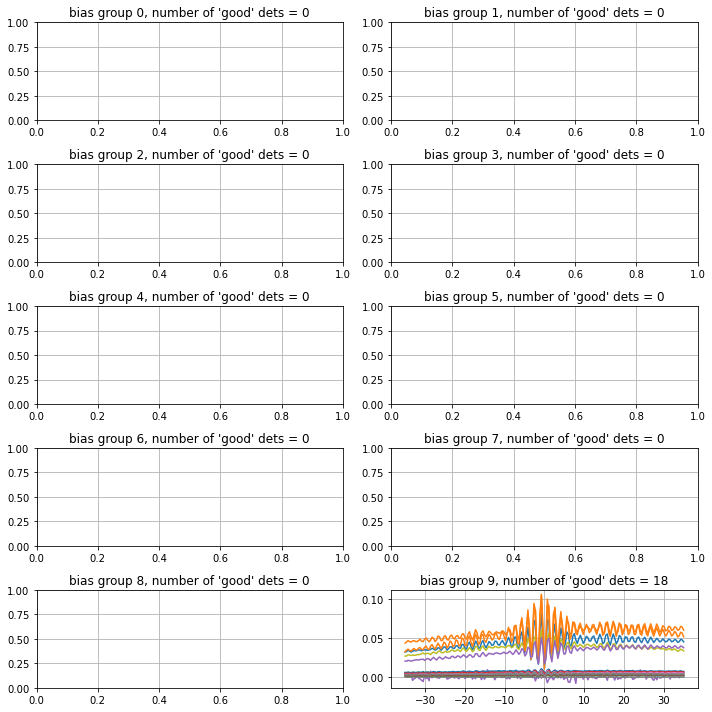

data saved to location FTS_data_integrated_bg9/run_31_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 32:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.00it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


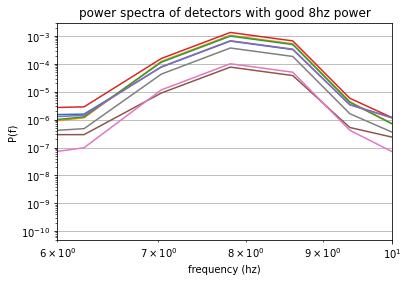

using power threshold of 10:


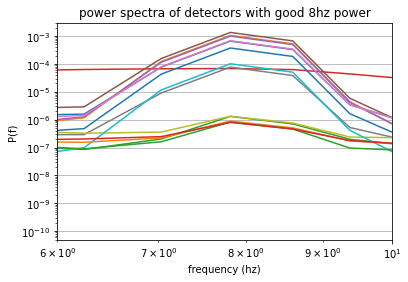

number of detectors with higher power in 8hz = 14


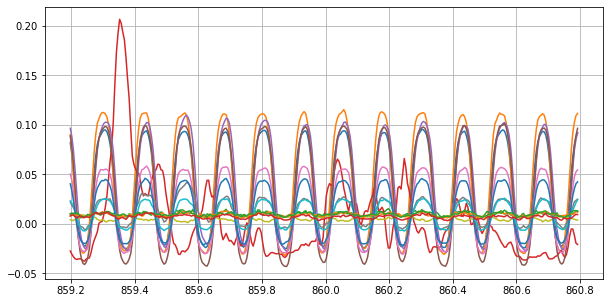

mean, median, std of fitted phases: -0.83, -1.22, 1.00


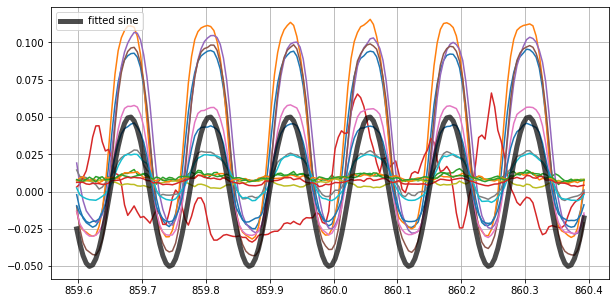

Phase fitting standard deviation is slightly high, check hist


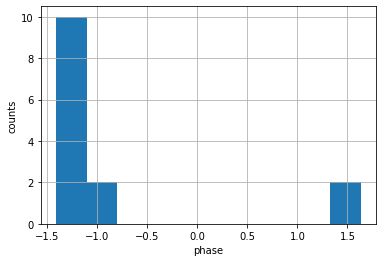

number of interferograms in bias group -1: 0


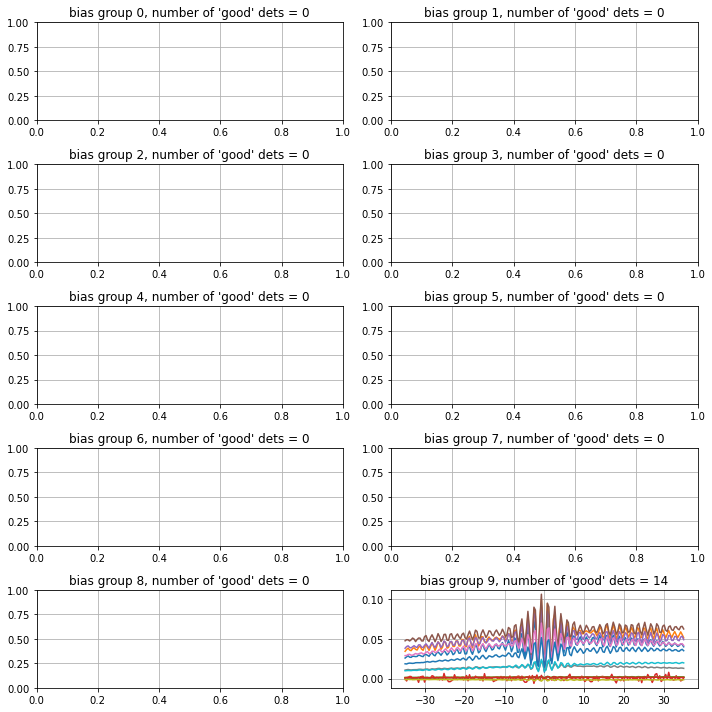

data saved to location FTS_data_integrated_bg9/run_32_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 33:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.15it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


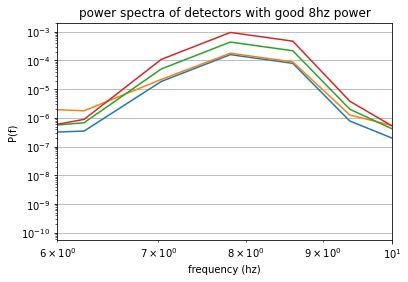

using power threshold of 10:


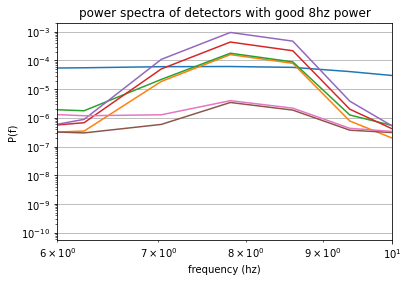

number of detectors with higher power in 8hz = 7


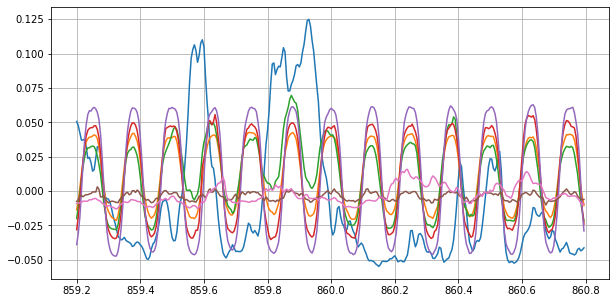

mean, median, std of fitted phases: 1.96, 1.60, 0.89


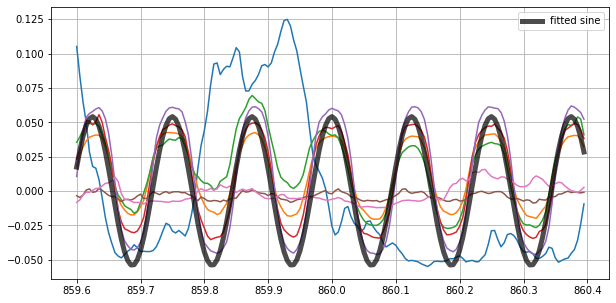

Phase fitting standard deviation is slightly high, check hist


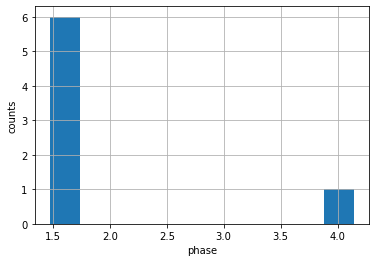

number of interferograms in bias group -1: 0


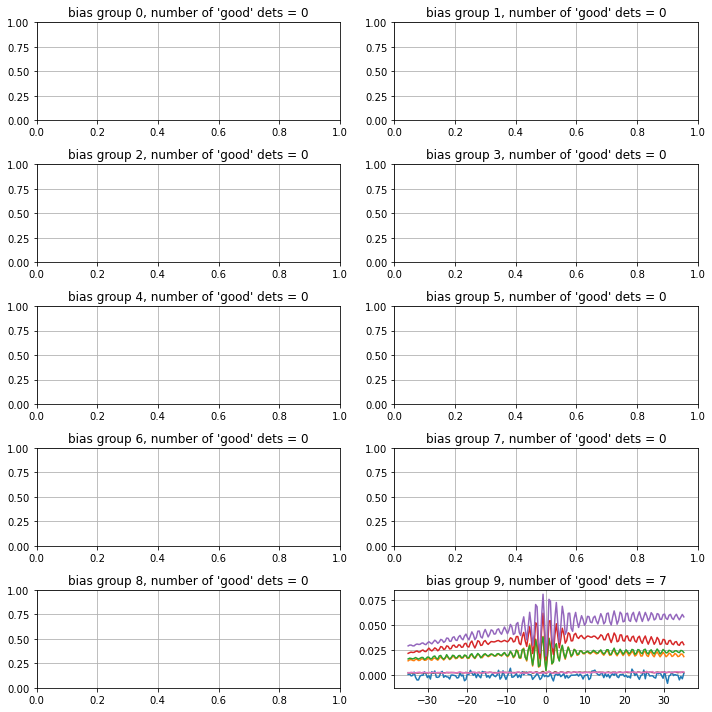

data saved to location FTS_data_integrated_bg9/run_33_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 34:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:05<00:00,  1.32s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


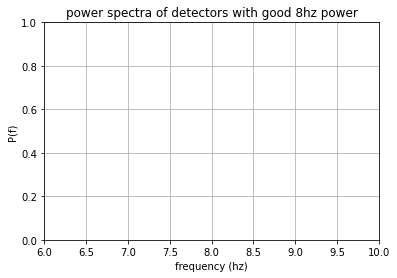

using power threshold of 10:


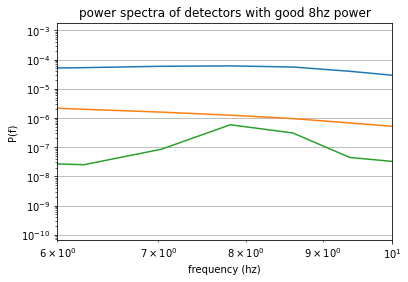

number of detectors with higher power in 8hz = 3
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


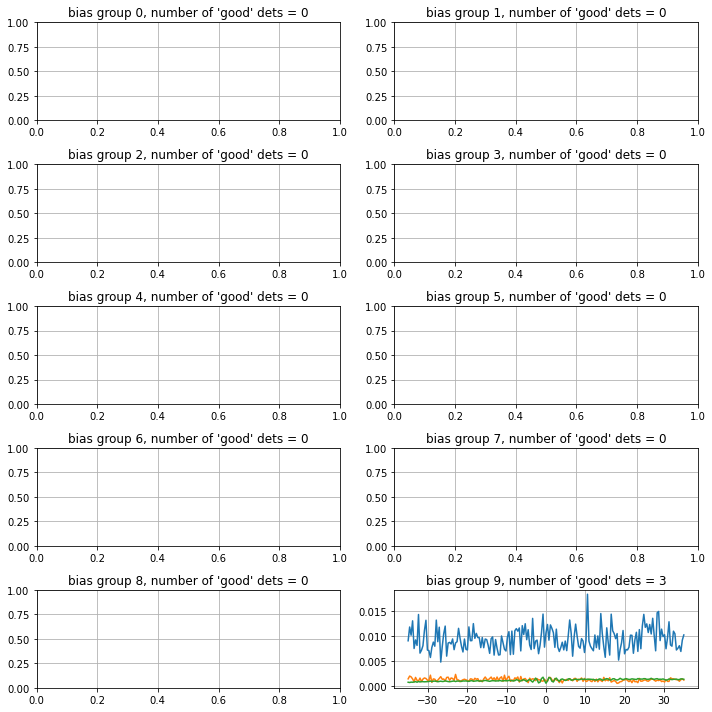

data saved to location FTS_data_integrated_bg9/run_34_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 1:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.02s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


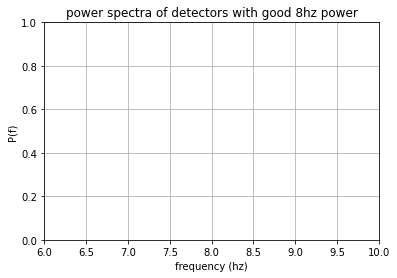

using power threshold of 10:


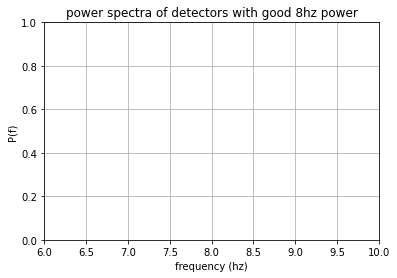

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


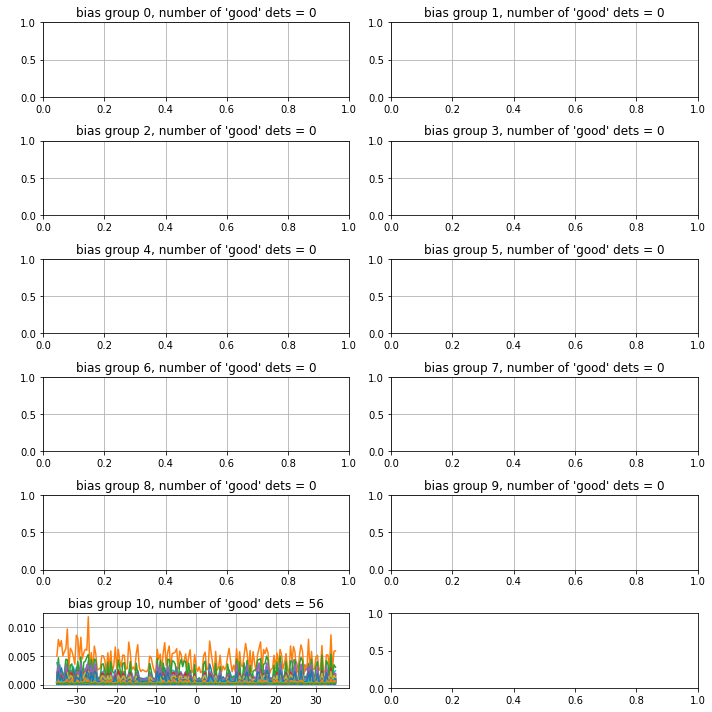

data saved to location FTS_data_integrated_bg10/run_1_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 2:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.01s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


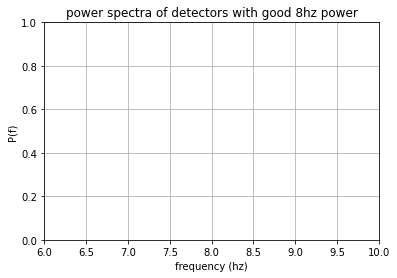

using power threshold of 10:


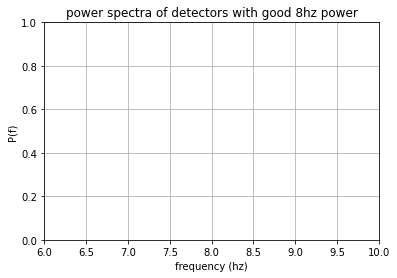

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


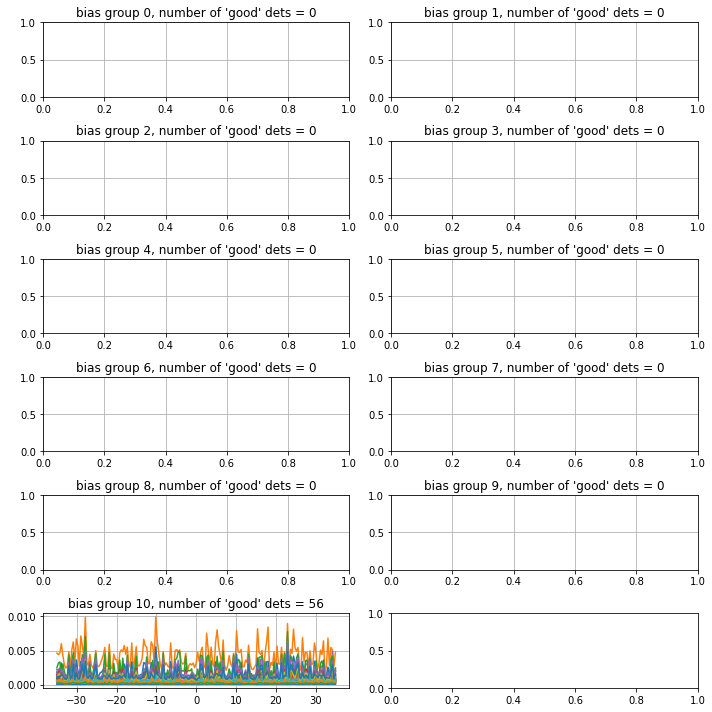

data saved to location FTS_data_integrated_bg10/run_2_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 3:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


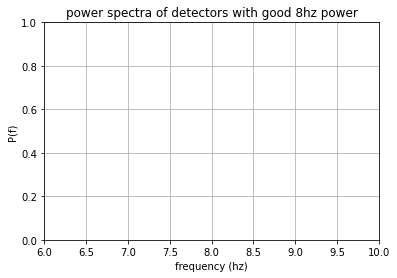

using power threshold of 10:


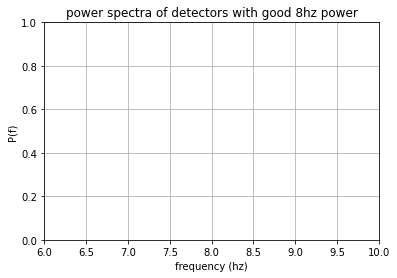

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine


/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


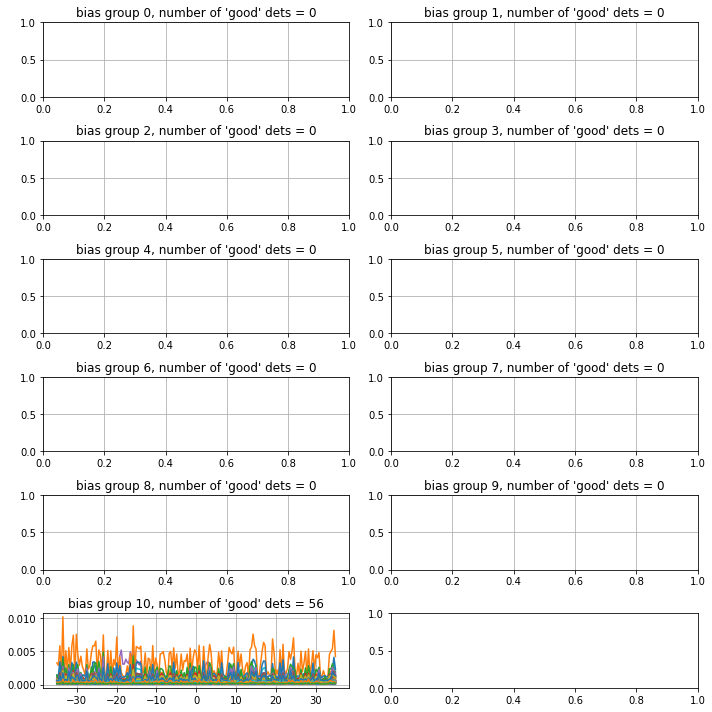

data saved to location FTS_data_integrated_bg10/run_3_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 4:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.05it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


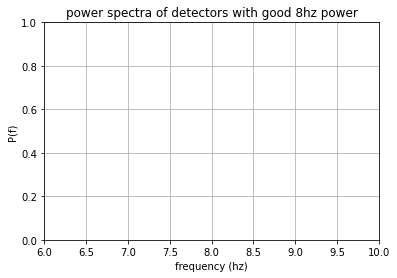

using power threshold of 10:


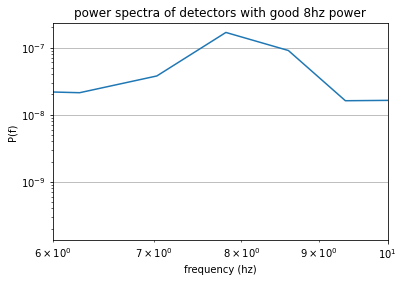

number of detectors with higher power in 8hz = 1
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


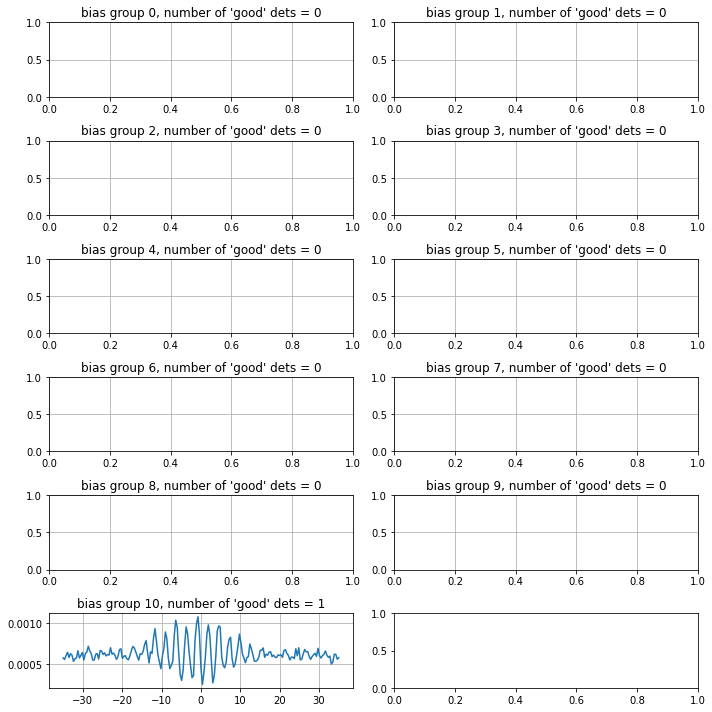

data saved to location FTS_data_integrated_bg10/run_4_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 5:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.01it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


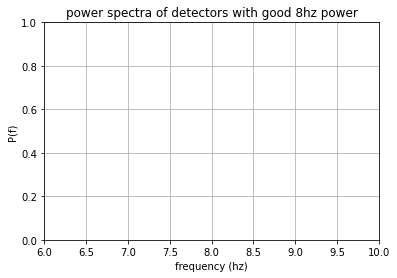

using power threshold of 10:


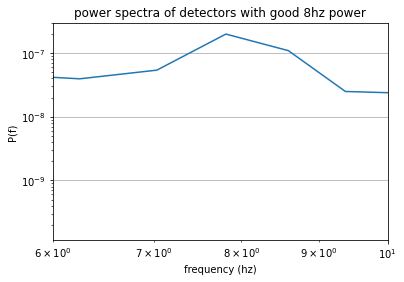

number of detectors with higher power in 8hz = 1
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


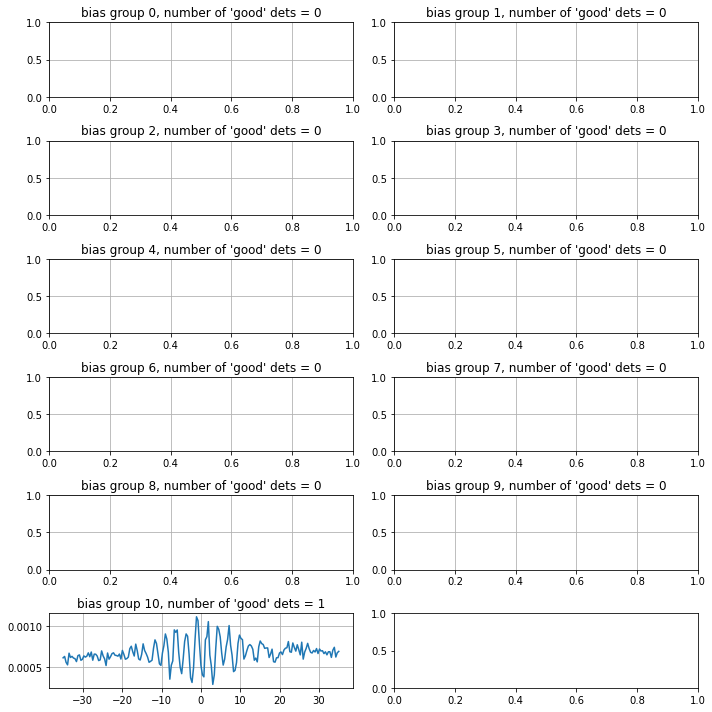

data saved to location FTS_data_integrated_bg10/run_5_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 6:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.00it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


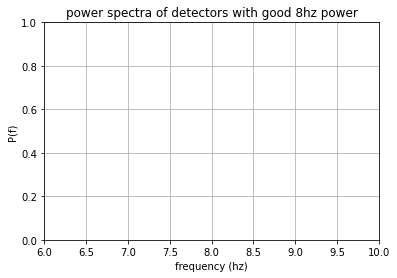

using power threshold of 10:


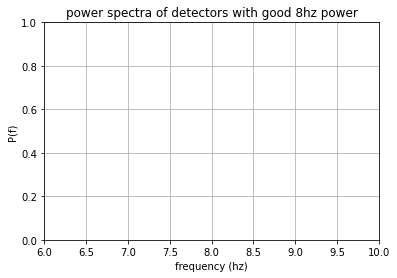

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


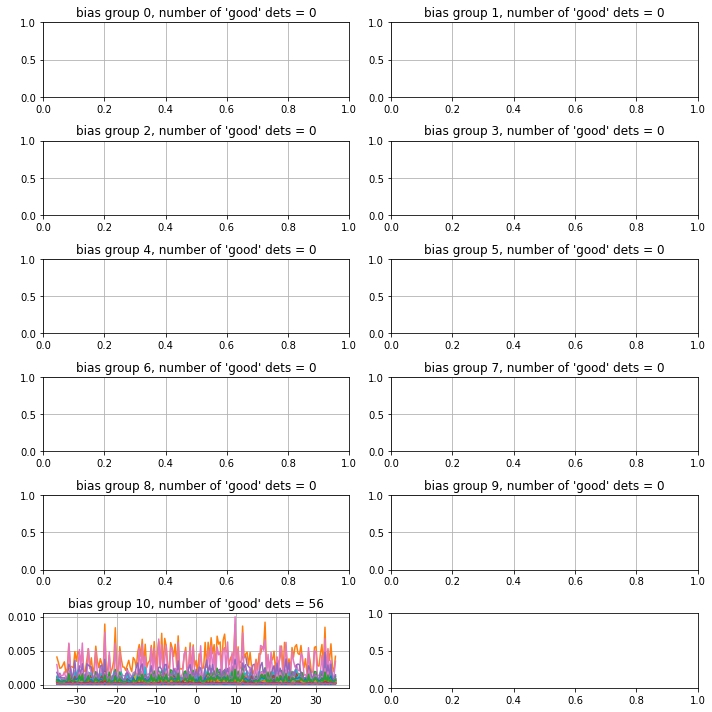

data saved to location FTS_data_integrated_bg10/run_6_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 7:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.02s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


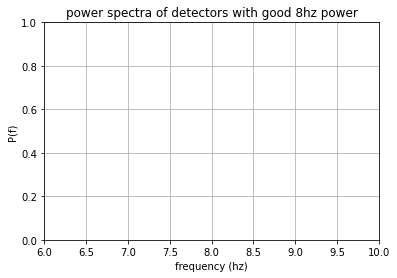

using power threshold of 10:


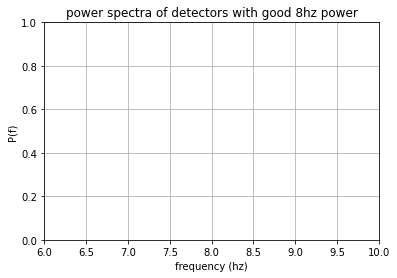

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


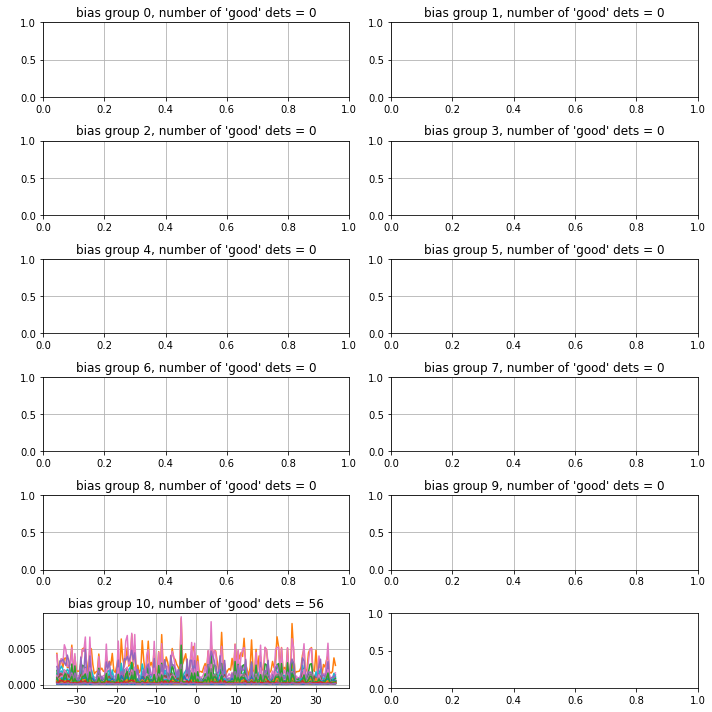

data saved to location FTS_data_integrated_bg10/run_7_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 8:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.12it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


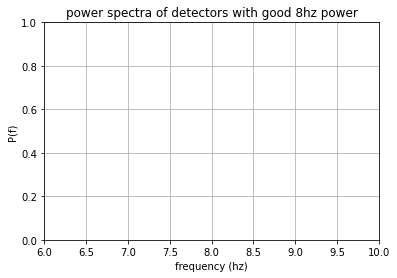

using power threshold of 10:


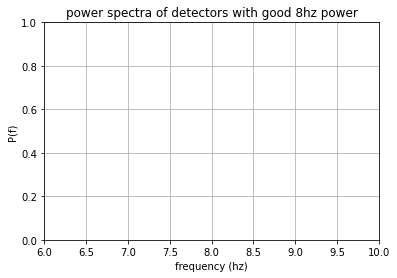

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


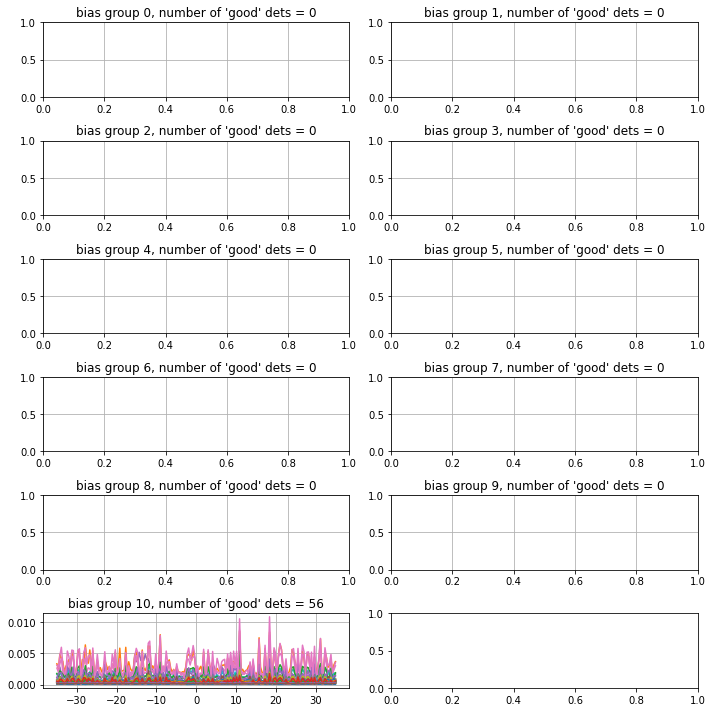

data saved to location FTS_data_integrated_bg10/run_8_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 9:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.08it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


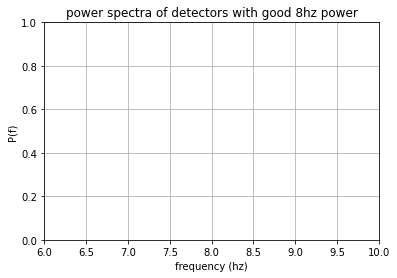

using power threshold of 10:


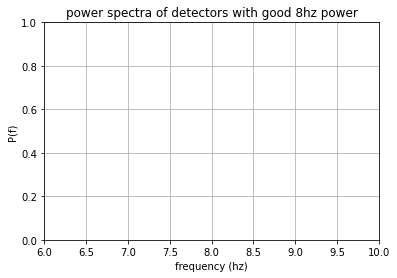

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


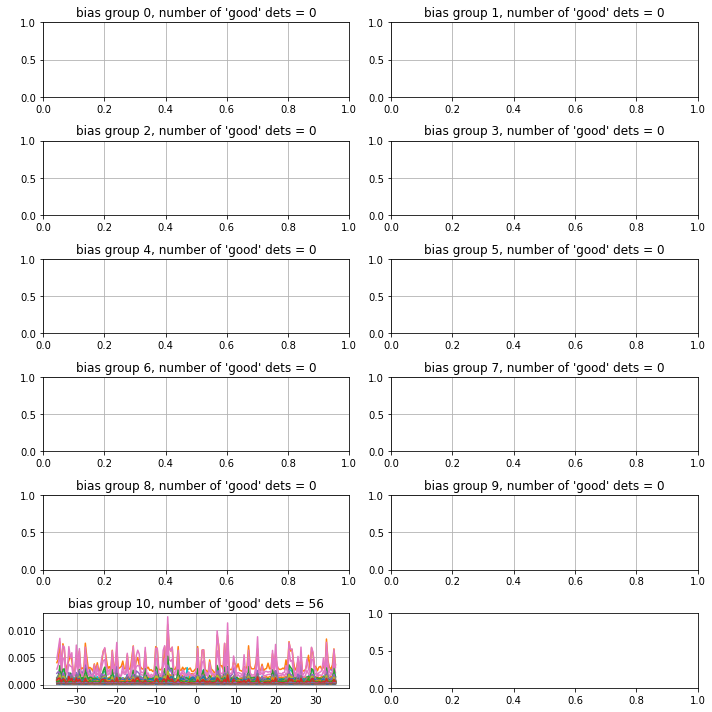

data saved to location FTS_data_integrated_bg10/run_9_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 10:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


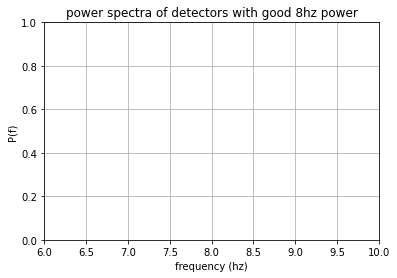

using power threshold of 10:


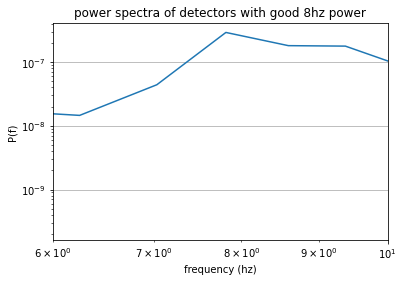

number of detectors with higher power in 8hz = 1
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


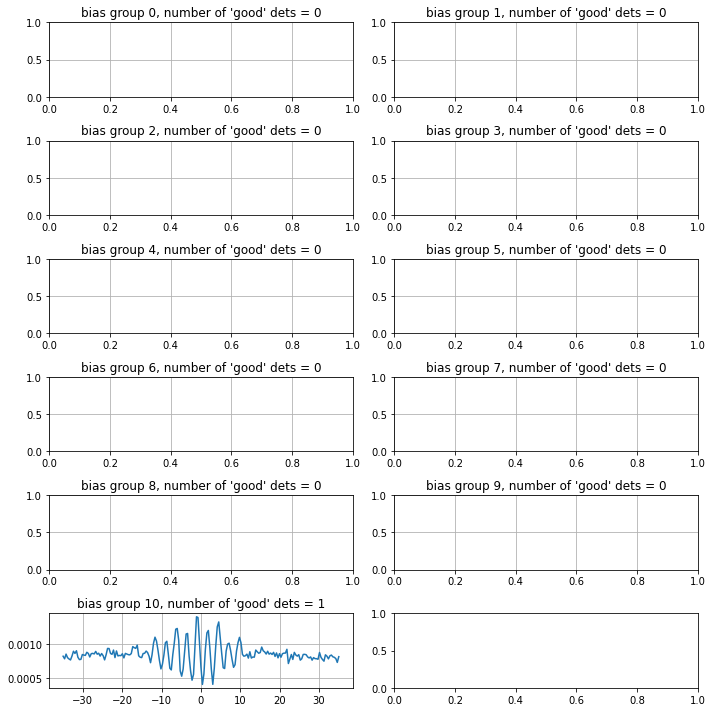

data saved to location FTS_data_integrated_bg10/run_10_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 11:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.10it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


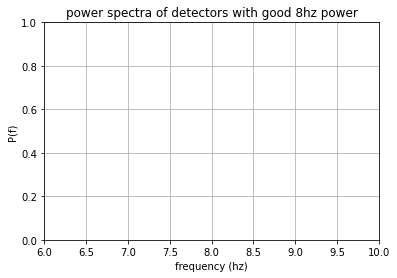

using power threshold of 10:


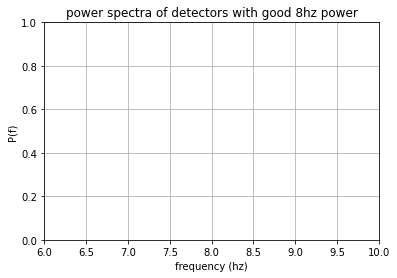

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine


/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


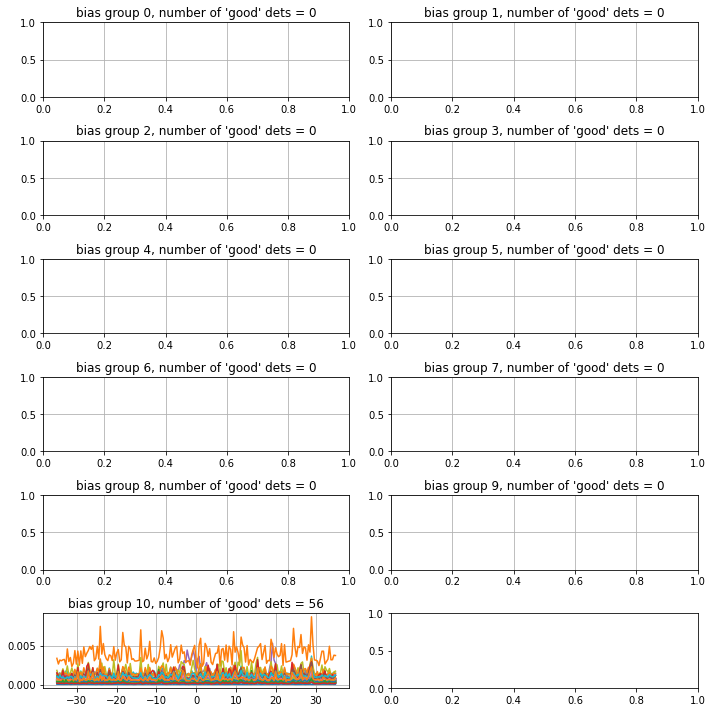

data saved to location FTS_data_integrated_bg10/run_11_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 12:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.01it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


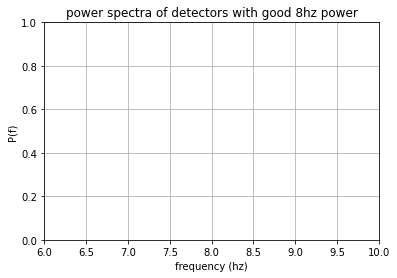

using power threshold of 10:


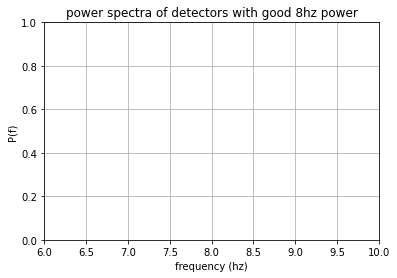

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


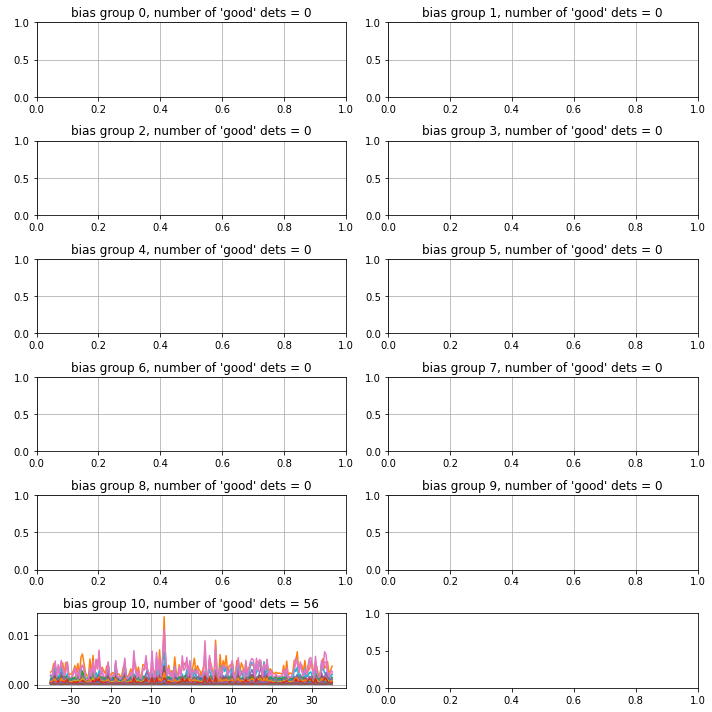

data saved to location FTS_data_integrated_bg10/run_12_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 13:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.01s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


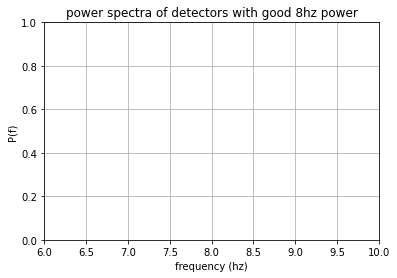

using power threshold of 10:


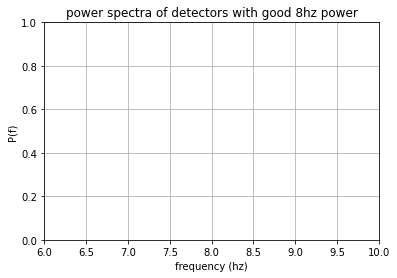

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


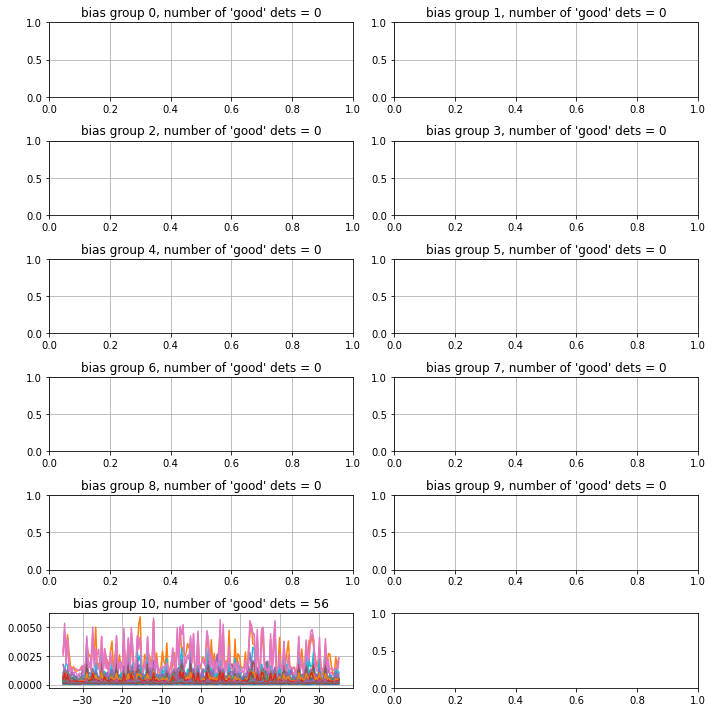

data saved to location FTS_data_integrated_bg10/run_13_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 14:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17223/ufm_lf_ln1_lp5_lp6/1722397615_000.g3
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


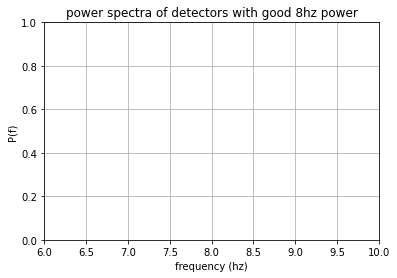

using power threshold of 10:


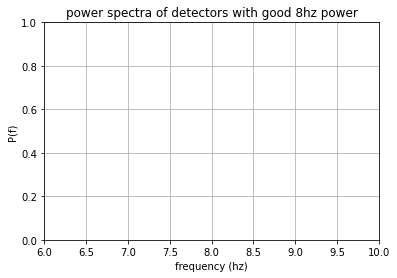

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


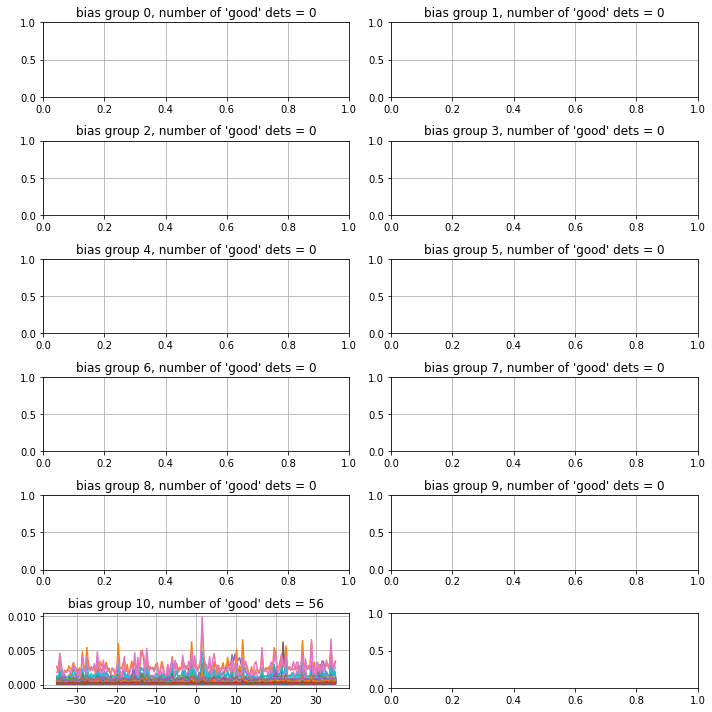

data saved to location FTS_data_integrated_bg10/run_14_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 15:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


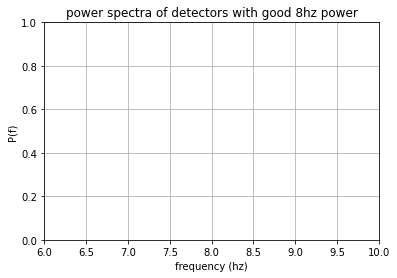

using power threshold of 10:


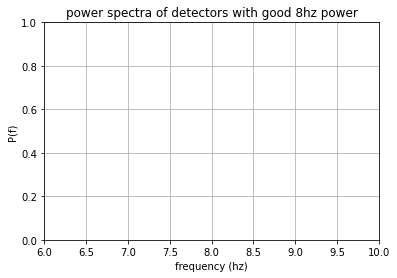

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


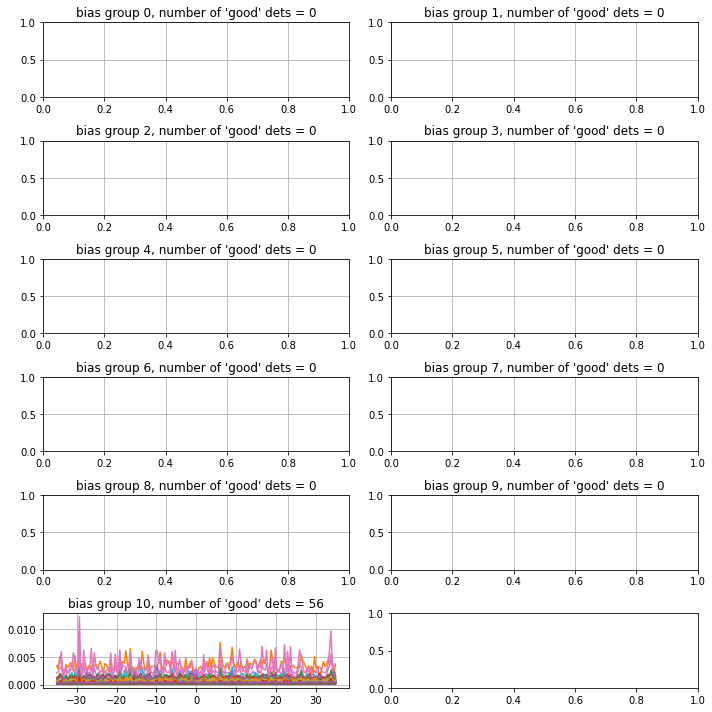

data saved to location FTS_data_integrated_bg10/run_15_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 16:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


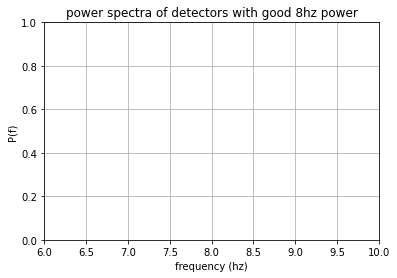

using power threshold of 10:


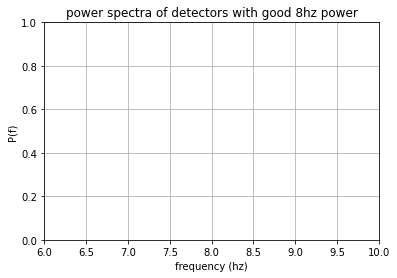

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


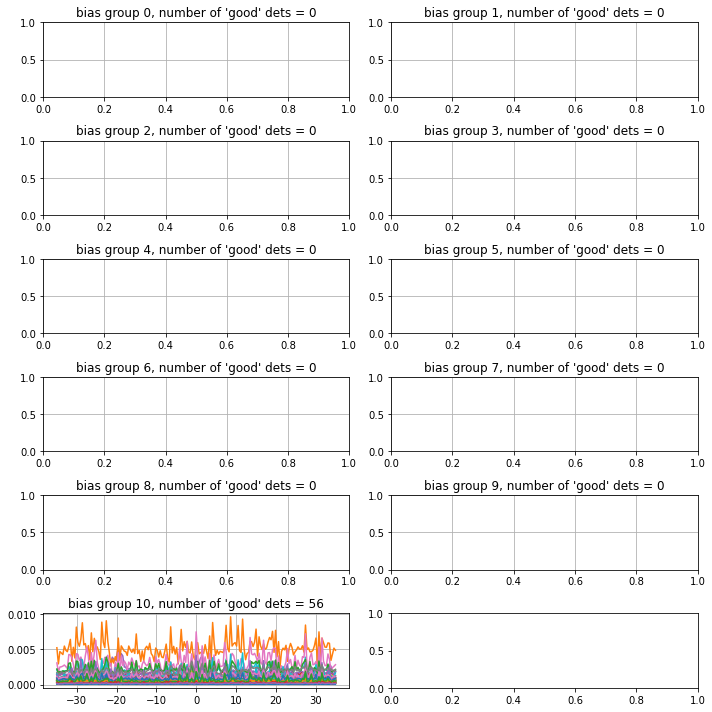

data saved to location FTS_data_integrated_bg10/run_16_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 17:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.17s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


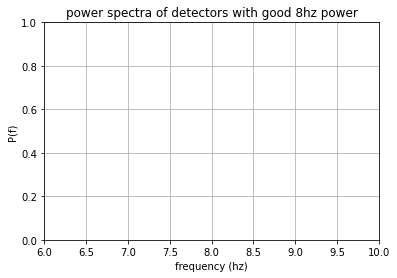

using power threshold of 10:


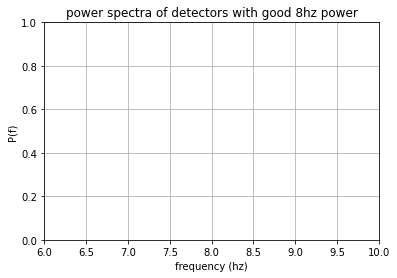

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


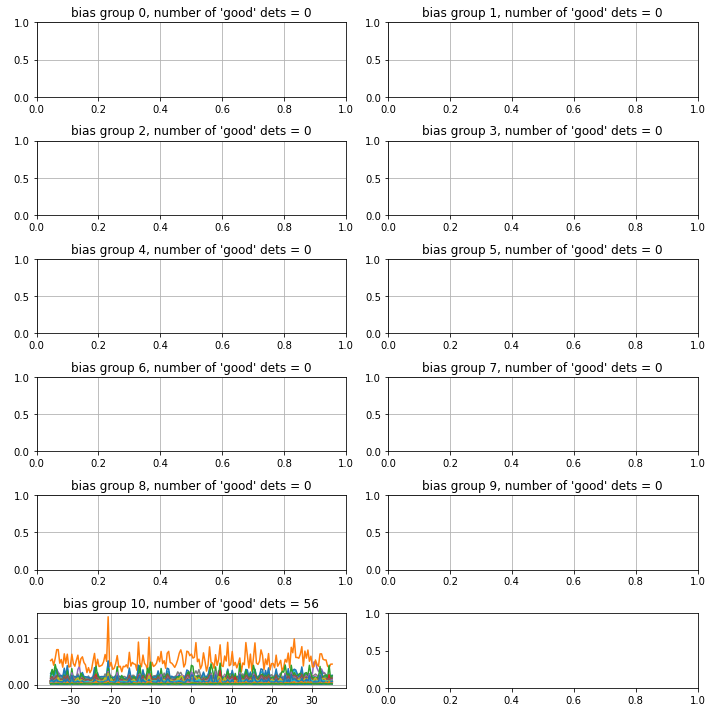

data saved to location FTS_data_integrated_bg10/run_17_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 18:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


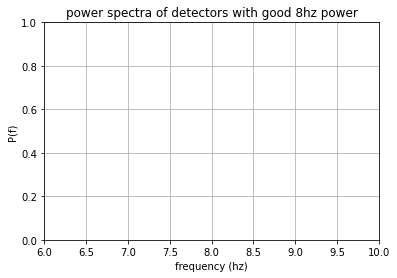

using power threshold of 10:


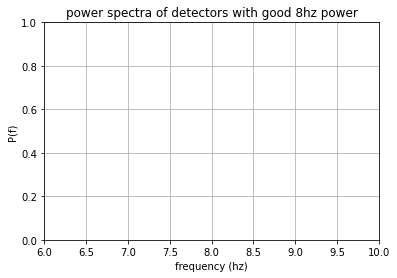

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine


/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


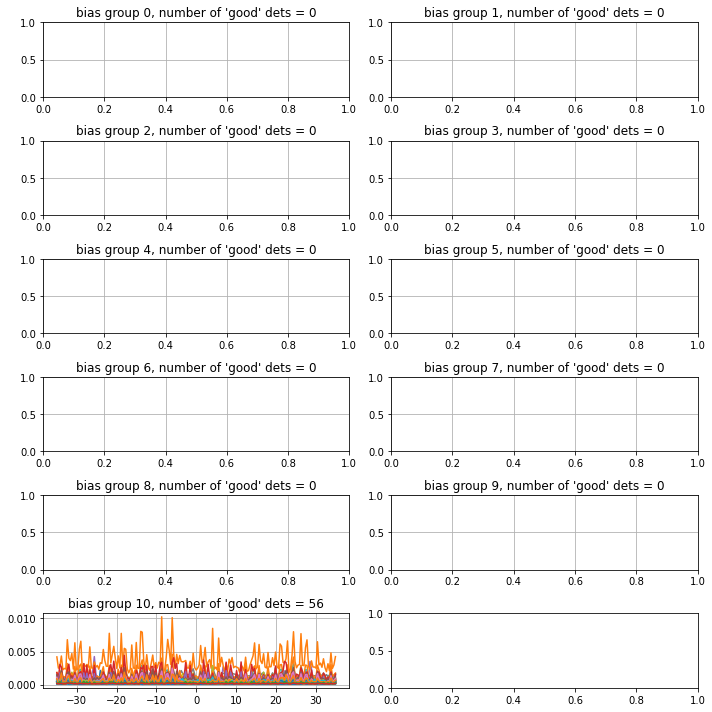

data saved to location FTS_data_integrated_bg10/run_18_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 19:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


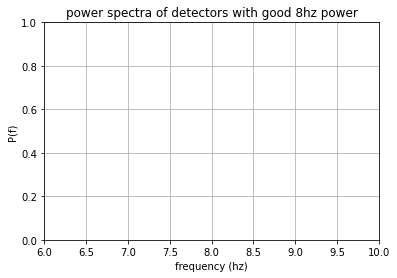

using power threshold of 10:


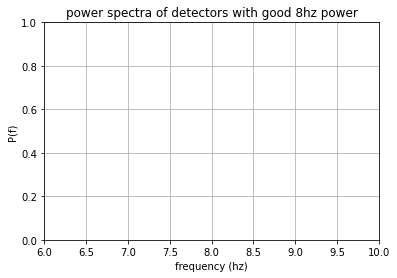

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


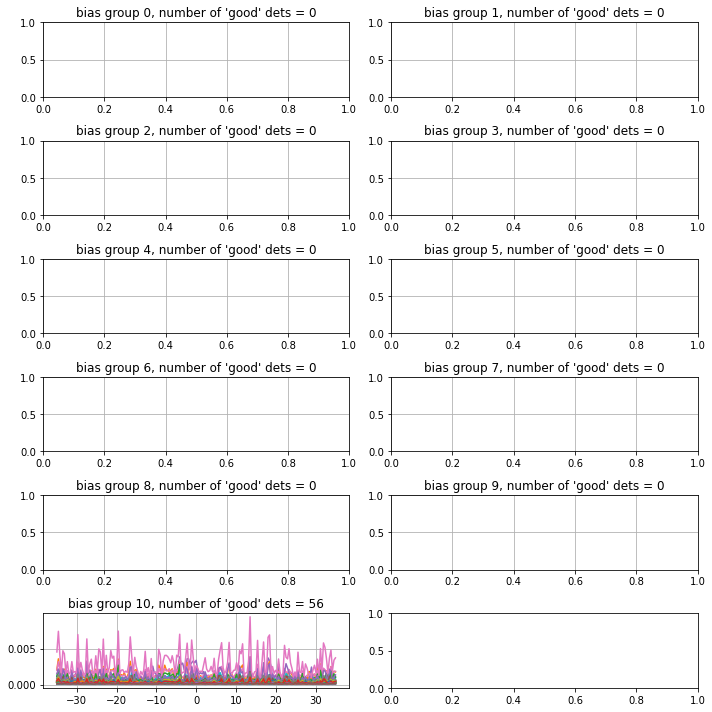

data saved to location FTS_data_integrated_bg10/run_19_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 20:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17224/ufm_lf_ln1_lp5_lp6/1722409235_000.g3
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


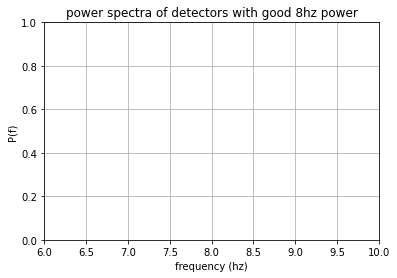

using power threshold of 10:


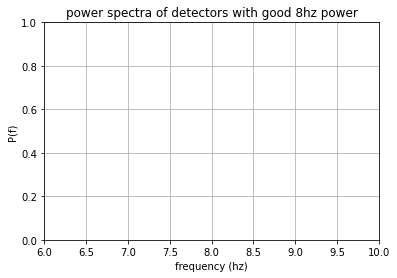

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


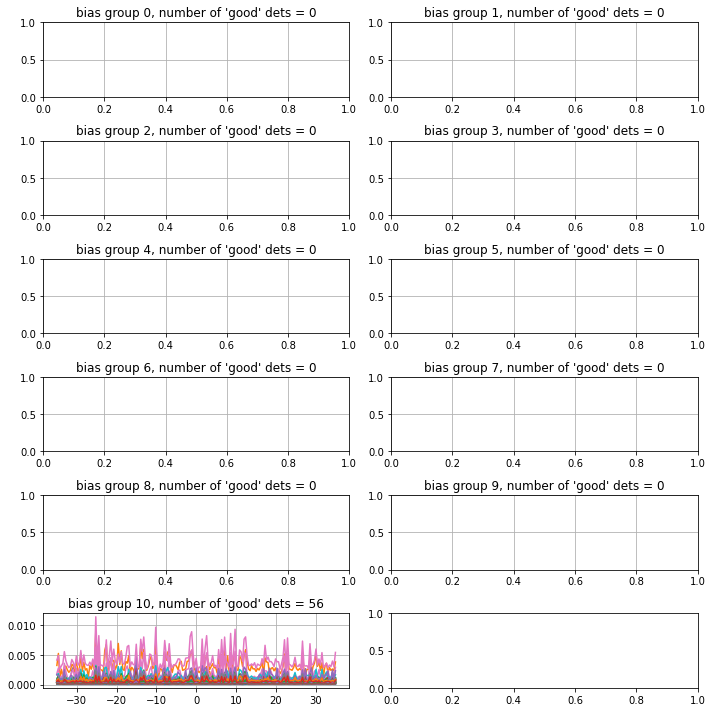

data saved to location FTS_data_integrated_bg10/run_20_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 21:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


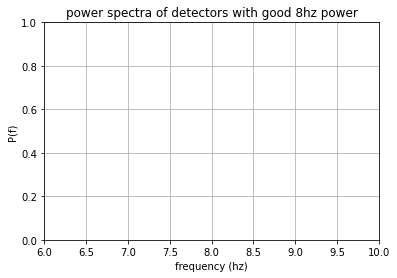

using power threshold of 10:


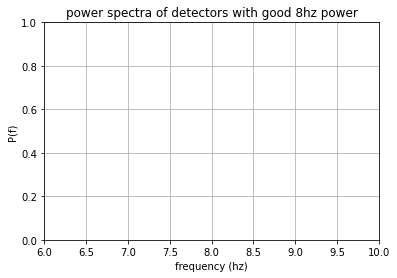

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


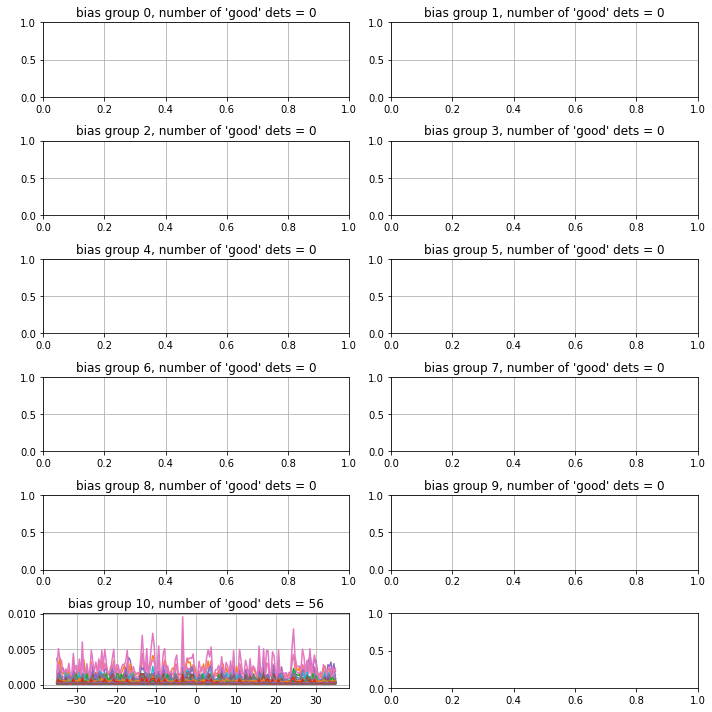

data saved to location FTS_data_integrated_bg10/run_21_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 22:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.03s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


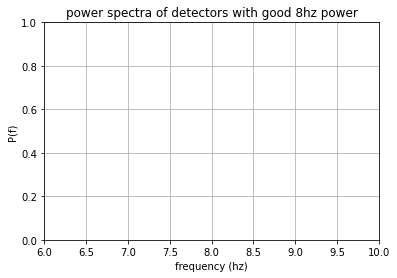

using power threshold of 10:


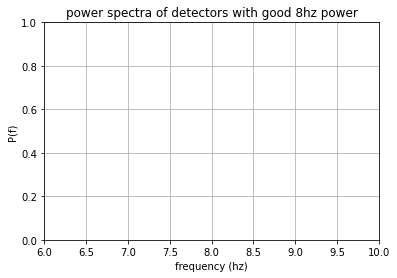

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


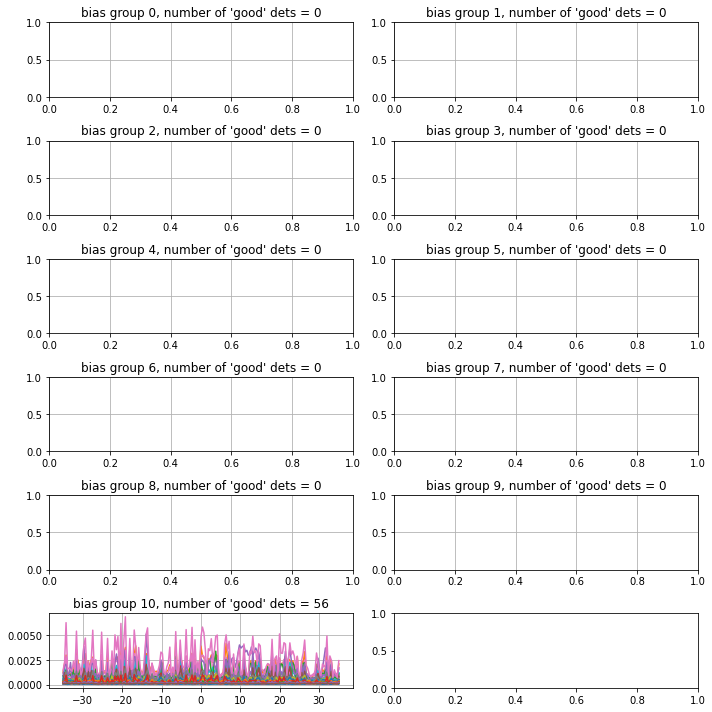

data saved to location FTS_data_integrated_bg10/run_22_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 23:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


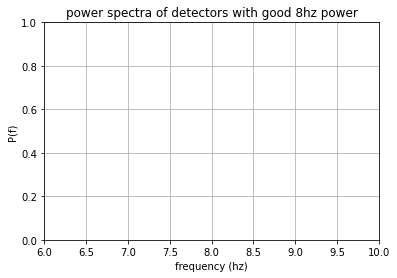

using power threshold of 10:


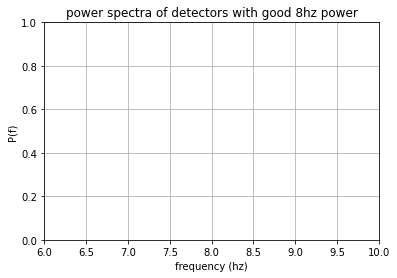

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


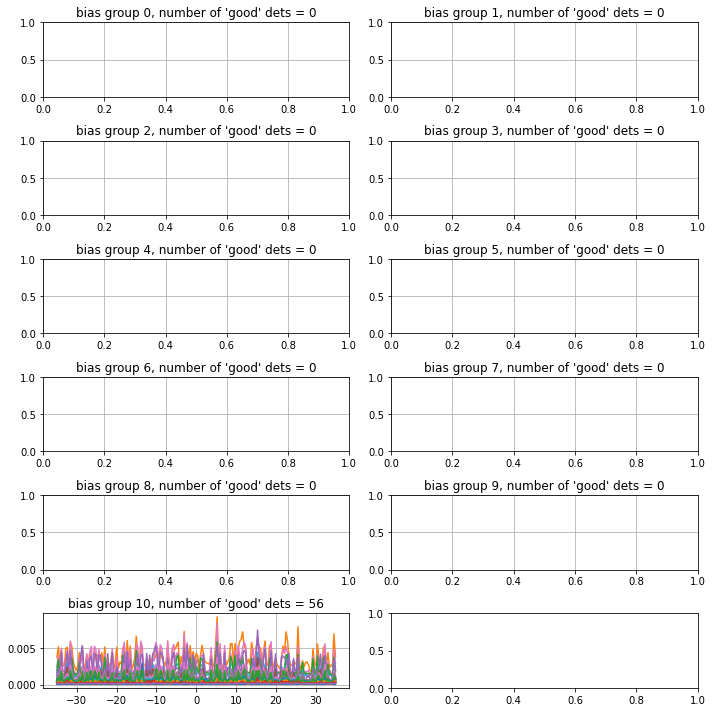

data saved to location FTS_data_integrated_bg10/run_23_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 24:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.01s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


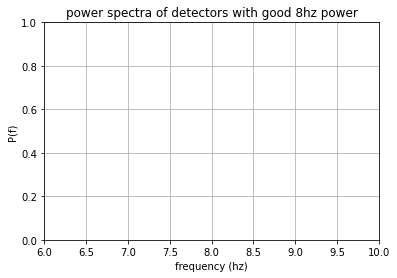

using power threshold of 10:


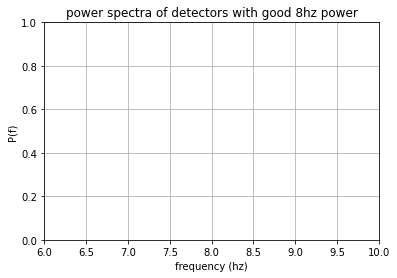

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine


/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


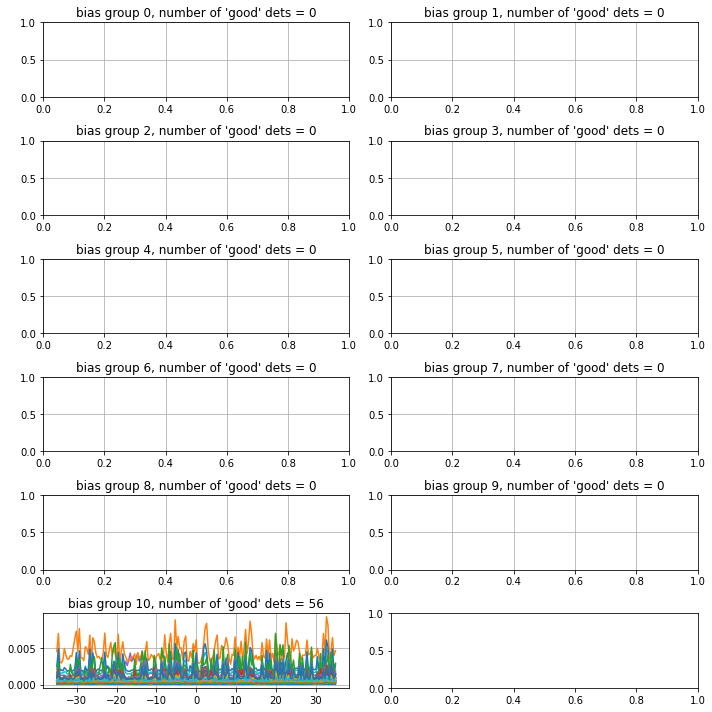

data saved to location FTS_data_integrated_bg10/run_24_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 25:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.02it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


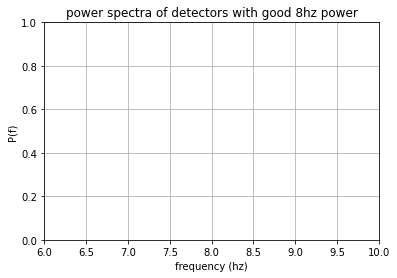

using power threshold of 10:


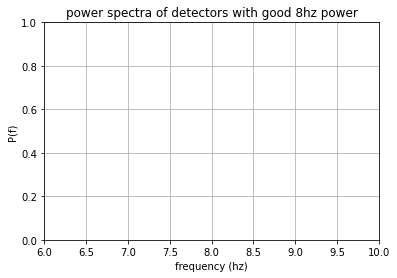

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


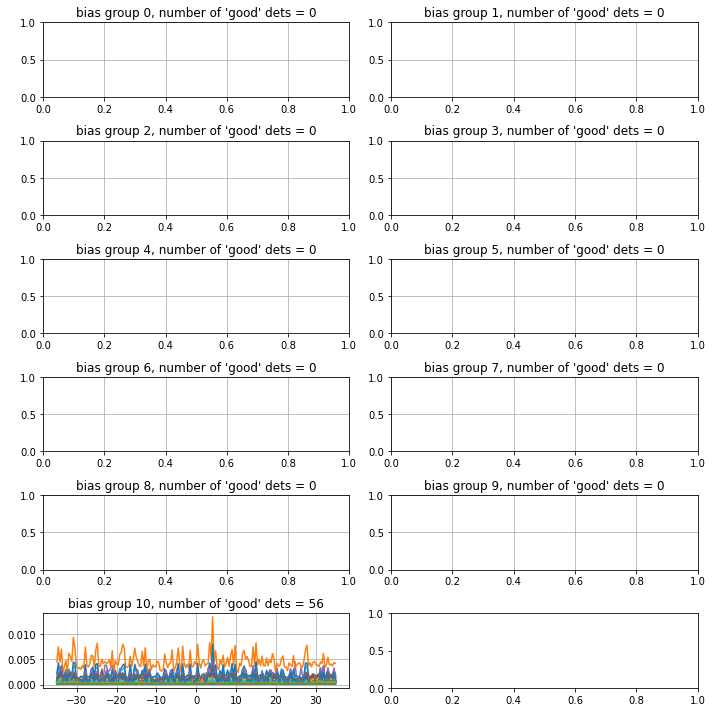

data saved to location FTS_data_integrated_bg10/run_25_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 26:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


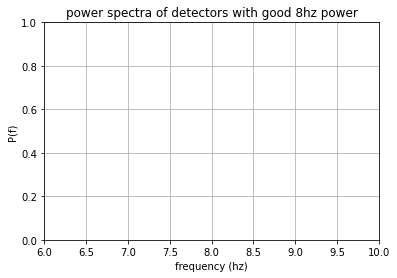

using power threshold of 10:


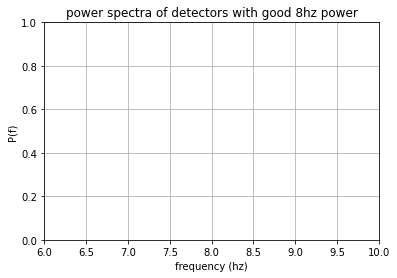

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


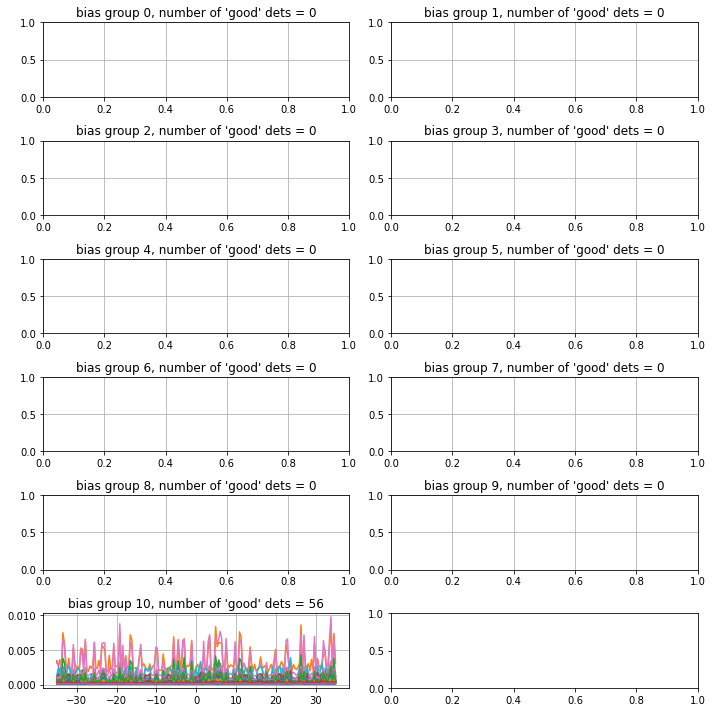

data saved to location FTS_data_integrated_bg10/run_26_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 27:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.08it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


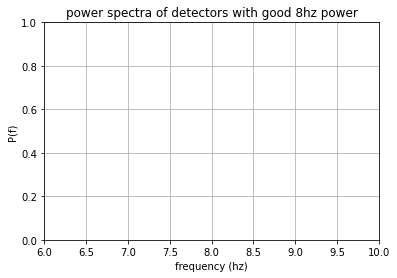

using power threshold of 10:


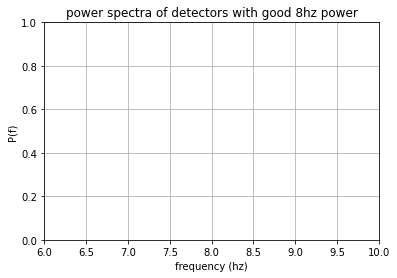

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


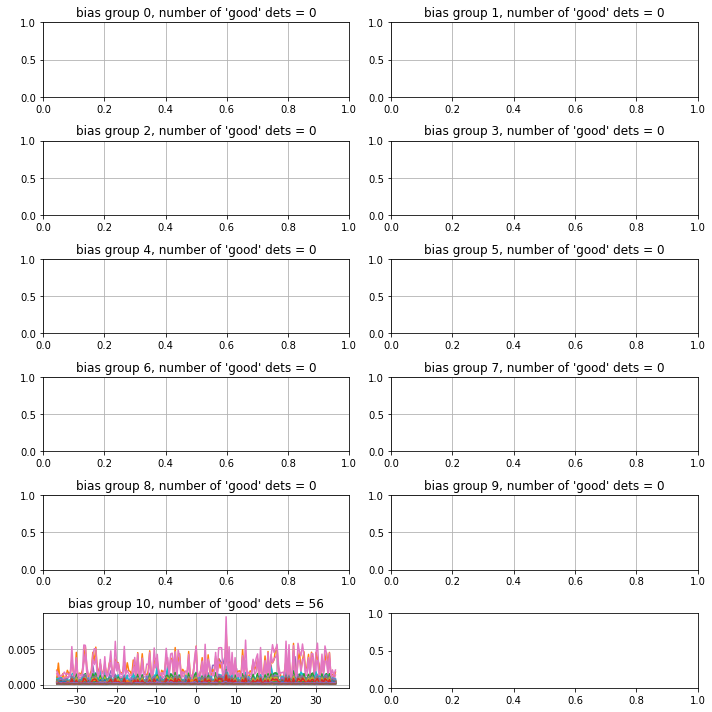

data saved to location FTS_data_integrated_bg10/run_27_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 28:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.00it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


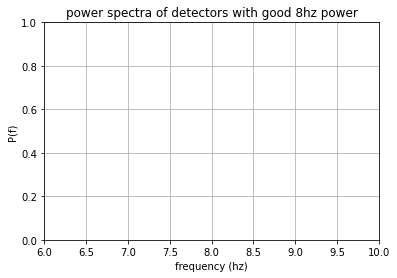

using power threshold of 10:


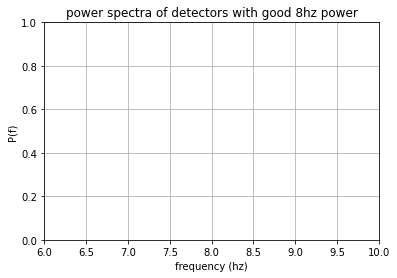

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


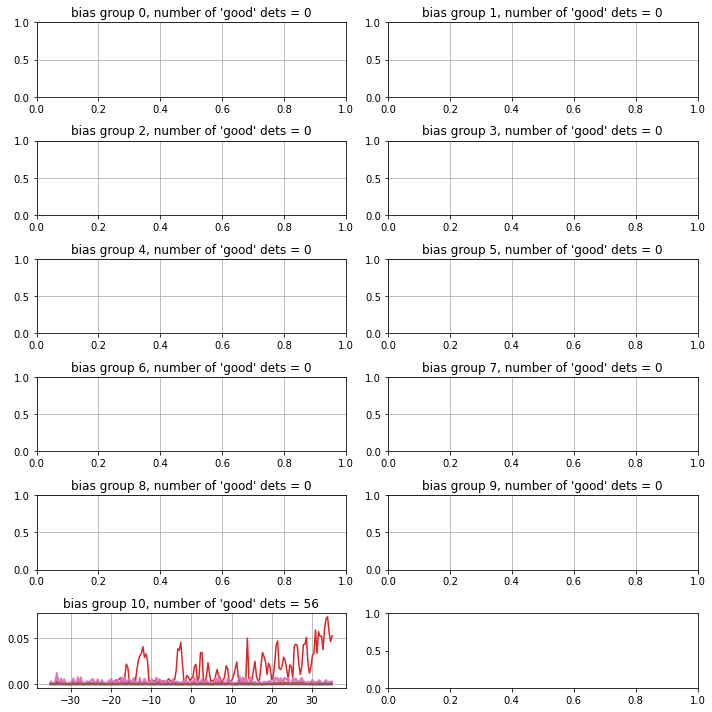

data saved to location FTS_data_integrated_bg10/run_28_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 29:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


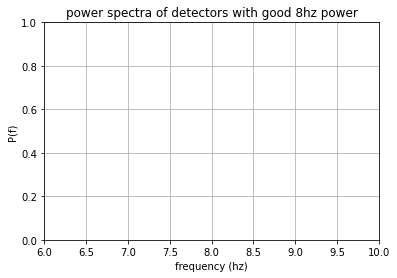

using power threshold of 10:


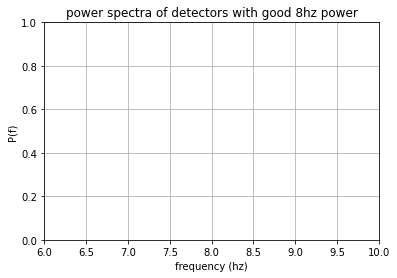

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine


/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


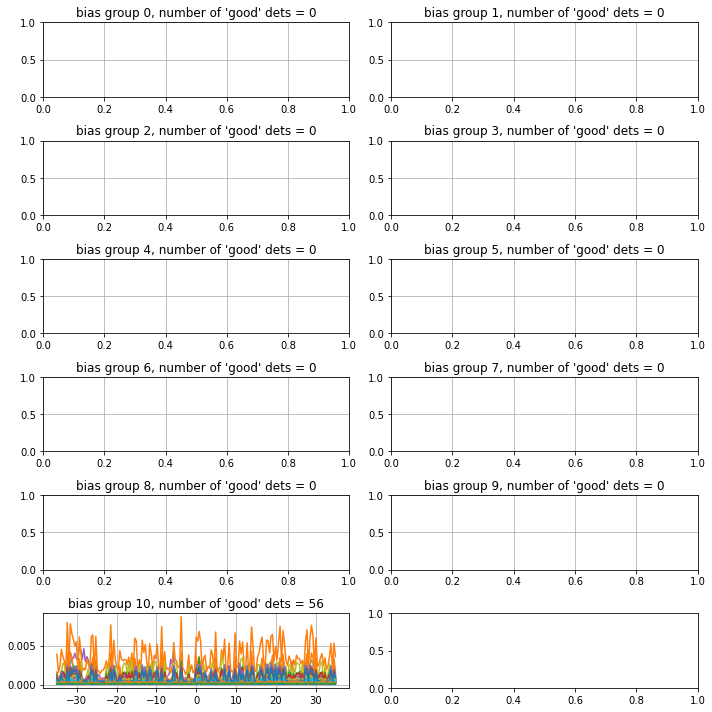

data saved to location FTS_data_integrated_bg10/run_29_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 30:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.12it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


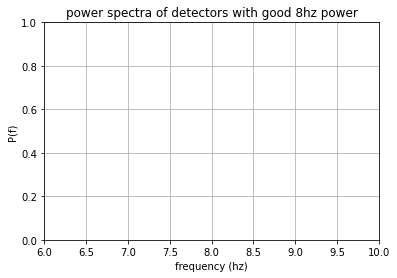

using power threshold of 10:


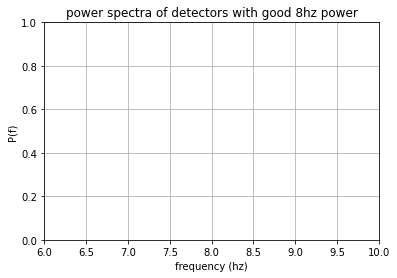

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine


/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


number of interferograms in bias group -1: 0


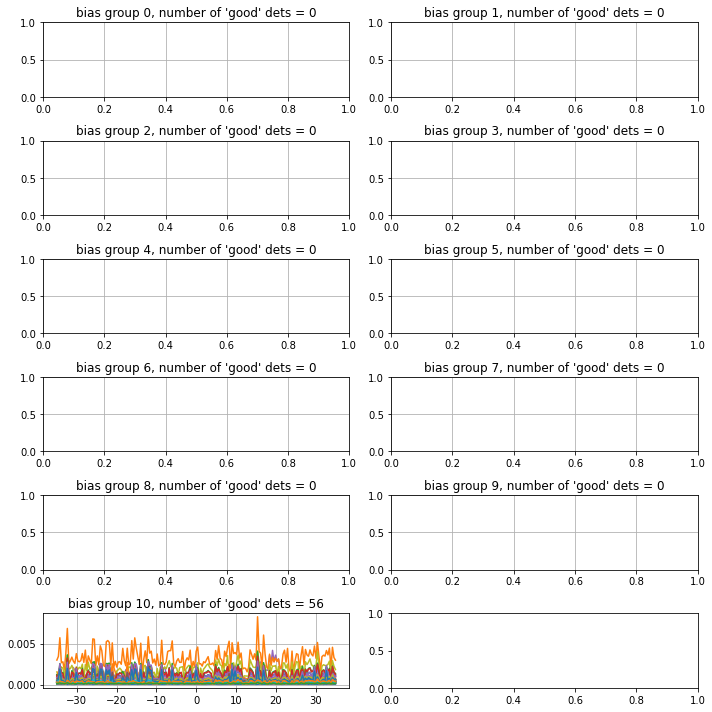

data saved to location FTS_data_integrated_bg10/run_30_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 31:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


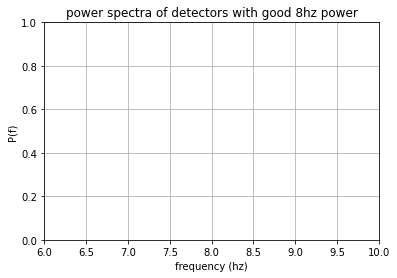

using power threshold of 10:


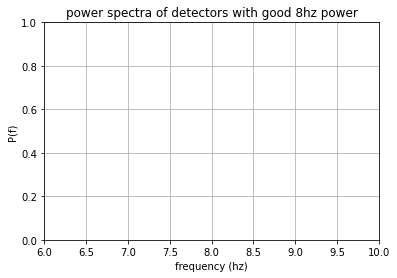

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


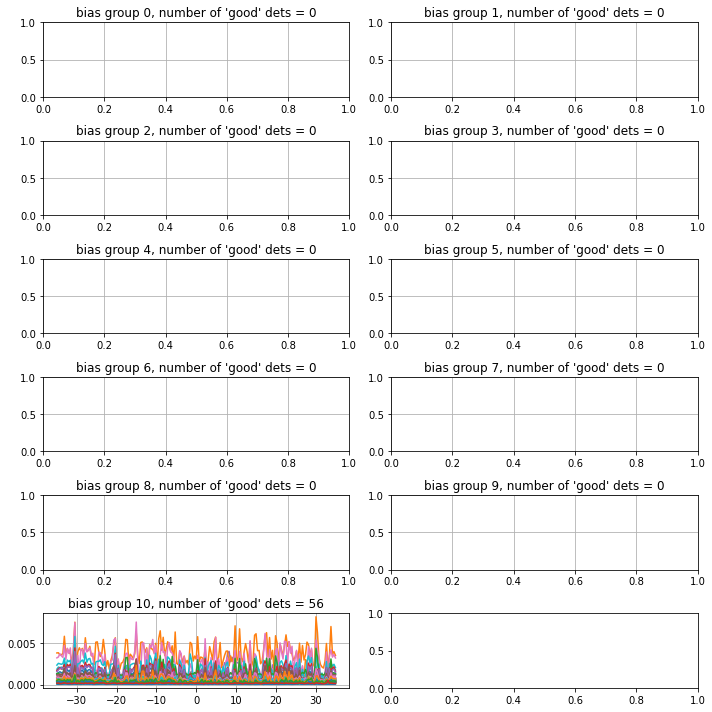

data saved to location FTS_data_integrated_bg10/run_31_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 32:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.11it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


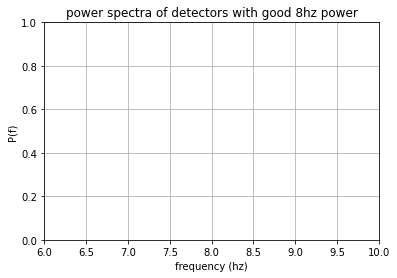

using power threshold of 10:


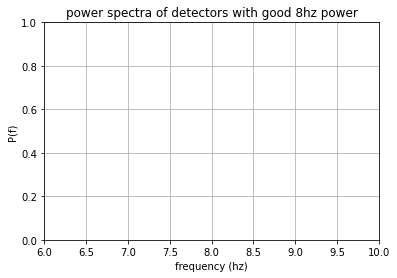

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


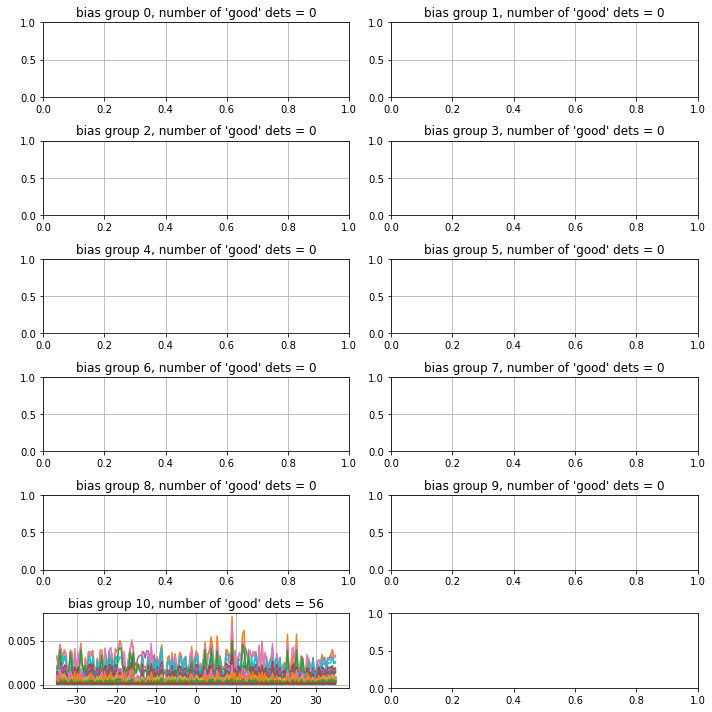

data saved to location FTS_data_integrated_bg10/run_32_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 33:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.01it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


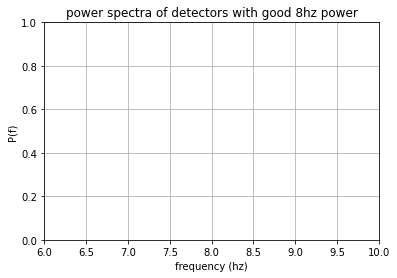

using power threshold of 10:


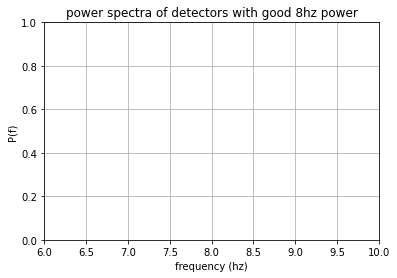

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


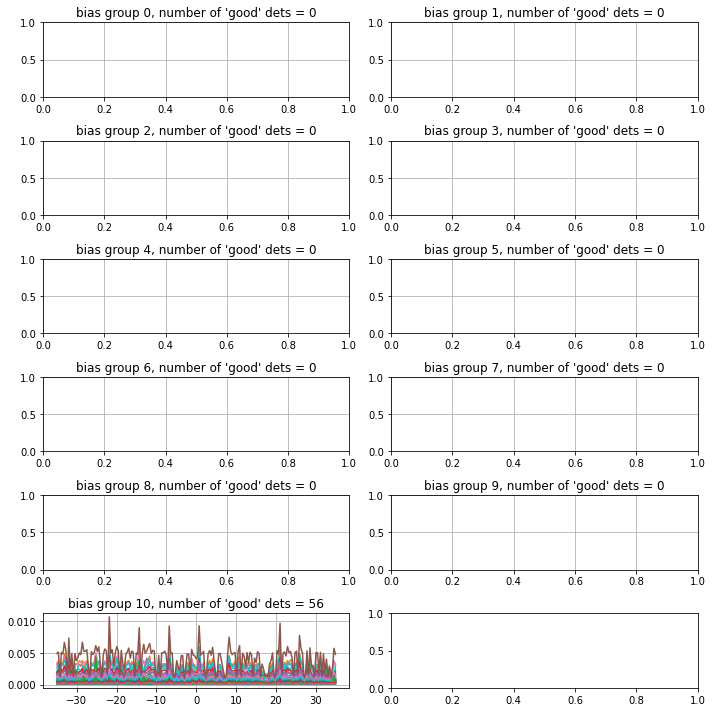

data saved to location FTS_data_integrated_bg10/run_33_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 34:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.13it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


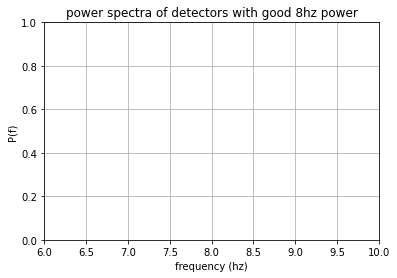

using power threshold of 10:


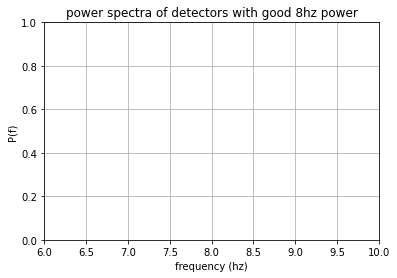

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


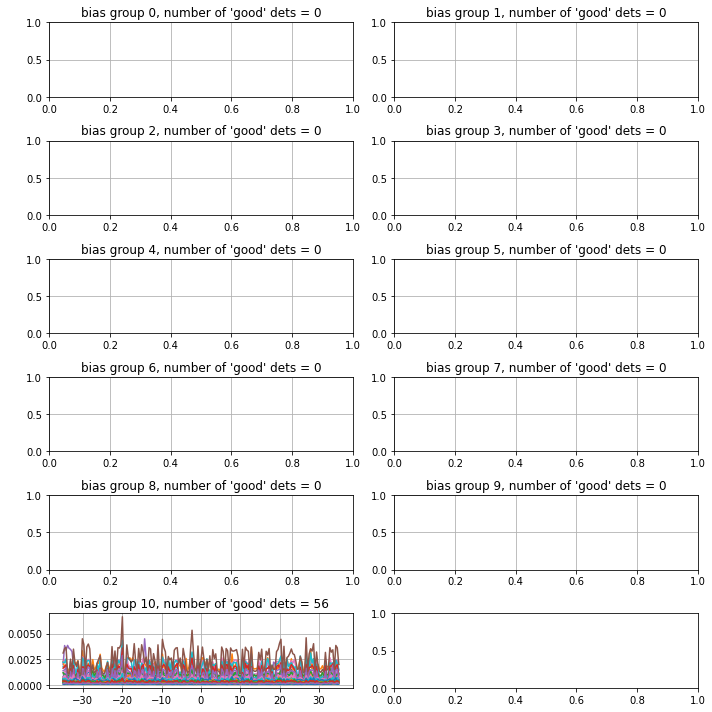

data saved to location FTS_data_integrated_bg10/run_34_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 1:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


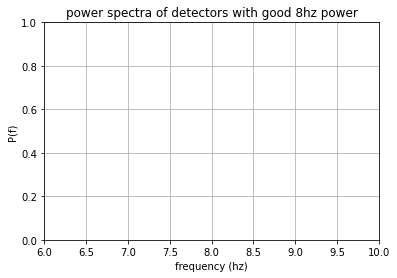

using power threshold of 10:


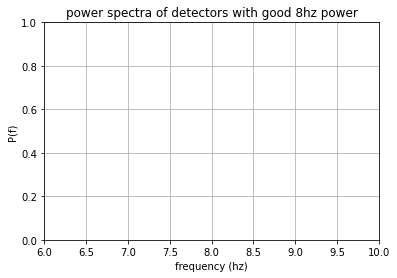

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


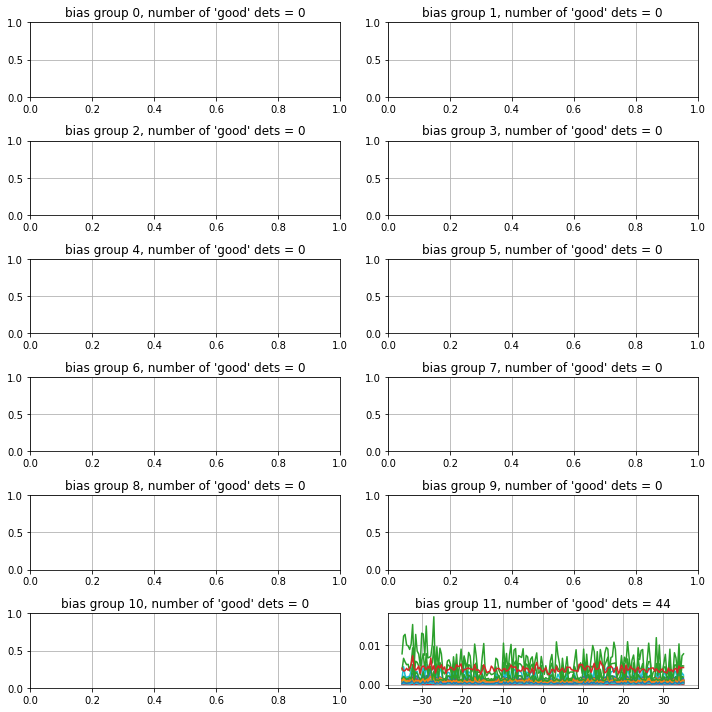

data saved to location FTS_data_integrated_bg11/run_1_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 2:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


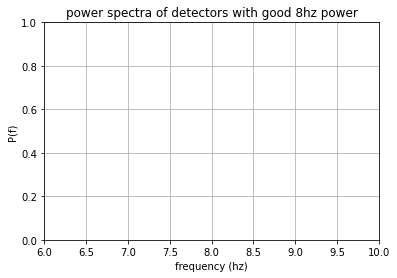

using power threshold of 10:


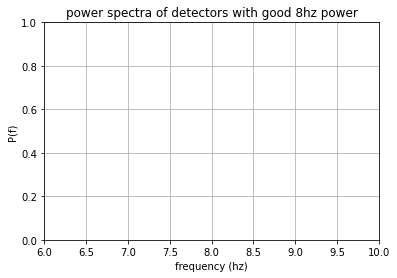

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


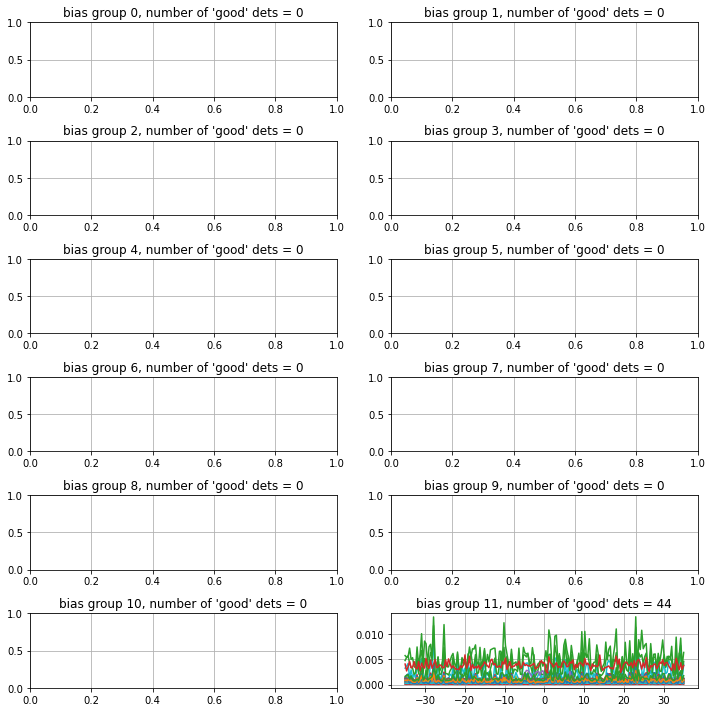

data saved to location FTS_data_integrated_bg11/run_2_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 3:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


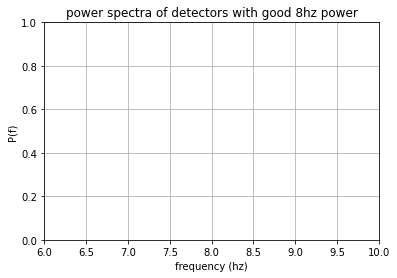

using power threshold of 10:


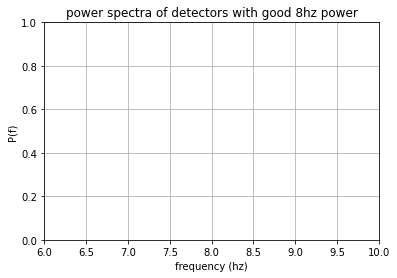

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


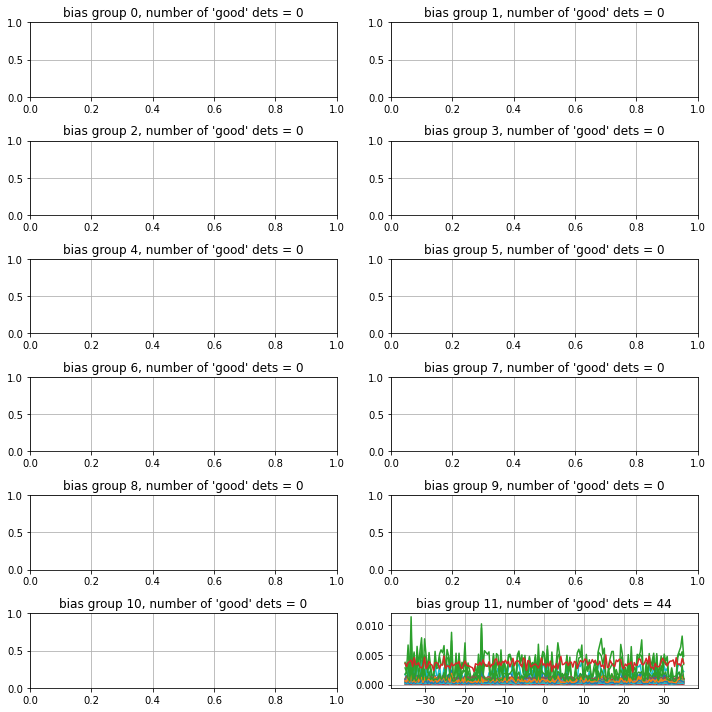

data saved to location FTS_data_integrated_bg11/run_3_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 4:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


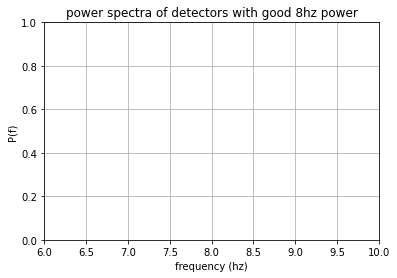

using power threshold of 10:


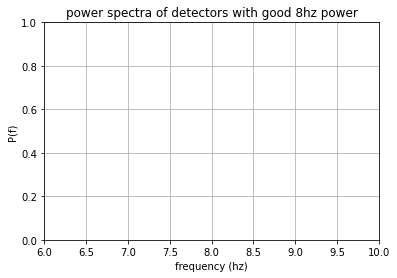

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


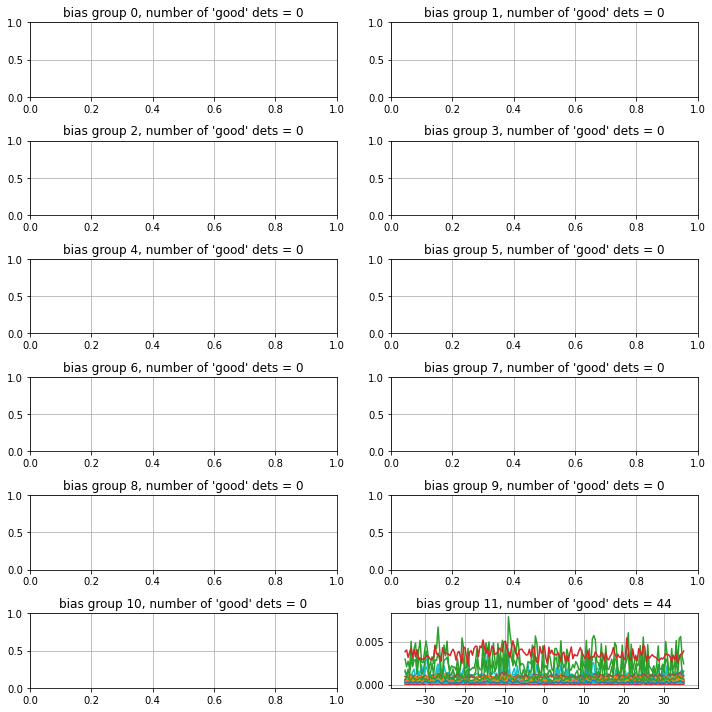

data saved to location FTS_data_integrated_bg11/run_4_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 5:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


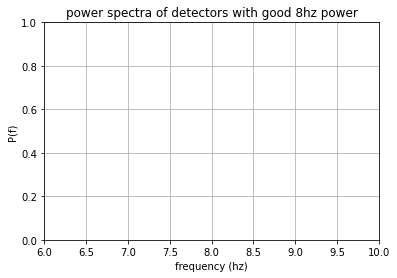

using power threshold of 10:


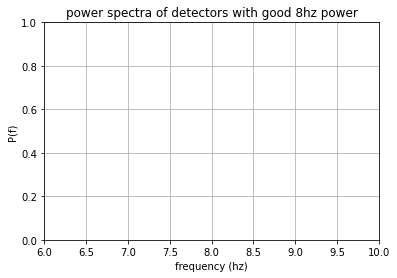

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


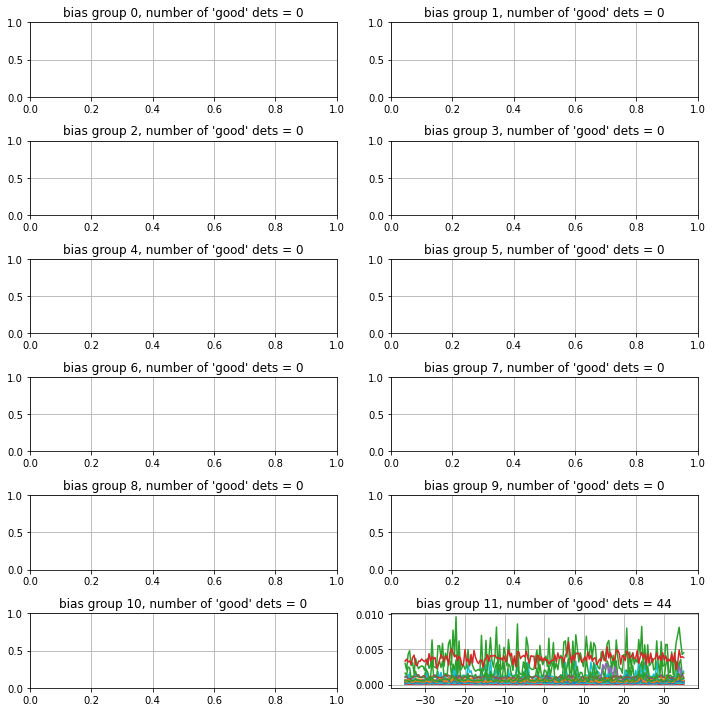

data saved to location FTS_data_integrated_bg11/run_5_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 6:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-8.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


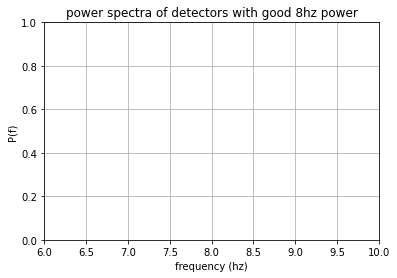

using power threshold of 10:


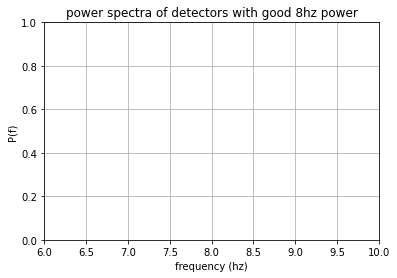

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


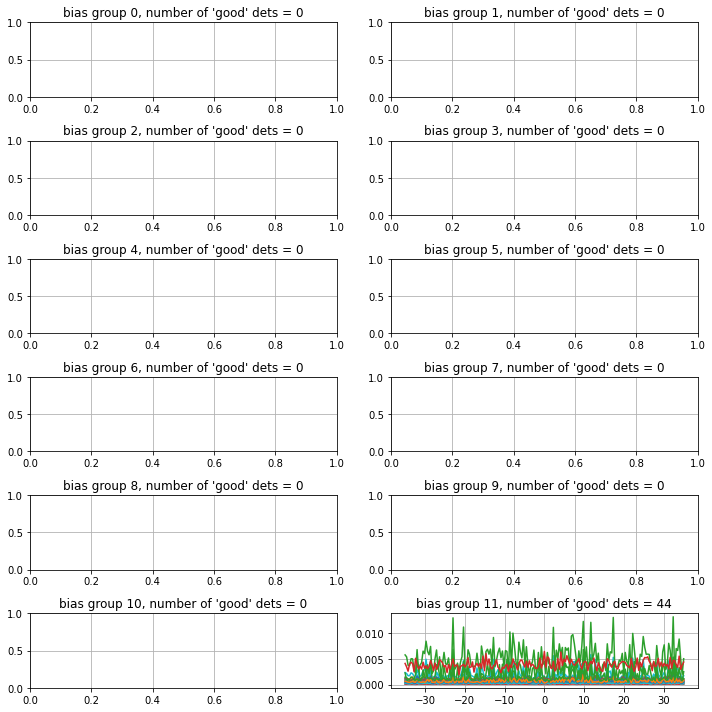

data saved to location FTS_data_integrated_bg11/run_6_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 7:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.12it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


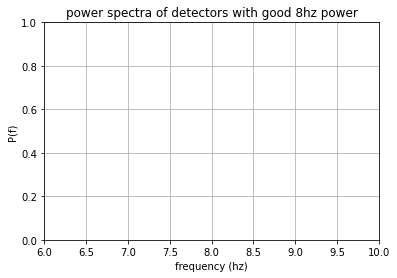

using power threshold of 10:


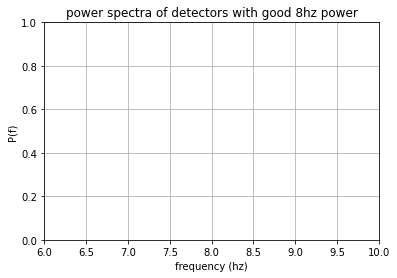

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


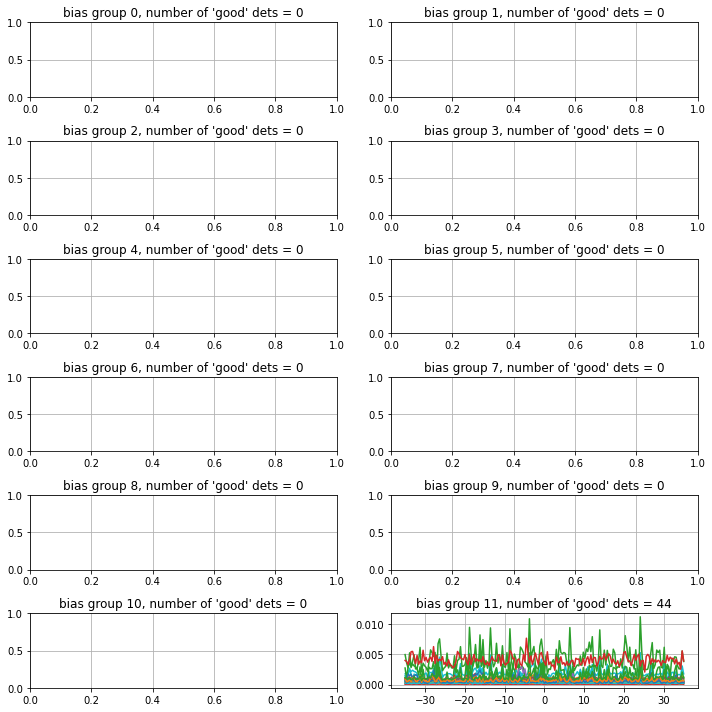

data saved to location FTS_data_integrated_bg11/run_7_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 8:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


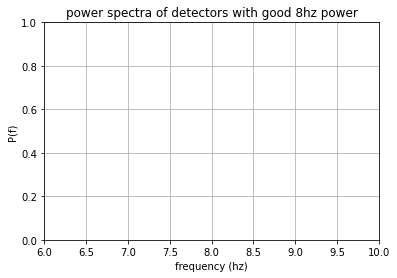

using power threshold of 10:


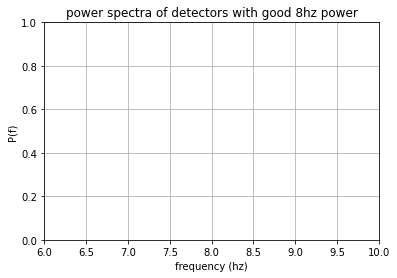

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


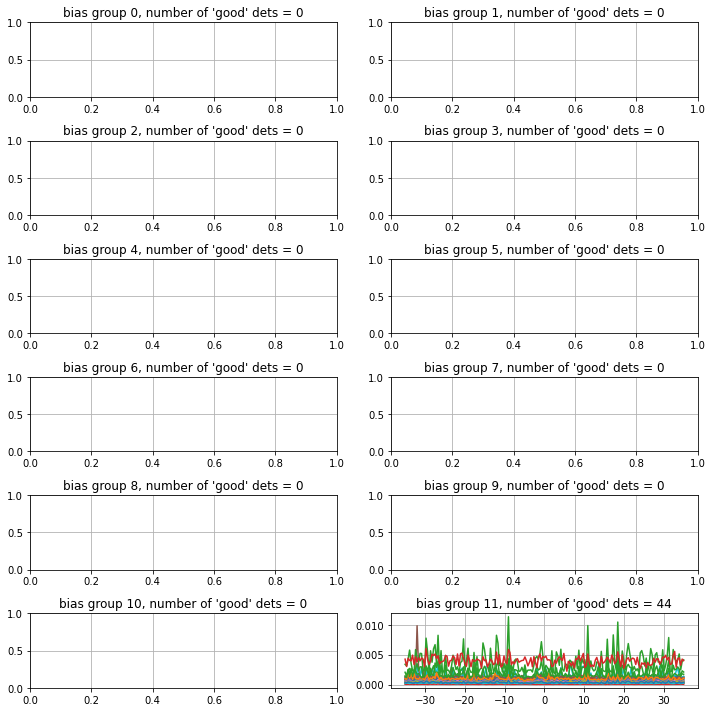

data saved to location FTS_data_integrated_bg11/run_8_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 9:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.16it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


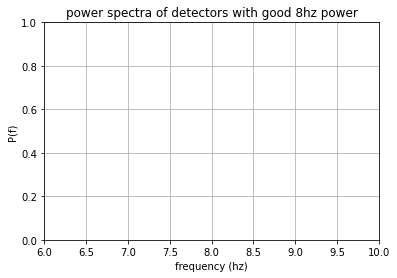

using power threshold of 10:


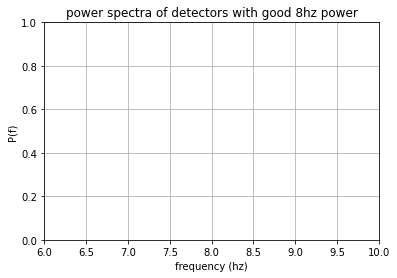

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


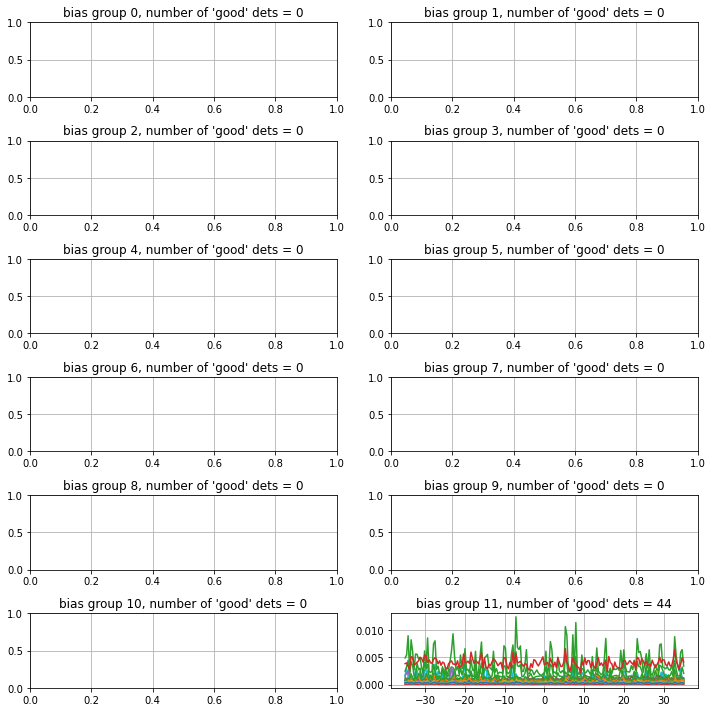

data saved to location FTS_data_integrated_bg11/run_9_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 10:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.11it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


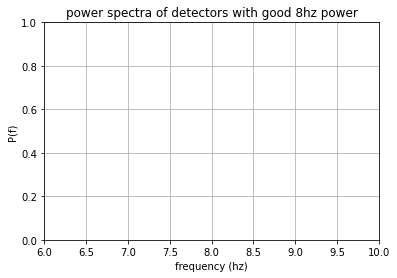

using power threshold of 10:


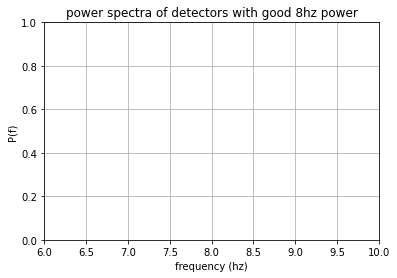

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


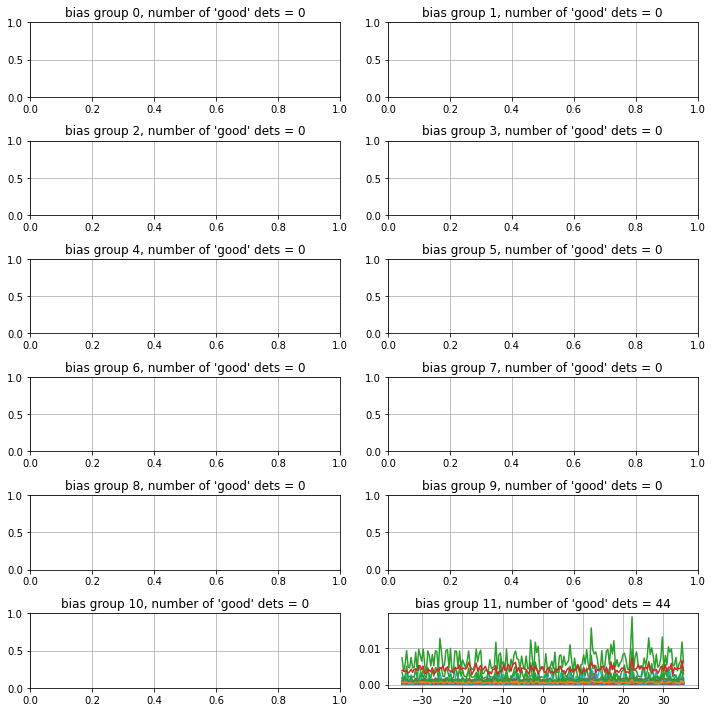

data saved to location FTS_data_integrated_bg11/run_10_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 11:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


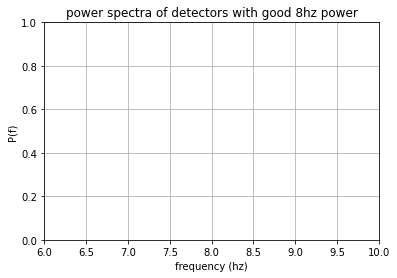

using power threshold of 10:


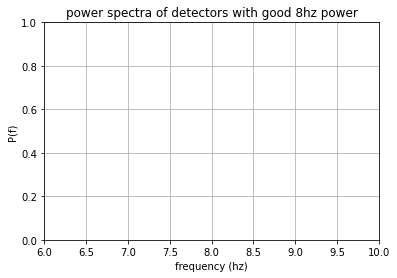

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


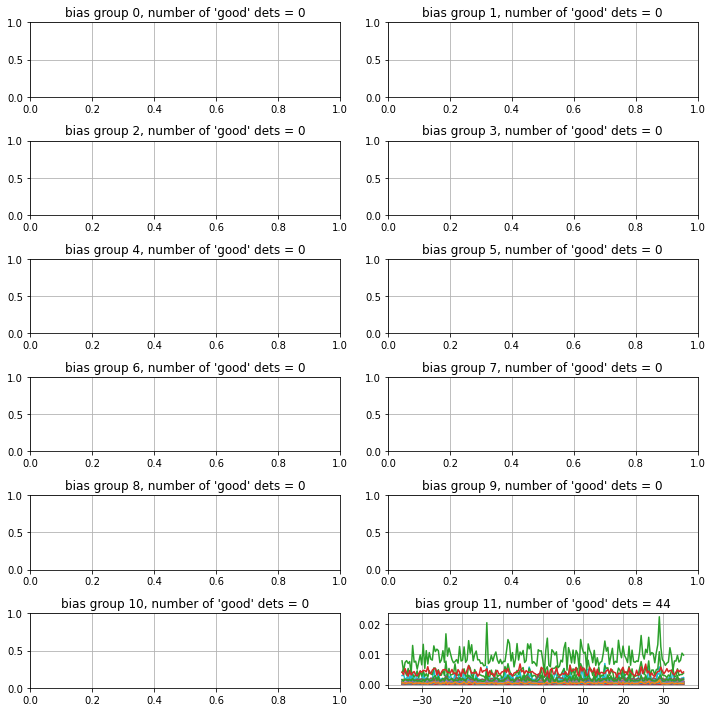

data saved to location FTS_data_integrated_bg11/run_11_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 12:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.08it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


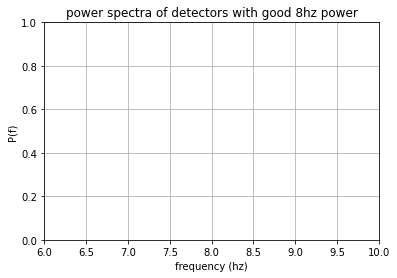

using power threshold of 10:


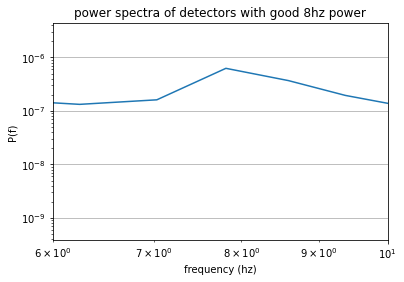

number of detectors with higher power in 8hz = 1
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


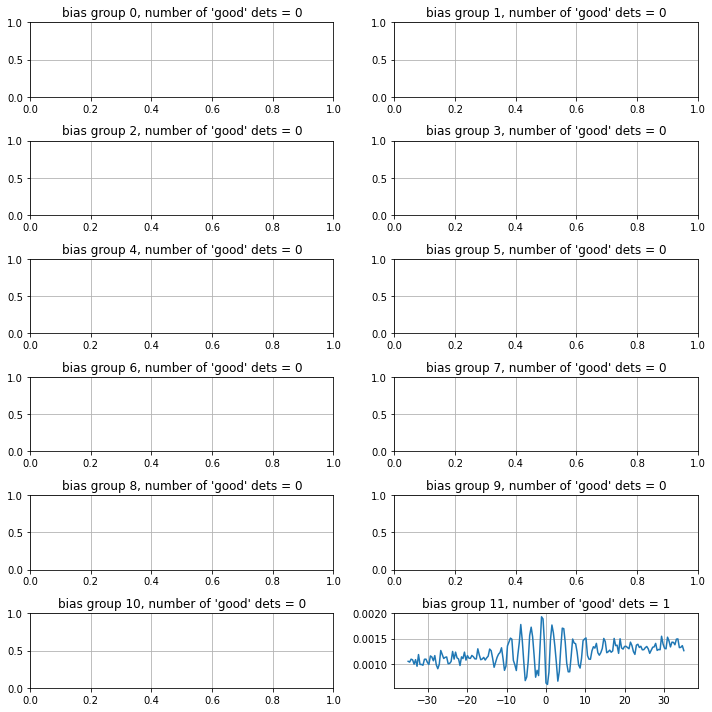

data saved to location FTS_data_integrated_bg11/run_12_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 13:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.16it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-5.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


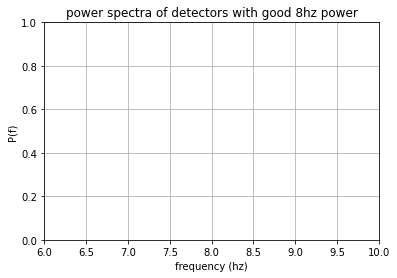

using power threshold of 10:


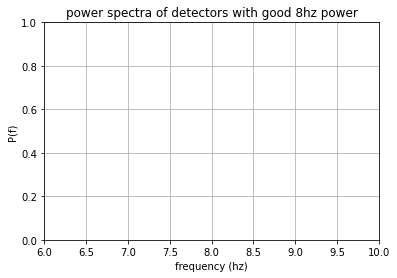

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


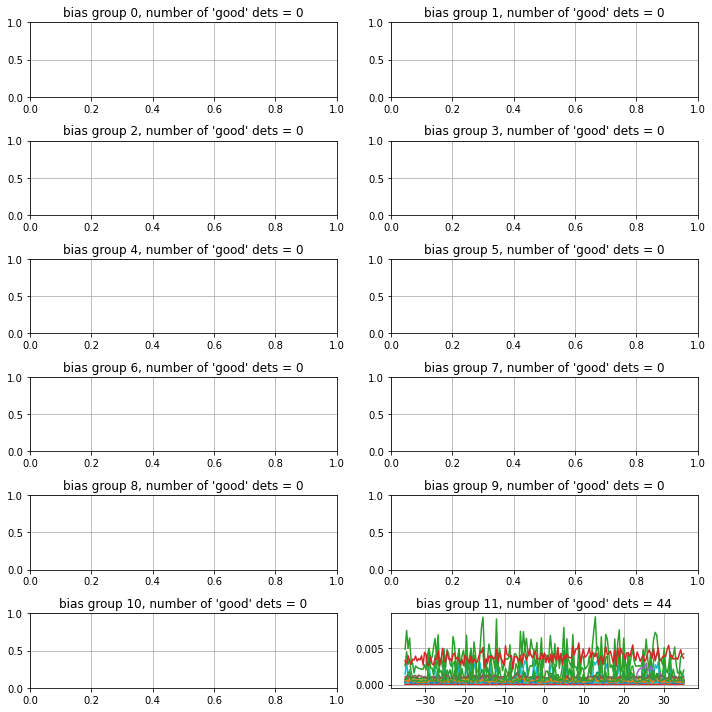

data saved to location FTS_data_integrated_bg11/run_13_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 14:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17223/ufm_lf_ln1_lp5_lp6/1722397615_000.g3
100%|██████████| 4/4 [00:03<00:00,  1.14it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -14.7)
This function has now been added to sotodlib
using power threshold of 100:


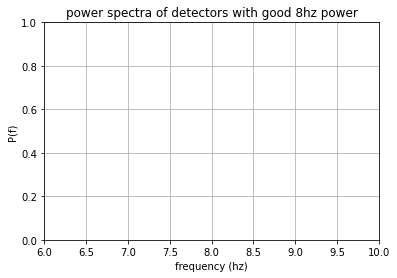

using power threshold of 10:


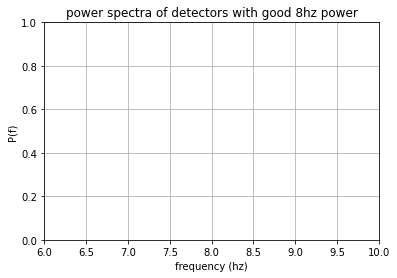

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


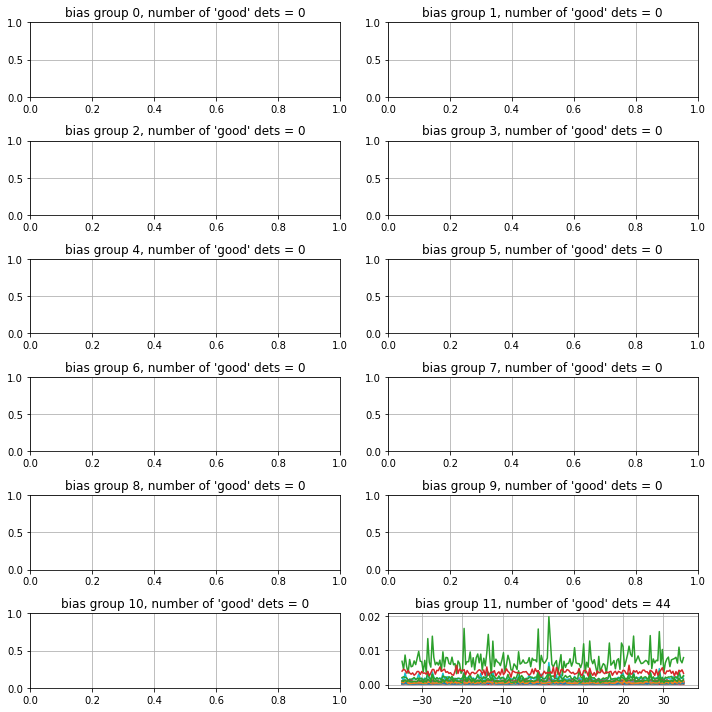

data saved to location FTS_data_integrated_bg11/run_14_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 15:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


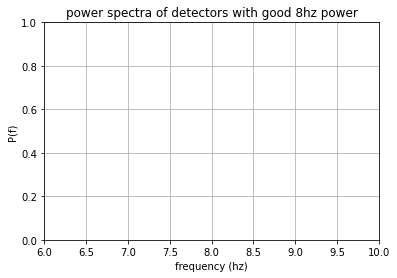

using power threshold of 10:


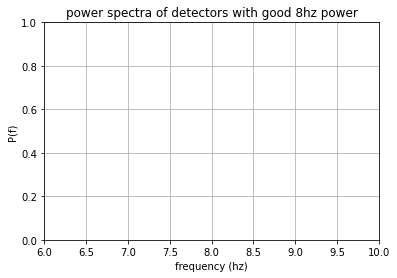

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


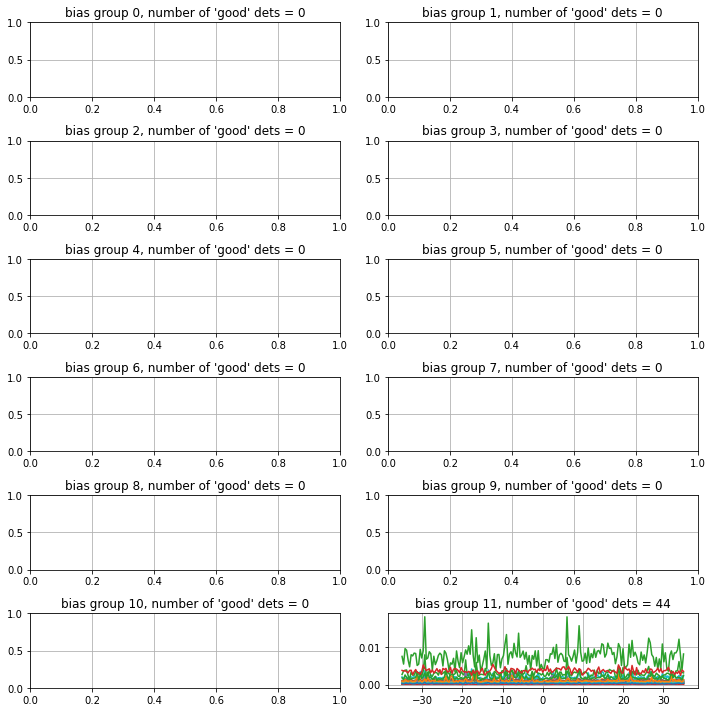

data saved to location FTS_data_integrated_bg11/run_15_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 16:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.00it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -10.4)
This function has now been added to sotodlib
using power threshold of 100:


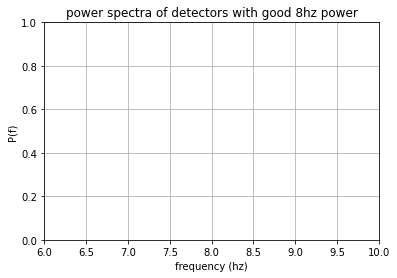

using power threshold of 10:


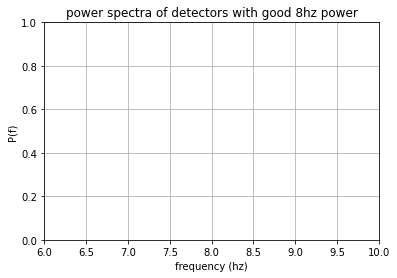

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


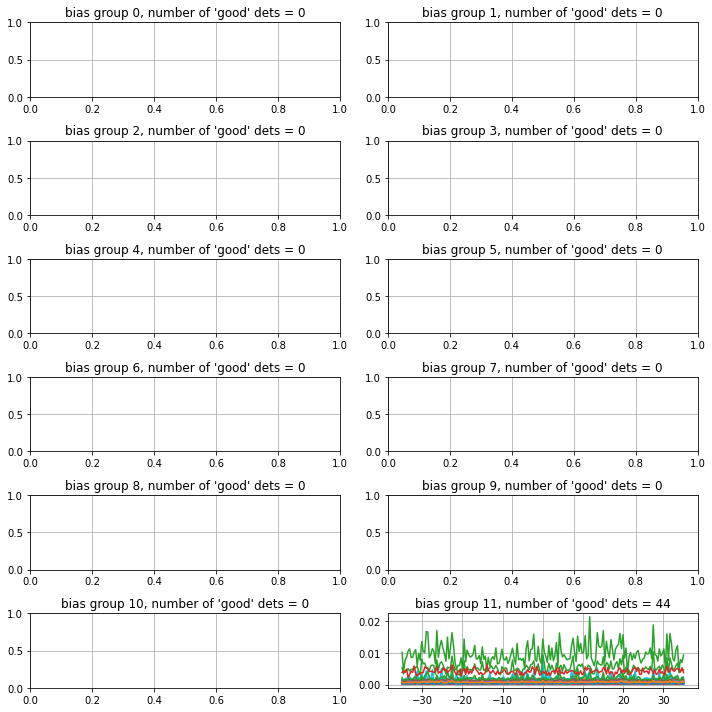

data saved to location FTS_data_integrated_bg11/run_16_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 17:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.03it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


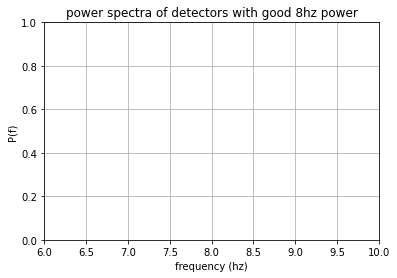

using power threshold of 10:


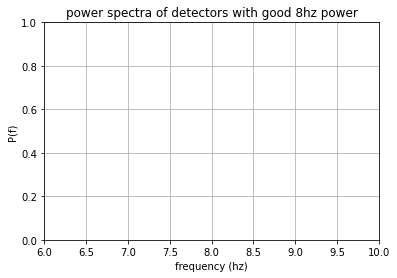

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


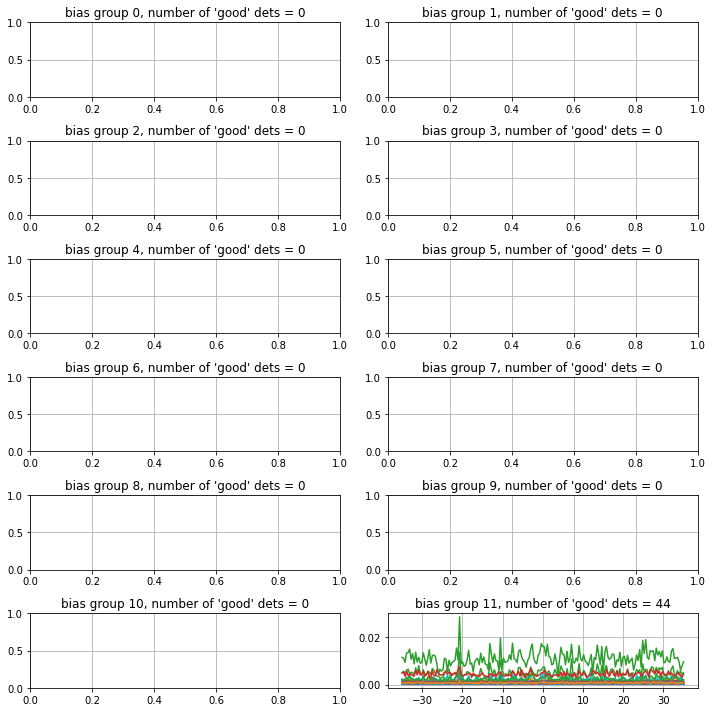

data saved to location FTS_data_integrated_bg11/run_17_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 18:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


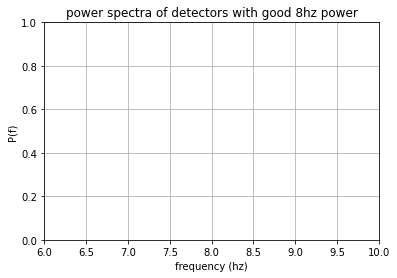

using power threshold of 10:


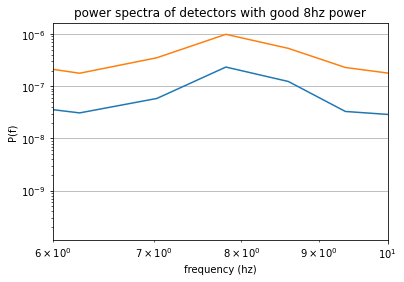

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


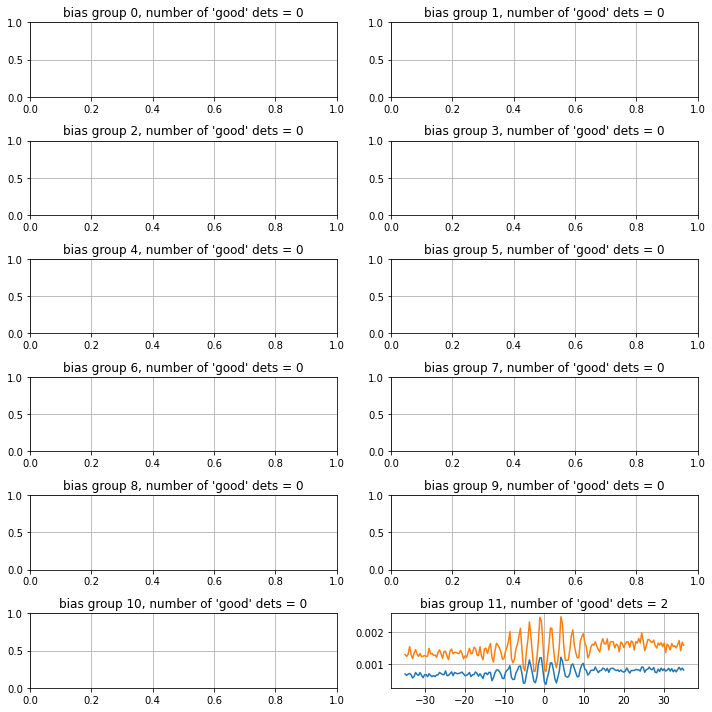

data saved to location FTS_data_integrated_bg11/run_18_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 19:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.06it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


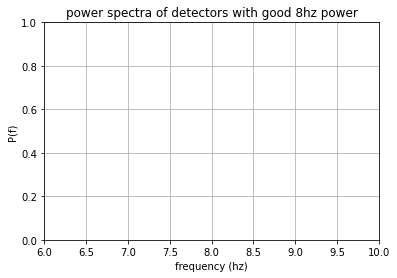

using power threshold of 10:


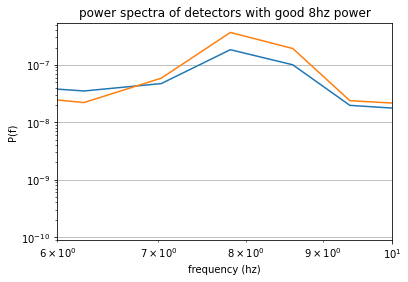

number of detectors with higher power in 8hz = 2
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


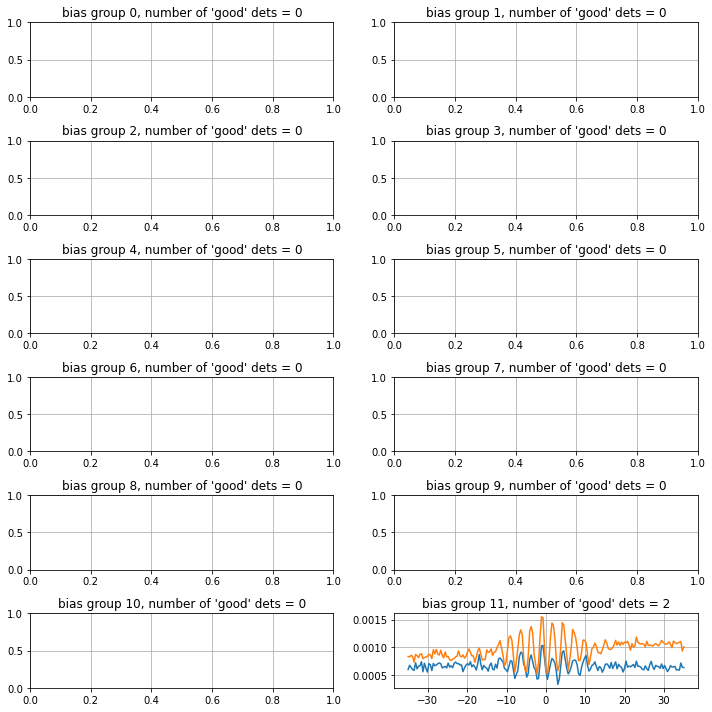

data saved to location FTS_data_integrated_bg11/run_19_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 20:


INFO: sotodlib.io.load_smurf: Status dump frame not found, reading all status frames
INFO: sotodlib.io.load_smurf: Status load from database failed, using file load
DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
DEBUG: sotodlib.io.load_smurf: Loading status from /data/timestreams/17224/ufm_lf_ln1_lp5_lp6/1722409235_000.g3
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (-2.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


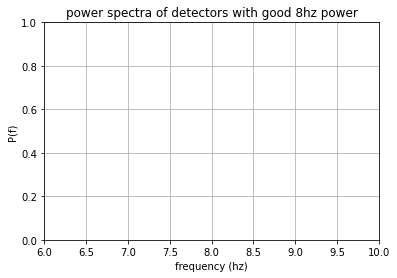

using power threshold of 10:


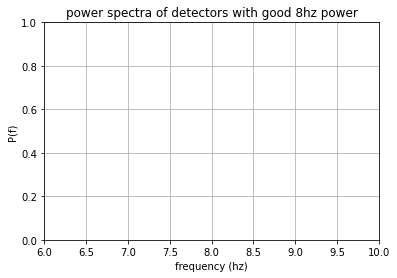

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


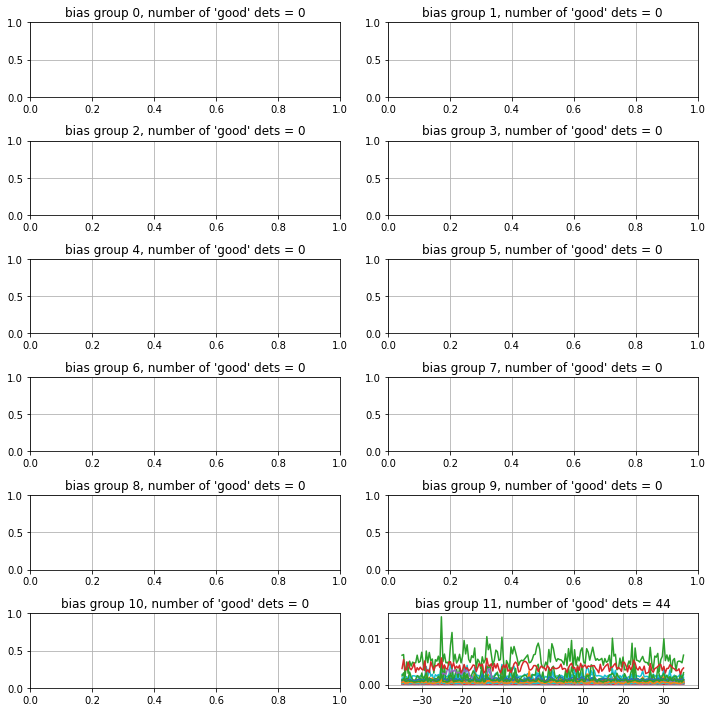

data saved to location FTS_data_integrated_bg11/run_20_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 21:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.09it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


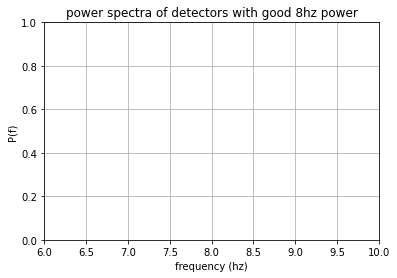

using power threshold of 10:


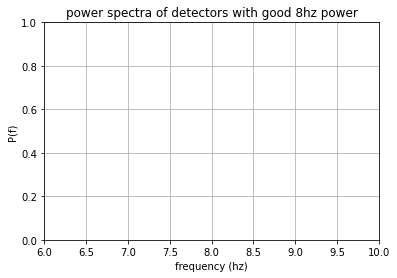

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


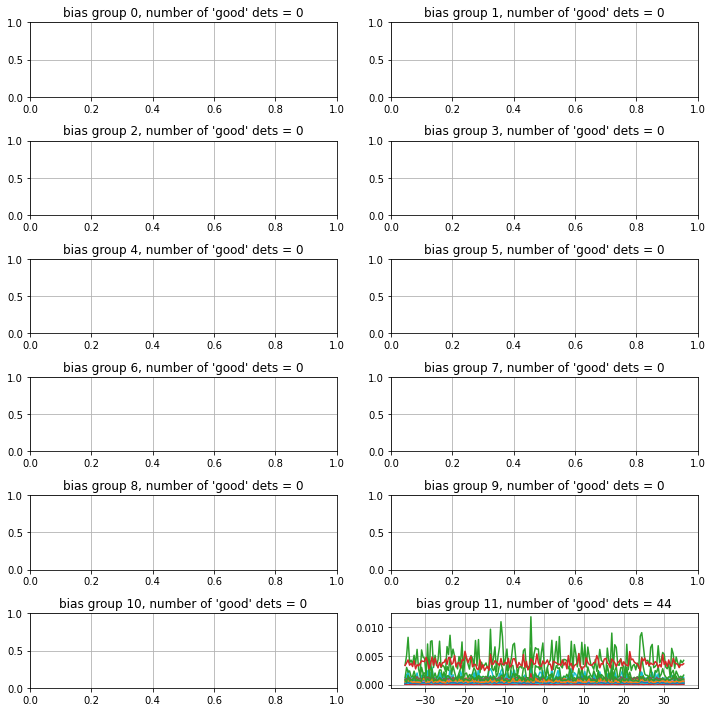

data saved to location FTS_data_integrated_bg11/run_21_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 22:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.15it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


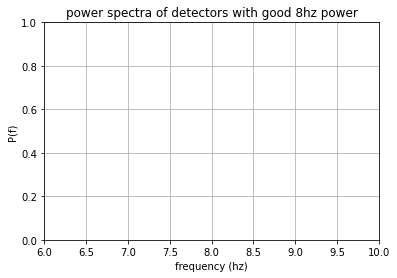

using power threshold of 10:


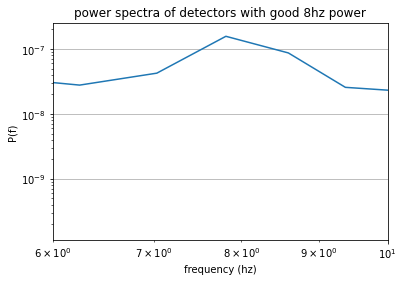

number of detectors with higher power in 8hz = 1
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


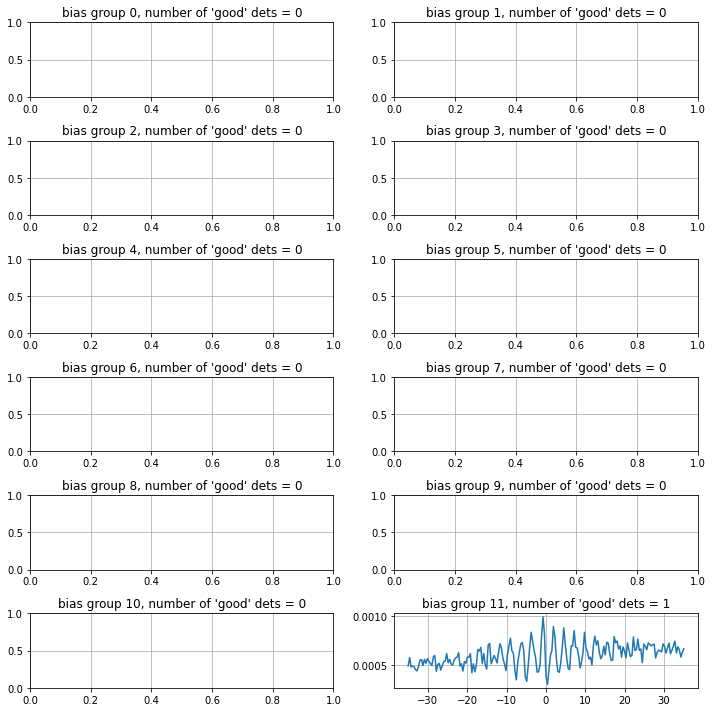

data saved to location FTS_data_integrated_bg11/run_22_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 23:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -6.1)
This function has now been added to sotodlib
number of interferograms in bias group -1: 0


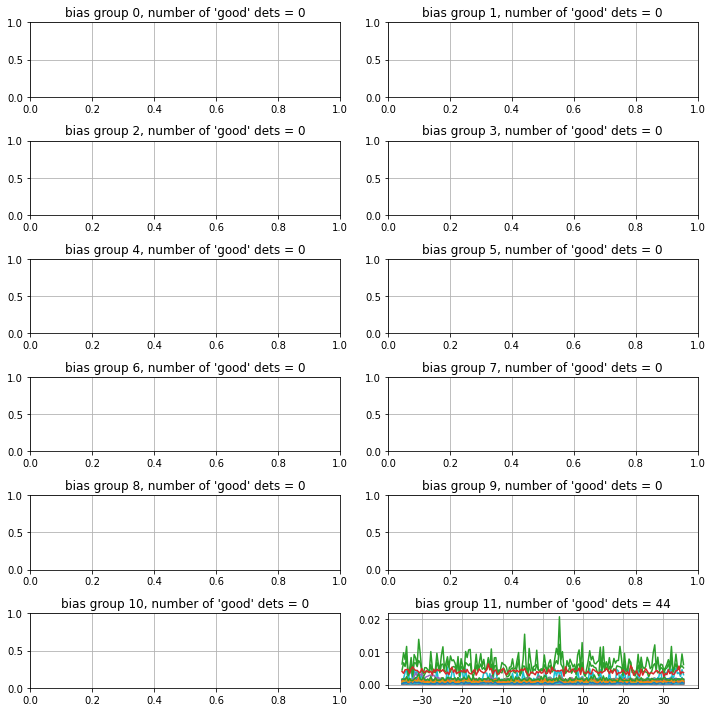

data saved to location FTS_data_integrated_bg11/run_25_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 26:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.04s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (1.0, -12.6)
This function has now been added to sotodlib
using power threshold of 100:


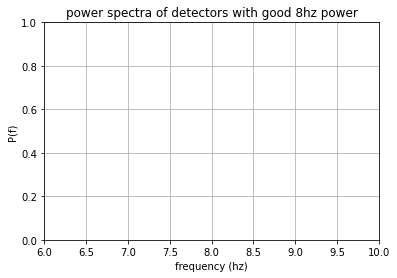

using power threshold of 10:


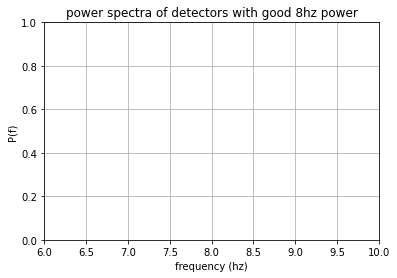

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


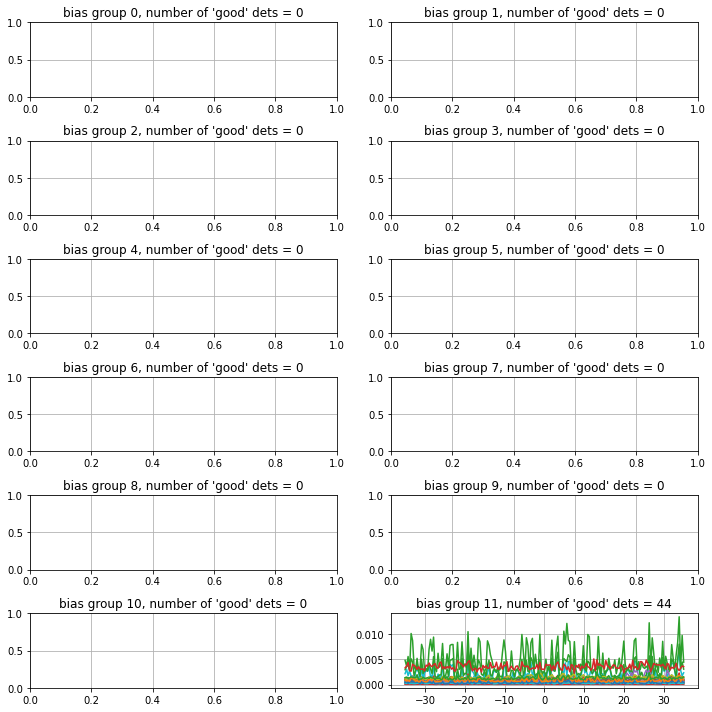

data saved to location FTS_data_integrated_bg11/run_26_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 27:
number of interferograms in bias group -1: 0


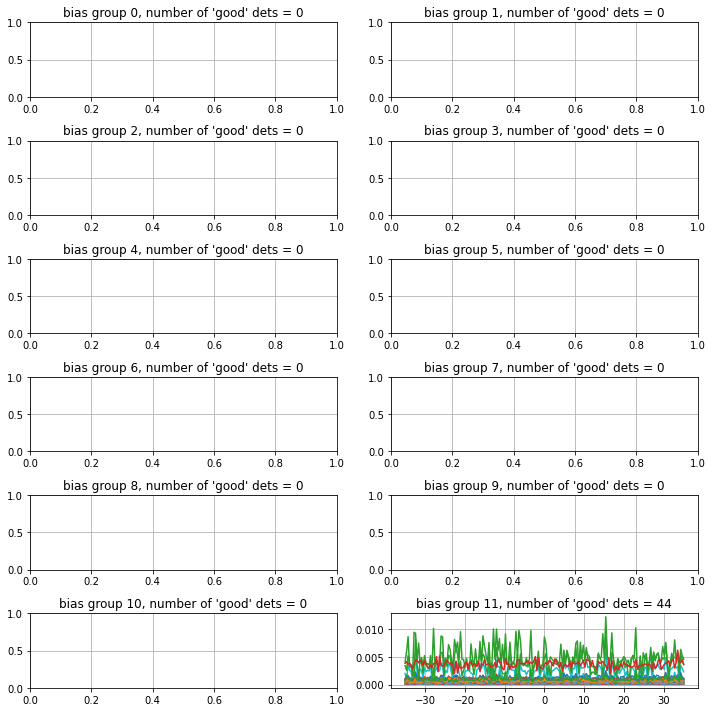

data saved to location FTS_data_integrated_bg11/run_30_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 31:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -8.2)
This function has now been added to sotodlib
using power threshold of 100:


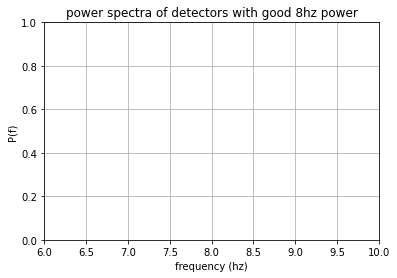

using power threshold of 10:


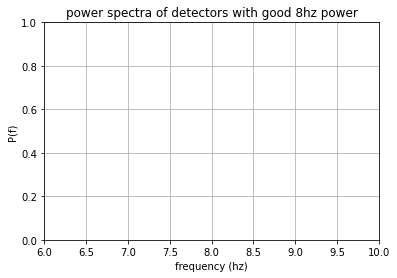

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


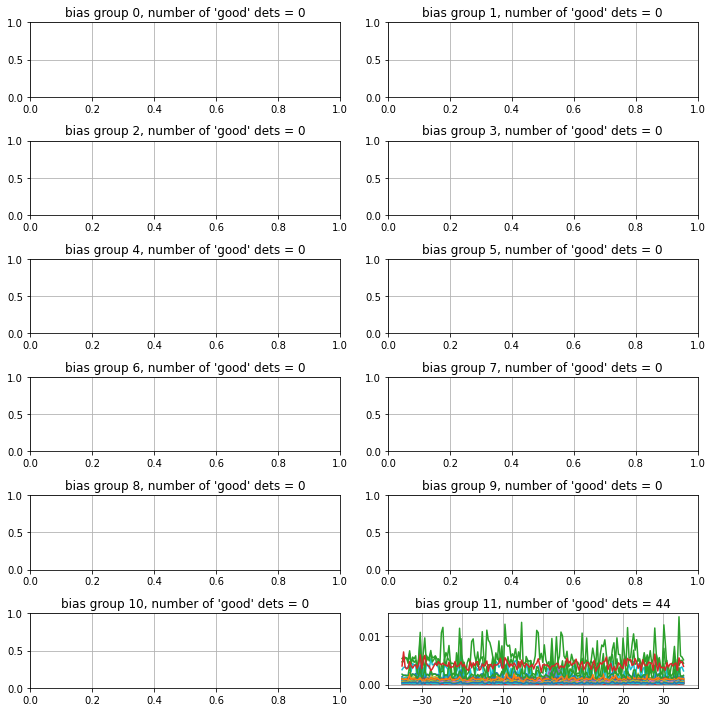

data saved to location FTS_data_integrated_bg11/run_31_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 32:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.08it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -6.1)
This function has now been added to sotodlib
using power threshold of 100:


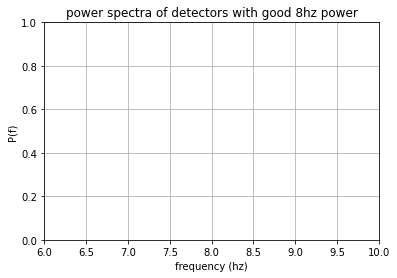

using power threshold of 10:


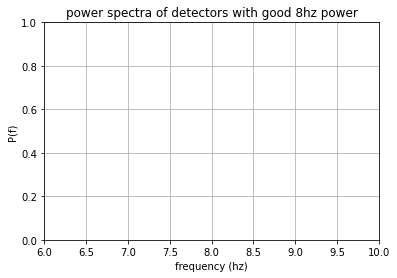

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


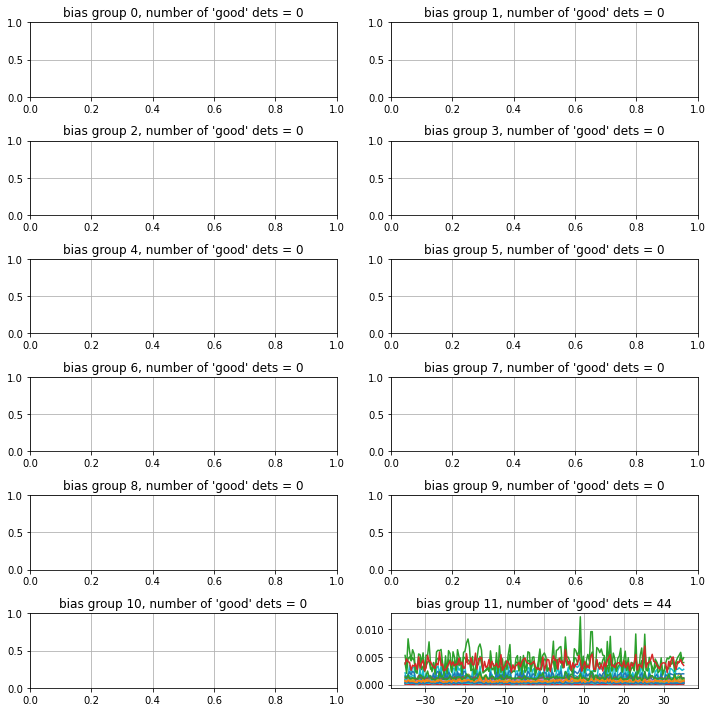

data saved to location FTS_data_integrated_bg11/run_32_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 33:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:04<00:00,  1.07s/it]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -3.9)
This function has now been added to sotodlib
using power threshold of 100:


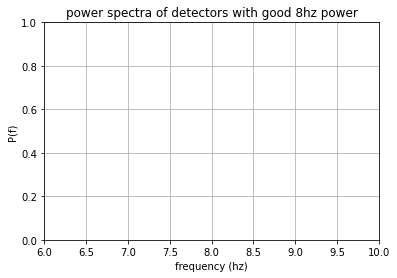

using power threshold of 10:


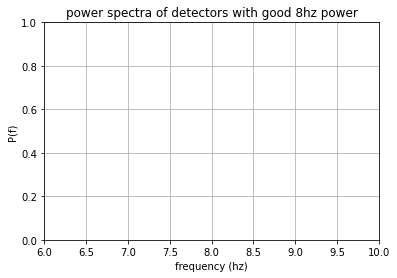

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


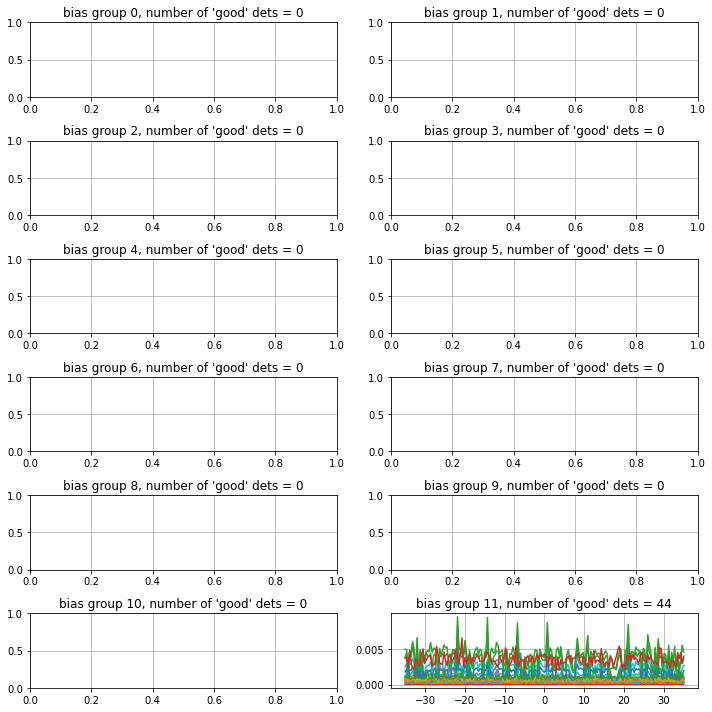

data saved to location FTS_data_integrated_bg11/run_33_interferograms.npz
------------------------------------------------------------------------------------------
processing data for run 34:


DEBUG: sotodlib.io.load_smurf: Axis Manager will have dets and samps axes
100%|██████████| 4/4 [00:03<00:00,  1.04it/s]
DEBUG: sotodlib.io.load_smurf: Ignoring ctime folders below 16000


XY stage position = (4.0, -1.8)
This function has now been added to sotodlib
using power threshold of 100:


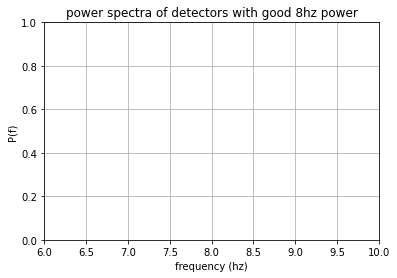

using power threshold of 10:


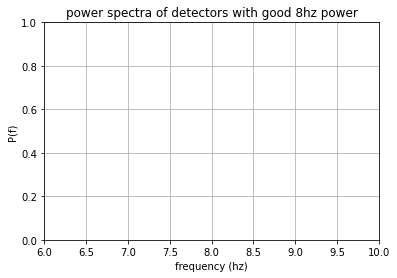

number of detectors with higher power in 8hz = 0
not enough good detectors found to fit phase. demodulating with a sine + cosine
number of interferograms in bias group -1: 0


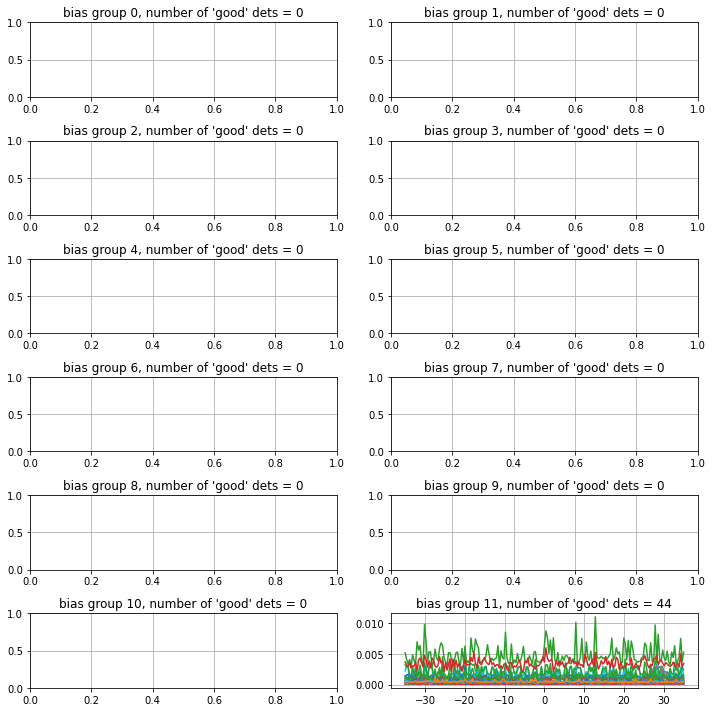

data saved to location FTS_data_integrated_bg11/run_34_interferograms.npz


In [11]:
# Process single bg at a time
for bg in [8, 9, 10, 11]:
    bg_mask = np.any([bias_groups[:,2] == bg], axis=0)
    for n in range(1, len(obs_list)):
        hk_data = load_range(
            obs_list[n].start, obs_list[n].stop,
            config='/data/users/kmharrin/smurf_context/hk_config_202104.yaml')
        print(90 * '-')
        print('processing data for run %s:' %n)
        aman = SMURF.load_data(np.min(hk_data['xy_stage_x'][0]), np.max(hk_data['xy_stage_x'][0]),
                               channels=bias_groups[bg_mask][:,:2])
        utils.load_bias_group(aman, utils.find_last_bg_map(SMURF, obs.stream_id, obs.timestamp))
        # make the middle relative time 860 or so since that's where the interferograms peak!!
        process_run_ufm(aman, plot=True, threshold=.5, folder_name=f'FTS_data_integrated_bg{bg}', 
                        band_channel_map=band_channel_map, resolution=.375, 
                        middle_relative_time=860, nperseg=(2 ** 8))

In [38]:
# zoom in around the time

(800.0, 950.0)

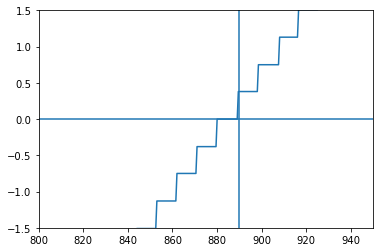

In [9]:
# For finding where to fit the phase-- do it near the fts mirror zero position
plt.plot(hk_data['fts_mirror'][0] - hk_data['fts_mirror'][0][0], hk_data['fts_mirror'][1])
plt.axvline(890)
plt.axhline(0)
plt.ylim(-1.5, 1.5)
plt.xlim(800, 950)